In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [404]:
data_x=pd.read_csv("F:\Personal\Queens MMAI\MMAI 869 – Machine Learning and AI Technology\Driven Data team Assignment\Train set values.csv")
data_y=pd.read_csv("F:\Personal\Queens MMAI\MMAI 869 – Machine Learning and AI Technology\Driven Data team Assignment\Train set labels.csv")

In [4]:
data=pd.merge(data_x,data_y,on="id",how="inner")

## Splitting the data into training and testing

In [405]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(data_x,data_y,train_size=0.7,random_state=42,stratify=data_y["status_group"])

## Data Exploration 

In [111]:
x_train.shape

(41580, 41)

In [409]:
len(x_train.select_dtypes(exclude="O").columns)

10

In [418]:
def dtype_null(i):
    dt=[]
    n=[]
    u=[]
    for a in i.columns:
        dt.append(np.dtype(i[a]))
        n.append(i[a].isna().sum())
        u.append(i[a].nunique())
    fea_des=np.column_stack((i.columns,dt,n,u))
    fea_des=pd.DataFrame(fea_des,columns=["Feature","dtype","null","unique"])
    return fea_des
dty=dtype_null(x_train)
dty=dty.sort_values(by="dtype").reset_index(drop=True)
dty

,Feature,dtype,null,unique
0,id,int64,0,41580
1,population,int64,0,948
2,district_code,int64,0,20
3,region_code,int64,0,27
4,num_private,int64,0,58
5,construction_year,int64,0,55
6,gps_height,int64,0,2385
7,longitude,float64,0,40285
8,latitude,float64,0,40283
9,amount_tsh,float64,0,93


In [410]:
x_train.select_dtypes(include="O").columns

Index(['date_recorded', 'funder', 'installer', 'wpt_name', 'basin',
       'subvillage', 'region', 'lga', 'ward', 'public_meeting', 'recorded_by',
       'scheme_management', 'scheme_name', 'permit', 'extraction_type',
       'extraction_type_group', 'extraction_type_class', 'management',
       'management_group', 'payment', 'payment_type', 'water_quality',
       'quality_group', 'quantity', 'quantity_group', 'source', 'source_type',
       'source_class', 'waterpoint_type', 'waterpoint_type_group'],
      dtype='object')

In [5]:
#Numerical Features Description
x_train.describe()

,id,amount_tsh,gps_height,longitude,latitude,num_private,region_code,district_code,population,construction_year
count,41580.000000,41580.000000,41580.000000,41580.000000,4.158000e+04,41580.000000,41580.000000,41580.000000,41580.000000,41580.000000
mean,37053.095238,328.297768,670.883333,34.088923,-5.716324e+00,0.500000,15.198509,5.593218,180.270178,1303.064791
std,21379.253543,3380.560532,693.624472,6.541418,2.940352e+00,14.103926,17.463795,9.575067,462.724333,950.851187
min,0.000000,0.000000,-63.000000,0.000000,-1.164944e+01,0.000000,1.000000,0.000000,0.000000,0.000000
25%,18530.750000,0.000000,0.000000,33.097738,-8.543252e+00,0.000000,5.000000,2.000000,0.000000,0.000000
50%,37055.500000,0.000000,374.000000,34.911885,-5.036156e+00,0.000000,12.000000,3.000000,27.500000,1986.000000
75%,55351.250000,25.000000,1322.000000,37.169114,-3.328690e+00,0.000000,17.000000,5.000000,215.000000,2004.000000
max,74247.000000,350000.000000,2770.000000,40.344301,-2.000000e-08,1776.000000,99.000000,80.000000,15300.000000,2013.000000


In [6]:
#Categorical Features Description
x_train.describe(include="O")

,date_recorded,funder,installer,wpt_name,basin,subvillage,region,lga,ward,public_meeting,...,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group
count,41580,39034,39025,41580,41580,41336,41580,41580,41580,39283,...,41580,41580,41580,41580,41580,41580,41580,41580,41580,41580
unique,346,1611,1802,27265,9,16078,21,124,2073,2,...,7,8,6,5,5,10,7,3,7,6
top,2011-03-17,Government Of Tanzania,DWE,none,Lake Victoria,Majengo,Iringa,Njombe,Igosi,True,...,never pay,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe
freq,410,6405,12204,2546,7058,364,3752,1769,222,35748,...,17792,35496,35496,23232,23232,11944,11944,32085,19911,24183


In [383]:
x_train.subvillage.value_counts(dropna=False)

Majengo       364
Shuleni       358
Madukani      352
Kati          267
NaN           244
             ... 
Mangoloma       1
Kaguhu B        1
Kapamisya       1
Puhi Chini      1
Masanze         1
Name: subvillage, Length: 16079, dtype: int64

In [384]:
grp_mode4=x_train.groupby(by=["region"])["subvillage"].transform(lambda x: x.mode().iloc[0])
x_train.subvillage=x_train.subvillage.fillna(grp_mode4)

In [385]:
x_train.subvillage.value_counts

5974          Inyuata
31787         Mtakuja
27800        Madukani
8008            Isaka
39725       Chapakazi
             ...     
21108       Mwabasabi
14847    Kimbangulile
26579          Vikuge
8192          Tangini
49783         Masanze
Name: subvillage, Length: 41580, dtype: object

In [386]:
x_train[["funder","installer"]].nunique()

funder       1611
installer    1802
dtype: int64

In [387]:
 for i in ["funder","installer"]:
        x_train[i]=x_train[i].str.lower()
        minor_values=x_train[i].value_counts(dropna=False)[x_train[i].value_counts(dropna=False,normalize=True).cumsum().values>0.95].index
        x_train[i]=x_train[i].apply(lambda s:"minor" if s in minor_values else s)
        grp_mode=x_train.groupby(by=["region"])[i].transform(lambda x: x.mode().iloc[0])
        x_train[i]=x_train[i].fillna(grp_mode)

In [388]:
x_train[["funder","installer"]].nunique()

funder       410
installer    417
dtype: int64

In [355]:
x_train.date_recorded

5974     2013-04-04
31787    2013-01-16
27800    2013-03-14
8008     2011-08-06
39725    2013-02-18
            ...    
21108    2012-10-14
14847    2011-02-21
26579    2011-02-26
8192     2013-02-07
49783    2011-03-06
Name: date_recorded, Length: 41580, dtype: object

In [389]:
bin_edges=[np.min(x_train.construction_year)-1,0,1961,1971,1981,1991,2001,np.max(x_train.construction_year)+1]
bin_labels=["0","0-1960","1960-70","1970-80","1980-90","1990-2000","2001-2013"]
x_train["construction_year_cat"]=pd.cut(x_train.construction_year,bins=bin_edges,labels=bin_labels).astype("O")

<Axes: >

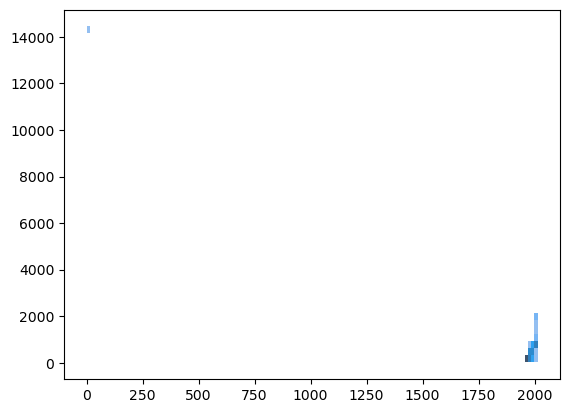

In [403]:
x_train.construction_year.

<Axes: xlabel='construction_year_cat', ylabel='count'>

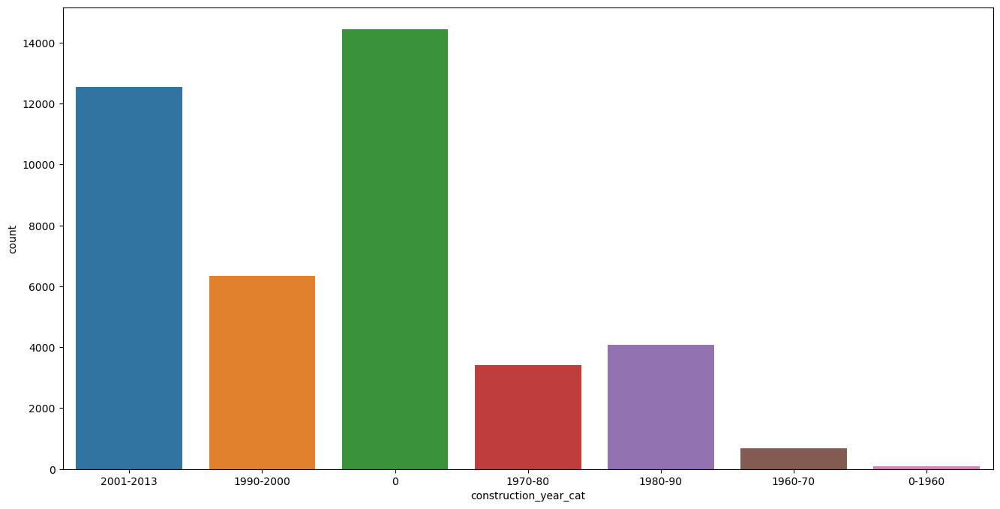

In [393]:
plt.figure(figsize=(16,8))
sns.countplot(x=x_train["construction_year_cat"])

In [359]:
c=pd.DataFrame()
c[["year","month","day"]]=x_train.date_recorded.str.split("-",n=2,expand=True)

<Axes: xlabel='gps_height', ylabel='Count'>

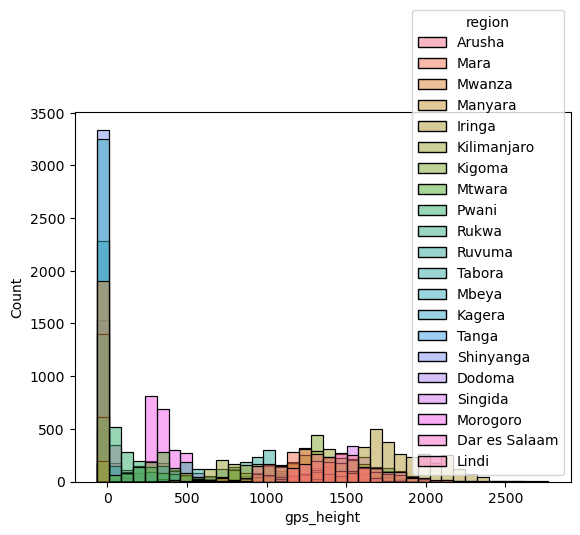

In [369]:
sns.histplot(data=x_train,x="gps_height",hue="region")
#plt.legend(loc='right', bbox_to_anchor=(1.4, 0.5),title)

<Axes: xlabel='gps_height', ylabel='Count'>

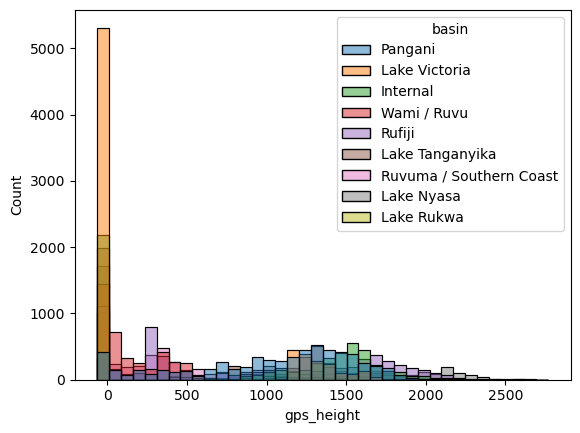

In [371]:
sns.histplot(data=x_train,x="gps_height",hue="basin")


In [370]:
x_train.gps_height.value_counts(normalize=True)

 0       0.342665
-20      0.000986
-16      0.000938
-15      0.000938
-13      0.000914
           ...   
 2255    0.000024
 660     0.000024
 2552    0.000024
 2002    0.000024
 533     0.000024
Name: gps_height, Length: 2385, dtype: float64

In [373]:
x_train["gps_height_basin"]=x_train["gps_height"]
x_train.loc[x_train['gps_height_basin'] == 0, 'gps_height_basin'] = pd.NA
grp_means3=x_train.groupby(by=["basin"])["gps_height_basin"].transform("mean")
x_train.gps_height_basin=x_train.gps_height_basin.fillna(grp_means3)

In [374]:
x_train["gps_height_region"]=x_train["gps_height"]
x_train.loc[x_train['gps_height_region'] == 0, 'gps_height_region'] = pd.NA
grp_means3=x_train.groupby(by=["region"])["gps_height_region"].transform("mean")
x_train.gps_height_region=x_train.gps_height_region.fillna(grp_means3)

<Axes: xlabel='gps_height_basin', ylabel='Count'>

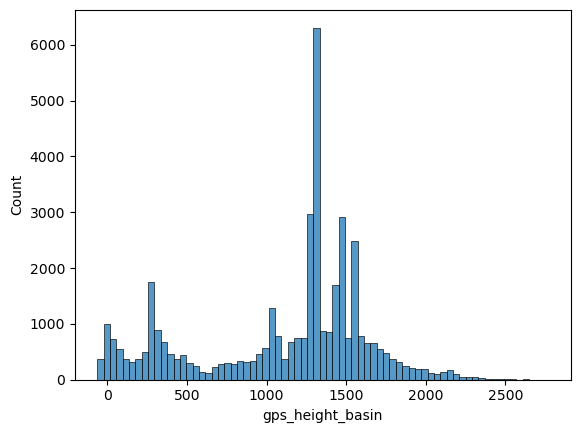

In [375]:
sns.histplot(x_train["gps_height_basin"])

<Axes: xlabel='gps_height_region', ylabel='Count'>

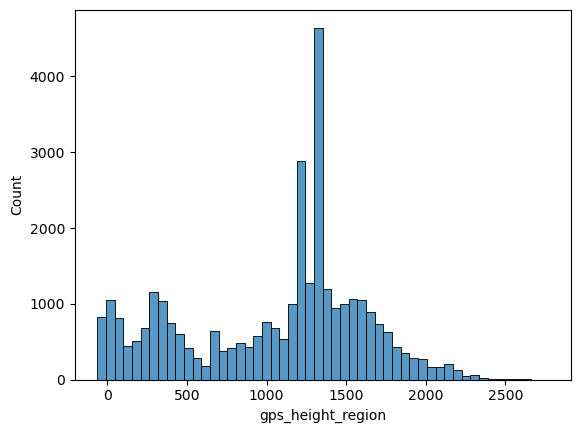

In [377]:
sns.histplot(x_train["gps_height_region"])

In [378]:
x_train.gps_height_region.value_counts()

 1350.526786    3340
 1201.033088    1901
 656.299652      353
 407.093461      164
-20.000000        41
                ... 
 2240.000000       1
 2330.000000       1
 2193.000000       1
 617.000000        1
 533.000000        1
Name: gps_height_region, Length: 2392, dtype: int64

In [380]:
x_train.date_recorded.value_counts()

2011-03-17    410
2011-03-15    406
2013-02-03    381
2011-03-16    375
2011-03-18    355
             ... 
2011-09-01      1
2004-04-01      1
2011-09-21      1
2011-09-06      1
2013-01-06      1
Name: date_recorded, Length: 346, dtype: int64

In [379]:
x_train["date_recorded"]=pd.to_datetime(x_train["date_recorded"])
x_train["dsr"]=pd.to_datetime("2023-11-16")-x_train["date_recorded"]
x_train.dsr=(x_train.dsr/ pd.Timedelta(seconds=86400))

<Axes: xlabel='dsr', ylabel='Count'>

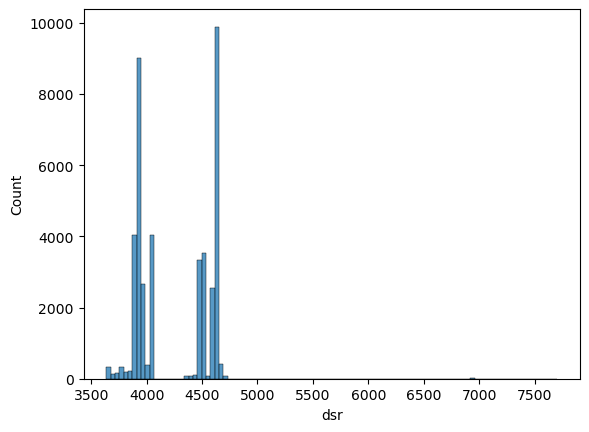

In [381]:
sns.histplot(x_train.dsr)

In [360]:
c

,year,month,day
5974,2013,04,04
31787,2013,01,16
27800,2013,03,14
8008,2011,08,06
39725,2013,02,18
...,...,...,...
21108,2012,10,14
14847,2011,02,21
26579,2011,02,26
8192,2013,02,07


In [7]:
# Description of Feature "num_private" not provided in the DataDriven. Hence, checking for its value_counts.
x_train.num_private.value_counts(normalize=True,dropna=False).head(20)

0      0.987422
6      0.001299
1      0.001227
8      0.000890
5      0.000770
32     0.000746
39     0.000529
7      0.000505
2      0.000481
45     0.000481
93     0.000409
15     0.000409
47     0.000385
102    0.000361
3      0.000337
4      0.000337
65     0.000313
80     0.000265
20     0.000265
25     0.000241
Name: num_private, dtype: float64

In [8]:
# Checking value_counts for Feature: "recorded_by"
x_train.recorded_by.value_counts(normalize=True,dropna=False)

GeoData Consultants Ltd    1.0
Name: recorded_by, dtype: float64

In [9]:
#latitude and Longitude

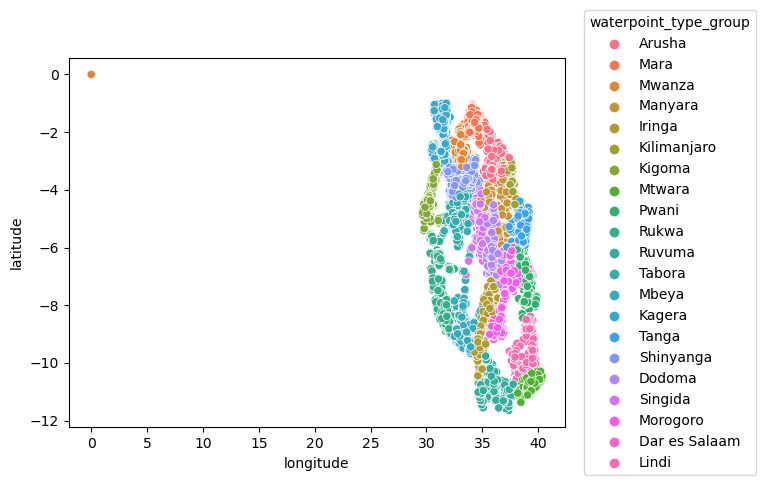

In [365]:
sns.scatterplot(data=x_train,x="longitude",y="latitude",hue="region")
plt.legend(loc='right', bbox_to_anchor=(1.4, 0.5),title=j)

In [ ]:
sns.scatterplot(data=x_train,x="longitude",y="latitude",hue="basin")
plt.legend(loc='right', bbox_to_anchor=(1.4, 0.5),title=j)

In [14]:
x_train["long_mod"]=x_train["longitude"]
x_train.loc[x_train['long_mod'] == 0, 'long_mod'] = pd.NA
grp_means=x_train.groupby(by=["region"])["long_mod"].transform("mean")
x_train.long_mod=x_train.long_mod.fillna(grp_means)
x_train["lat_mod"]=x_train["latitude"]
x_train.loc[x_train['lat_mod'] <-100, 'lat_mod'] = pd.NA
grp_means2=x_train.groupby(by=["region"])["lat_mod"].transform("mean")
x_train.lat_mod=x_train.lat_mod.fillna(grp_means2)

<Axes: xlabel='long_mod', ylabel='lat_mod'>

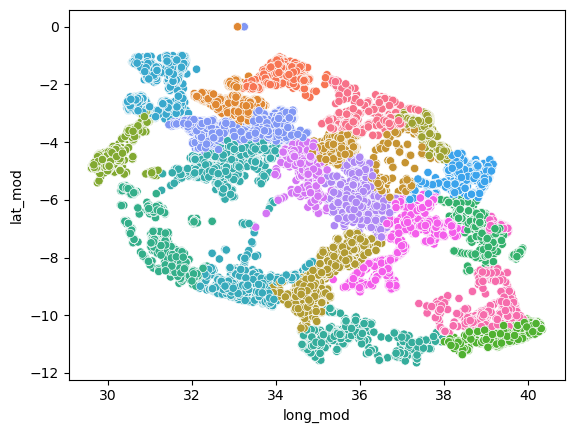

In [17]:
sns.scatterplot(data=x_train,x="long_mod",y="lat_mod",hue="region",legend=False)

In [20]:
x_train.loc[x_train.gps_height !=0].corr()

C:\Users\siddh\AppData\Local\Temp\ipykernel_25840\3843916064.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  x_train.loc[x_train.gps_height !=0].corr()


,id,amount_tsh,gps_height,longitude,latitude,num_private,region_code,district_code,population,construction_year,long_mod,lat_mod
id,1.000000,-0.005552,-0.005155,0.003908,0.000600,-0.003571,-0.006843,-0.007485,-0.004300,-0.009507,0.003908,0.000600
amount_tsh,-0.005552,1.000000,0.031609,-0.024042,-0.037336,0.001312,-0.028947,-0.029059,-0.002127,-0.011568,-0.024042,-0.037336
gps_height,-0.005155,0.031609,1.000000,-0.570228,0.278312,-0.014083,-0.313479,-0.327765,-0.062724,0.029693,-0.570228,0.278312
longitude,0.003908,-0.024042,-0.570228,1.000000,-0.185345,0.033910,0.207024,0.330026,-0.092103,-0.067914,1.000000,-0.185345
latitude,0.000600,-0.037336,0.278312,-0.185345,1.000000,0.018253,-0.348151,-0.260389,0.071424,0.084214,-0.185345,1.000000
num_private,-0.003571,0.001312,-0.014083,0.033910,0.018253,1.000000,-0.018546,-0.005158,-0.000550,-0.001386,0.033910,0.018253
region_code,-0.006843,-0.028947,-0.313479,0.207024,-0.348151,-0.018546,1.000000,0.722797,0.096729,-0.042561,0.207024,-0.348151
district_code,-0.007485,-0.029059,-0.327765,0.330026,-0.260389,-0.005158,0.722797,1.000000,0.052830,-0.088702,0.330026,-0.260389
population,-0.004300,-0.002127,-0.062724,-0.092103,0.071424,-0.000550,0.096729,0.052830,1.000000,0.011241,-0.092103,0.071424
construction_year,-0.009507,-0.011568,0.029693,-0.067914,0.084214,-0.001386,-0.042561,-0.088702,0.011241,1.000000,-0.067914,0.084214


In [21]:
x_train.loc[x_train.longitude==0].gps_height.value_counts()

0    1257
Name: gps_height, dtype: int64

In [25]:
from sklearn.linear_model import LinearRegression
a=x_train.loc[x_train.gps_height !=0][["latitude","longitude","gps_height"]]

In [26]:
a

,latitude,longitude,gps_height
5974,-3.353465,36.667568,1410
31787,-2.139160,33.637501,1161
27800,-2.977996,36.854557,1184
39725,-5.674631,36.528004,1331
26925,-8.509156,35.057014,1854
...,...,...,...
36363,-3.240390,37.638517,1227
14847,-7.002206,39.219207,52
26579,-6.783685,38.857796,99
8192,-10.642069,39.348550,426


In [36]:
reg = LinearRegression(fit_intercept=True).fit(a[["latitude","longitude"]], a["gps_height"])

In [37]:
reg.score(a[["latitude","longitude"]], a["gps_height"])

0.356018690622423

In [33]:
reg.coef_

array([  39.41728702, -128.58288514])

In [31]:
reg2 = LinearRegression().fit(a[["longitude"]], a["gps_height"])

In [32]:
reg2.score(a[["longitude"]], a["gps_height"])

0.3251598859758673

In [55]:
b=x_train[["lat_mod","long_mod","gps_height"]]

In [56]:
b=b.loc[b["gps_height"]!=0]

In [57]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(b)
b=scaler.transform(b)

In [58]:
b

array([[ 1.05739252,  0.27372363,  0.63590064],
       [ 1.49465212, -0.91092508,  0.22926589],
       [ 1.19259522,  0.34682942,  0.26682653],
       ...,
       [-0.17779688,  1.13002485, -1.5050558 ],
       [-1.56716359,  1.32189218, -0.9710415 ],
       [-0.2155067 ,  0.62347262, -0.84856115]])

In [63]:
from sklearn.cluster import KMeans

In [64]:
from sklearn.metrics import silhouette_score, silhouette_samples

In [27]:
x_train.loc[x_train.lga.str.lower().str.contains("rural")==True].lga.value_counts()

Moshi Rural         878
Arusha Rural        876
Singida Rural       690
Kigoma Rural        588
Iringa Rural        521
Songea Rural        457
Shinyanga Rural     402
Sumbawanga Rural    378
Morogoro Rural      374
Bukoba Rural        339
Mbeya Rural         331
Mtwara Rural        290
Musoma Rural        268
Lindi Rural         264
Name: lga, dtype: int64

In [28]:
x_train.loc[x_train.lga.str.lower().str.contains("rural")==True].shape

(6656, 40)

In [39]:
x_train.loc[x_train.lga.str.lower().str.contains("rural")==True].lga.value_counts()

Moshi Rural         878
Arusha Rural        876
Singida Rural       690
Kigoma Rural        588
Iringa Rural        521
Songea Rural        457
Shinyanga Rural     402
Sumbawanga Rural    378
Morogoro Rural      374
Bukoba Rural        339
Mbeya Rural         331
Mtwara Rural        290
Musoma Rural        268
Lindi Rural         264
Name: lga, dtype: int64

In [40]:
x_train.loc[x_train.lga.str.lower().str.contains("moshi")==True].lga.value_counts()

Moshi Rural    878
Moshi Urban     57
Name: lga, dtype: int64

<Axes: xlabel='longitude', ylabel='latitude'>

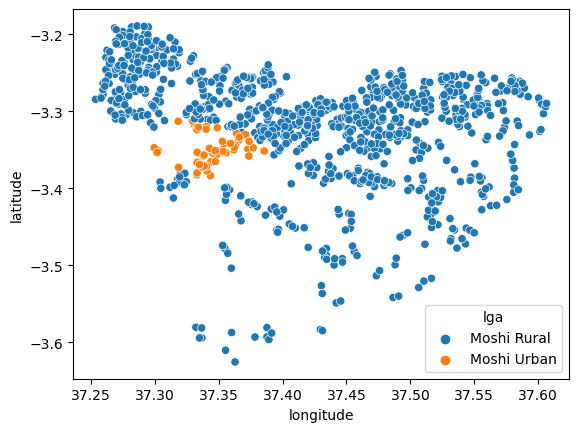

In [43]:
sns.scatterplot(data=x_train.loc[x_train.lga.str.lower().str.contains("moshi")==True],y="latitude",x="longitude",hue="lga")

In [47]:
x_train["lga_mod"]=x_train["lga"]

In [48]:
x_train["lga_mod"]=x_train["lga_mod"].str.lower()

In [49]:
x_train['lga_mod'] = x_train['lga_mod'].str.replace('rural', '').str.replace('urban', '')

<Axes: xlabel='longitude', ylabel='latitude'>

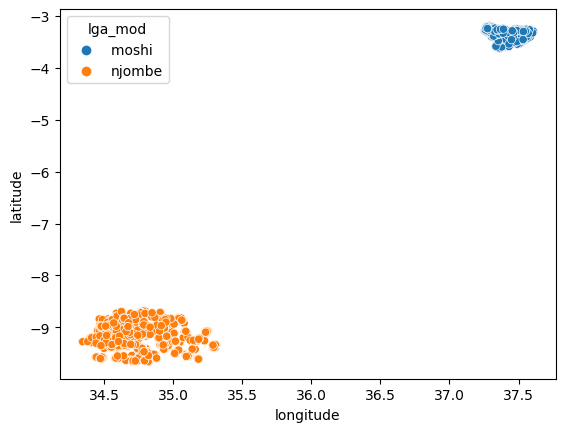

In [58]:
sns.scatterplot(data=x_train.loc[(x_train.lga_mod=="moshi ") | (x_train.lga_mod=="njombe")],y="latitude",x="longitude",hue="lga_mod")

In [29]:
x_train.loc[x_train.lga.str.lower().str.contains("urban")==True].shape

(1163, 40)

In [35]:
x_train.loc[(x_train.lga.str.lower().str.contains("urban")==False) & (x_train.lga.str.lower().str.contains("rural")==False)].shape

(33761, 40)

In [37]:
x_train.loc[(x_train.lga.str.lower().str.contains("urban")==False) & (x_train.lga.str.lower().str.contains("rural")==False)].lga.value_counts().head(50)

Njombe        1769
Bariadi        808
Kilosa         791
Rungwe         790
Mbozi          727
Meru           717
Kasulu         713
Bagamoyo       701
Kilombero      676
Kibondo        627
Same           618
Kyela          599
Kahama         578
Maswa          577
Magu           565
Mbinga         533
Karagwe        521
Namtumbo       495
Ulanga         493
Serengeti      490
Lushoto        474
Mvomero        470
Mpanda         467
Makete         458
Ngara          447
Kwimba         434
Hai            430
Mbarali        426
Nzega          414
Mkuranga       405
Rombo          393
Ludewa         392
Iramba         387
Mwanga         374
Mufindi        372
Masasi         363
Babati         363
Kondoa         362
Bukombe        347
Ilala          344
Geita          341
Meatu          322
Siha           315
Rufiji         308
Biharamulo     304
Nkasi          302
Bunda          298
Korogwe        287
Tunduru        286
Kishapu        284
Name: lga, dtype: int64

In [102]:
x_train.funder.value_counts(dropna=False)

Government Of Tanzania       6405
NaN                          2546
Danida                       2177
Hesawa                       1542
Rwssp                         956
                             ... 
Norway Aid                      1
Kiwanda Cha Ngozi               1
Lench Taramai                   1
Hearts Helping Hands.Inc.       1
Woyege                          1
Name: funder, Length: 1612, dtype: int64

In [107]:
x_train.funder.value_counts(dropna=False)[x_train.funder.value_counts(dropna=False,normalize=True).cumsum().values>0.95]

British Colonial Government    7
Tltc                           7
Aimgold                        7
Healt                          7
Williamson Diamond Ltd         7
                              ..
Norway Aid                     1
Kiwanda Cha Ngozi              1
Lench Taramai                  1
Hearts Helping Hands.Inc.      1
Woyege                         1
Name: funder, Length: 1202, dtype: int64

In [106]:
x_train.funder.value_counts(dropna=False)[x_train.funder.value_counts(dropna=False).values<10]

Rural Water Supply And Sanita    9
National Rural And Hfa           9
The Isla                         9
Mosque                           9
Rdc                              9
                                ..
Norway Aid                       1
Kiwanda Cha Ngozi                1
Lench Taramai                    1
Hearts Helping Hands.Inc.        1
Woyege                           1
Name: funder, Length: 1263, dtype: int64

In [ ]:
sns.histplot(data=x_train,x="funder")

In [91]:
x_train.funder.value_counts(dropna=False).values==1

array([False, False, False, ...,  True,  True,  True])

In [72]:
x_train.funder.value_counts(normalize=True,dropna=False)

Government Of Tanzania       0.154040
NaN                          0.061231
Danida                       0.052357
Hesawa                       0.037085
Rwssp                        0.022992
                               ...   
Norway Aid                   0.000024
Kiwanda Cha Ngozi            0.000024
Lench Taramai                0.000024
Hearts Helping Hands.Inc.    0.000024
Woyege                       0.000024
Name: funder, Length: 1612, dtype: float64

In [20]:
x_train.loc[x_train.funder.isna()==True].region.value_counts(normalize=True,dropna=False)

Mbeya            0.534564
Singida          0.263158
Arusha           0.089159
Pwani            0.035742
Kagera           0.026709
Mwanza           0.012569
Dar es Salaam    0.007463
Shinyanga        0.007070
Tabora           0.003928
Mara             0.003535
Iringa           0.003142
Kigoma           0.003142
Morogoro         0.002749
Kilimanjaro      0.001964
Dodoma           0.001571
Mtwara           0.001178
Rukwa            0.000786
Lindi            0.000786
Ruvuma           0.000786
Name: region, dtype: float64

In [23]:
x_train.loc[x_train.funder.isna()==True].lga.value_counts(normalize=True,dropna=False)

Rungwe             0.310291
Singida Rural      0.263158
Mbarali            0.167321
Ileje              0.056952
Monduli            0.053417
Mafia              0.034564
Bukoba Urban       0.021603
Arusha Urban       0.019246
Arusha Rural       0.010998
Ilala              0.007463
Muleba             0.005106
Missungwi          0.004321
Ukerewe            0.004321
Longido            0.004321
Bariadi            0.003535
Igunga             0.003142
Magu               0.002357
Kilosa             0.002357
Serengeti          0.001964
Kibondo            0.001964
Ludewa             0.001964
Bukombe            0.001571
Kasulu             0.001178
Njombe             0.001178
Bahi               0.001178
Mpanda             0.000786
Bagamoyo           0.000786
Tarime             0.000786
Kishapu            0.000786
Bunda              0.000786
Meru               0.000786
Moshi Rural        0.000786
Sengerema          0.000786
Geita              0.000786
Kilwa              0.000786
Nzega              0

In [60]:
x_train.ward.value_counts(dropna=False)

Igosi          222
Imalinyi       181
Siha Kati      164
Mdandu         157
Mishamo        147
              ... 
Nsemulwa         1
Machinjioni      1
Mfaranyaki       1
Masukulu         1
Mkwiti           1
Name: ward, Length: 2073, dtype: int64

In [70]:
x_train.ward.str.lower().value_counts(dropna=False,normalize=True).head(50).cumsum()

igosi               0.005339
imalinyi            0.009692
siha kati           0.013636
mdandu              0.017412
mishamo             0.020948
nduruma             0.024483
chalinze            0.027922
msindo              0.031337
maji ya chai        0.034584
kitunda             0.037734
usuka               0.040861
chanika             0.043843
ngarenanyuki        0.046561
matola              0.049206
vikindu             0.051804
maramba             0.054377
itete               0.056782
ifakara             0.059163
mtwango             0.061520
zinga/ikerege       0.063829
kikatiti            0.066114
olkokola            0.068398
wanging'ombe        0.070635
simbo               0.072848
magomeni            0.075060
igongolo            0.077177
mlangali            0.079293
mahongole           0.081385
mvomero             0.083454
siha mashariki      0.085498
maposeni            0.087518
lupalilo            0.089538
hedaru              0.091486
kiranyi             0.093434
mamire        

In [66]:
pd.crosstab(x_train.region,x_train.ward,margins=True,dropna=False)

ward,Aghondi,Akheri,Arash,Arri,Arusha Chini,Babayu,Badi,Badugu,Bahi,Balangidalalu,...,Zanka,Ziba,Zinga/Ikerege,Zirai,Ziwani,Zoissa,Zombo,Zongomera,Zuzu,All
region,,,,,,,,,,,,,,,,,,,,,
Arusha,0,29,8,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2364
Dar es Salaam,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,558
Dodoma,0,0,0,0,0,6,0,0,11,0,...,12,0,0,0,0,9,0,0,10,1533
Iringa,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3752
Kagera,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2281
Kigoma,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1976
Kilimanjaro,0,0,0,0,38,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3065
Lindi,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1057
Manyara,0,0,0,15,0,0,0,0,0,11,...,0,0,0,0,0,0,0,0,0,1124


In [71]:
x_train.funder.str.lower().value_counts(normalize=True,dropna=False)

government of tanzania       0.154040
NaN                          0.061231
danida                       0.052357
hesawa                       0.037085
rwssp                        0.022992
                               ...   
norway aid                   0.000024
kiwanda cha ngozi            0.000024
lench taramai                0.000024
hearts helping hands.inc.    0.000024
woyege                       0.000024
Name: funder, Length: 1612, dtype: float64

In [73]:
x_train.installer.value_counts(normalize=True,dropna=False)

DWE                          0.293506
NaN                          0.061448
Government                   0.030616
RWE                          0.020178
Commu                        0.017845
                               ...   
desk and chair foundation    0.000024
SHIPO CONSTRUCTORS           0.000024
Ju                           0.000024
Seram                        0.000024
WOYEGE                       0.000024
Name: installer, Length: 1803, dtype: float64

In [74]:
x_train.installer.str.lower().value_counts(normalize=True,dropna=False)

dwe                  0.293555
NaN                  0.061448
government           0.031722
hesawa               0.023377
rwe                  0.020178
                       ...   
dokta mwandulami     0.000024
iucn                 0.000024
kiwanda cha ngozi    0.000024
upper ruvu           0.000024
woyege               0.000024
Name: installer, Length: 1630, dtype: float64

In [110]:
x_train.loc[x_train["funder"].str.lower()==x_train["installer"].str.lower()].funder.value_counts().cumsum()

Danida                         735
Kkkt                          1366
Hesawa                        1964
0                             2503
World Vision                  2976
                             ...  
Institutional                13249
Solidarm                     13250
Hearts Helping Hands.Inc.    13251
Kiwanda Cha Ngozi            13252
Woyege                       13253
Name: funder, Length: 880, dtype: int64

In [112]:
x_train.shape

(41580, 41)

In [114]:
13253/41580

0.31873496873496876

In [6]:
x_train.loc[x_train["funder"].str.lower()!=x_train["installer"].str.lower()].funder.value_counts()

Government Of Tanzania            6405
Danida                            1442
Hesawa                             944
Rwssp                              853
World Bank                         811
                                  ... 
Grazie Grouppo Padre Fiorentin       1
Hassan Gulam                         1
Hasnein Muij Mbunge                  1
Dwt                                  1
Kiliwater                            1
Name: funder, Length: 1004, dtype: int64

In [14]:
x_train.loc[x_train["funder"].str.lower()!=x_train["installer"].str.lower()].shape

(28327, 40)

In [17]:
x_train.loc[(x_train["funder"].str.lower()!=x_train["installer"].str.lower()) & (x_train["installer"].str.lower()=="dwe")]["funder"].str.lower().value_counts().head(50)

government of tanzania            2989
hesawa                             904
rwssp                              643
dhv                                489
danida                             434
dwsp                               424
unicef                             391
netherlands                        334
adb                                249
tasaf                              213
ces(gmbh)                          183
rural water supply and sanitat     177
district council                   150
ministry of water                  143
isf                                127
world vision                       124
norad                              119
rudep                              118
ces (gmbh)                         115
concern world wide                 112
mission                            109
mkinga distric coun                108
world bank                         105
snv                                 90
water                               87
oxfam                    

In [8]:
x_train.loc[(x_train["funder"].str.lower()=="government of tanzania") & (x_train["installer"].str.lower()=="government")].funder.value_counts()

Government Of Tanzania    1144
Name: funder, dtype: int64

<Axes: xlabel='installer', ylabel='funder'>

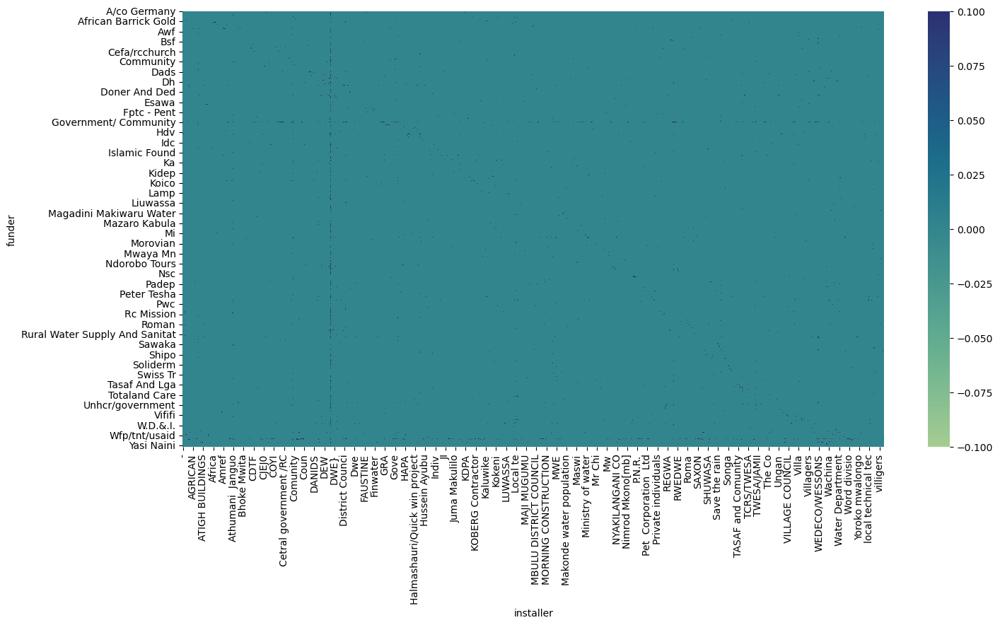

In [124]:
plt.figure(figsize=(16,8))
sns.heatmap(pd.crosstab(x_train.loc[x_train["funder"].str.lower()!=x_train["installer"].str.lower()].funder,x_train.loc[x_train["funder"].str.lower()!=x_train["installer"].str.lower()].installer),vmax=0,cmap="crest")

<Axes: xlabel='management', ylabel='funder'>

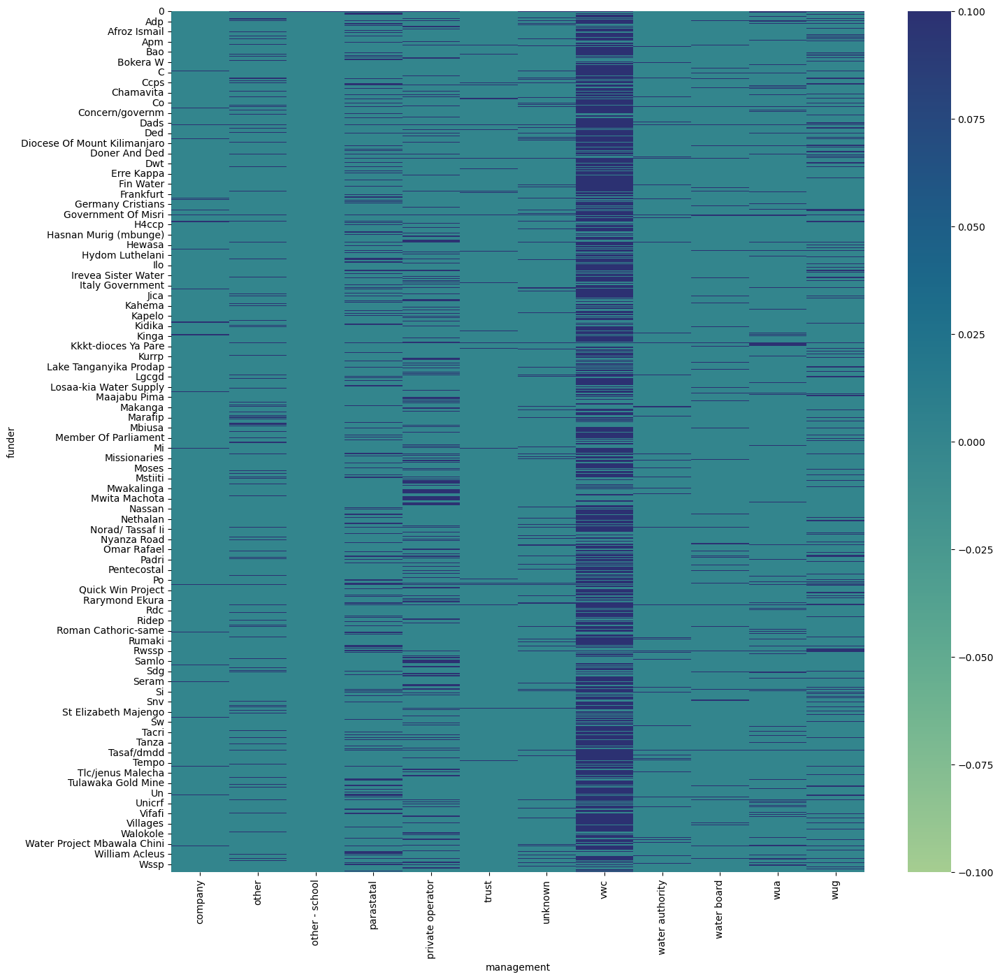

In [128]:
plt.figure(figsize=(16,16))
sns.heatmap(pd.crosstab(x_train.funder,x_train.management),cmap="crest",vmax=0)

<Axes: xlabel='management_group', ylabel='funder'>

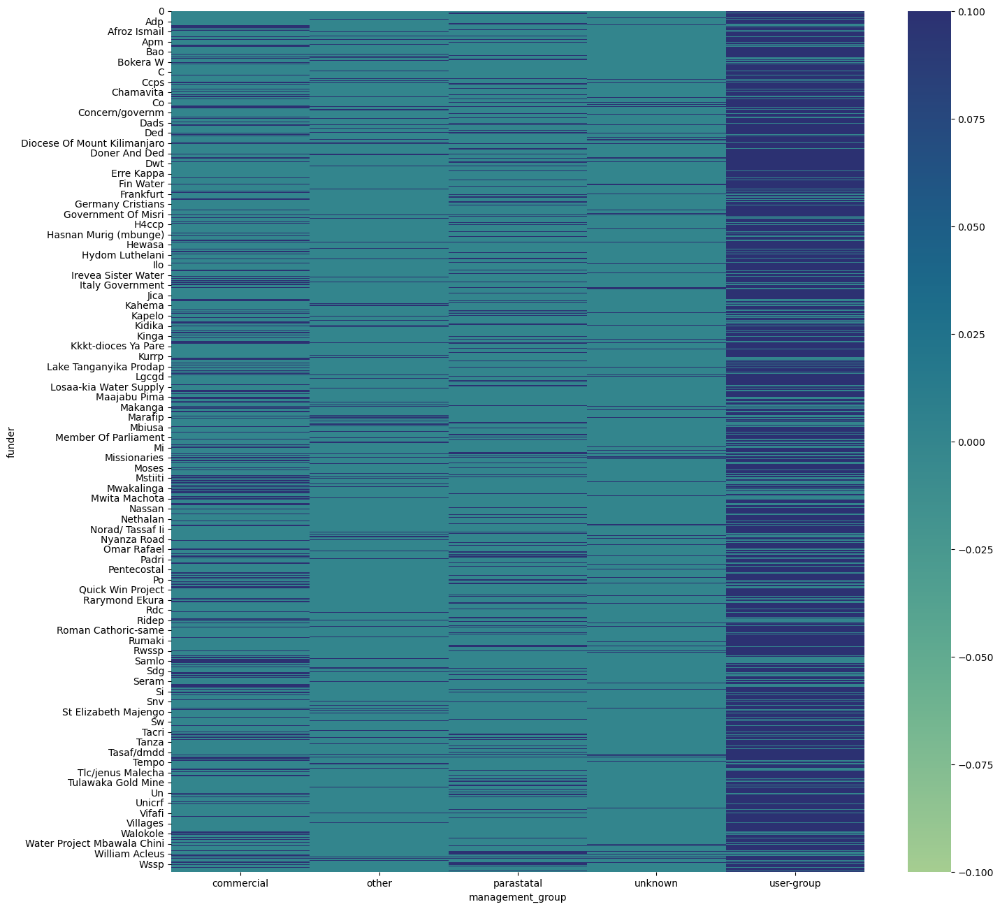

In [129]:
plt.figure(figsize=(16,16))
sns.heatmap(pd.crosstab(x_train.funder,x_train.management_group),cmap="crest",vmax=0)

In [132]:
x_train.select_dtypes(include="O").nunique()

date_recorded              346
funder                    1611
installer                 1802
wpt_name                 27265
basin                        9
subvillage               16078
region                      21
lga                        124
ward                      2073
public_meeting               2
recorded_by                  1
scheme_management           12
scheme_name               2472
permit                       2
extraction_type             18
extraction_type_group       13
extraction_type_class        7
management                  12
management_group             5
payment                      7
payment_type                 7
water_quality                8
quality_group                6
quantity                     5
quantity_group               5
source                      10
source_type                  7
source_class                 3
waterpoint_type              7
waterpoint_type_group        6
lga_mod                    113
dtype: int64

## Data Exploration- Categorical Features

In [139]:
cat_col=x_train.select_dtypes(include="O").columns.drop(list(x_train.select_dtypes(include="O").nunique()[x_train.select_dtypes(include="O").nunique().values>50].index))

In [140]:
cat_col

Index(['basin', 'region', 'public_meeting', 'recorded_by', 'scheme_management',
       'permit', 'extraction_type', 'extraction_type_group',
       'extraction_type_class', 'management', 'management_group', 'payment',
       'payment_type', 'water_quality', 'quality_group', 'quantity',
       'quantity_group', 'source', 'source_type', 'source_class',
       'waterpoint_type', 'waterpoint_type_group'],
      dtype='object')

In [185]:
bas=[]
ind=[]
val=[]
for i in list(cat_col):
    bas.append(i);
    ind.append(x_train[i].value_counts(normalize=True,dropna=False).head(1).index.values[0]);
    val.append(round(x_train[i].value_counts(normalize=True,dropna=False).head(1).values[0],3))
a=pd.DataFrame((bas,ind,val)).T  
a


,0,1,2
0,basin,Lake Victoria,0.17
1,region,Iringa,0.09
2,public_meeting,True,0.86
3,recorded_by,GeoData Consultants Ltd,1.0
4,scheme_management,VWC,0.621
5,permit,True,0.654
6,extraction_type,gravity,0.451
7,extraction_type_group,gravity,0.451
8,extraction_type_class,gravity,0.451
9,management,vwc,0.684


In [208]:
bas=[]
ind=[]
val=[]
for i in list(cat_col):
    bas.append(i);
    ind.append(x_train[i].value_counts(normalize=True,dropna=False).cumsum().head(2).index.values[0:2]);
    val.append(x_train[i].value_counts(normalize=True,dropna=False).cumsum().head(2).values[0:2])
b=pd.DataFrame((bas,ind,val)).T  
b

,0,1,2
0,basin,"[Lake Victoria, Pangani]","[0.16974506974506975, 0.32082732082732085]"
1,region,"[Iringa, Shinyanga]","[0.09023569023569024, 0.17325637325637328]"
2,public_meeting,"[True, False]","[0.8597402597402597, 0.9447570947570947]"
3,recorded_by,[GeoData Consultants Ltd],[1.0]
4,scheme_management,"[VWC, WUG]","[0.6213804713804714, 0.7086580086580087]"
5,permit,"[True, False]","[0.6539201539201539, 0.9482683982683983]"
6,extraction_type,"[gravity, nira/tanira]","[0.45132275132275135, 0.5885281385281386]"
7,extraction_type_group,"[gravity, nira/tanira]","[0.45132275132275135, 0.5885281385281386]"
8,extraction_type_class,"[gravity, handpump]","[0.45132275132275135, 0.7290283790283791]"
9,management,"[vwc, wug]","[0.6843193843193843, 0.7933140933140933]"


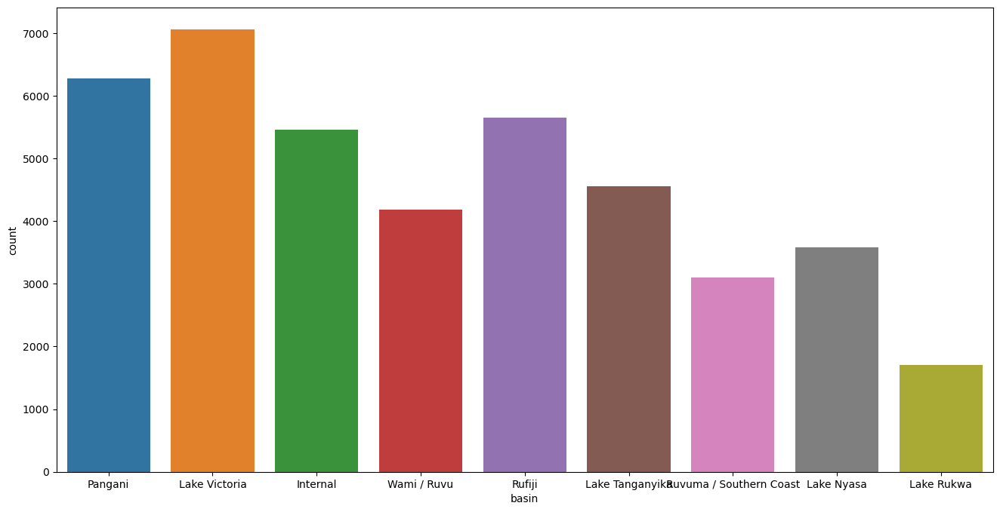

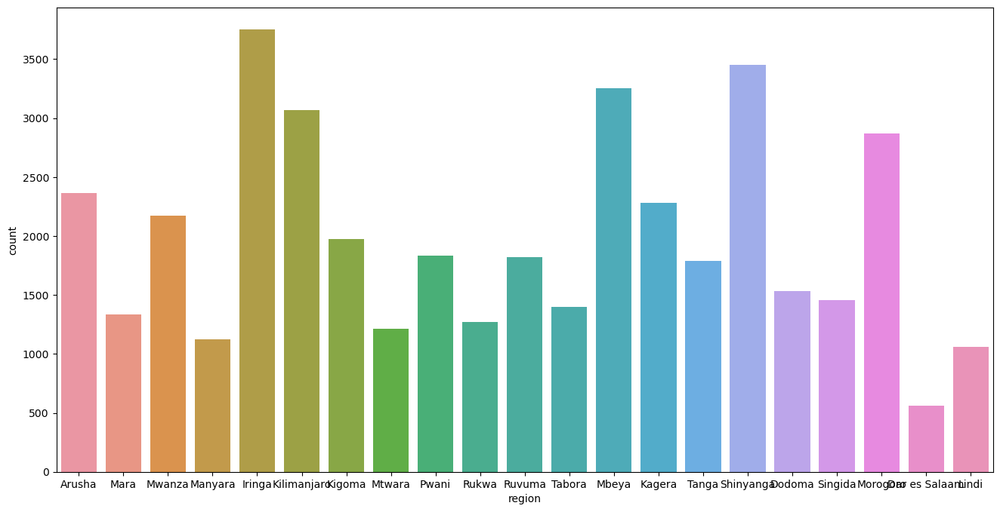

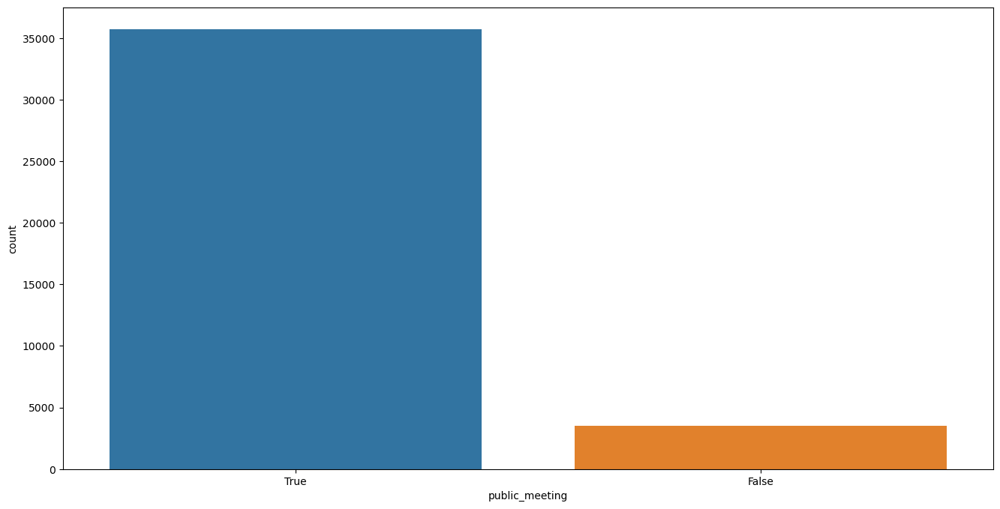

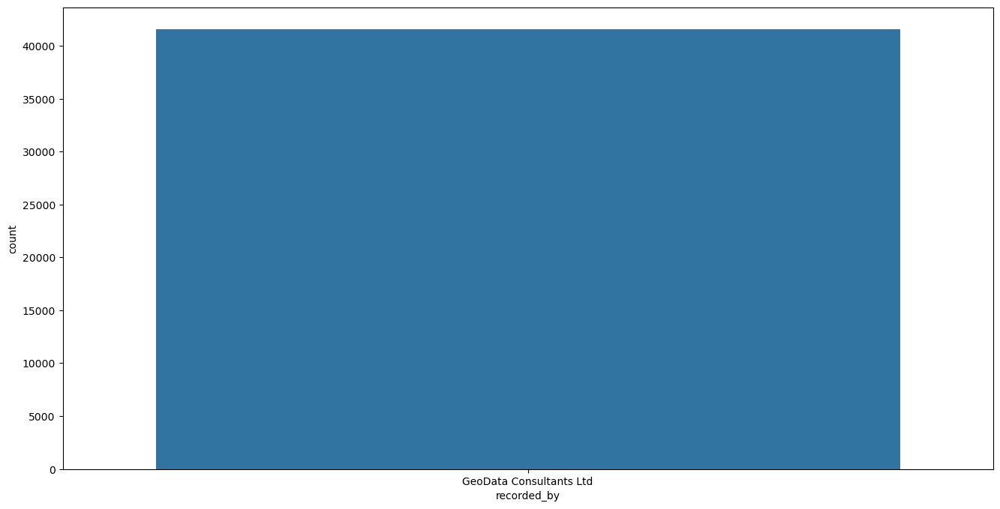

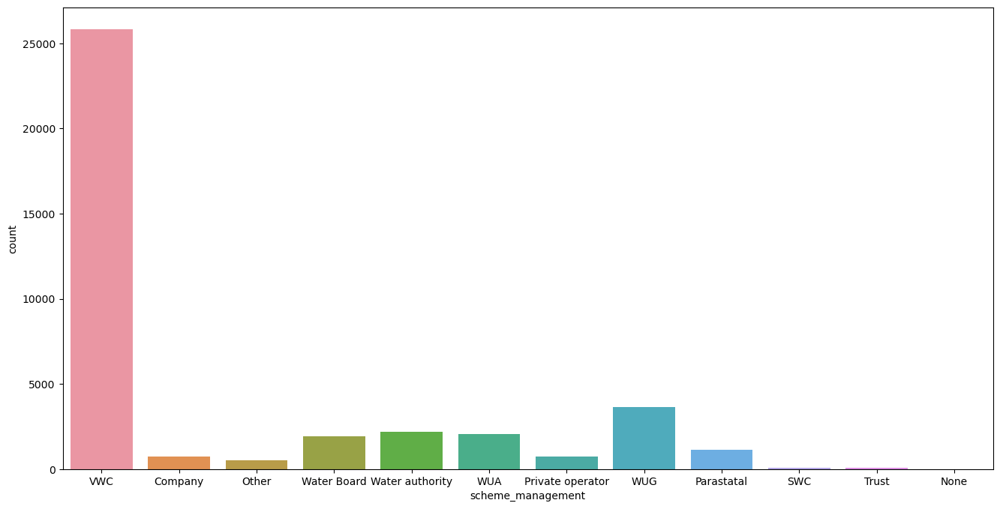

...

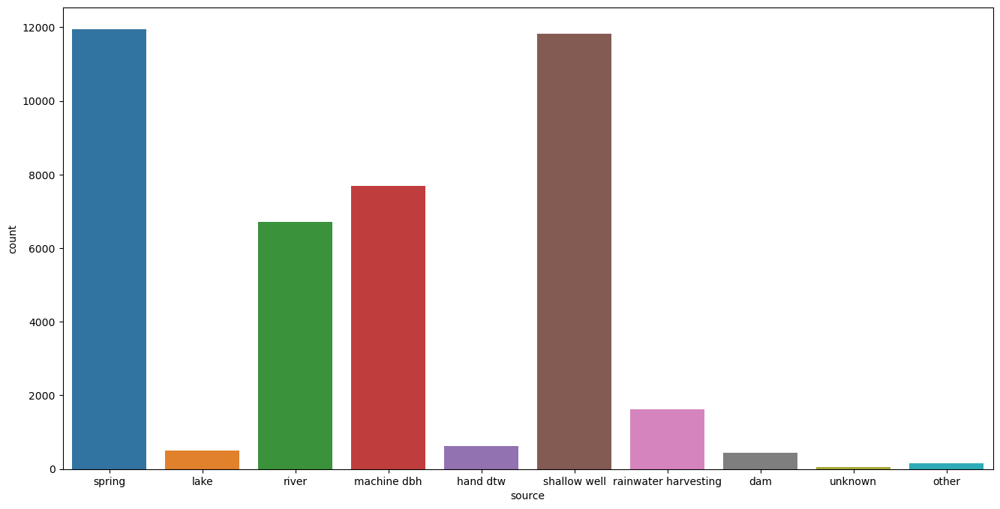

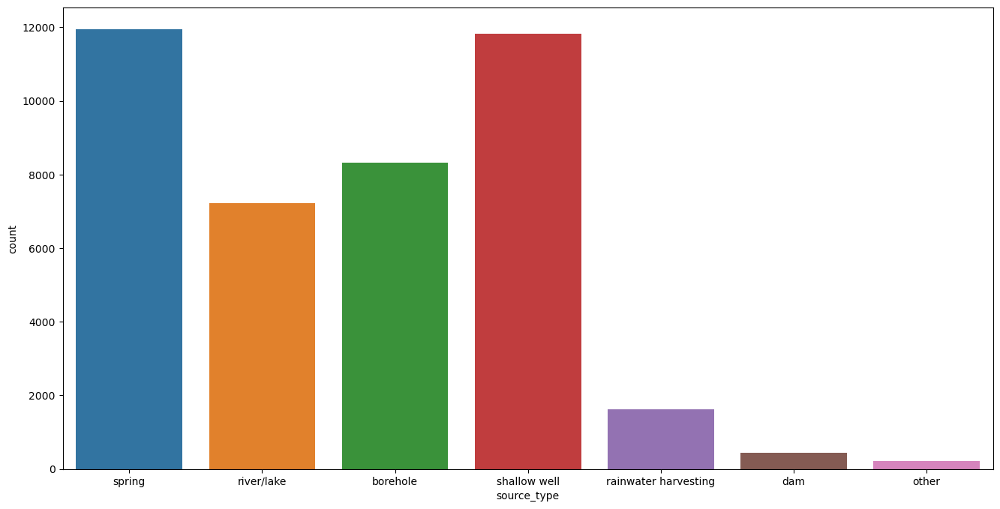

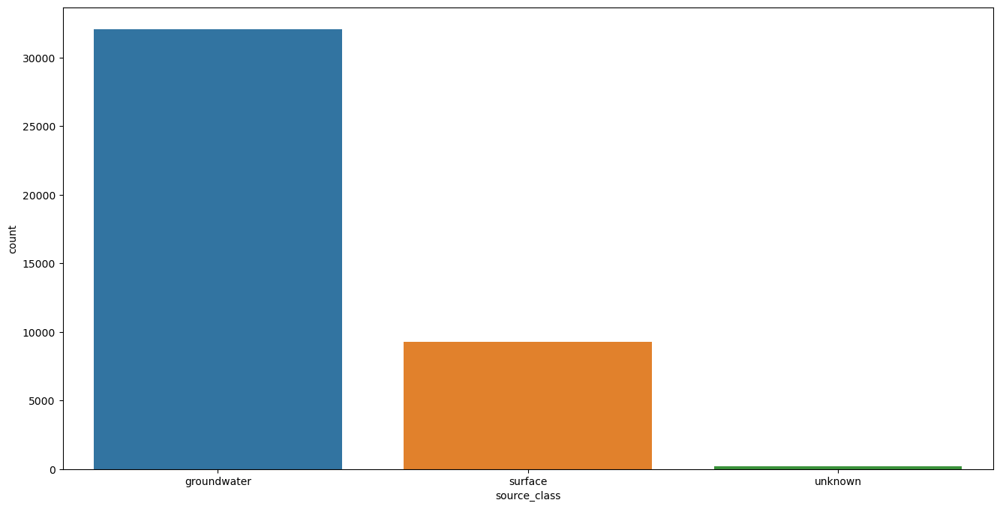

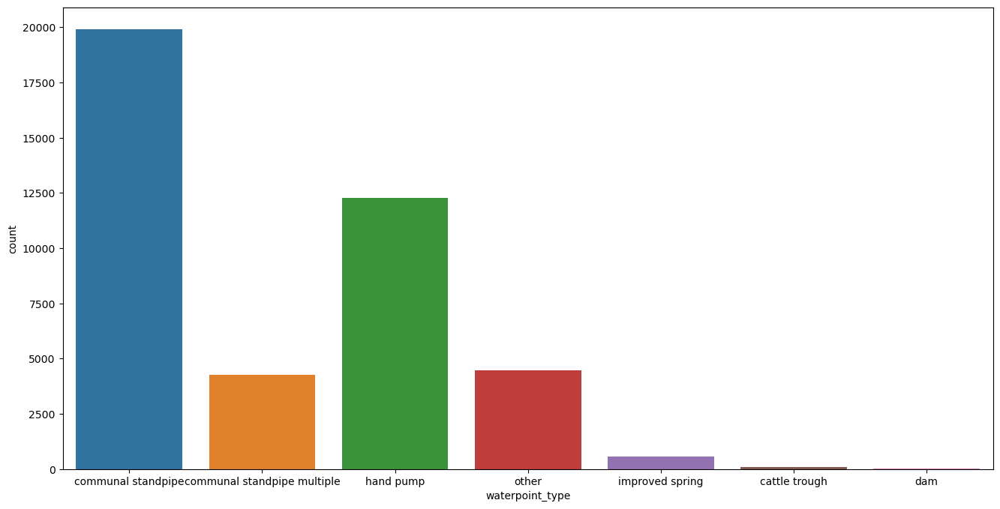

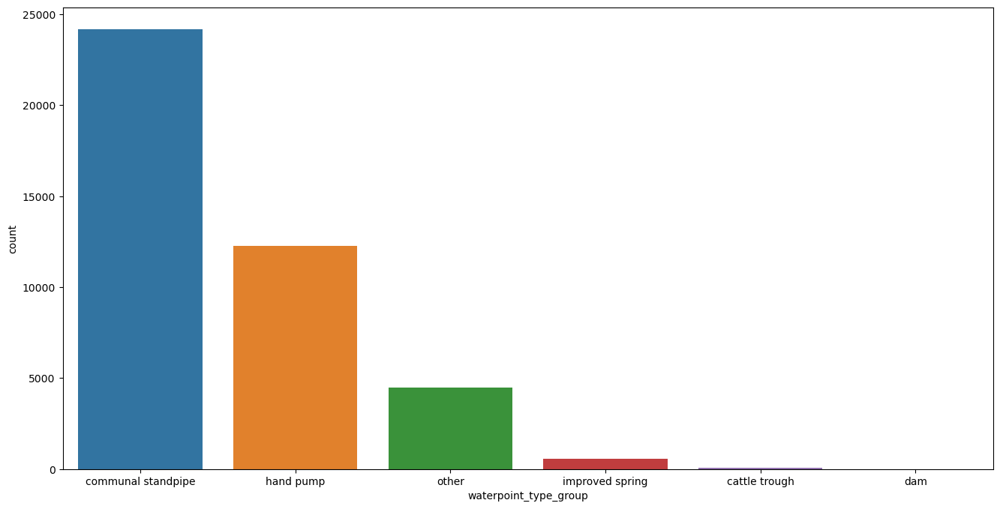

In [145]:
for i in list(cat_col):
    plt.figure(figsize=(16,8))
    sns.countplot(data=x_train,x=i)
    plt.show()

<Figure size 1600x800 with 0 Axes>

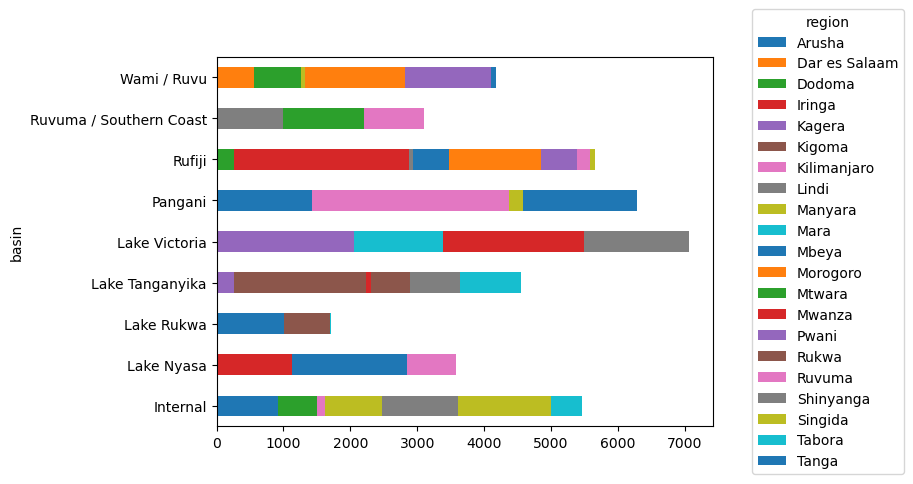

<Figure size 1600x800 with 0 Axes>

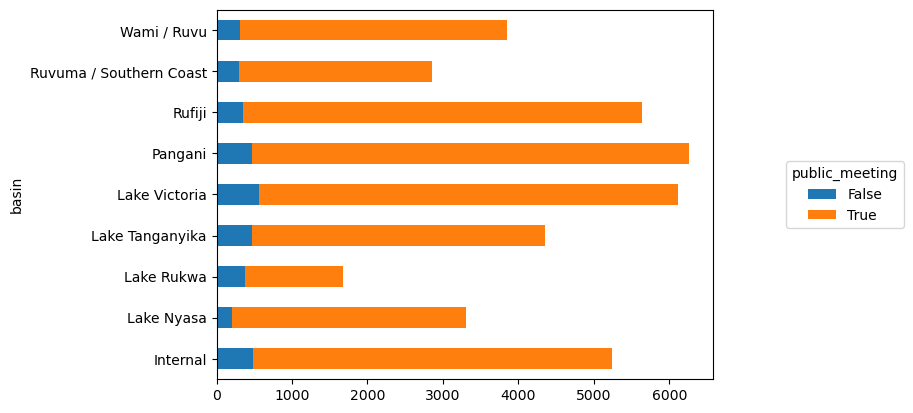

<Figure size 1600x800 with 0 Axes>

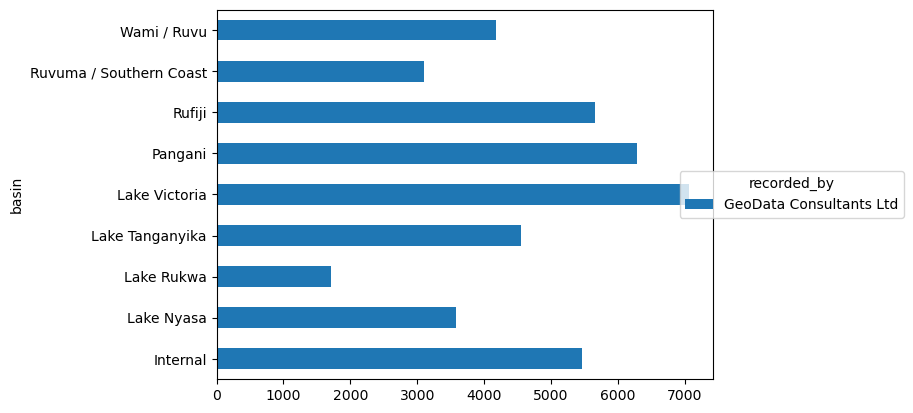

<Figure size 1600x800 with 0 Axes>

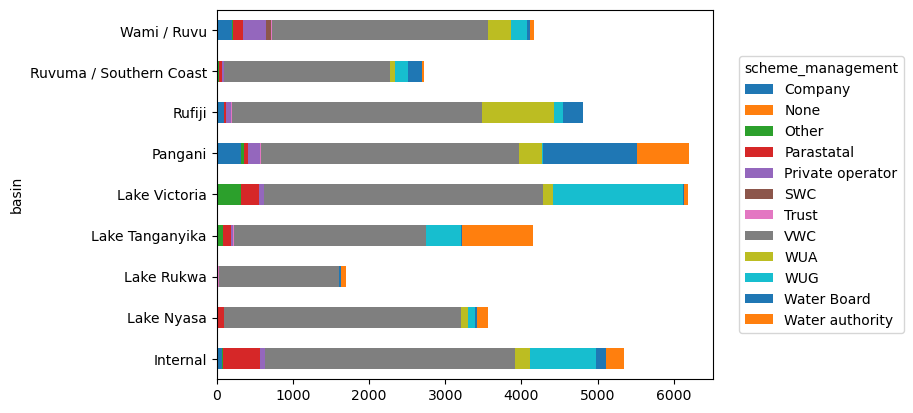

<Figure size 1600x800 with 0 Axes>

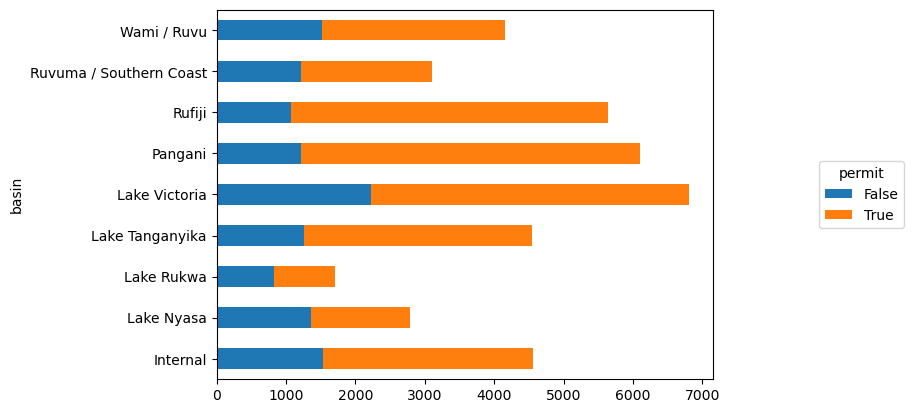

<Figure size 1600x800 with 0 Axes>

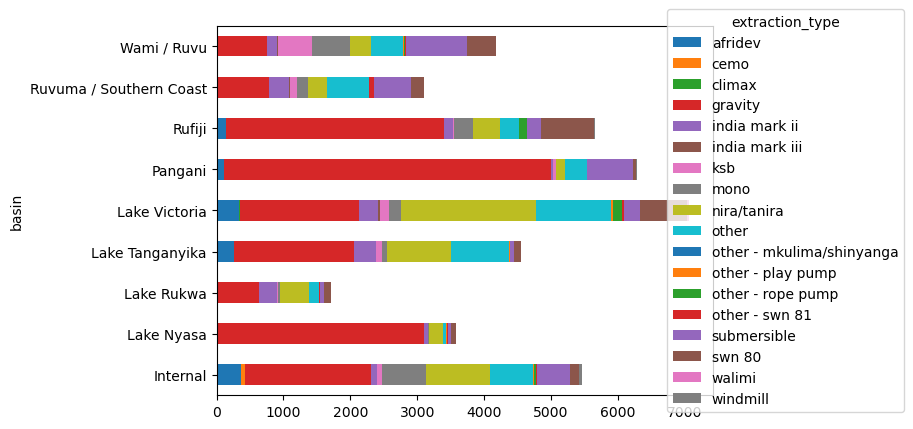

<Figure size 1600x800 with 0 Axes>

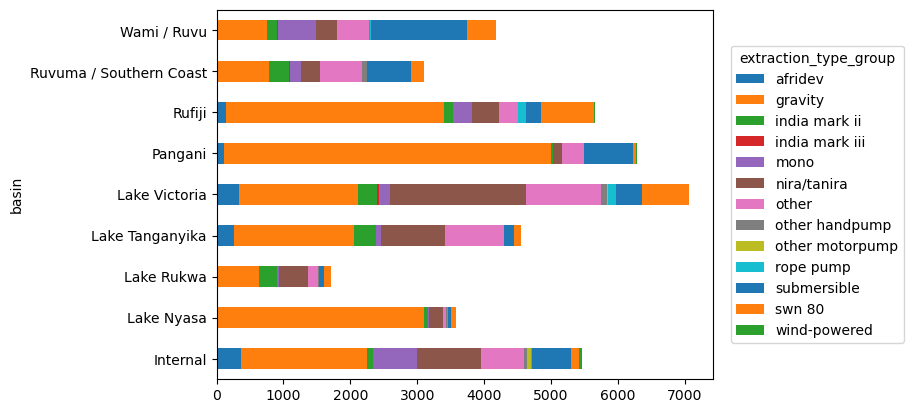

<Figure size 1600x800 with 0 Axes>

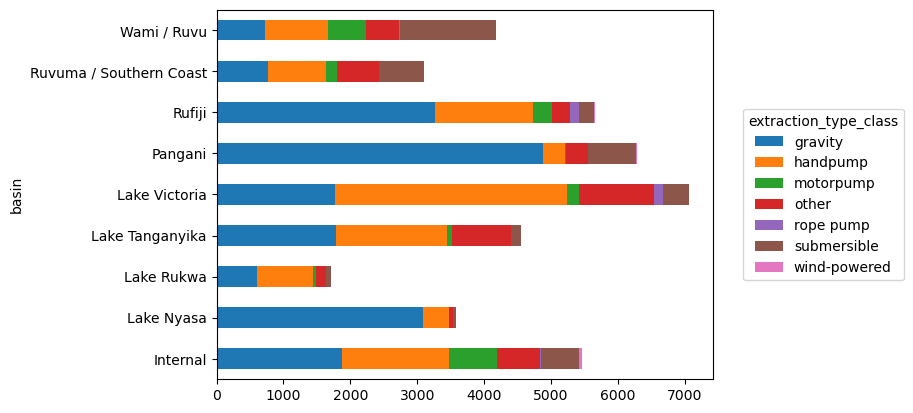

<Figure size 1600x800 with 0 Axes>

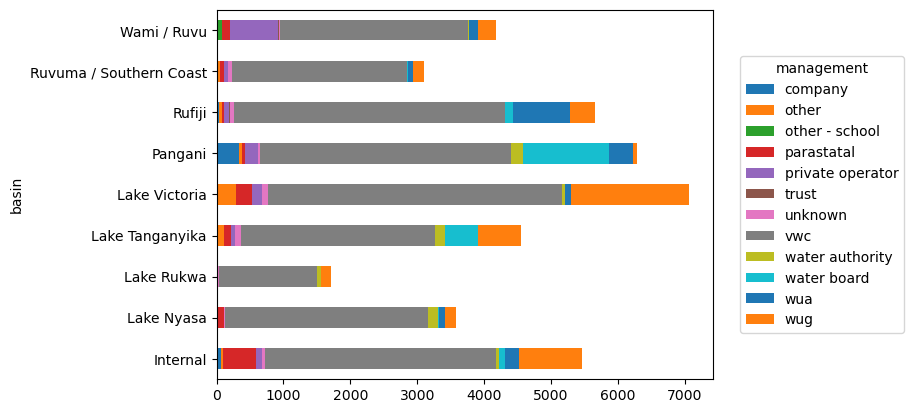

<Figure size 1600x800 with 0 Axes>

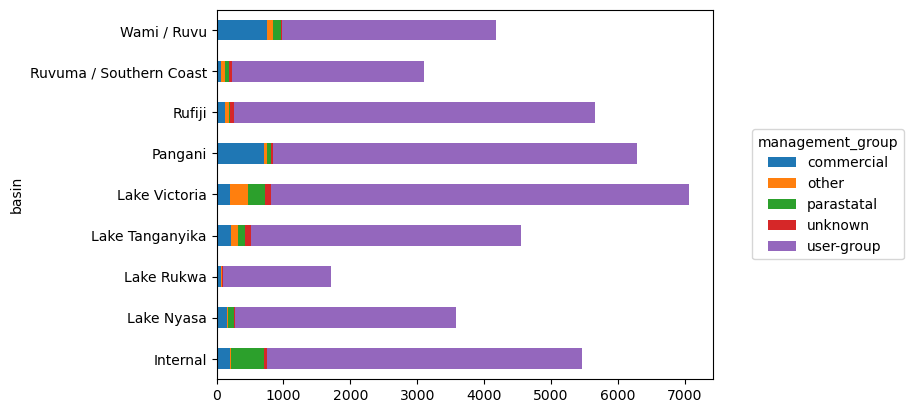

<Figure size 1600x800 with 0 Axes>

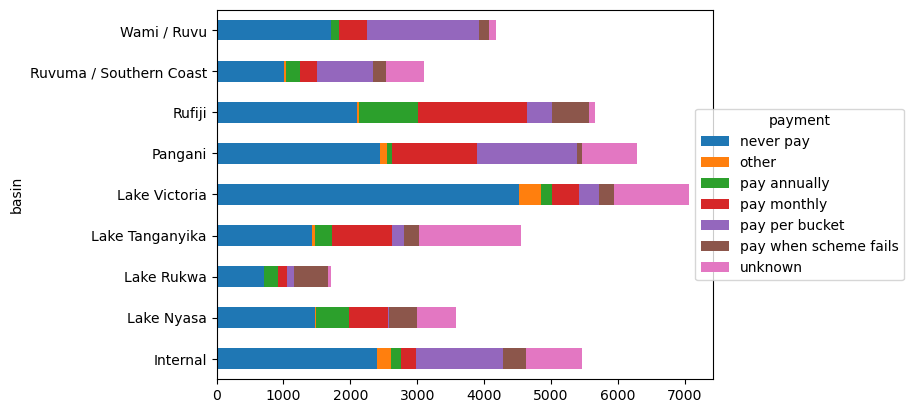

<Figure size 1600x800 with 0 Axes>

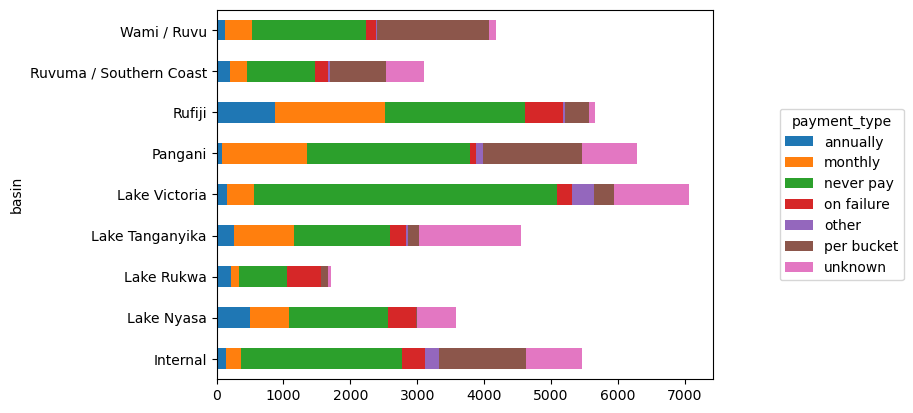

<Figure size 1600x800 with 0 Axes>

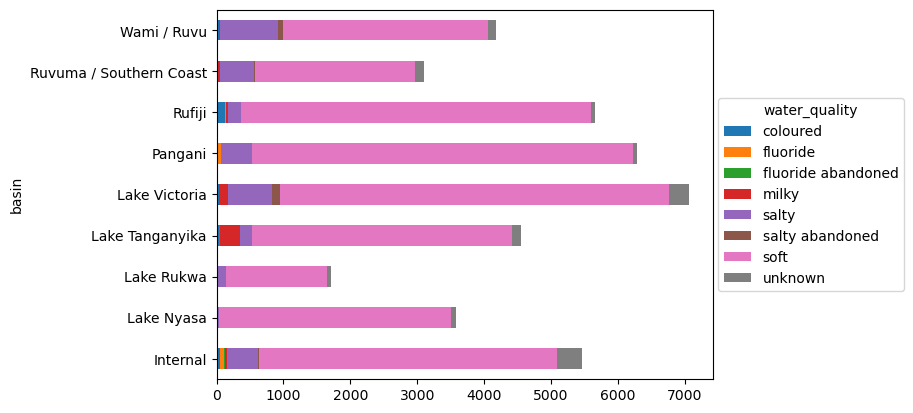

<Figure size 1600x800 with 0 Axes>

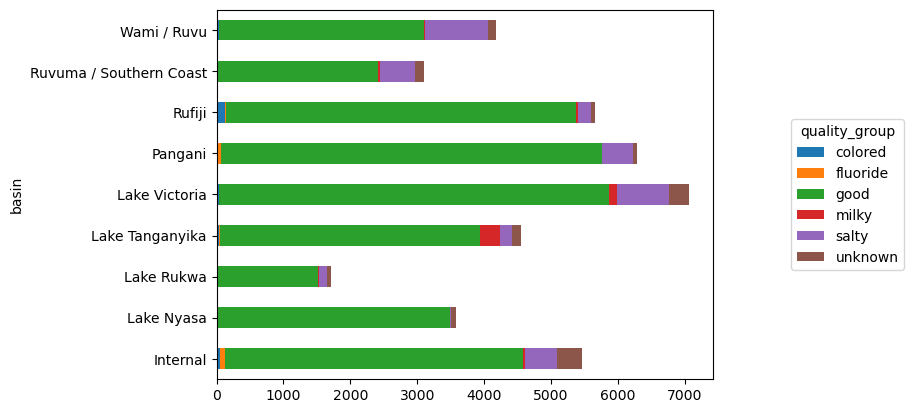

<Figure size 1600x800 with 0 Axes>

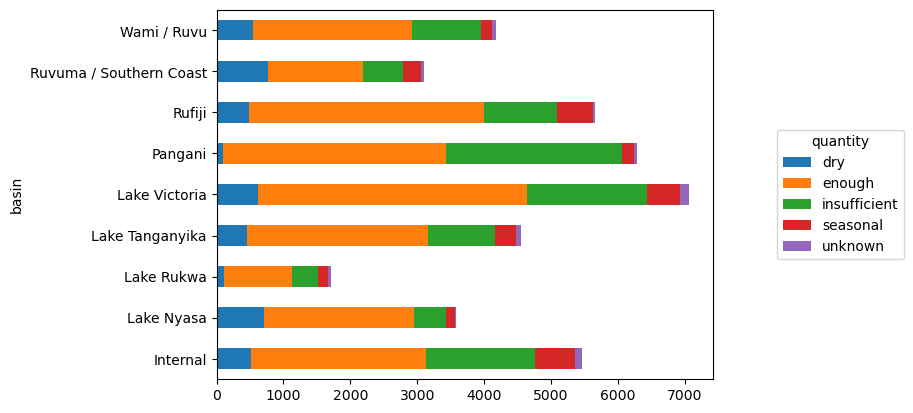

<Figure size 1600x800 with 0 Axes>

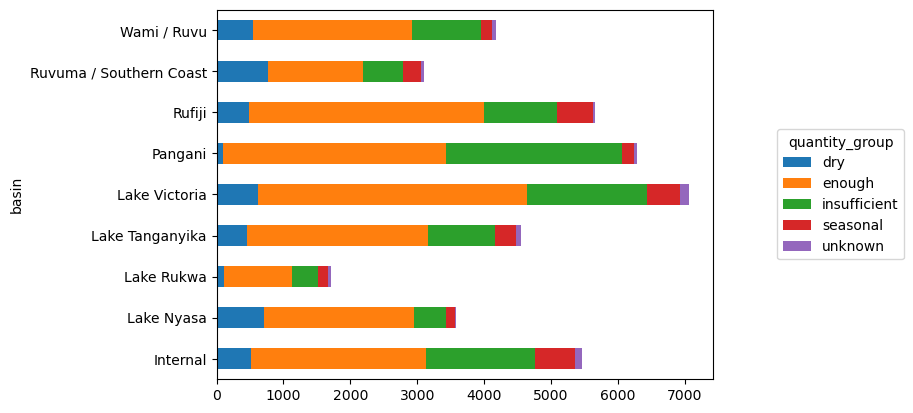

<Figure size 1600x800 with 0 Axes>

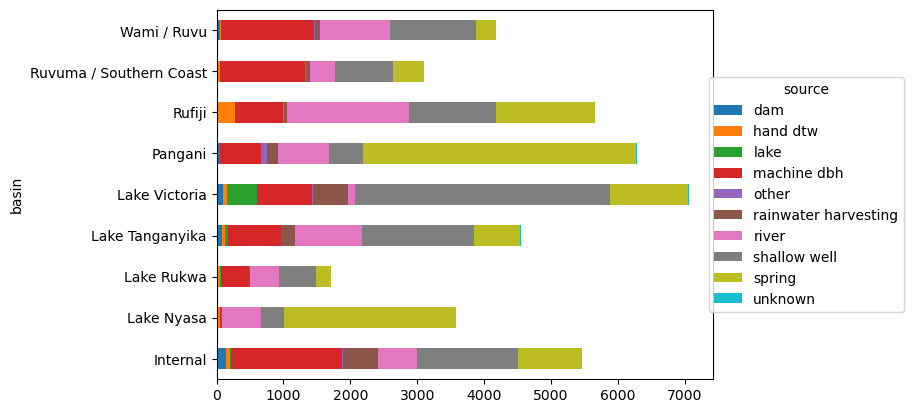

<Figure size 1600x800 with 0 Axes>

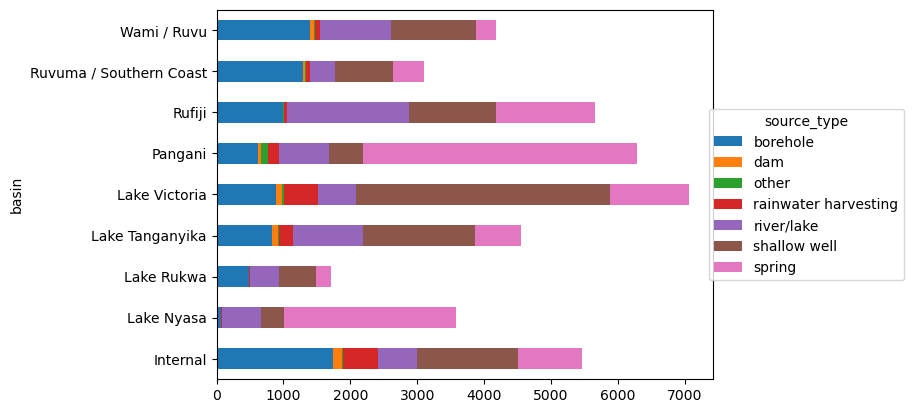

<Figure size 1600x800 with 0 Axes>

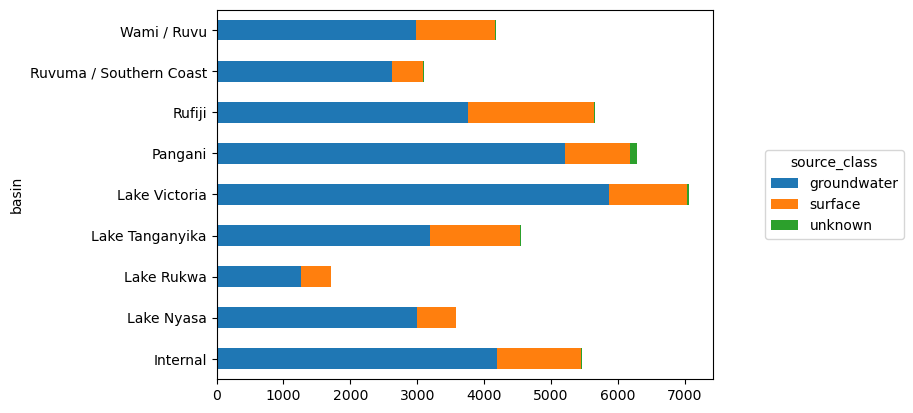

<Figure size 1600x800 with 0 Axes>

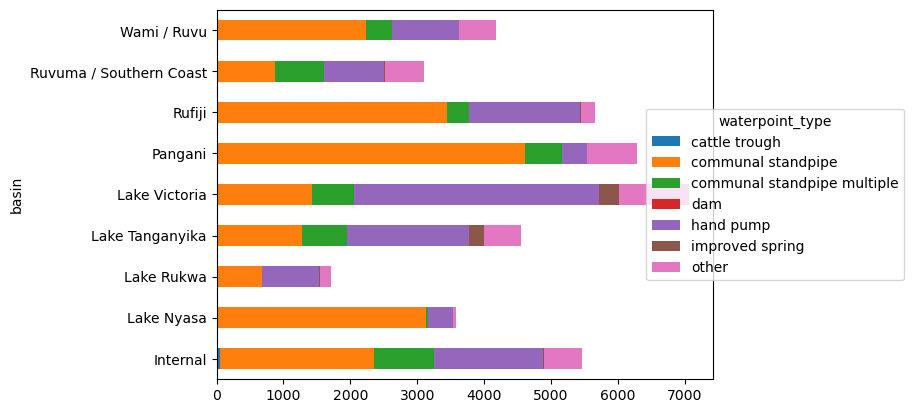

<Figure size 1600x800 with 0 Axes>

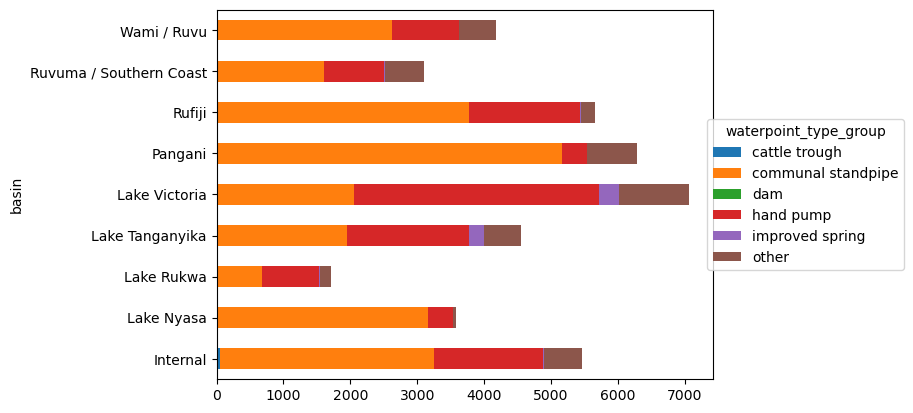

<Figure size 1600x800 with 0 Axes>

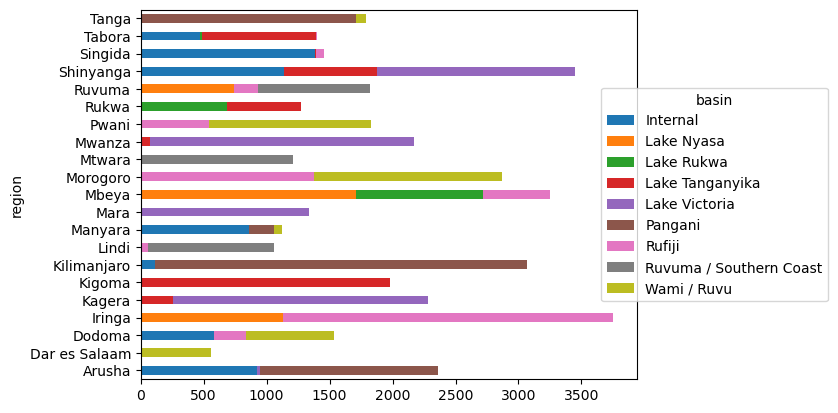

<Figure size 1600x800 with 0 Axes>

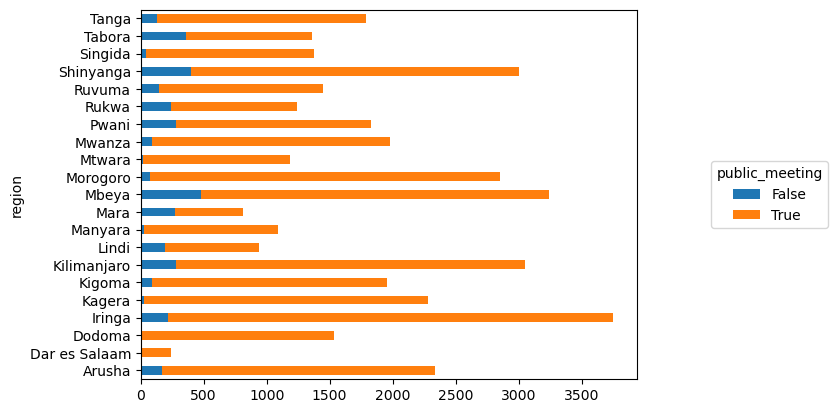

<Figure size 1600x800 with 0 Axes>

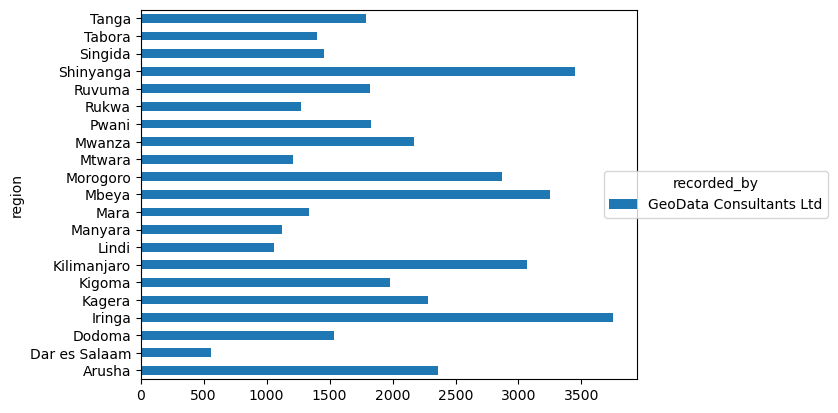

<Figure size 1600x800 with 0 Axes>

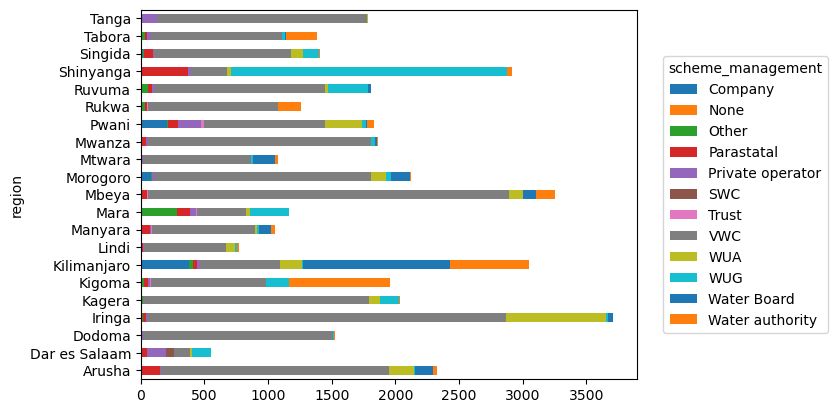

<Figure size 1600x800 with 0 Axes>

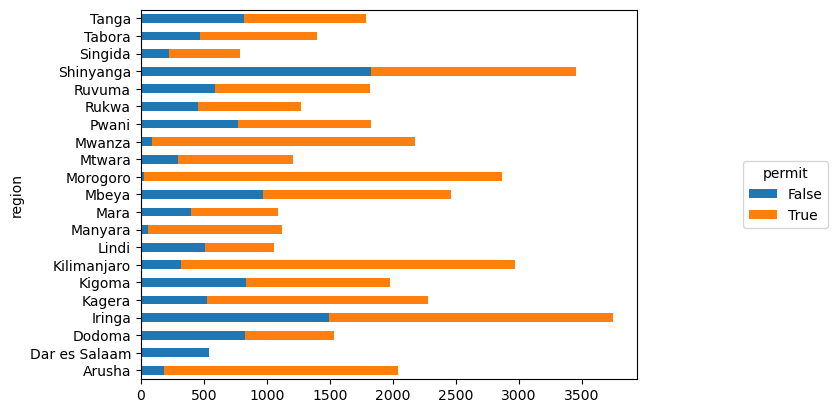

<Figure size 1600x800 with 0 Axes>

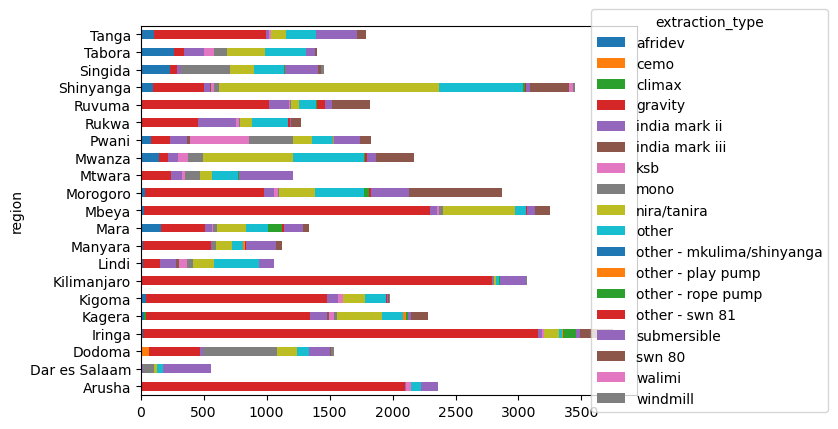

<Figure size 1600x800 with 0 Axes>

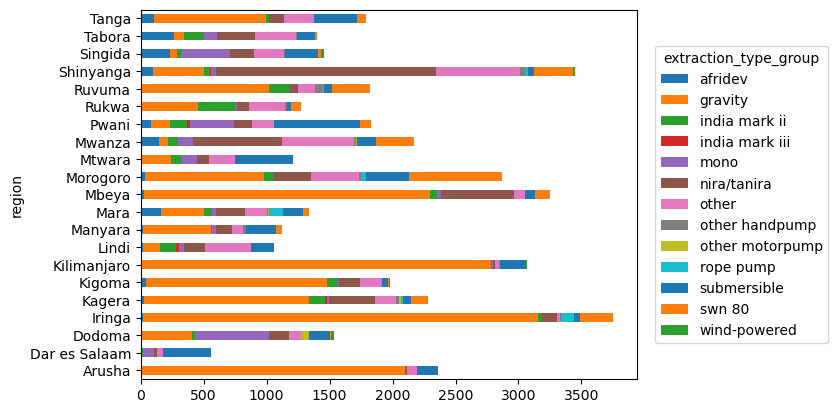

<Figure size 1600x800 with 0 Axes>

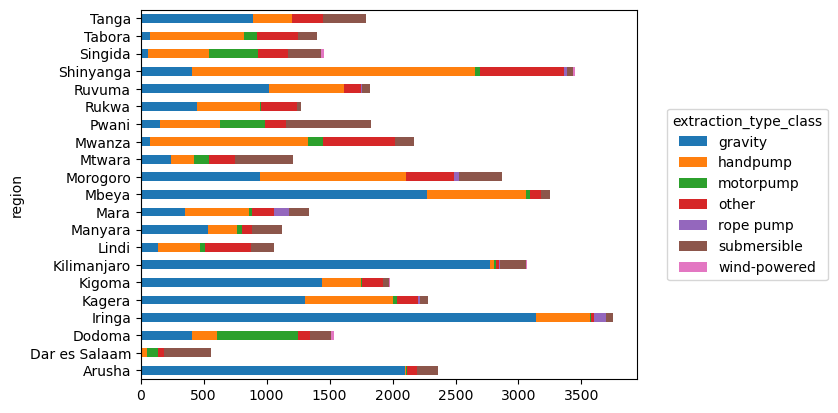

<Figure size 1600x800 with 0 Axes>

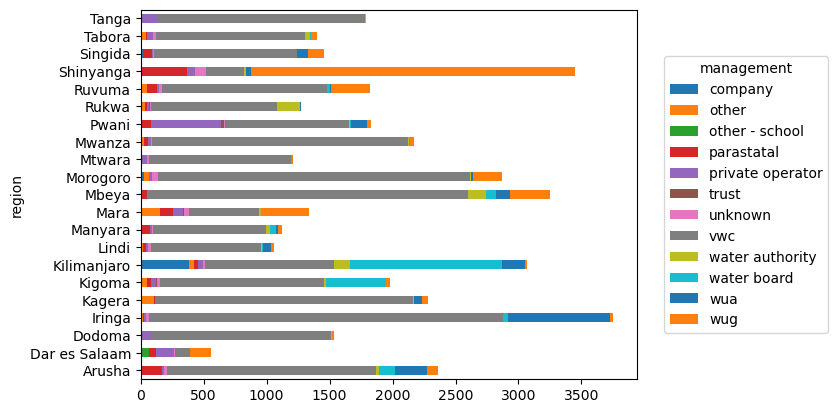

<Figure size 1600x800 with 0 Axes>

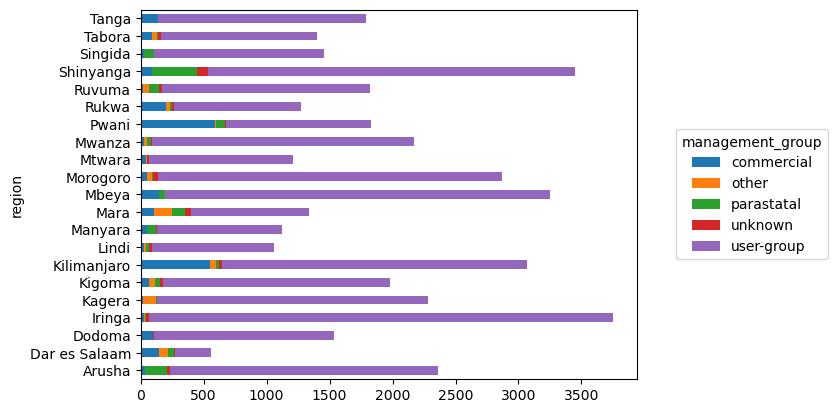

<Figure size 1600x800 with 0 Axes>

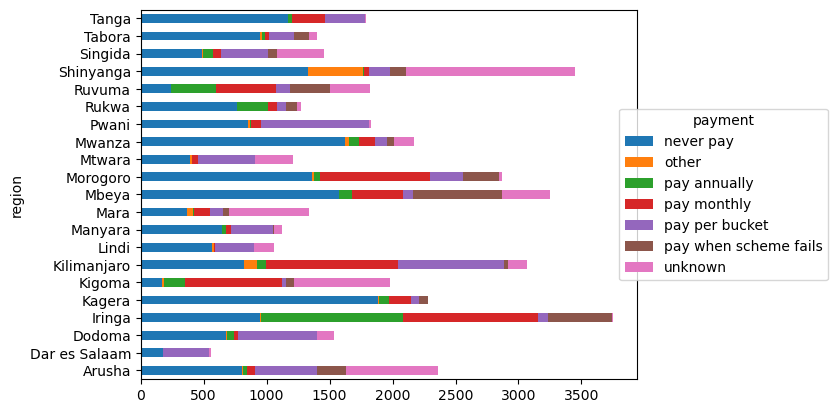

<Figure size 1600x800 with 0 Axes>

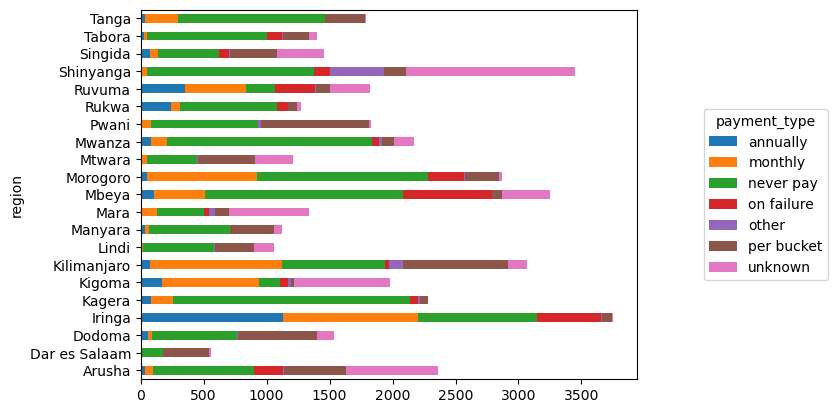

<Figure size 1600x800 with 0 Axes>

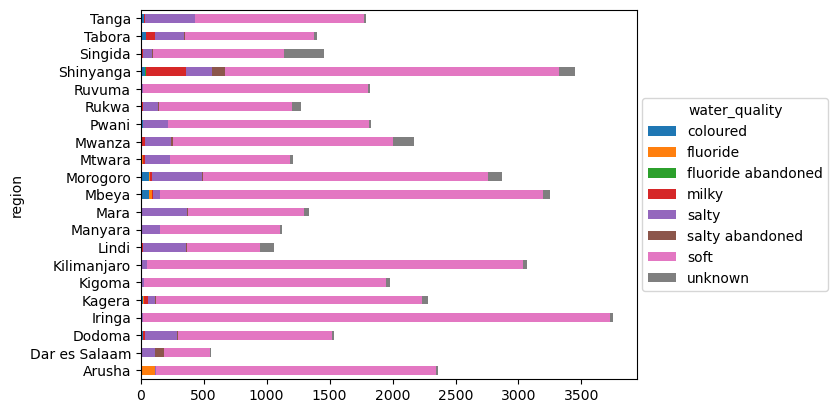

<Figure size 1600x800 with 0 Axes>

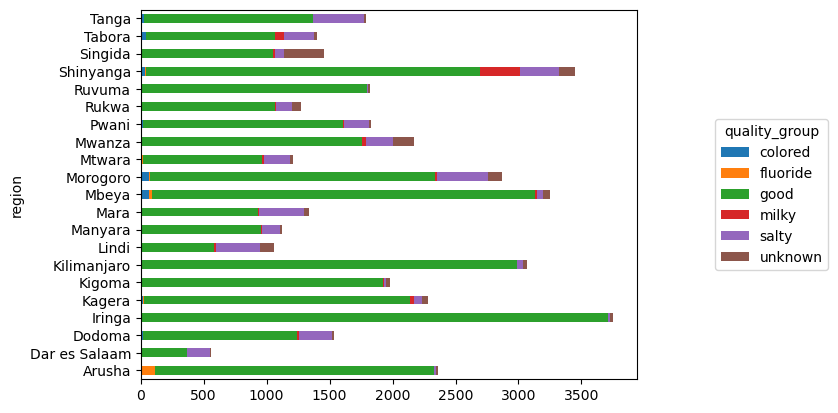

<Figure size 1600x800 with 0 Axes>

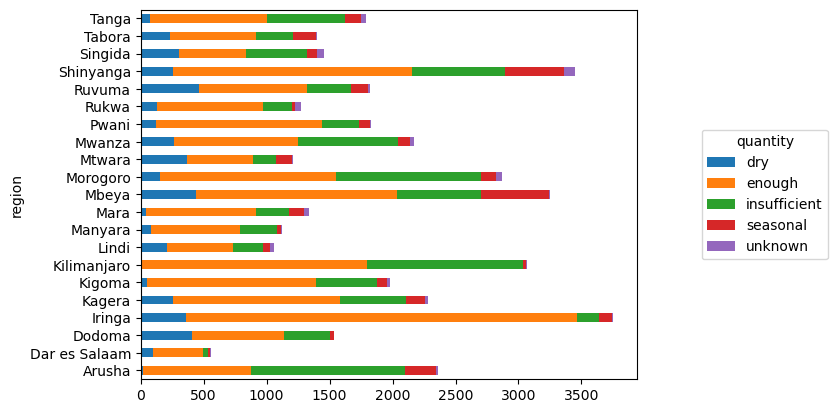

<Figure size 1600x800 with 0 Axes>

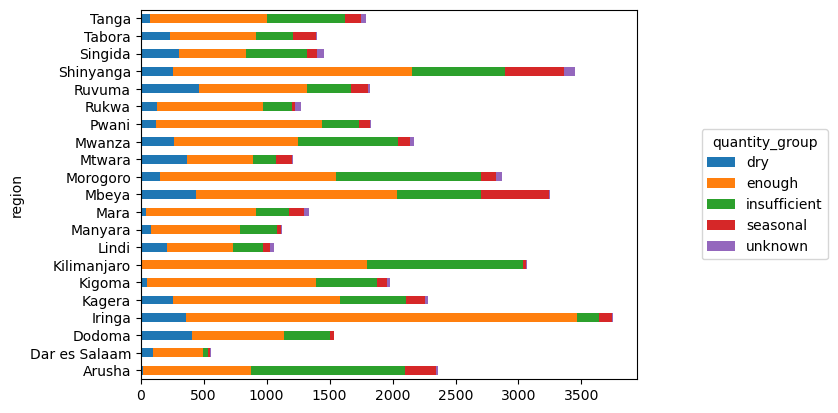

<Figure size 1600x800 with 0 Axes>

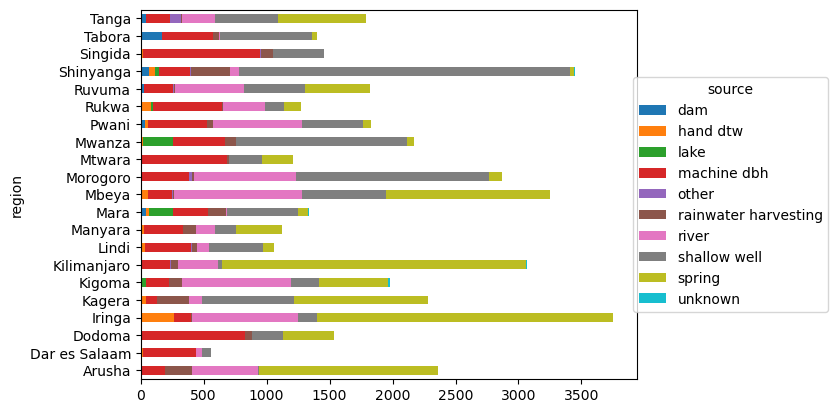

<Figure size 1600x800 with 0 Axes>

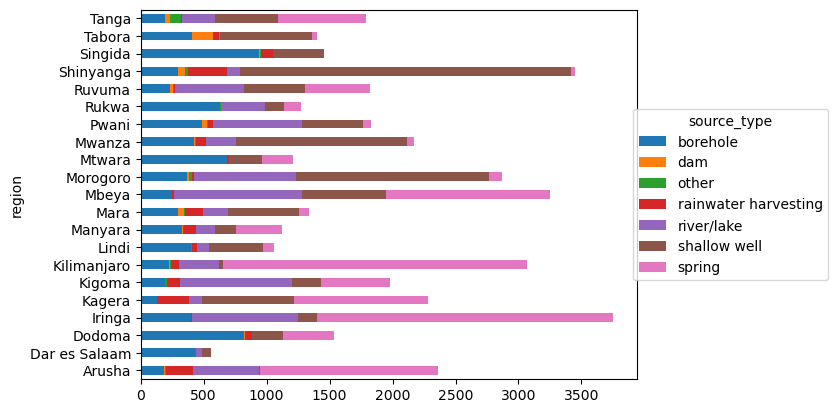

<Figure size 1600x800 with 0 Axes>

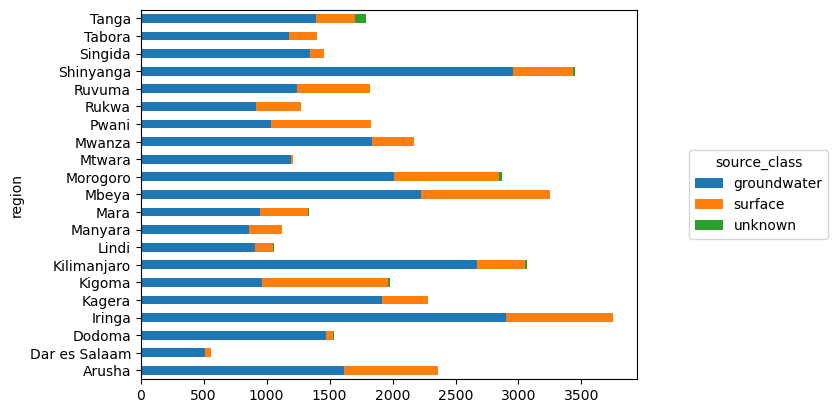

<Figure size 1600x800 with 0 Axes>

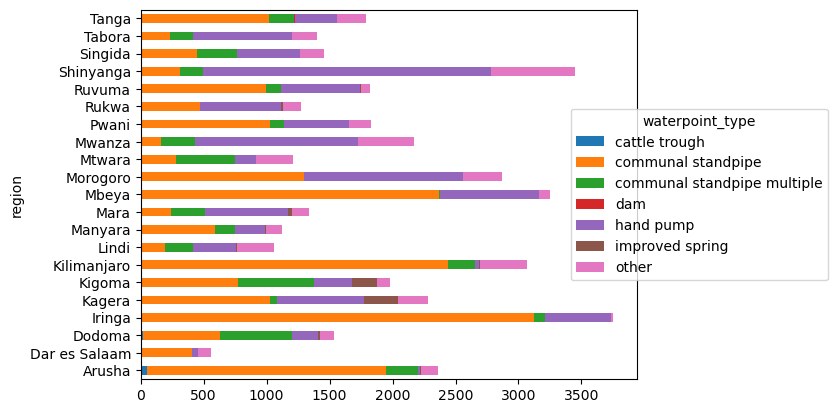

<Figure size 1600x800 with 0 Axes>

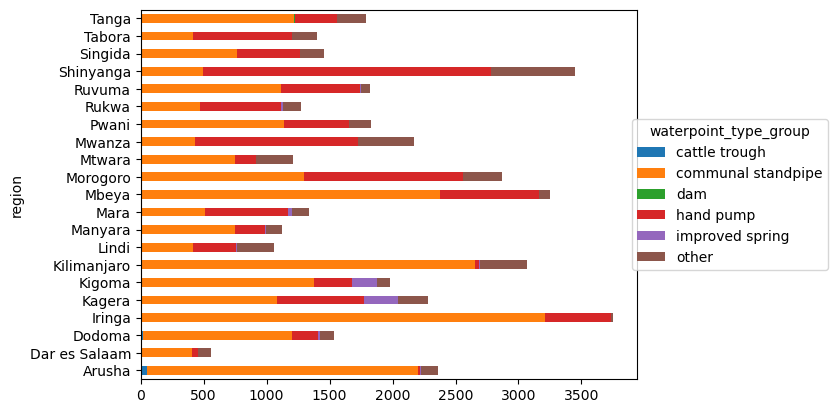

<Figure size 1600x800 with 0 Axes>

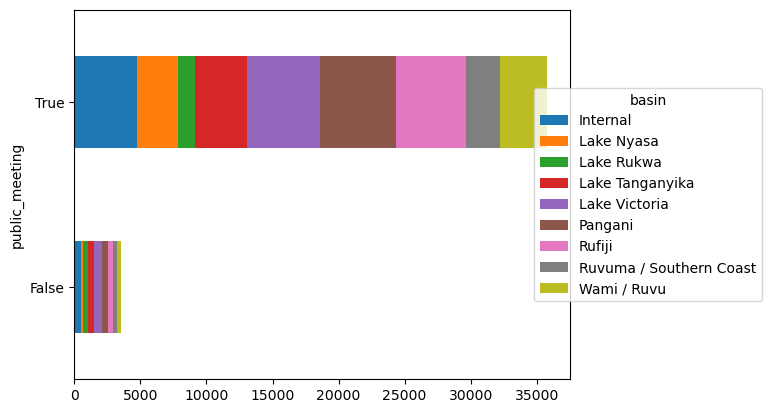

<Figure size 1600x800 with 0 Axes>

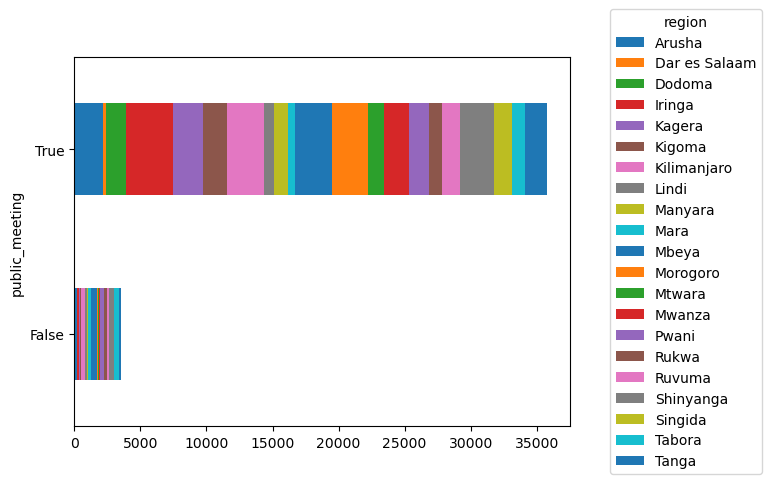

<Figure size 1600x800 with 0 Axes>

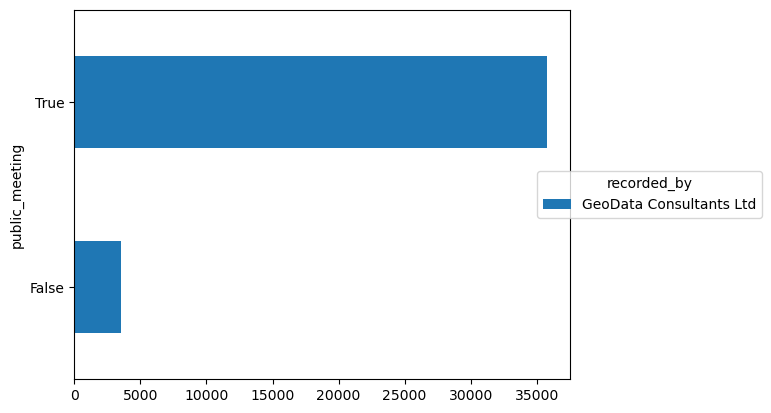

<Figure size 1600x800 with 0 Axes>

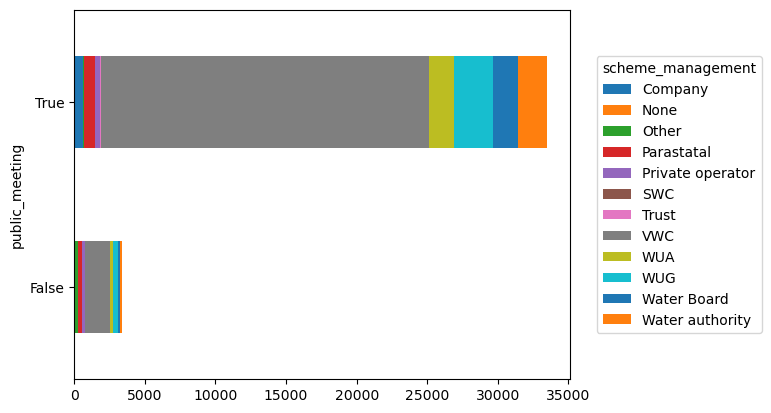

<Figure size 1600x800 with 0 Axes>

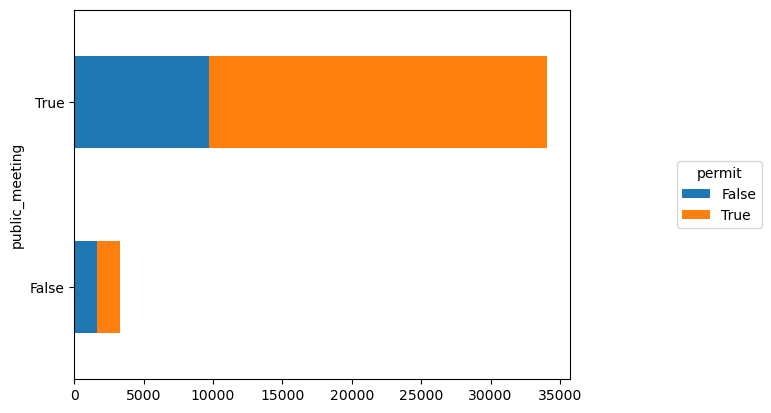

<Figure size 1600x800 with 0 Axes>

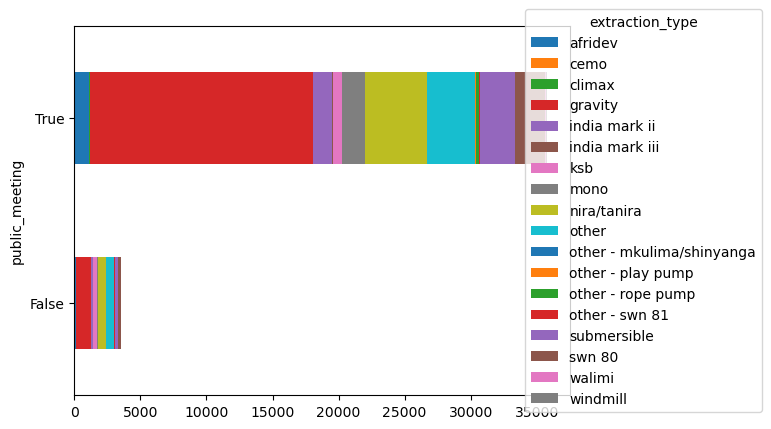

<Figure size 1600x800 with 0 Axes>

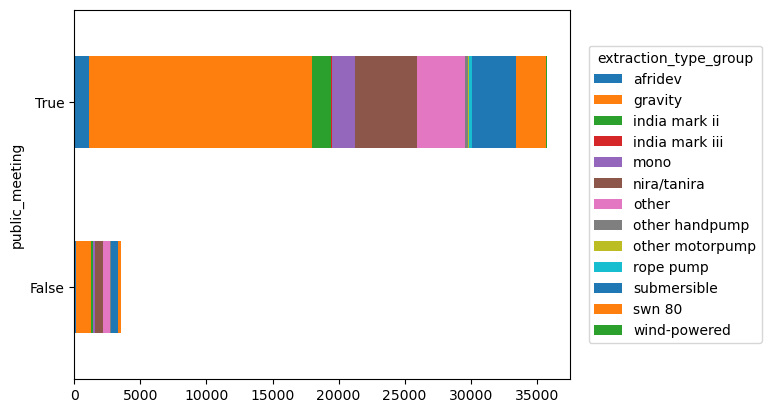

<Figure size 1600x800 with 0 Axes>

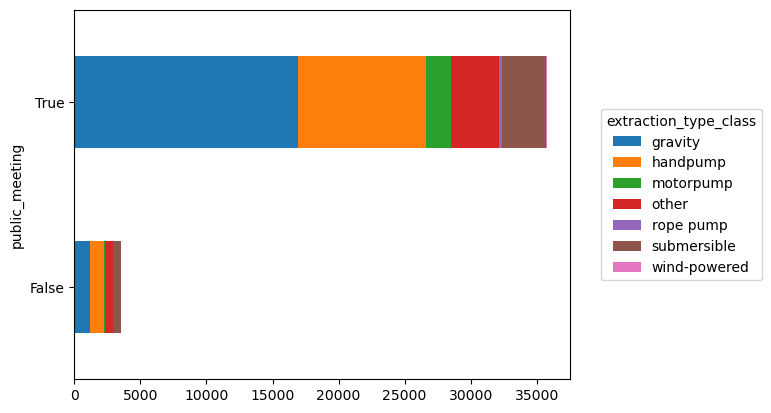

<Figure size 1600x800 with 0 Axes>

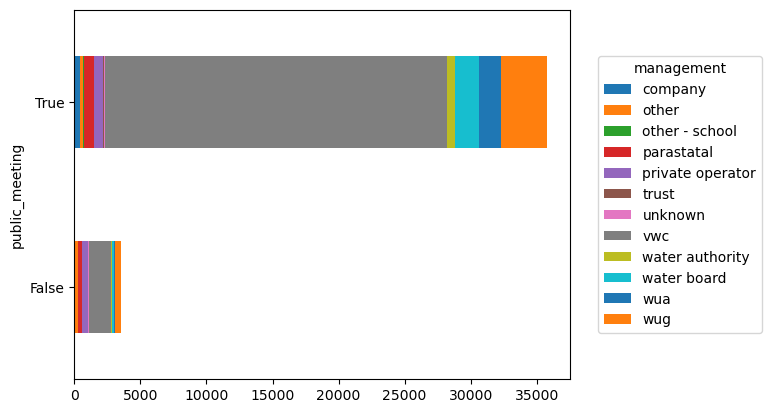

<Figure size 1600x800 with 0 Axes>

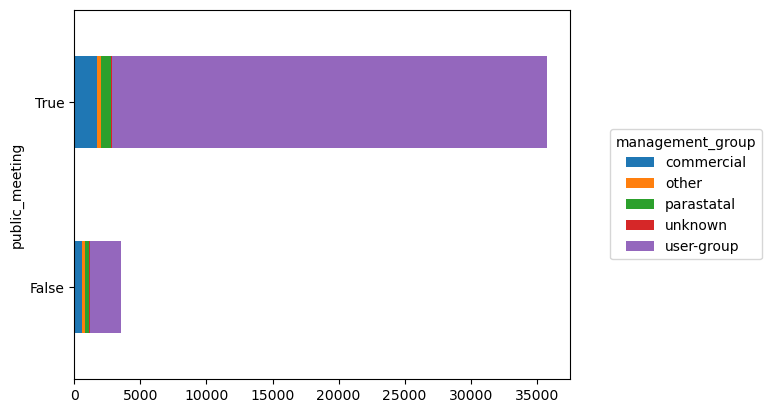

<Figure size 1600x800 with 0 Axes>

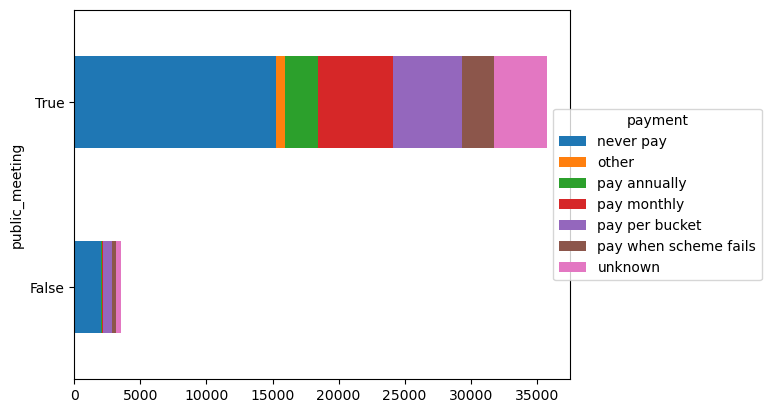

<Figure size 1600x800 with 0 Axes>

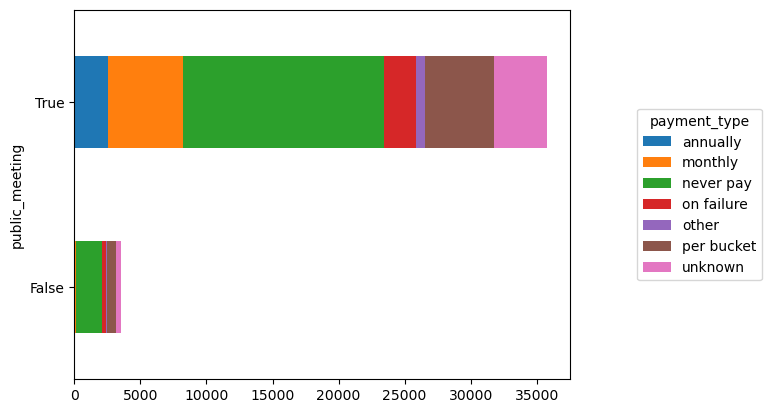

<Figure size 1600x800 with 0 Axes>

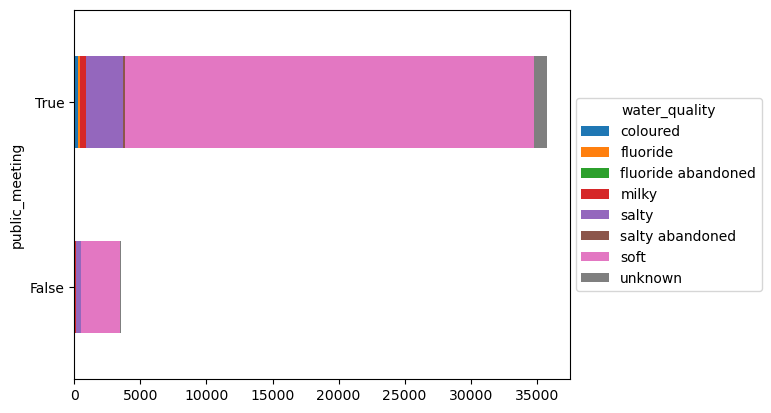

<Figure size 1600x800 with 0 Axes>

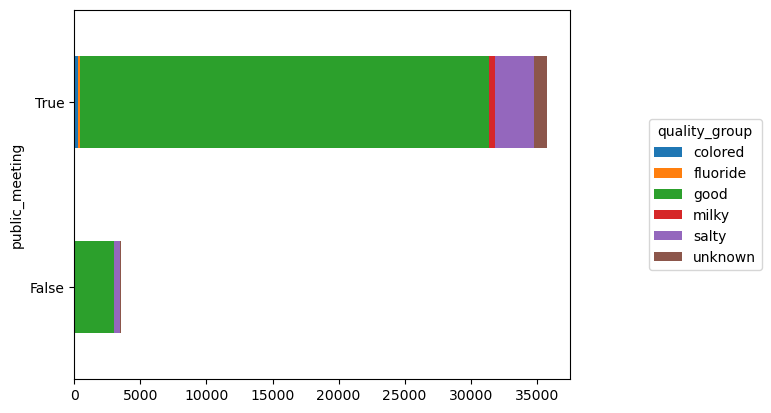

<Figure size 1600x800 with 0 Axes>

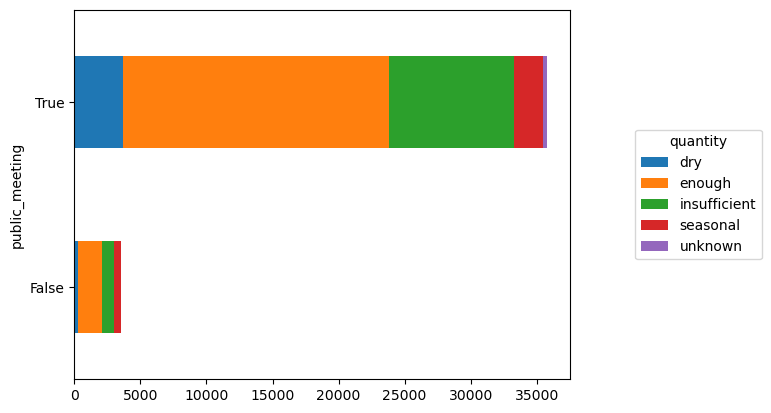

<Figure size 1600x800 with 0 Axes>

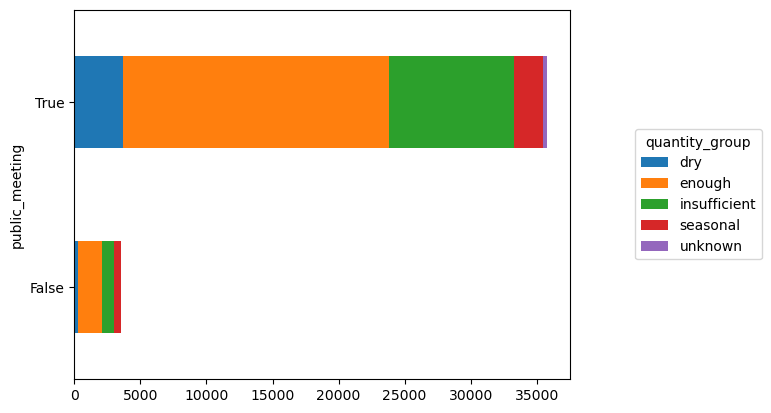

<Figure size 1600x800 with 0 Axes>

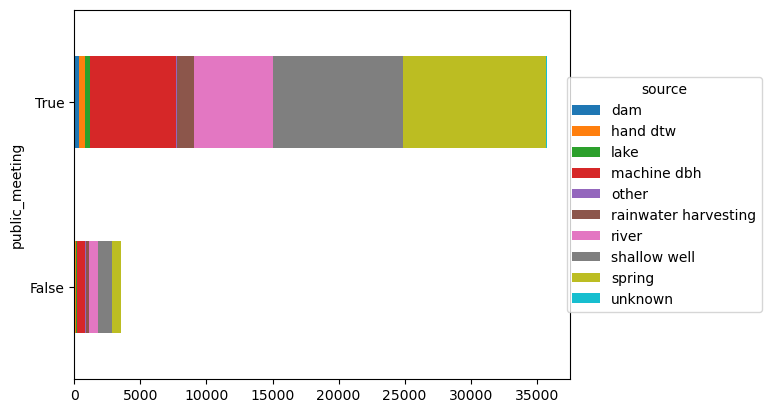

<Figure size 1600x800 with 0 Axes>

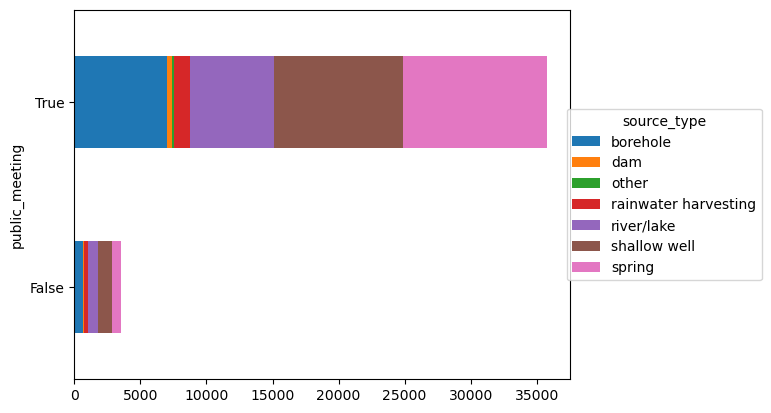

<Figure size 1600x800 with 0 Axes>

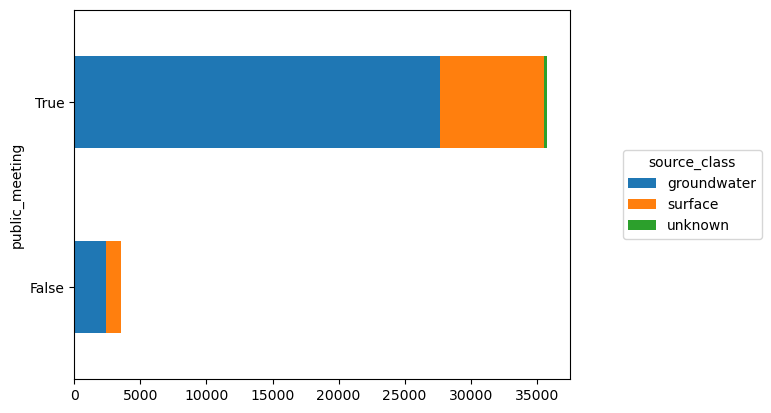

<Figure size 1600x800 with 0 Axes>

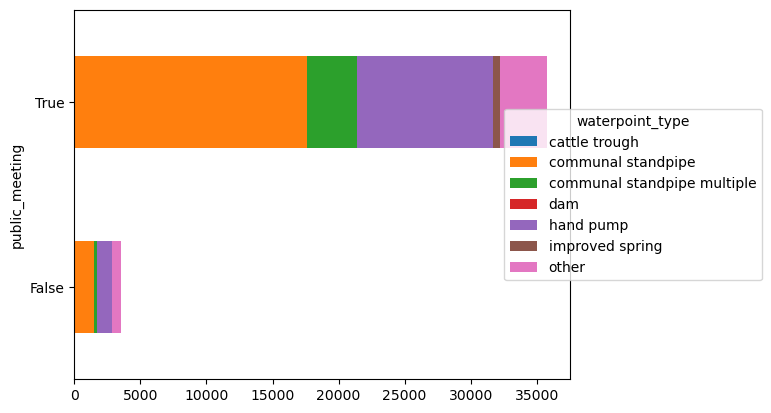

<Figure size 1600x800 with 0 Axes>

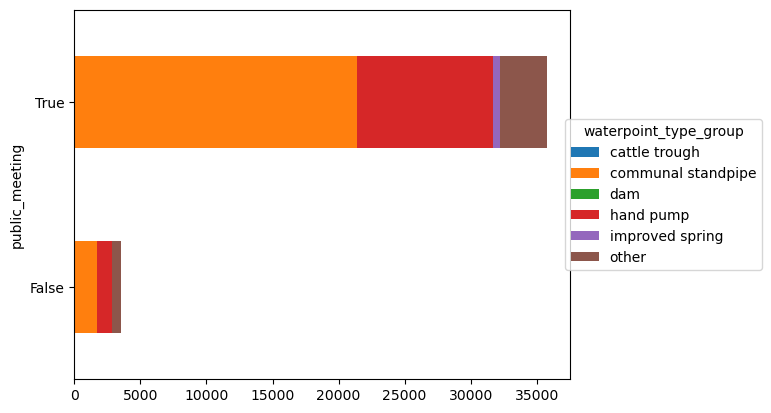

<Figure size 1600x800 with 0 Axes>

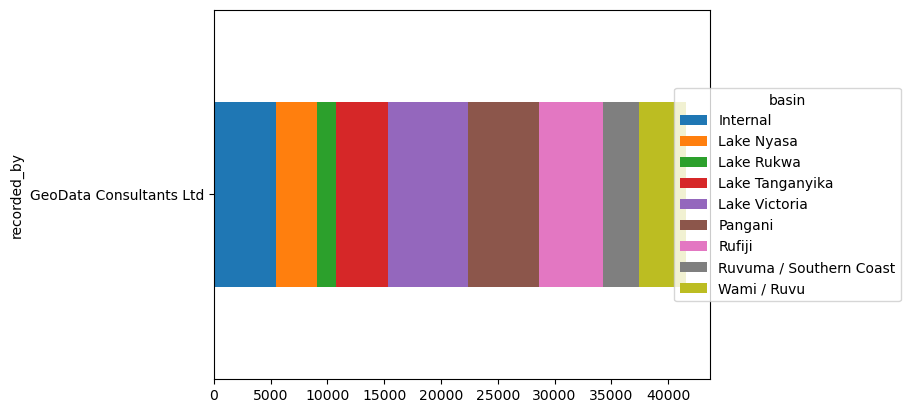

<Figure size 1600x800 with 0 Axes>

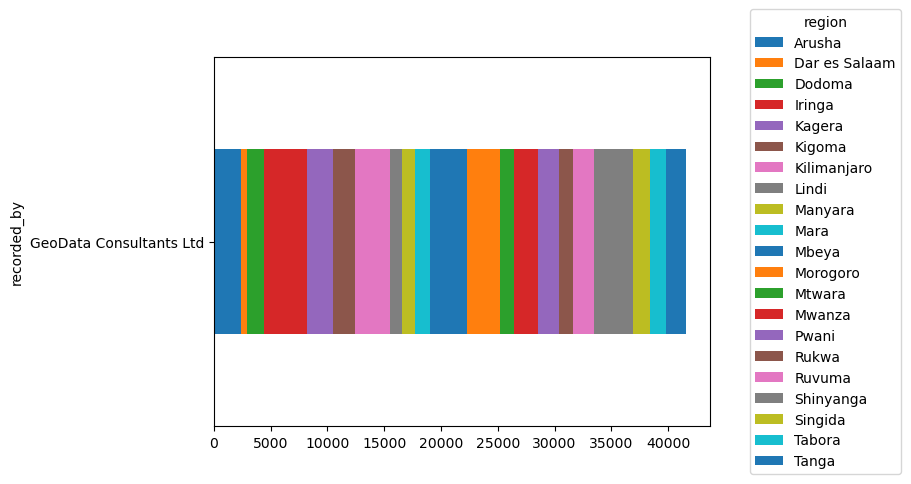

<Figure size 1600x800 with 0 Axes>

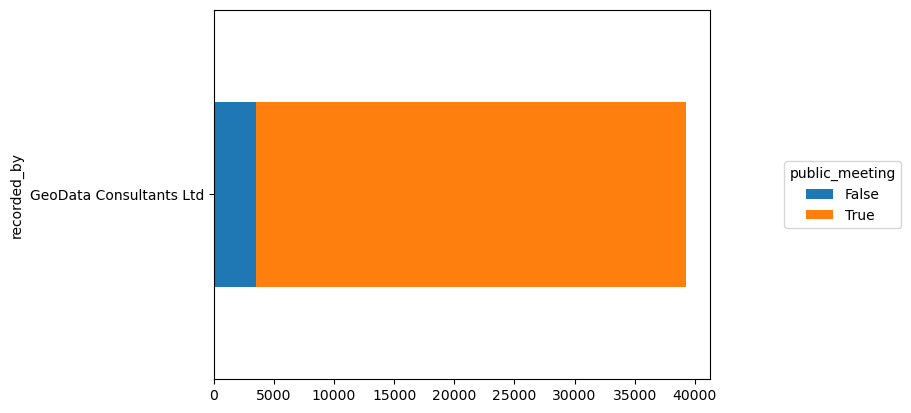

<Figure size 1600x800 with 0 Axes>

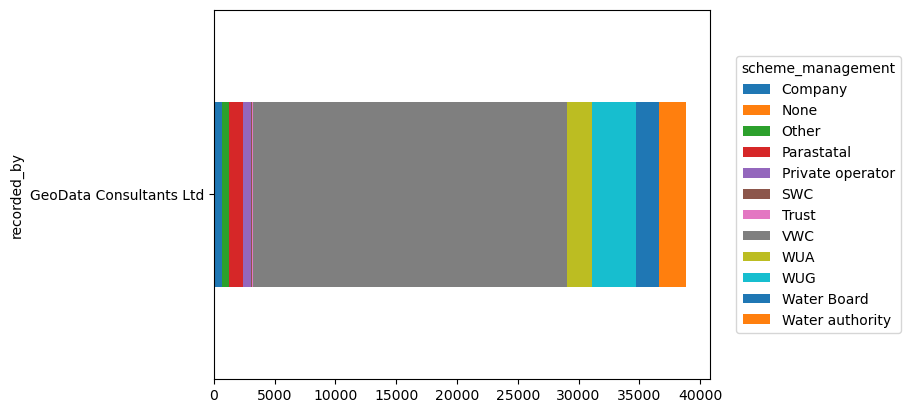

<Figure size 1600x800 with 0 Axes>

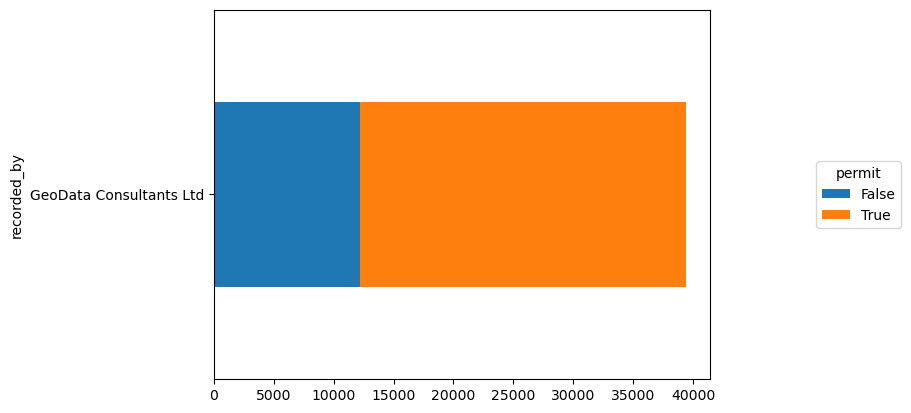

<Figure size 1600x800 with 0 Axes>

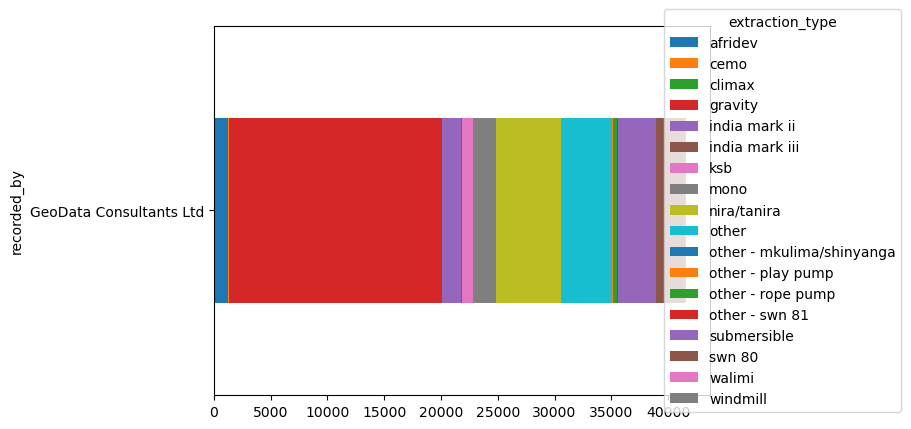

<Figure size 1600x800 with 0 Axes>

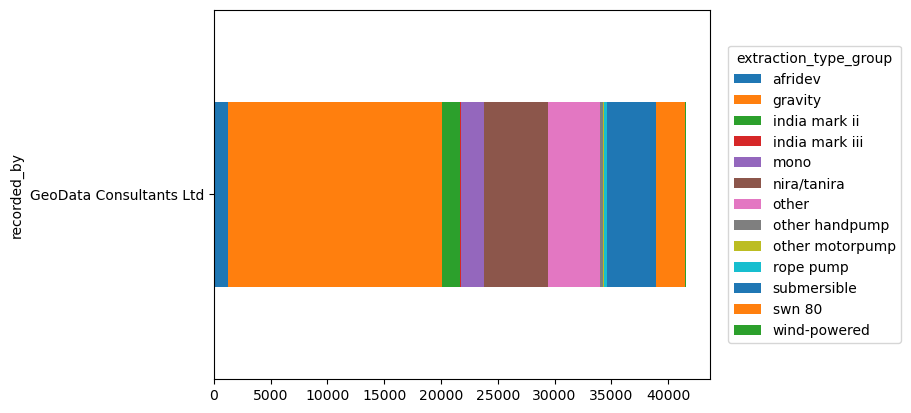

<Figure size 1600x800 with 0 Axes>

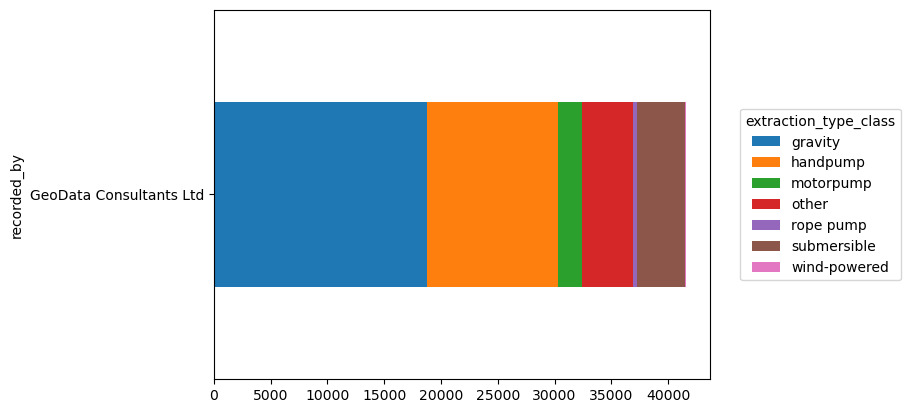

<Figure size 1600x800 with 0 Axes>

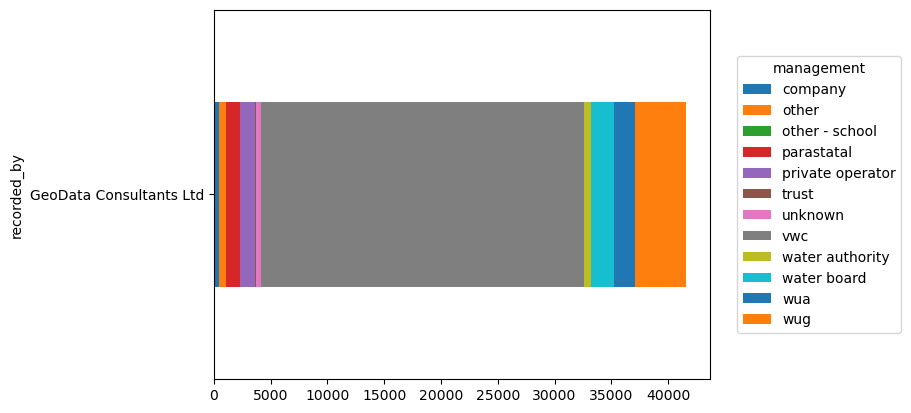

<Figure size 1600x800 with 0 Axes>

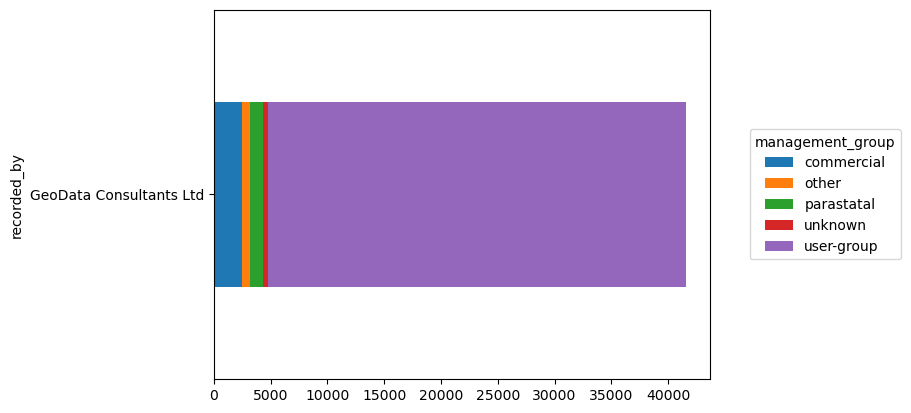

<Figure size 1600x800 with 0 Axes>

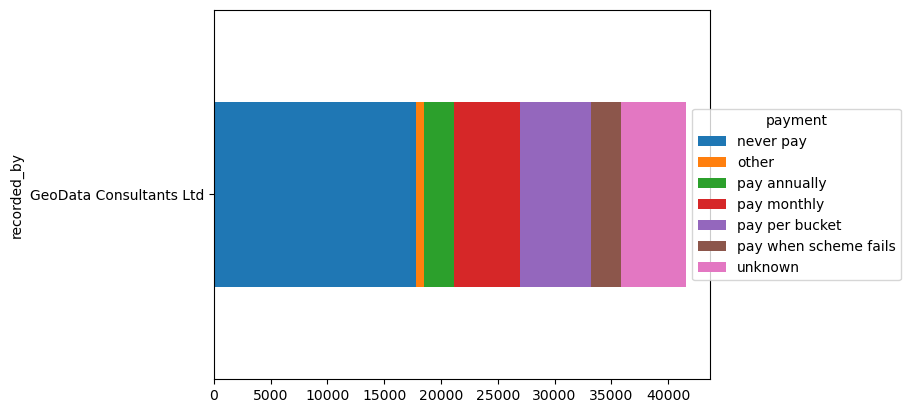

<Figure size 1600x800 with 0 Axes>

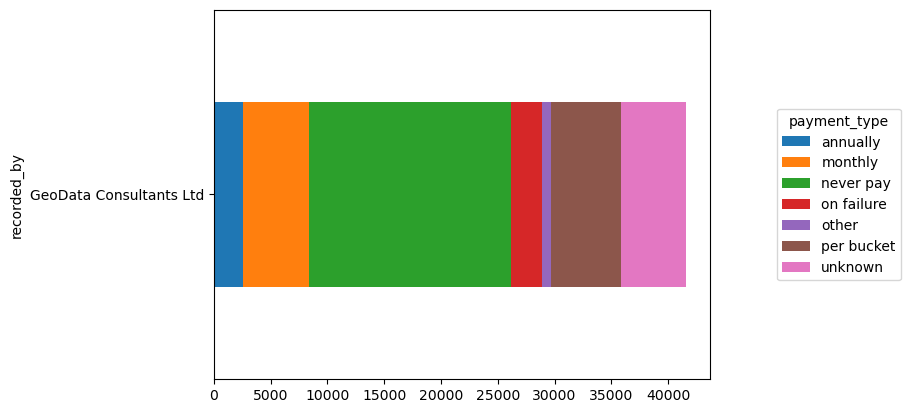

<Figure size 1600x800 with 0 Axes>

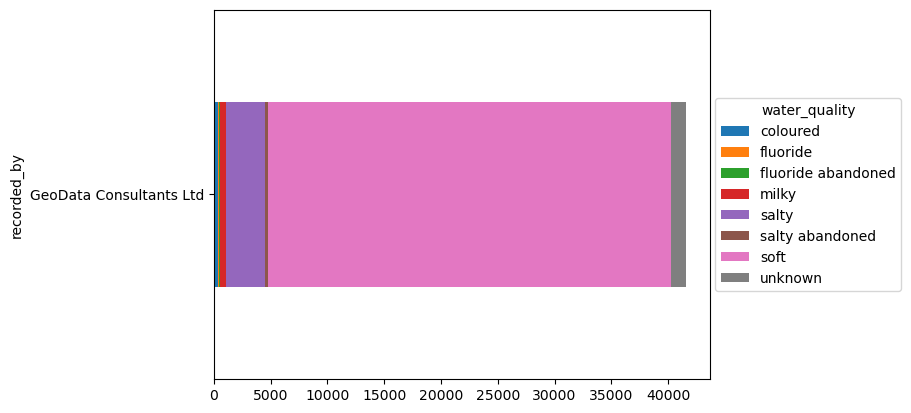

<Figure size 1600x800 with 0 Axes>

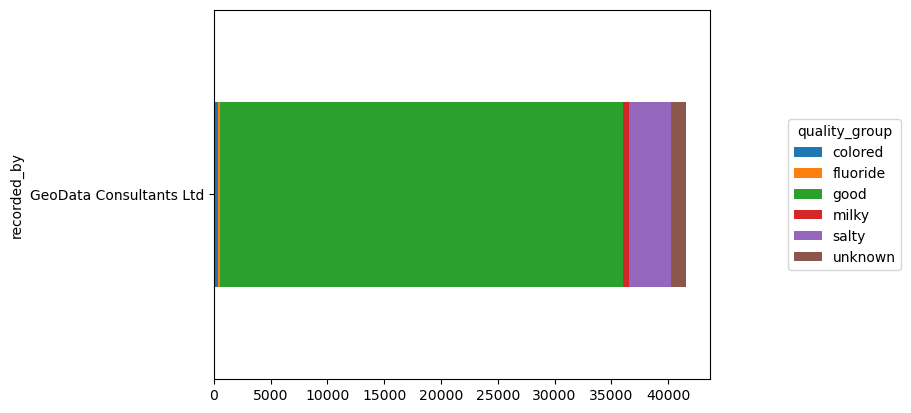

<Figure size 1600x800 with 0 Axes>

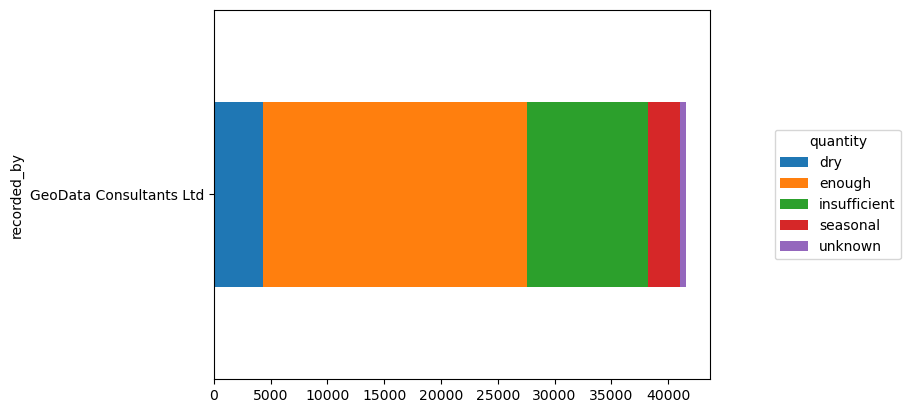

<Figure size 1600x800 with 0 Axes>

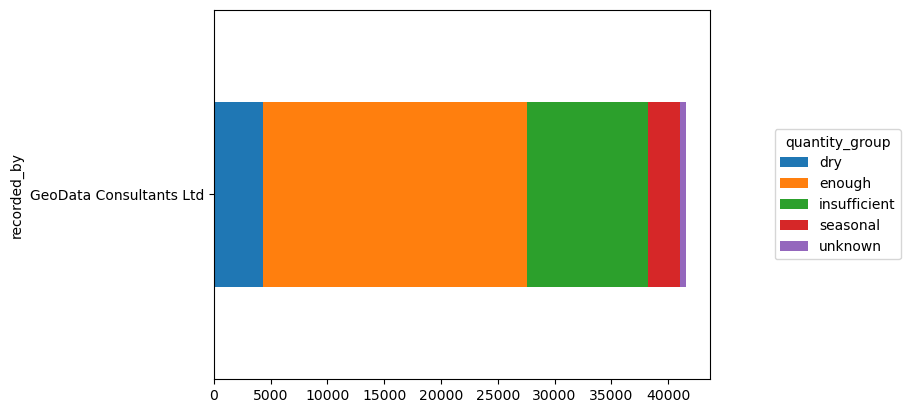

<Figure size 1600x800 with 0 Axes>

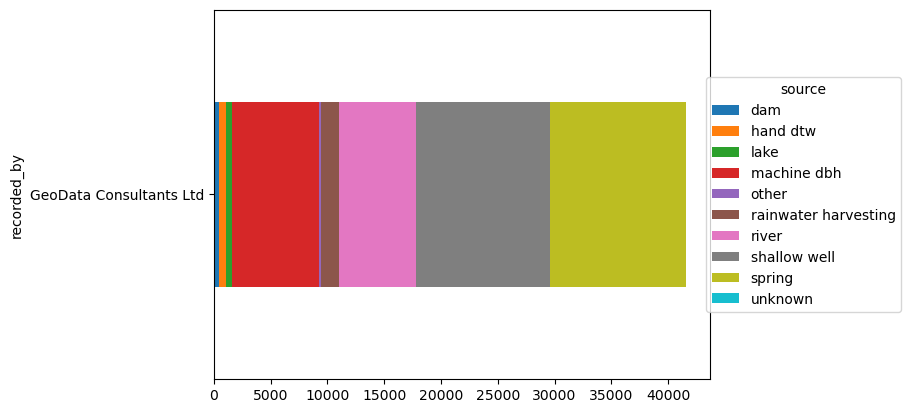

<Figure size 1600x800 with 0 Axes>

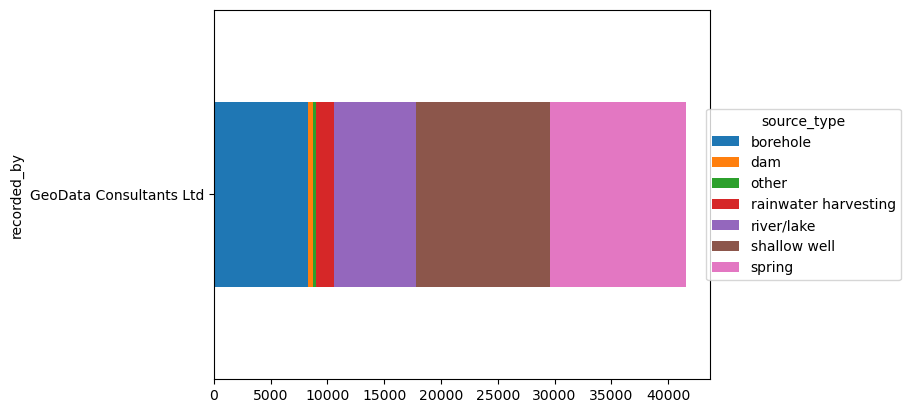

<Figure size 1600x800 with 0 Axes>

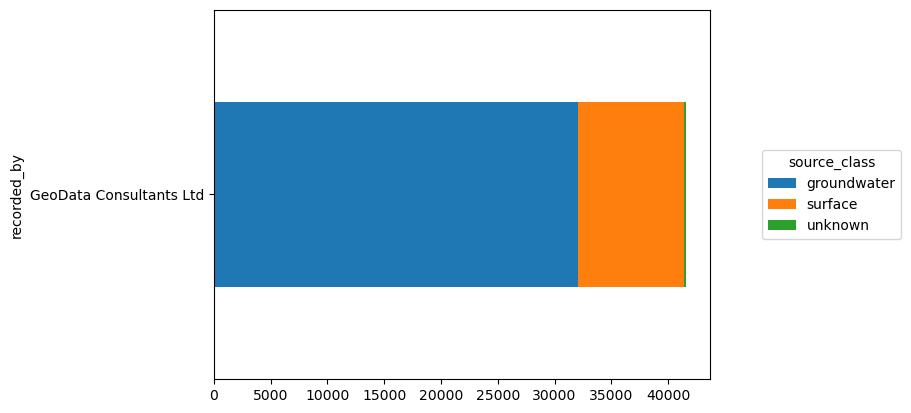

<Figure size 1600x800 with 0 Axes>

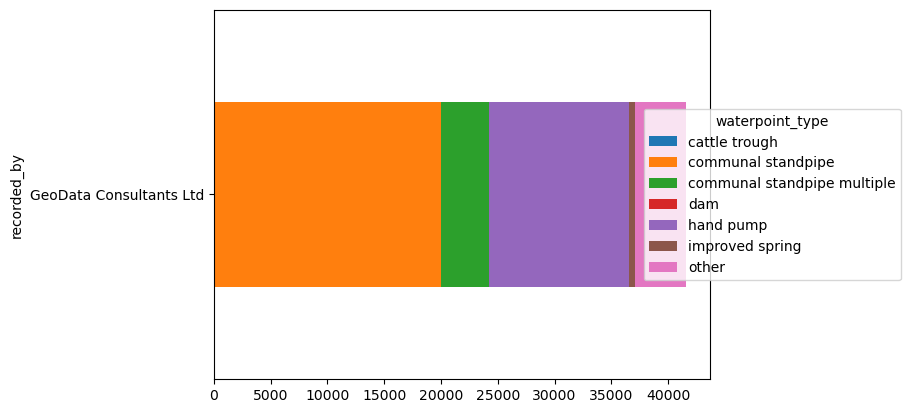

<Figure size 1600x800 with 0 Axes>

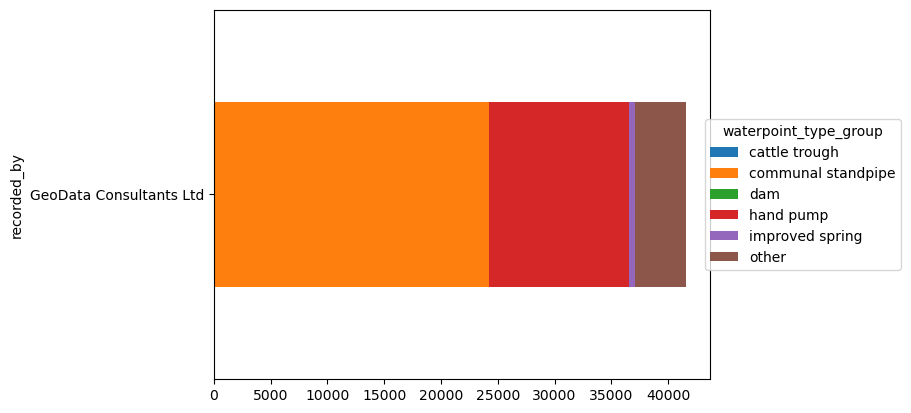

<Figure size 1600x800 with 0 Axes>

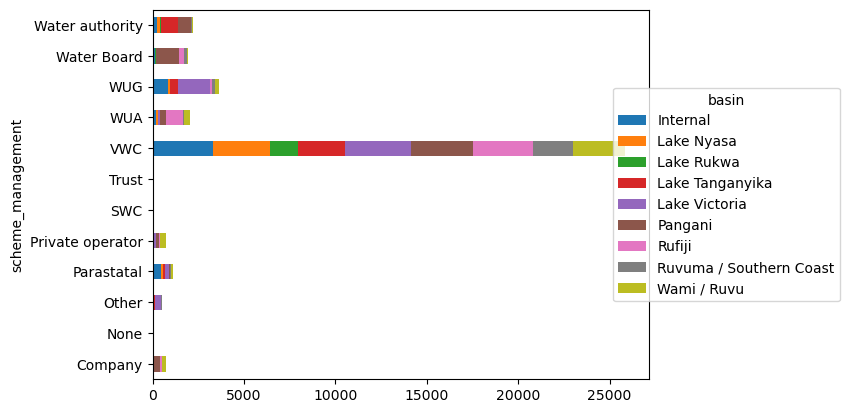

<Figure size 1600x800 with 0 Axes>

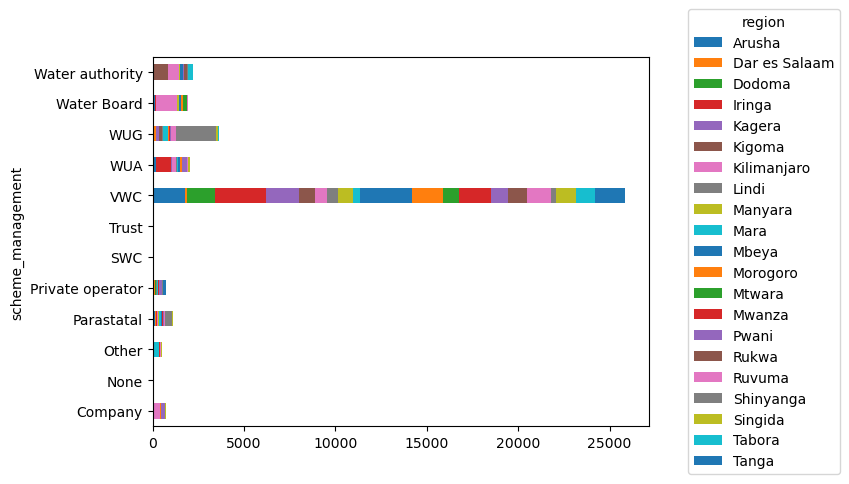

<Figure size 1600x800 with 0 Axes>

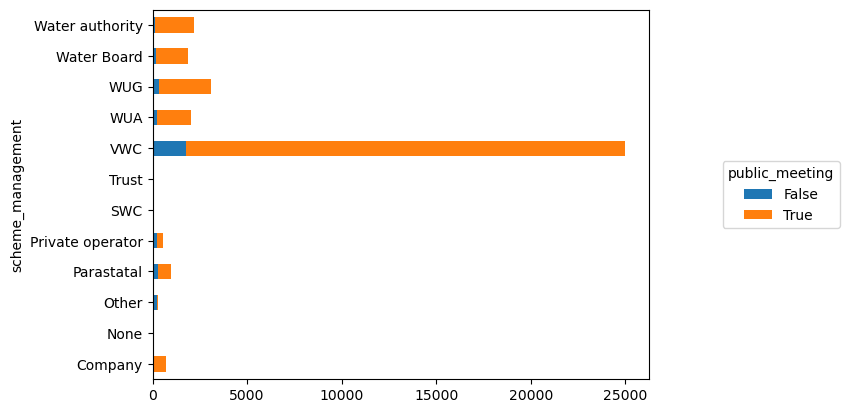

<Figure size 1600x800 with 0 Axes>

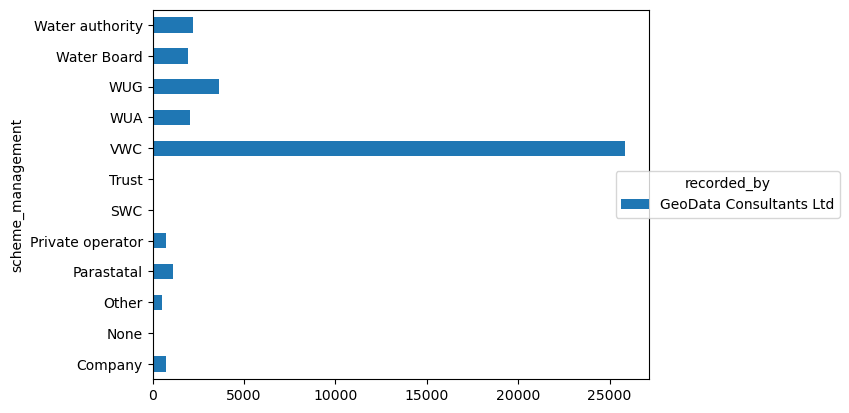

<Figure size 1600x800 with 0 Axes>

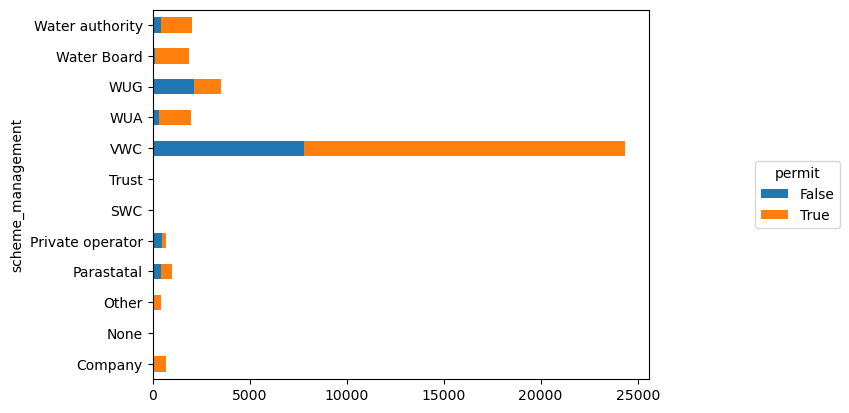

<Figure size 1600x800 with 0 Axes>

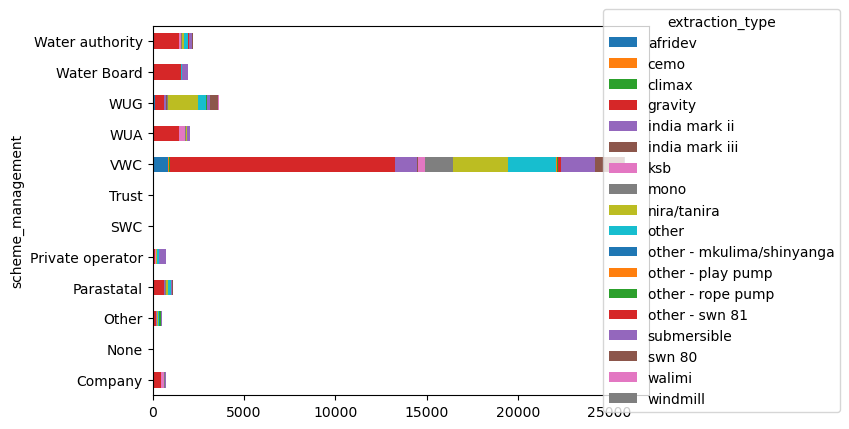

<Figure size 1600x800 with 0 Axes>

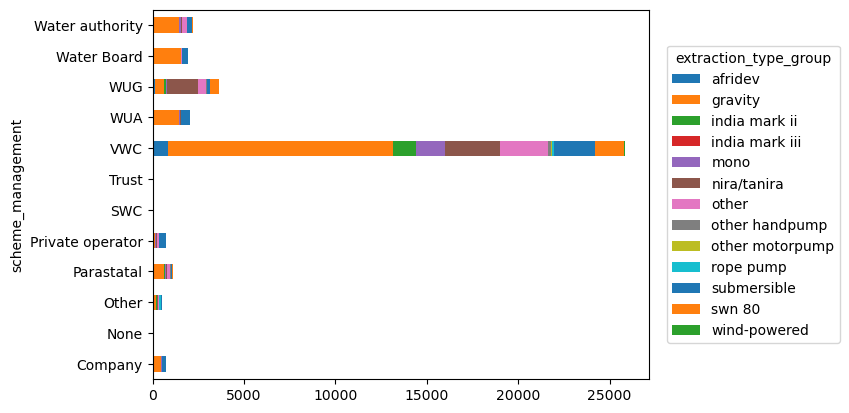

<Figure size 1600x800 with 0 Axes>

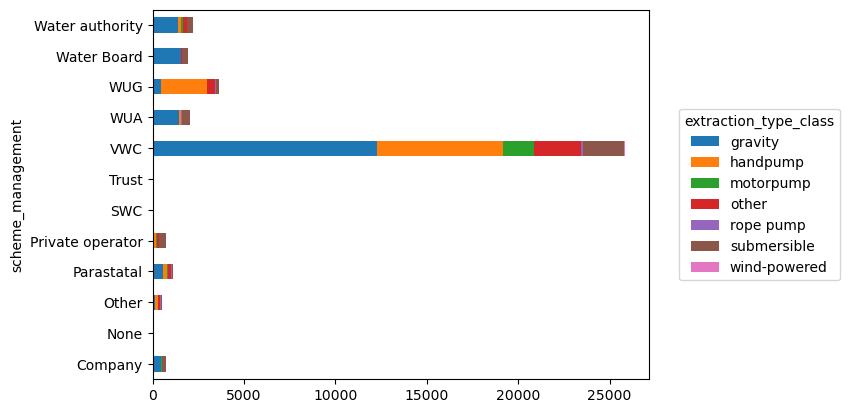

<Figure size 1600x800 with 0 Axes>

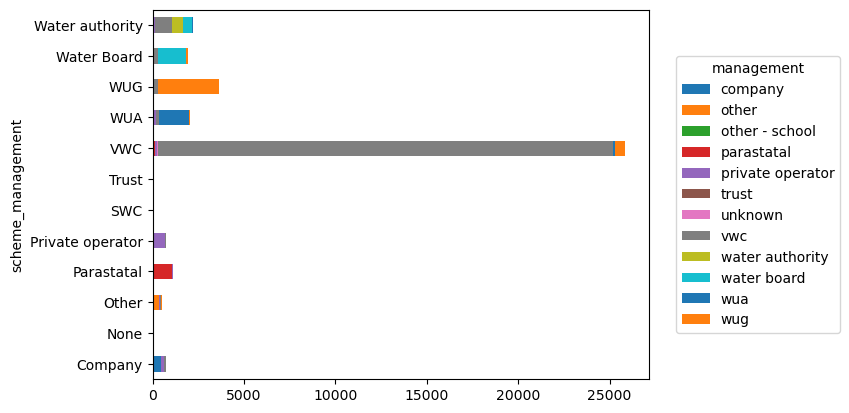

<Figure size 1600x800 with 0 Axes>

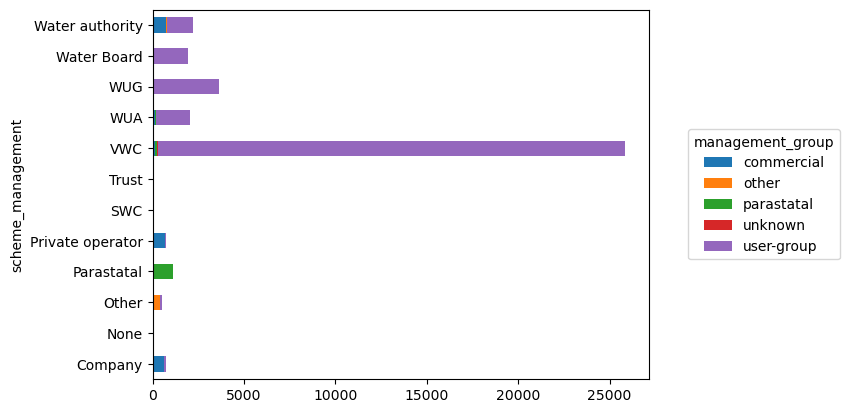

<Figure size 1600x800 with 0 Axes>

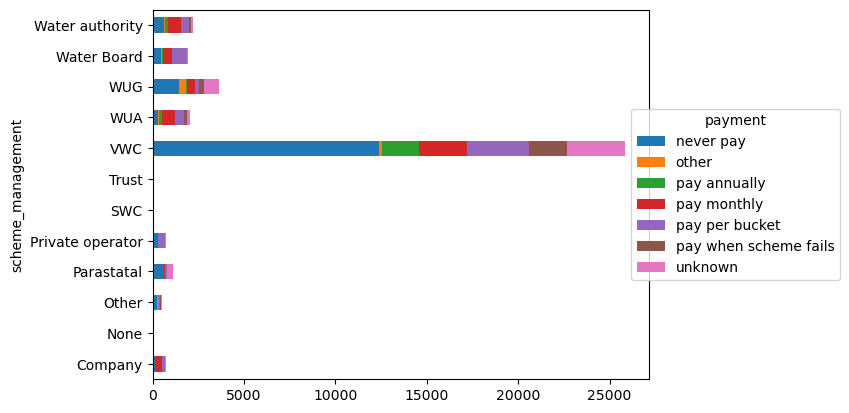

<Figure size 1600x800 with 0 Axes>

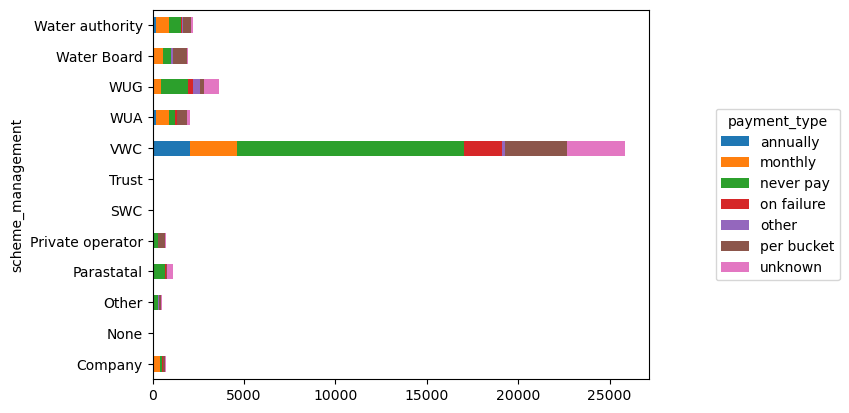

<Figure size 1600x800 with 0 Axes>

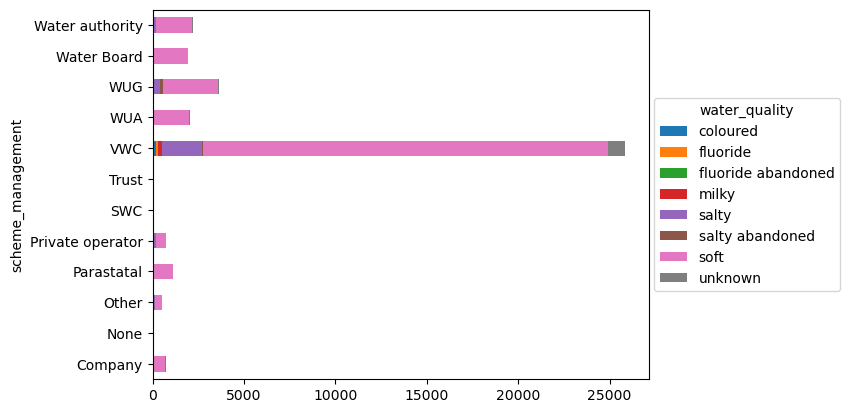

<Figure size 1600x800 with 0 Axes>

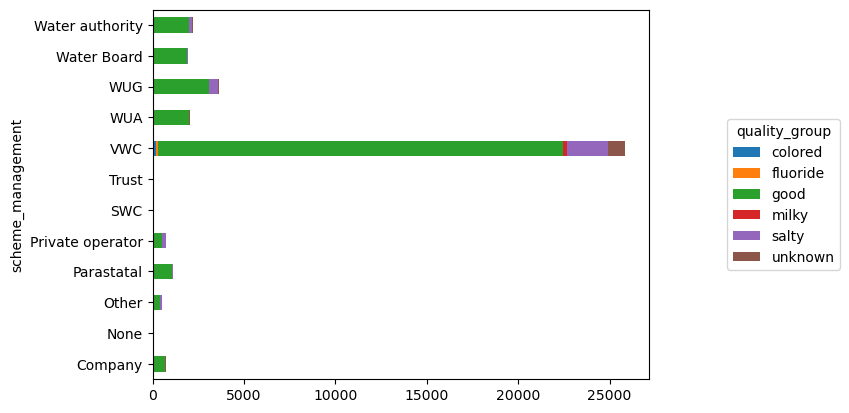

<Figure size 1600x800 with 0 Axes>

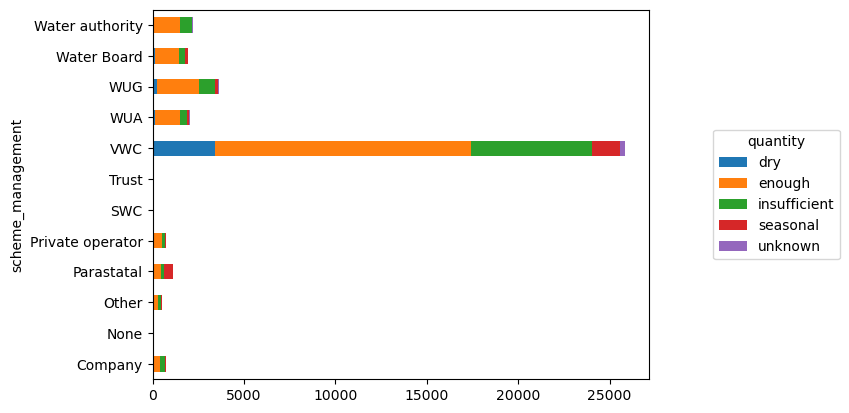

<Figure size 1600x800 with 0 Axes>

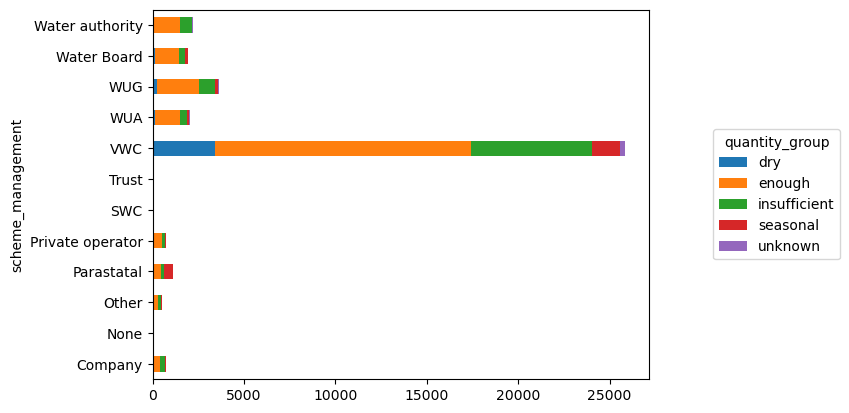

<Figure size 1600x800 with 0 Axes>

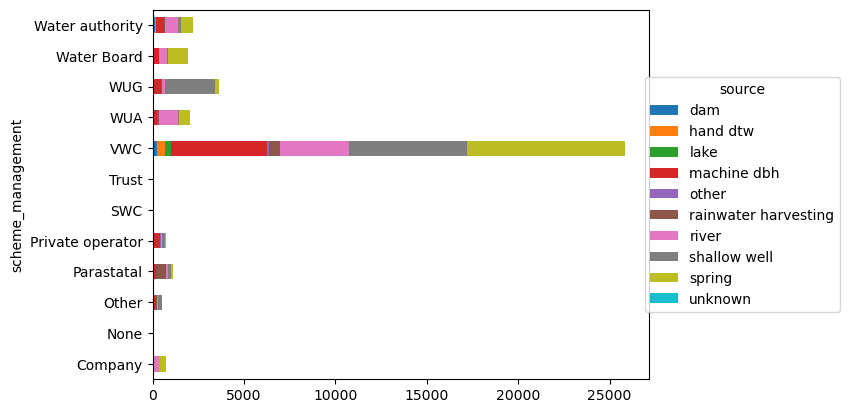

<Figure size 1600x800 with 0 Axes>

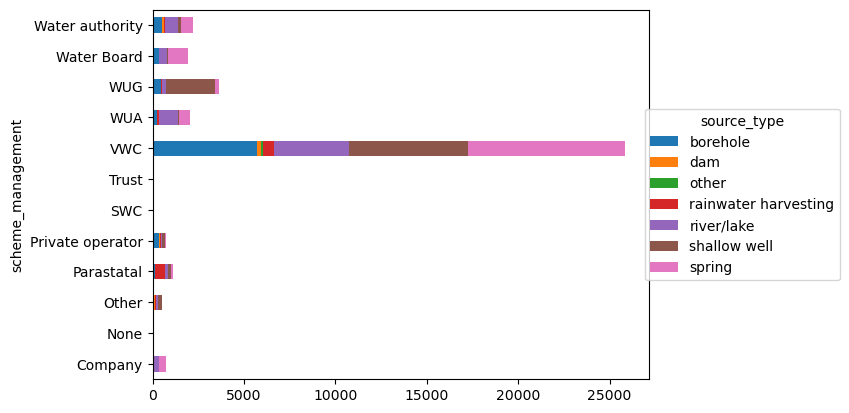

<Figure size 1600x800 with 0 Axes>

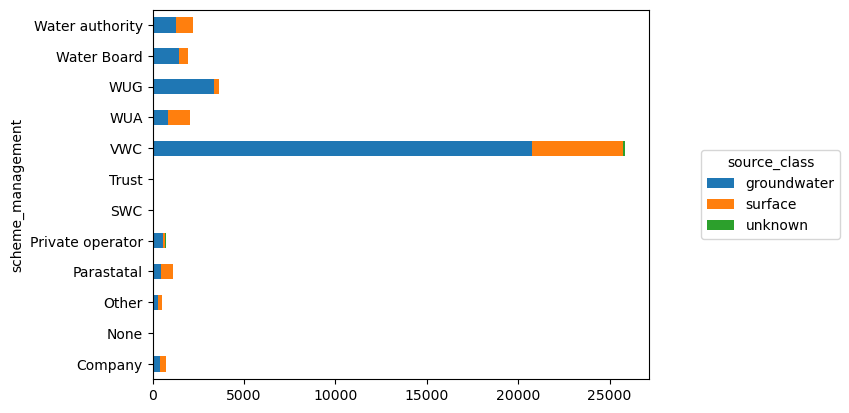

<Figure size 1600x800 with 0 Axes>

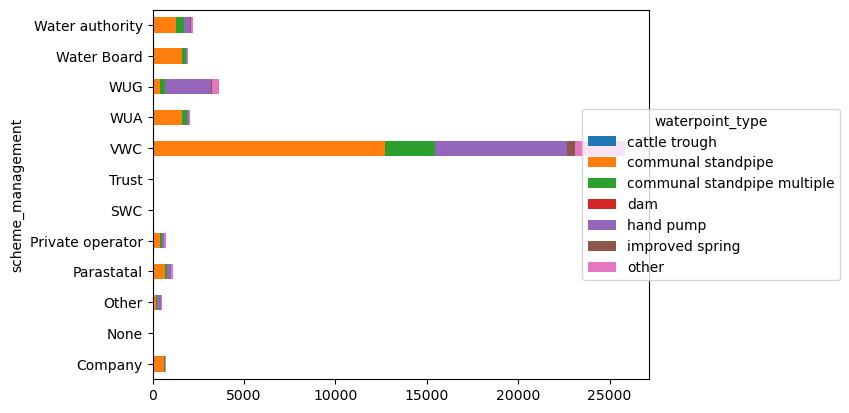

<Figure size 1600x800 with 0 Axes>

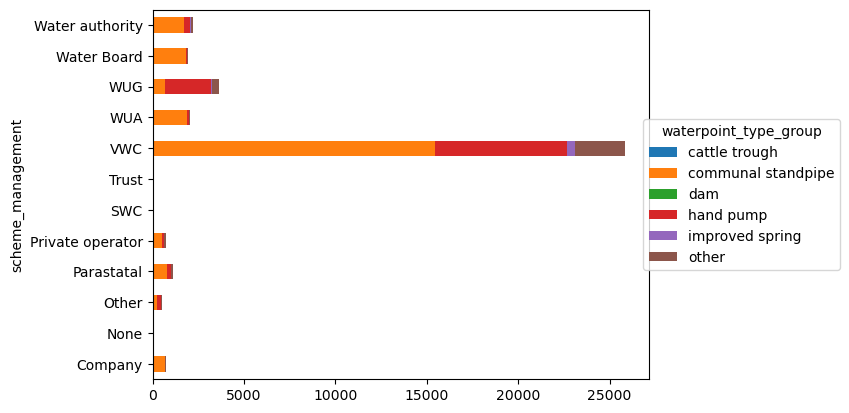

<Figure size 1600x800 with 0 Axes>

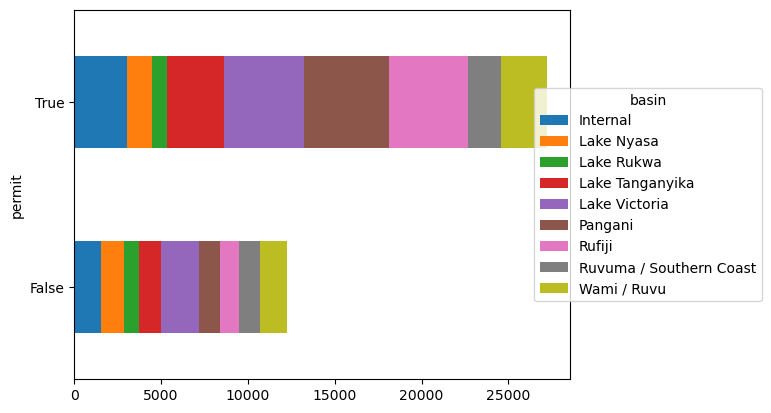

<Figure size 1600x800 with 0 Axes>

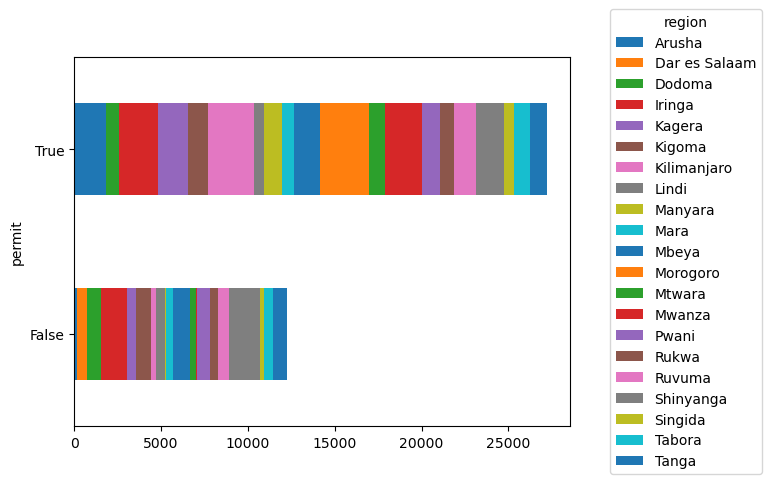

<Figure size 1600x800 with 0 Axes>

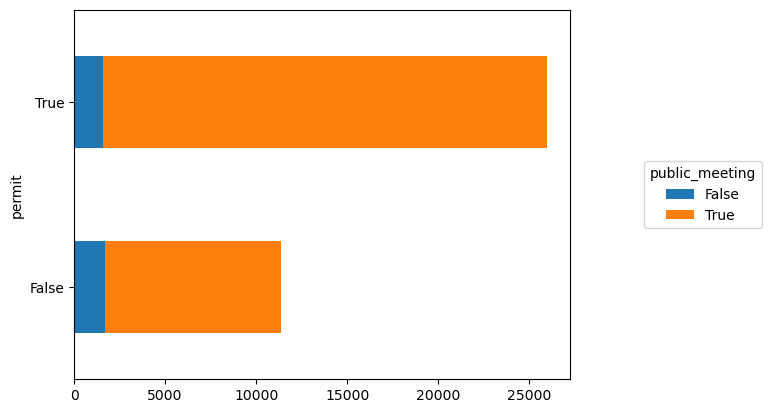

<Figure size 1600x800 with 0 Axes>

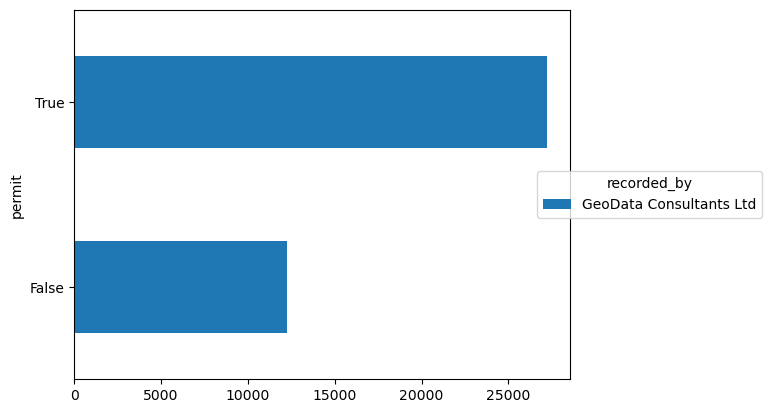

<Figure size 1600x800 with 0 Axes>

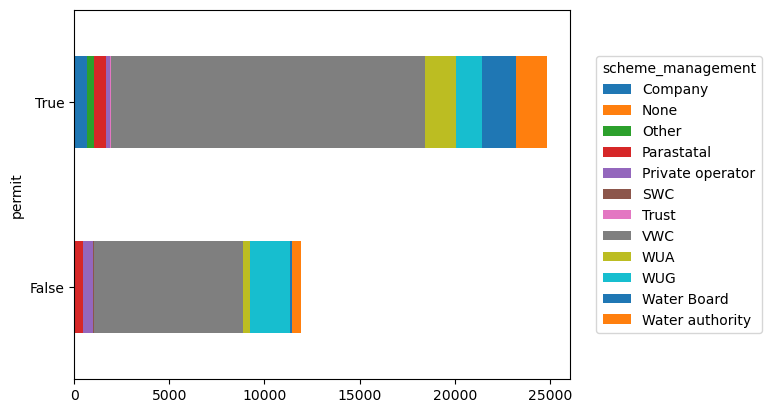

<Figure size 1600x800 with 0 Axes>

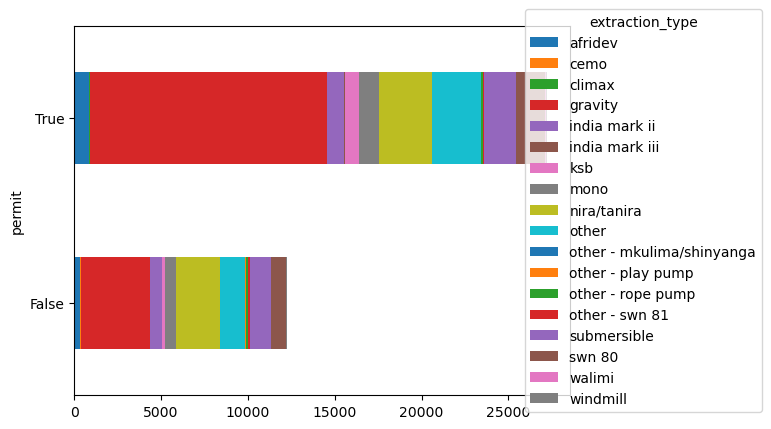

<Figure size 1600x800 with 0 Axes>

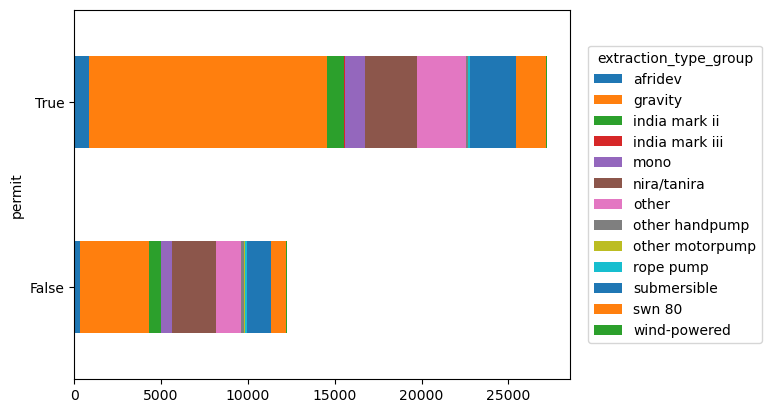

<Figure size 1600x800 with 0 Axes>

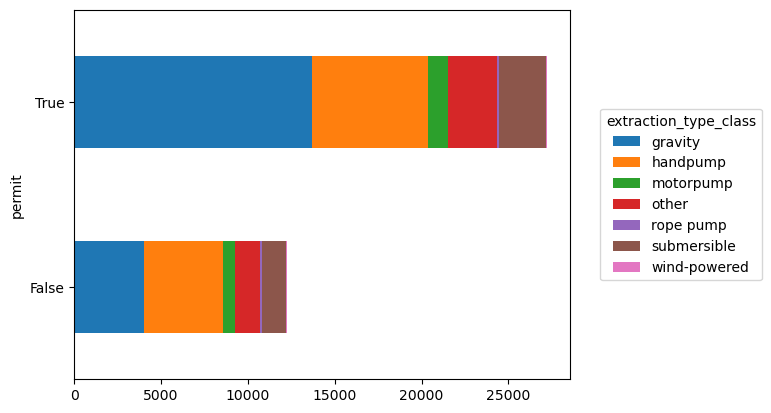

<Figure size 1600x800 with 0 Axes>

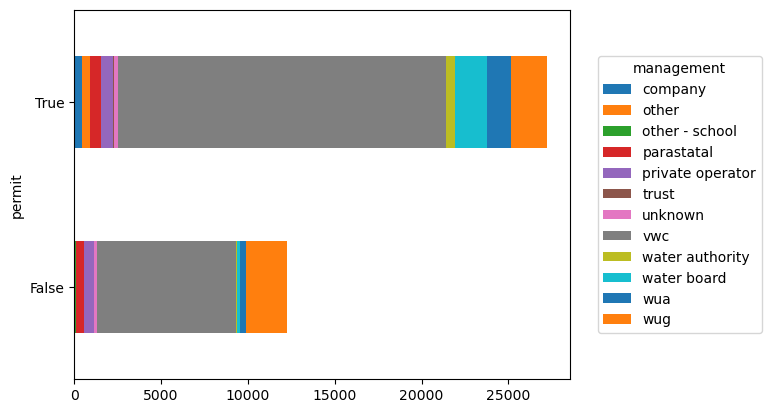

<Figure size 1600x800 with 0 Axes>

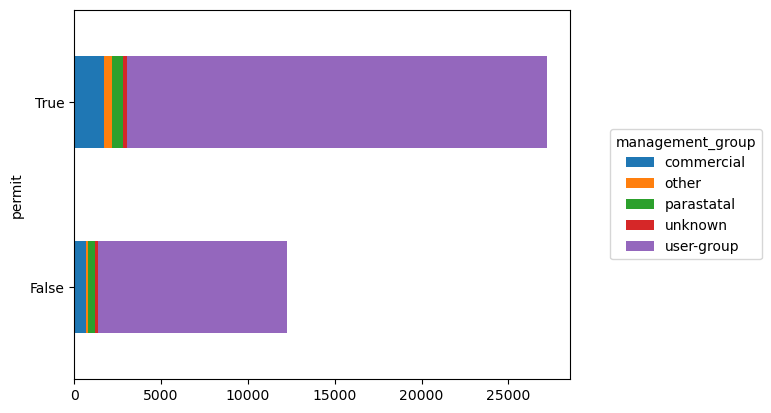

<Figure size 1600x800 with 0 Axes>

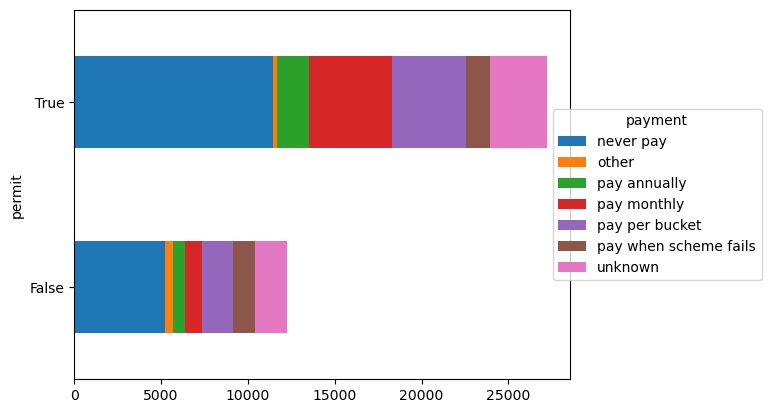

<Figure size 1600x800 with 0 Axes>

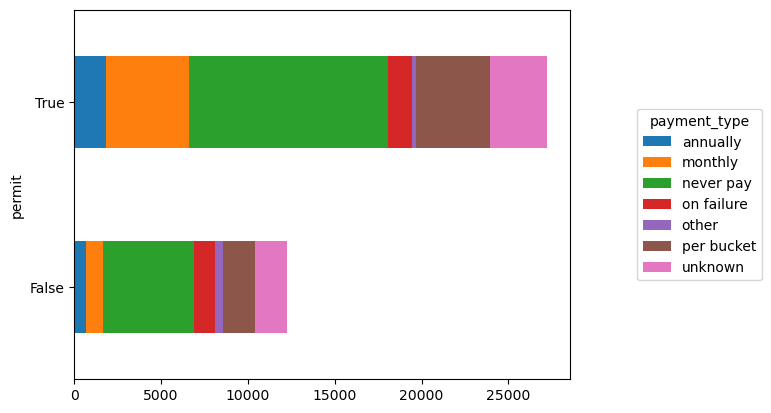

<Figure size 1600x800 with 0 Axes>

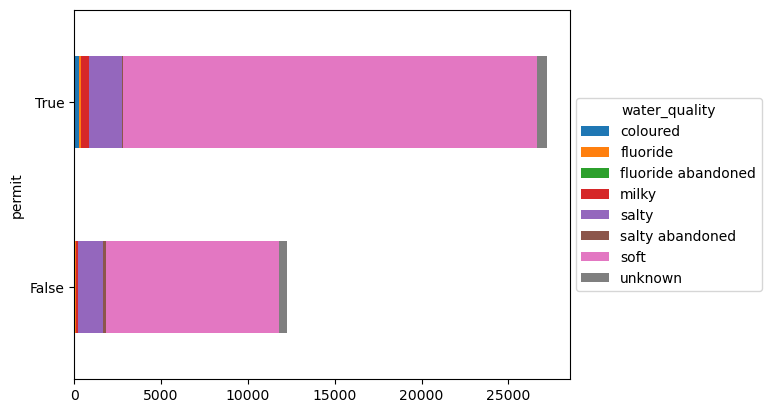

<Figure size 1600x800 with 0 Axes>

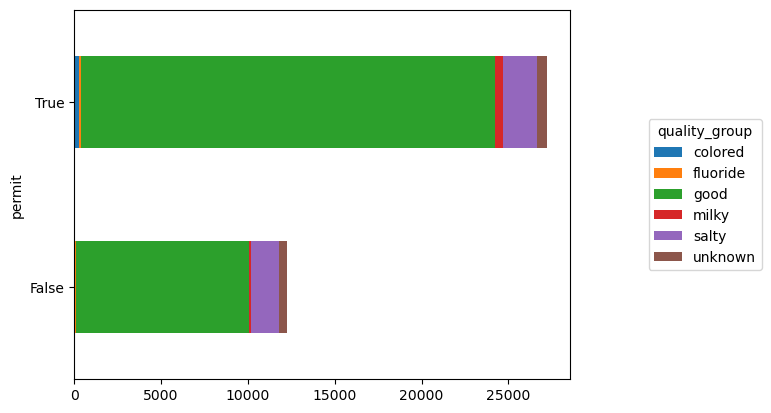

<Figure size 1600x800 with 0 Axes>

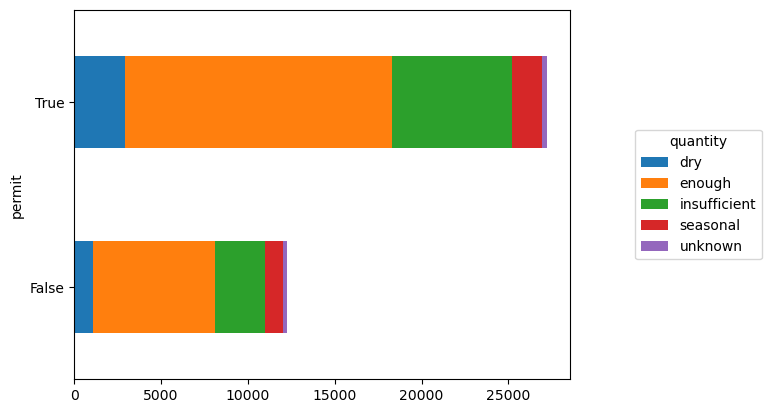

<Figure size 1600x800 with 0 Axes>

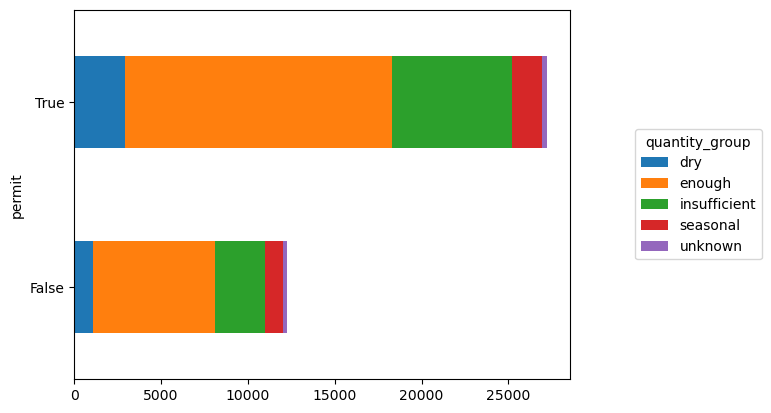

<Figure size 1600x800 with 0 Axes>

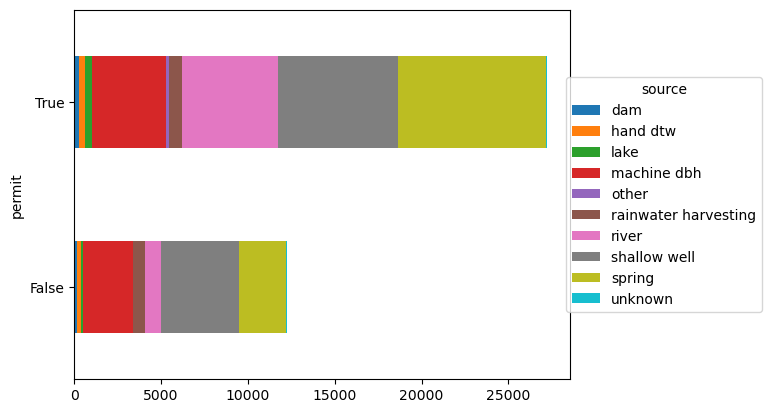

<Figure size 1600x800 with 0 Axes>

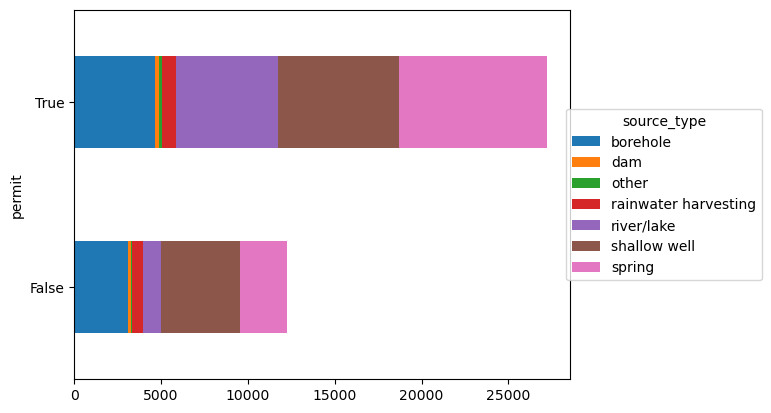

<Figure size 1600x800 with 0 Axes>

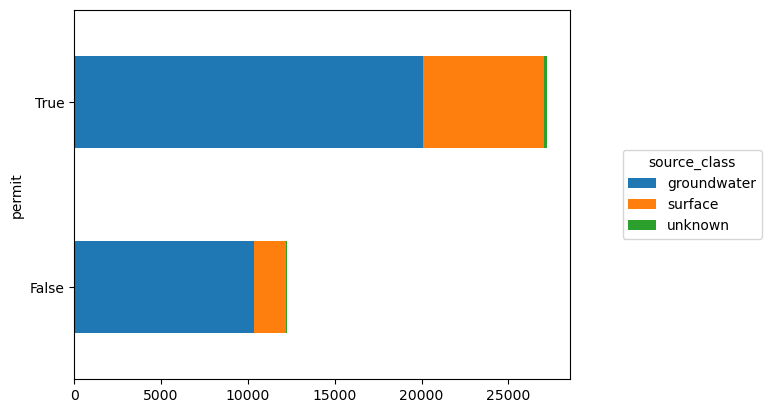

<Figure size 1600x800 with 0 Axes>

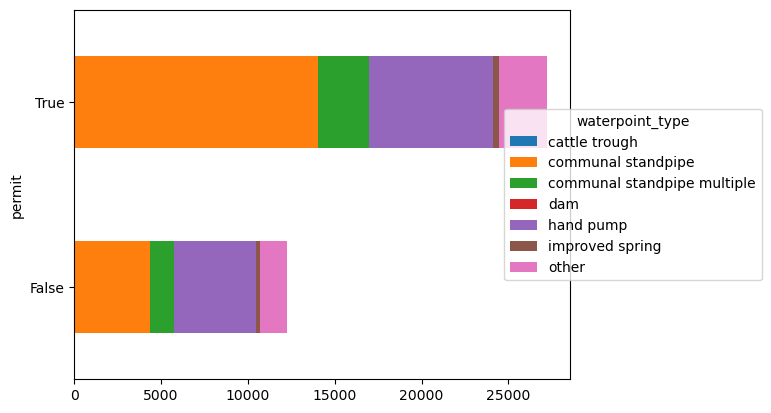

<Figure size 1600x800 with 0 Axes>

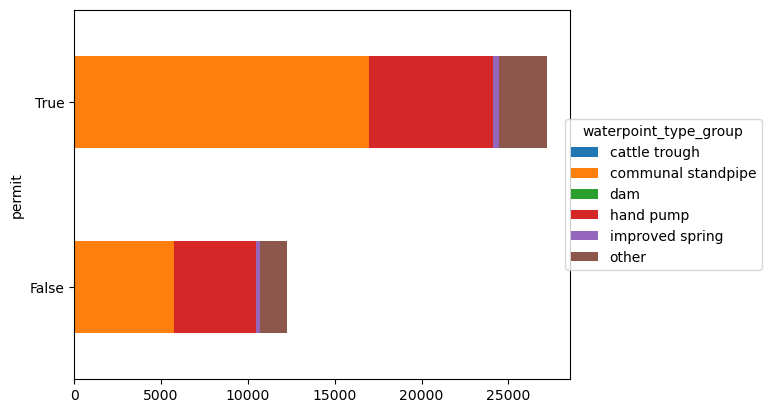

<Figure size 1600x800 with 0 Axes>

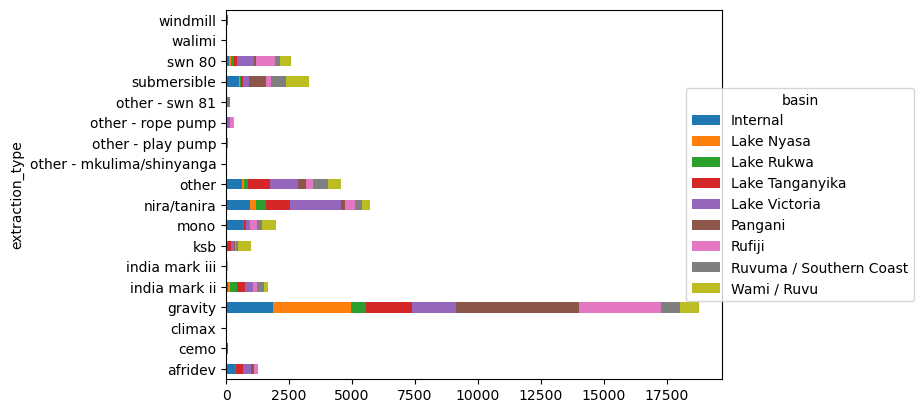

<Figure size 1600x800 with 0 Axes>

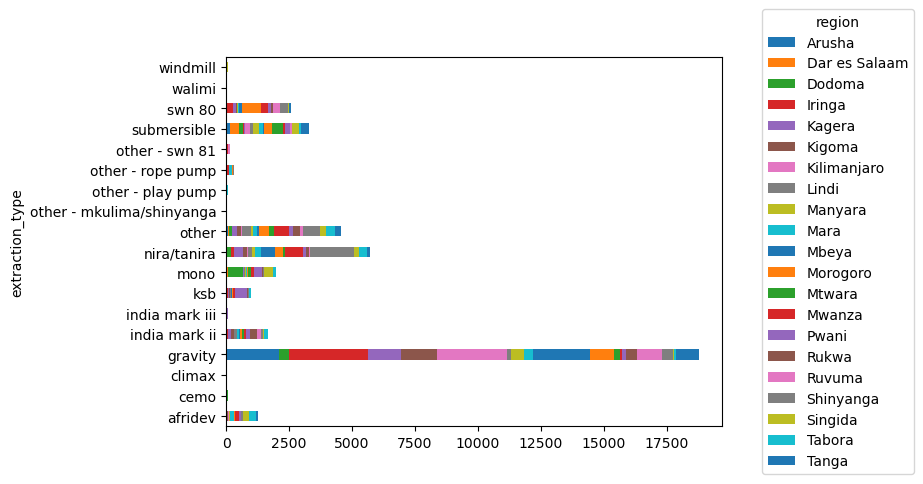

<Figure size 1600x800 with 0 Axes>

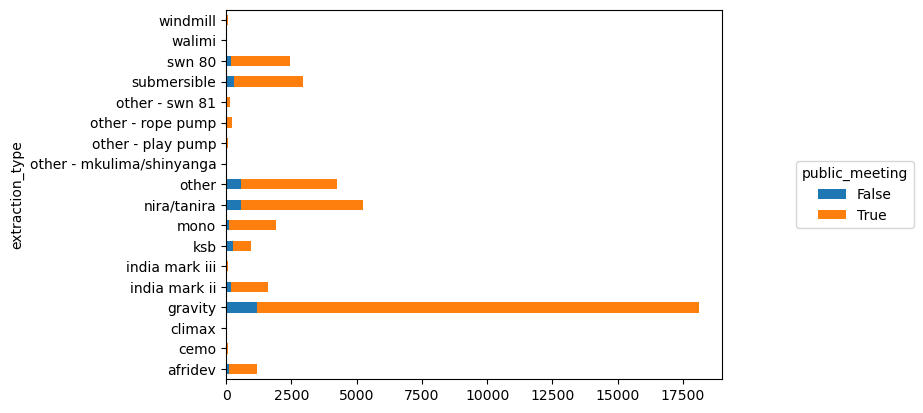

<Figure size 1600x800 with 0 Axes>

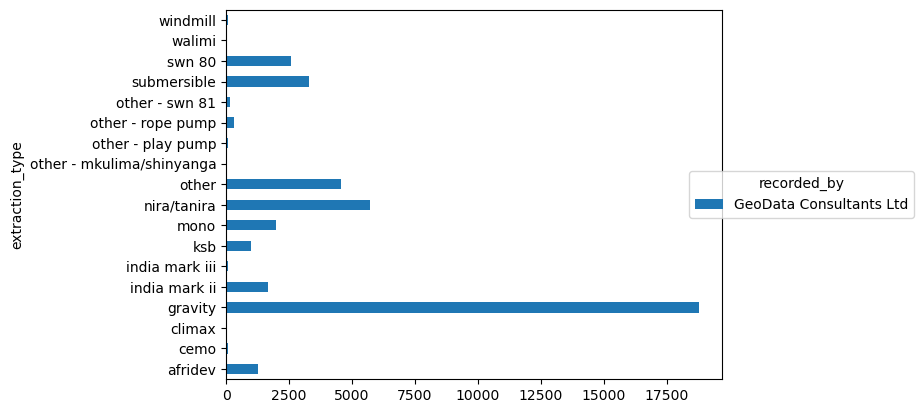

<Figure size 1600x800 with 0 Axes>

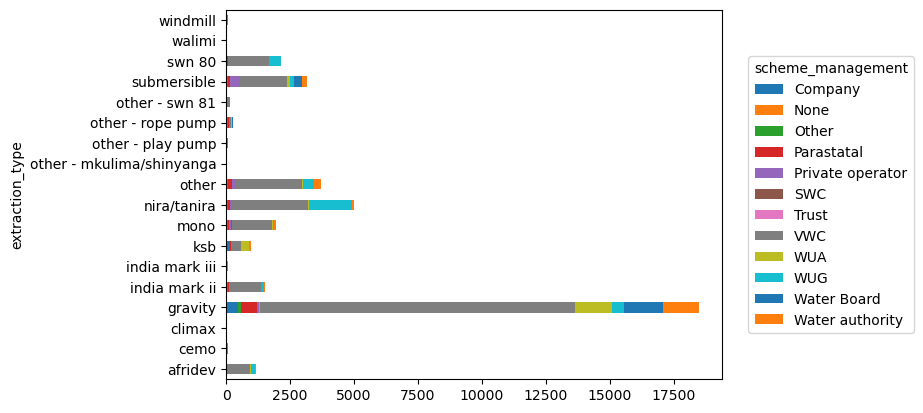

<Figure size 1600x800 with 0 Axes>

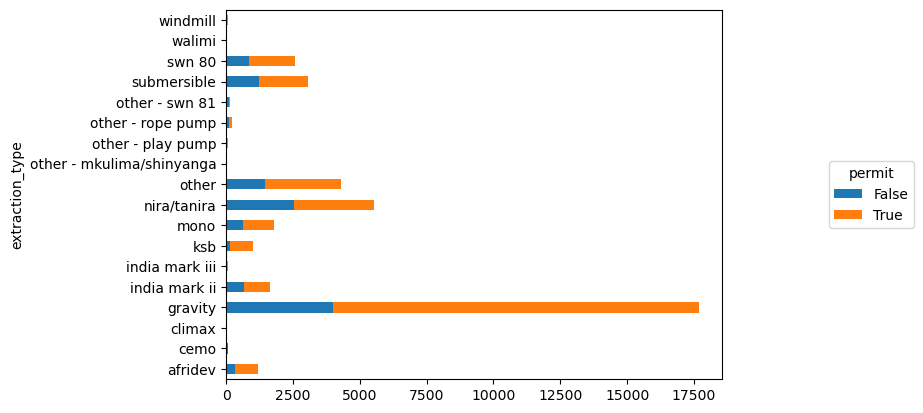

<Figure size 1600x800 with 0 Axes>

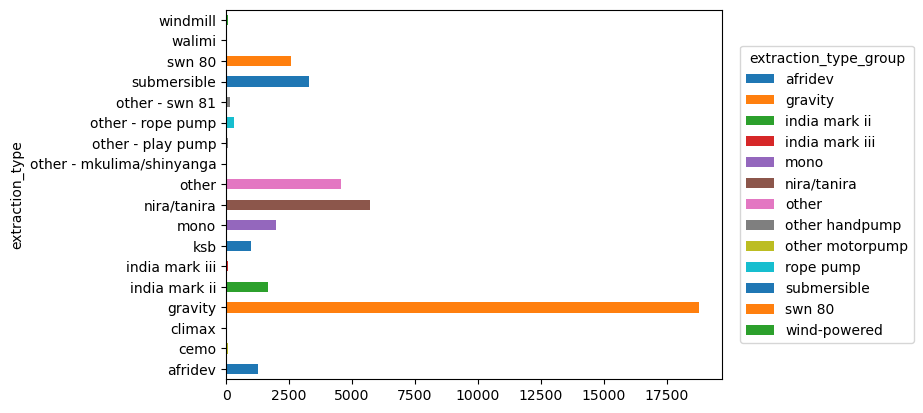

<Figure size 1600x800 with 0 Axes>

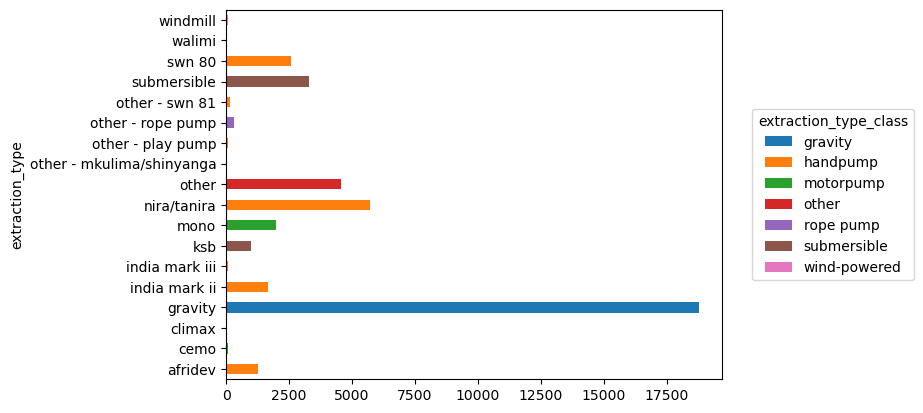

<Figure size 1600x800 with 0 Axes>

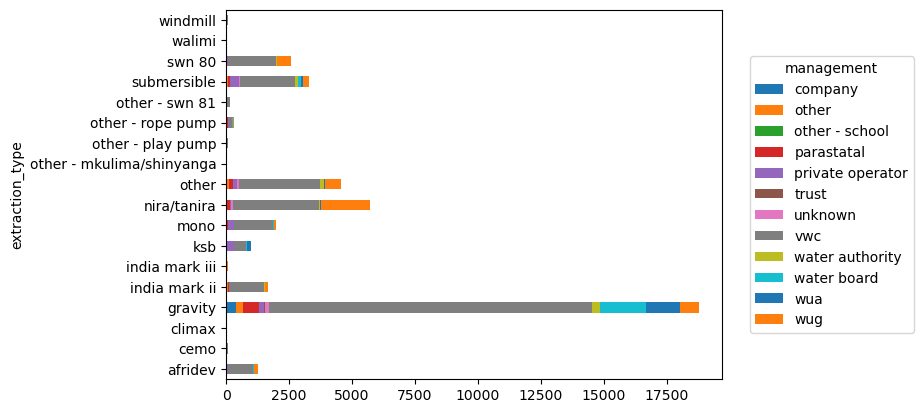

<Figure size 1600x800 with 0 Axes>

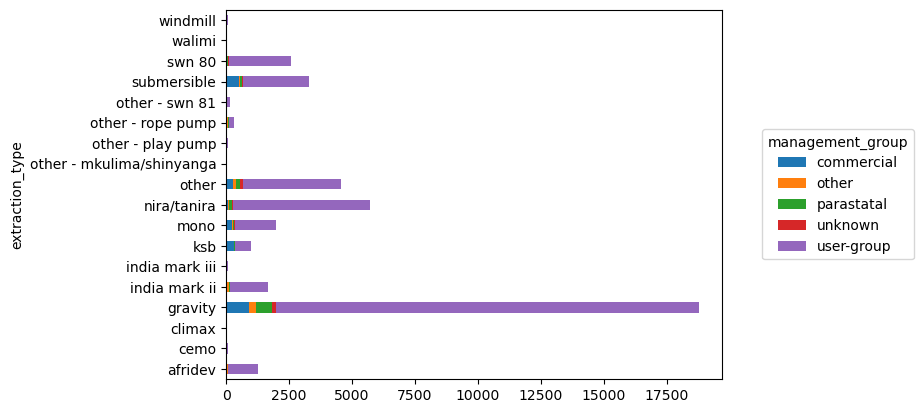

<Figure size 1600x800 with 0 Axes>

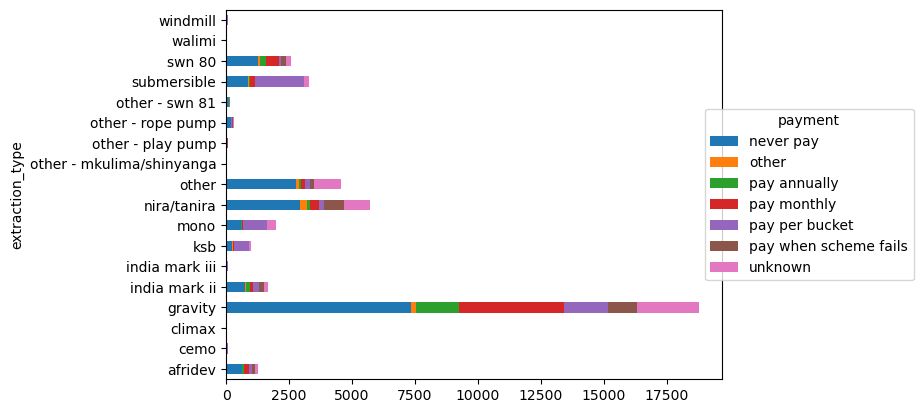

<Figure size 1600x800 with 0 Axes>

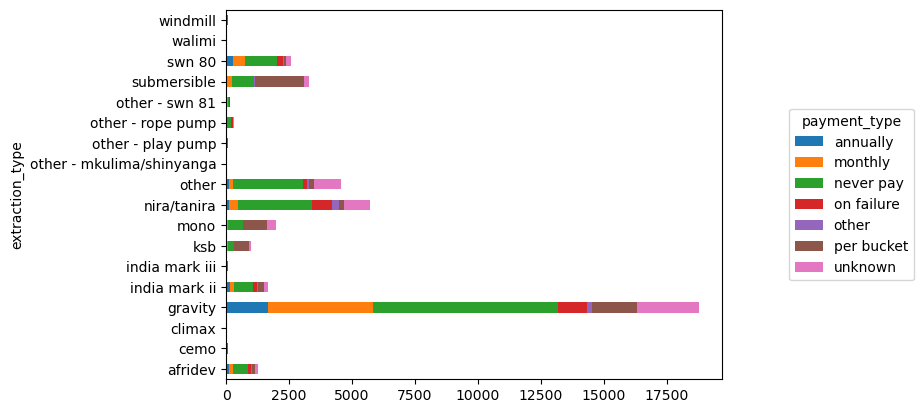

<Figure size 1600x800 with 0 Axes>

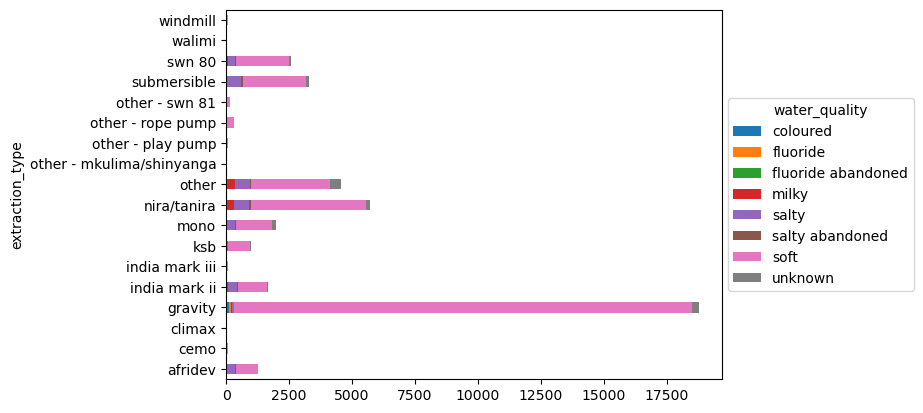

<Figure size 1600x800 with 0 Axes>

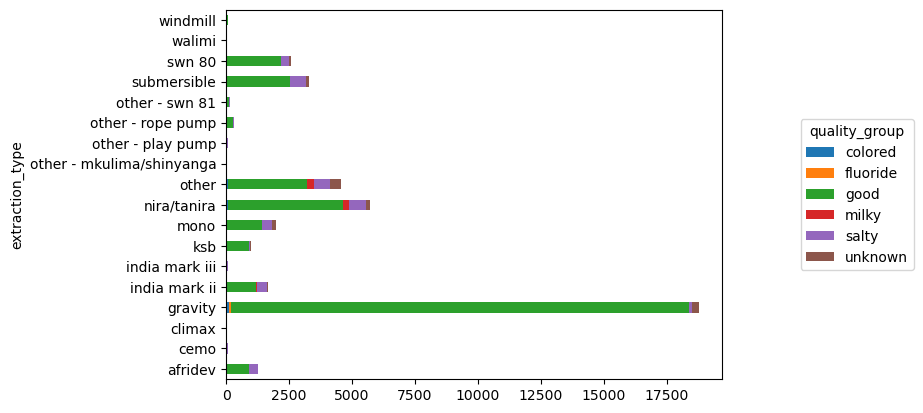

<Figure size 1600x800 with 0 Axes>

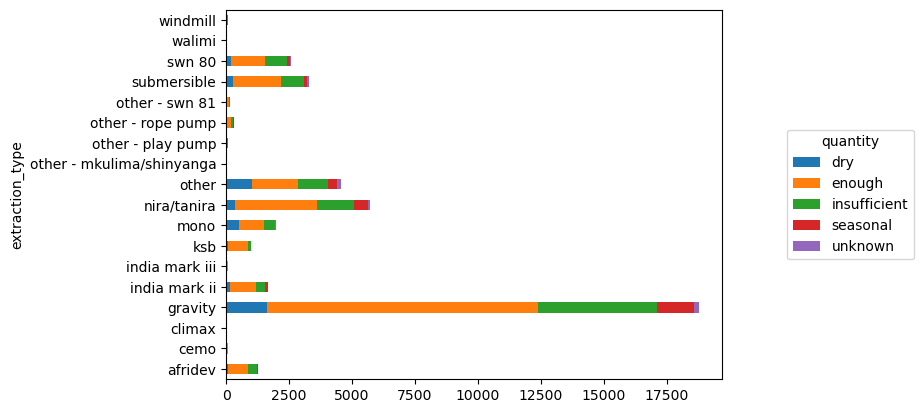

<Figure size 1600x800 with 0 Axes>

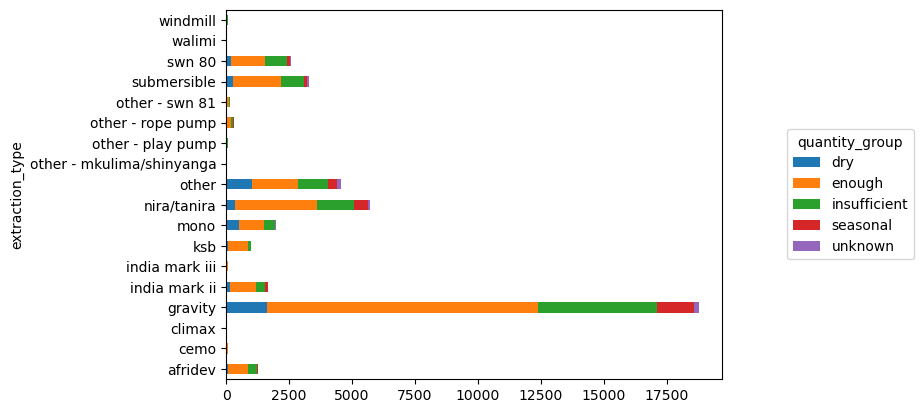

<Figure size 1600x800 with 0 Axes>

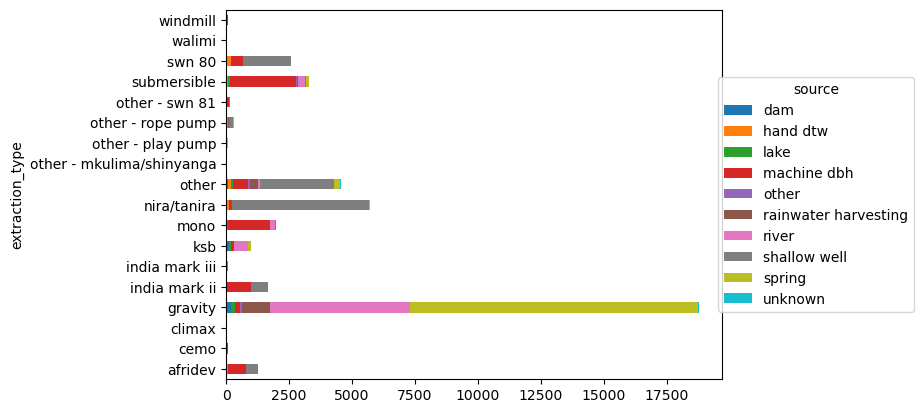

<Figure size 1600x800 with 0 Axes>

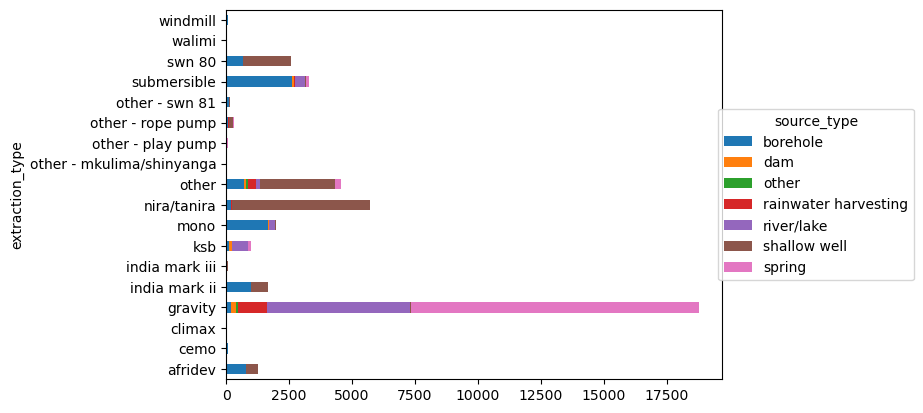

<Figure size 1600x800 with 0 Axes>

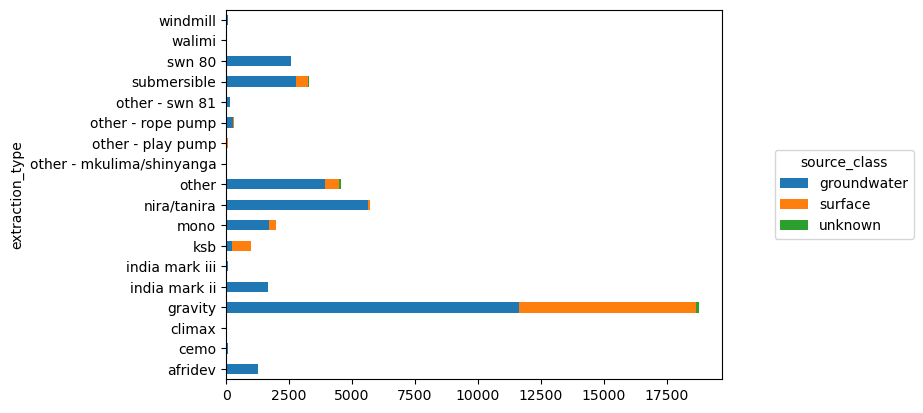

<Figure size 1600x800 with 0 Axes>

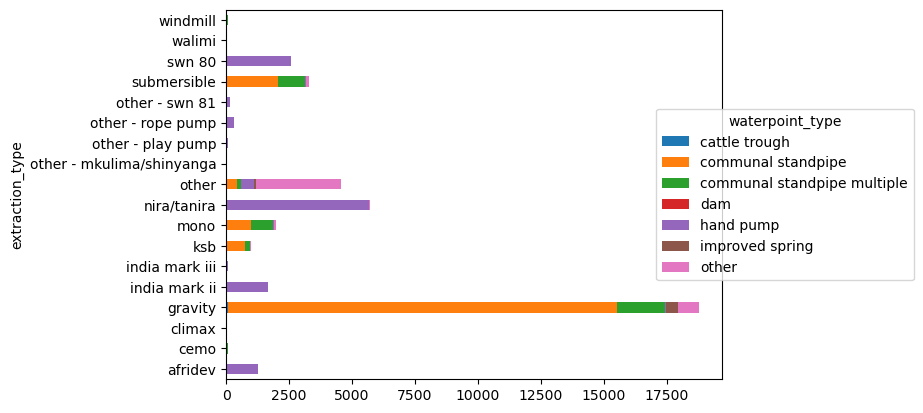

<Figure size 1600x800 with 0 Axes>

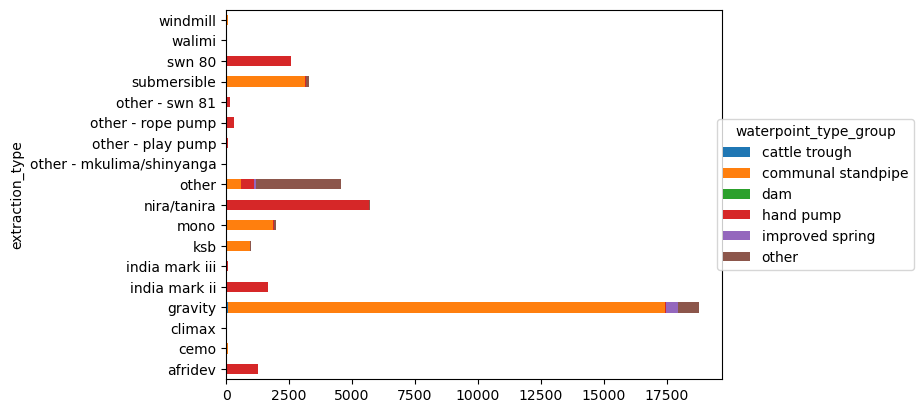

<Figure size 1600x800 with 0 Axes>

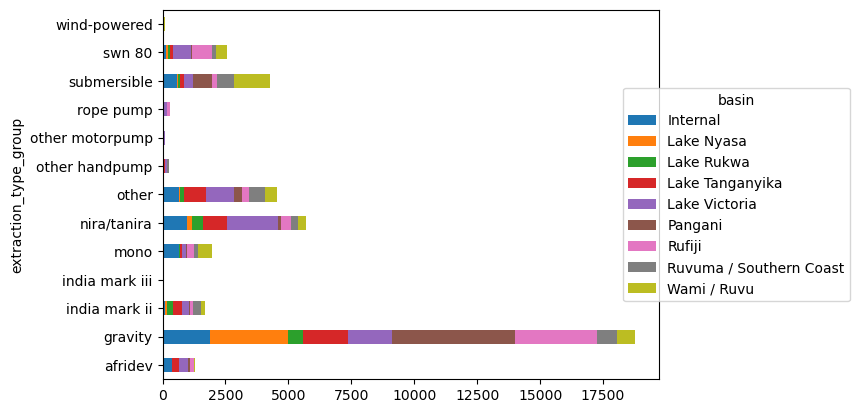

<Figure size 1600x800 with 0 Axes>

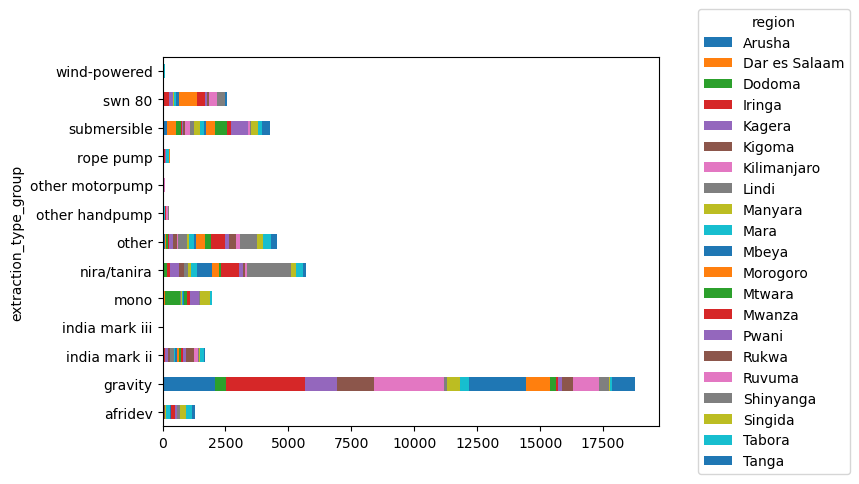

<Figure size 1600x800 with 0 Axes>

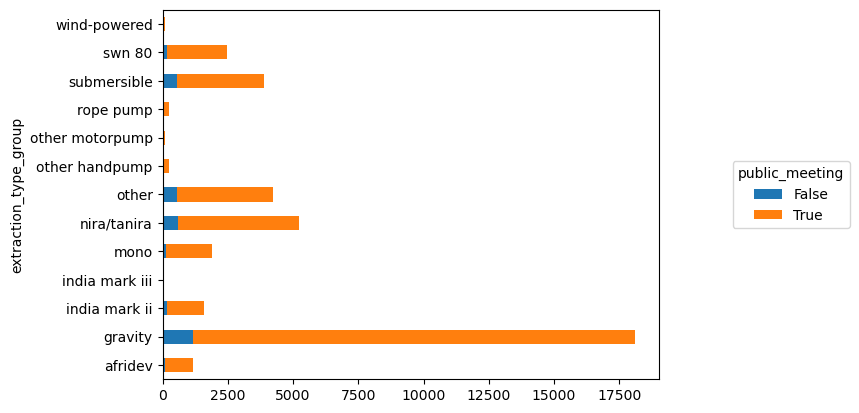

<Figure size 1600x800 with 0 Axes>

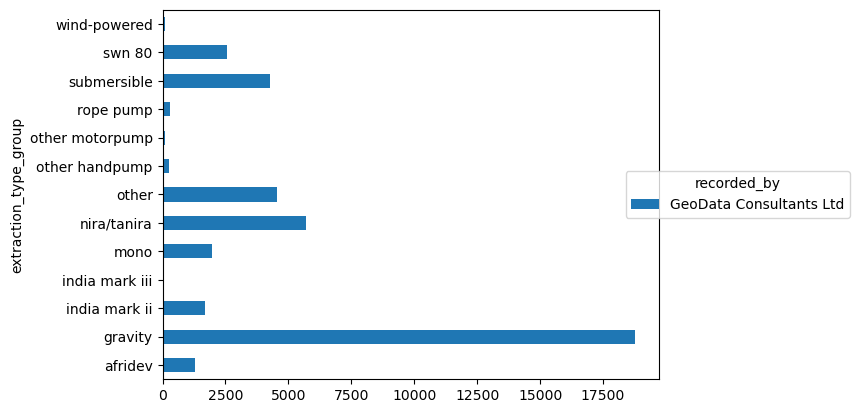

<Figure size 1600x800 with 0 Axes>

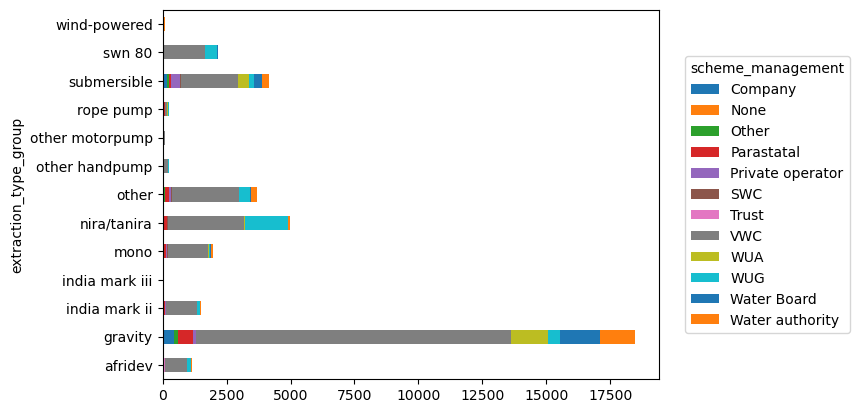

<Figure size 1600x800 with 0 Axes>

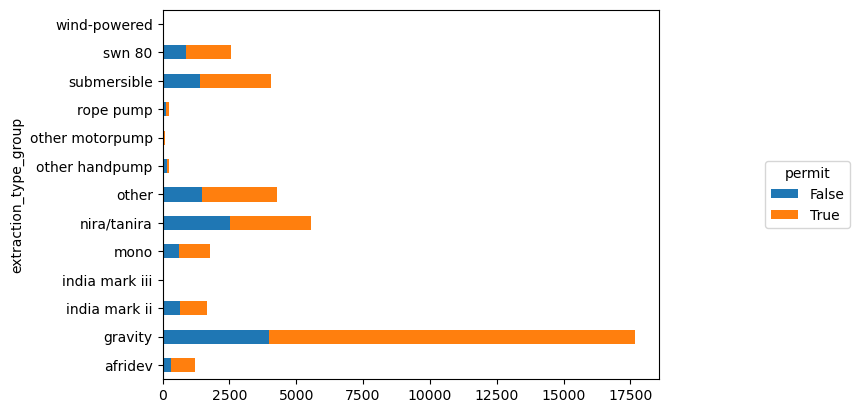

<Figure size 1600x800 with 0 Axes>

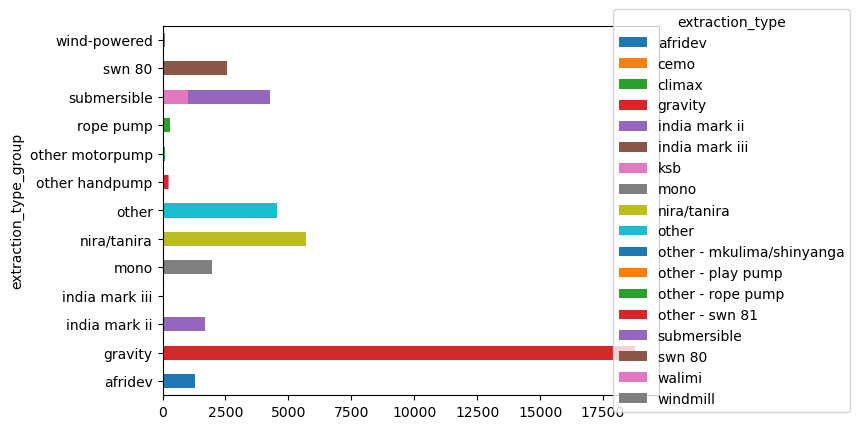

<Figure size 1600x800 with 0 Axes>

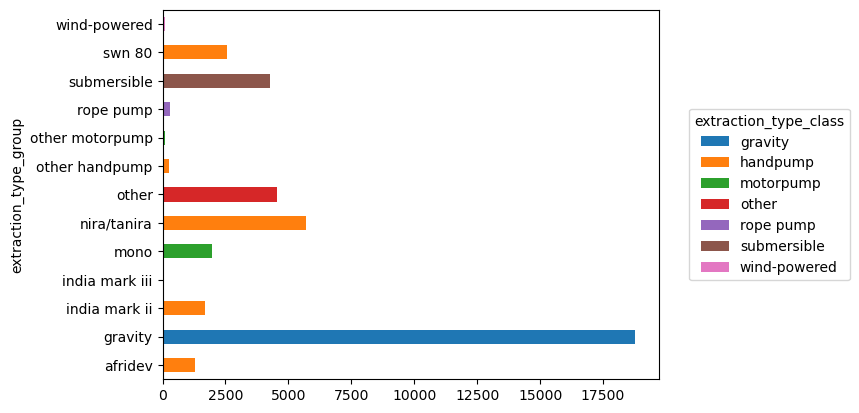

<Figure size 1600x800 with 0 Axes>

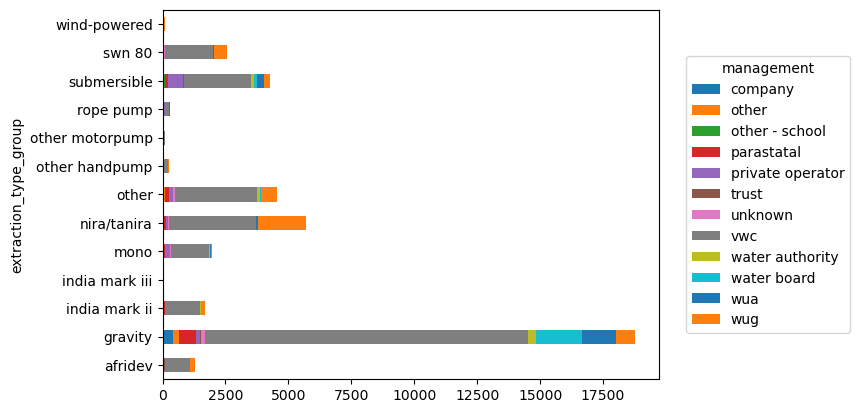

<Figure size 1600x800 with 0 Axes>

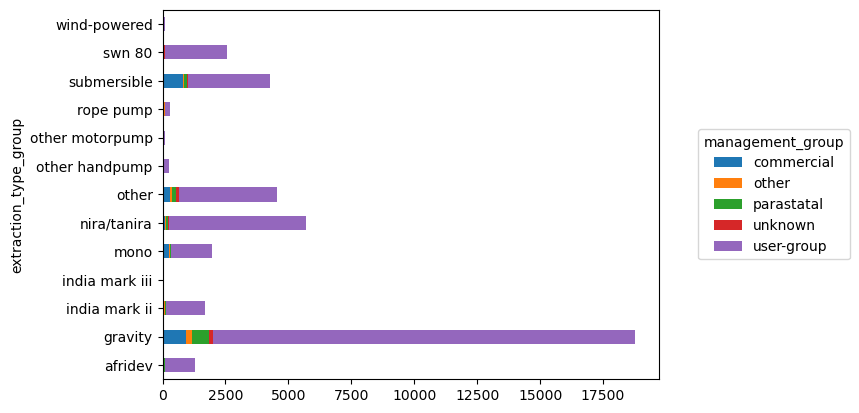

<Figure size 1600x800 with 0 Axes>

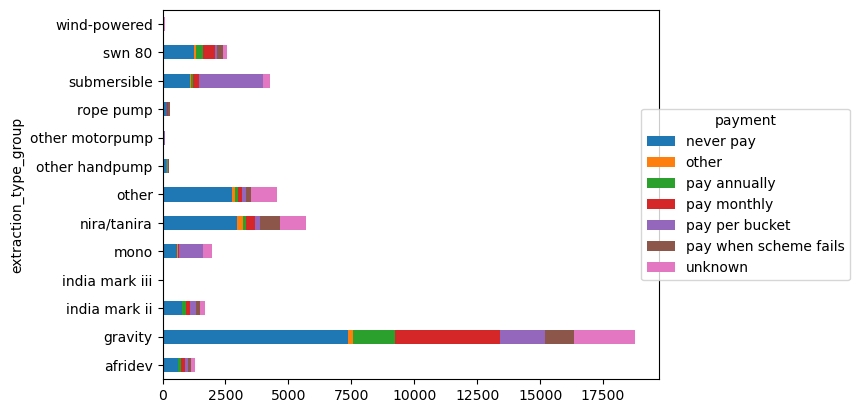

<Figure size 1600x800 with 0 Axes>

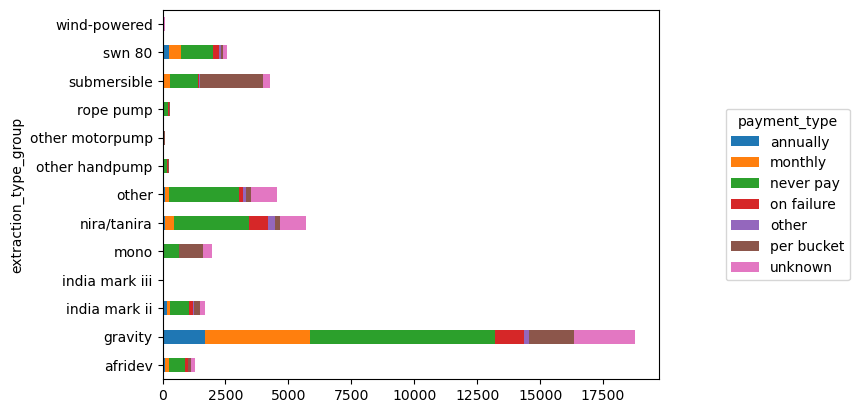

<Figure size 1600x800 with 0 Axes>

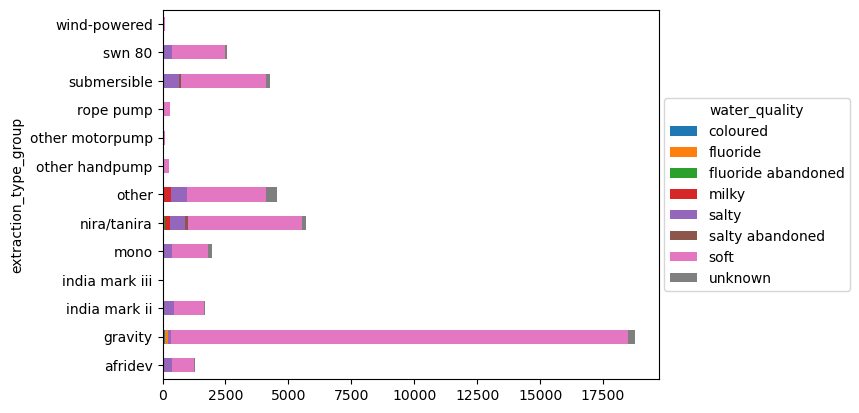

<Figure size 1600x800 with 0 Axes>

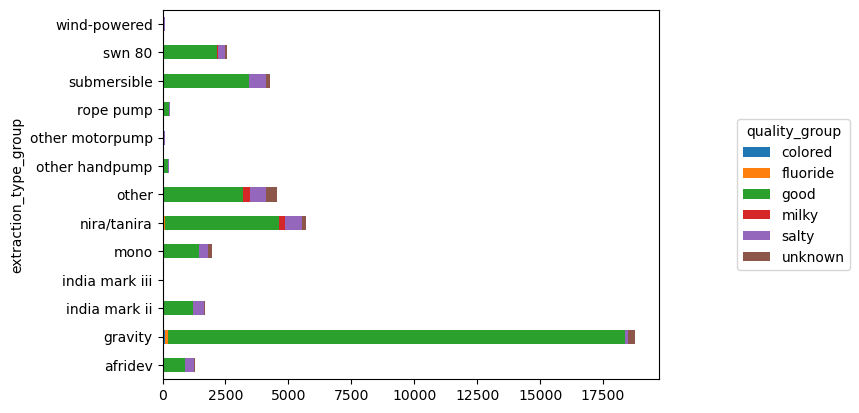

<Figure size 1600x800 with 0 Axes>

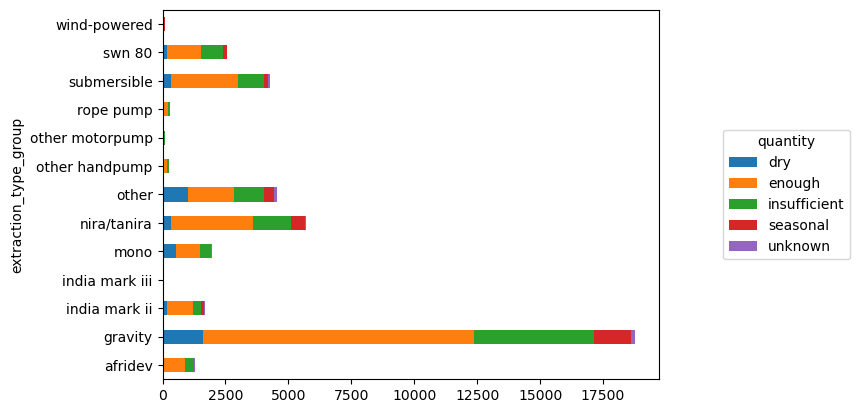

<Figure size 1600x800 with 0 Axes>

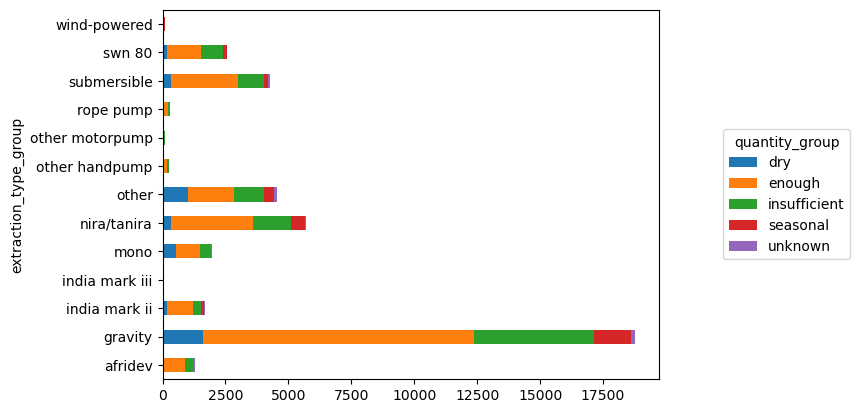

<Figure size 1600x800 with 0 Axes>

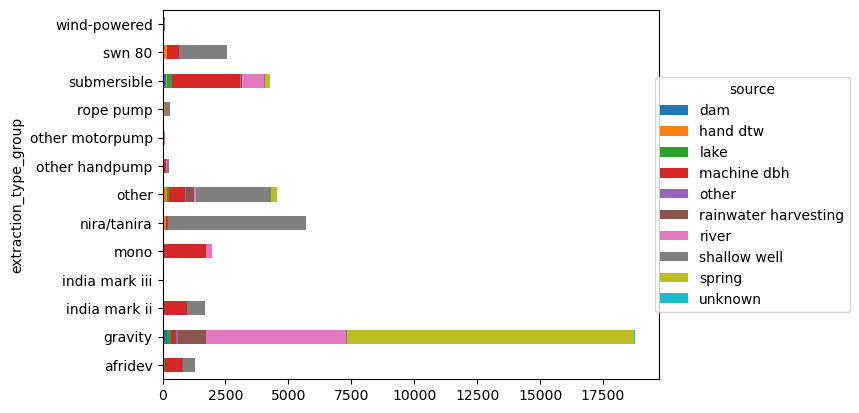

<Figure size 1600x800 with 0 Axes>

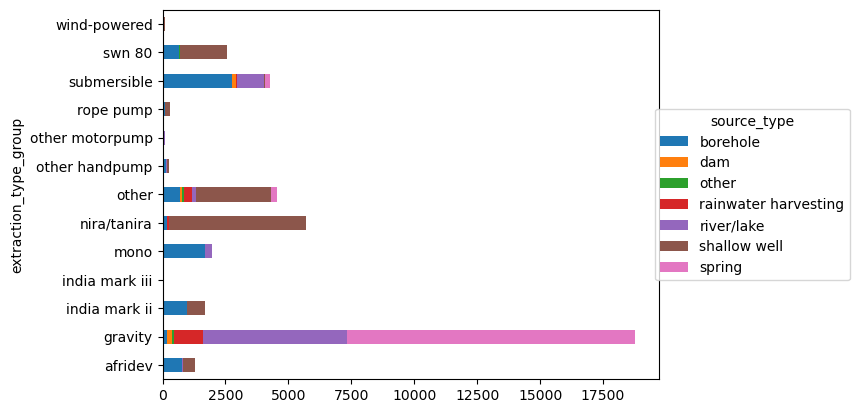

<Figure size 1600x800 with 0 Axes>

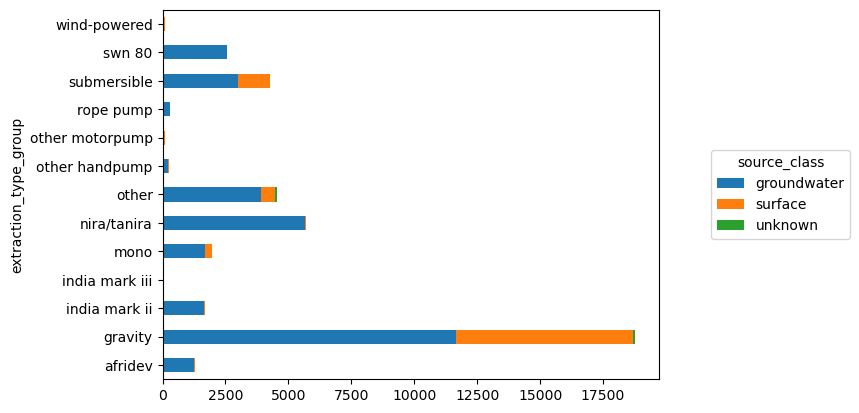

<Figure size 1600x800 with 0 Axes>

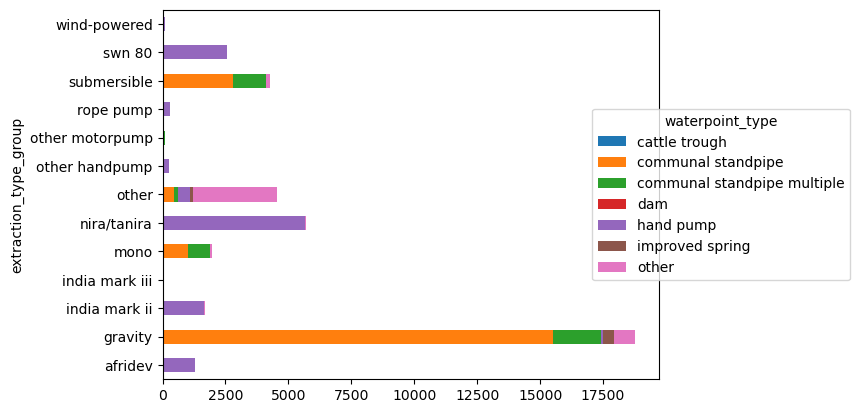

<Figure size 1600x800 with 0 Axes>

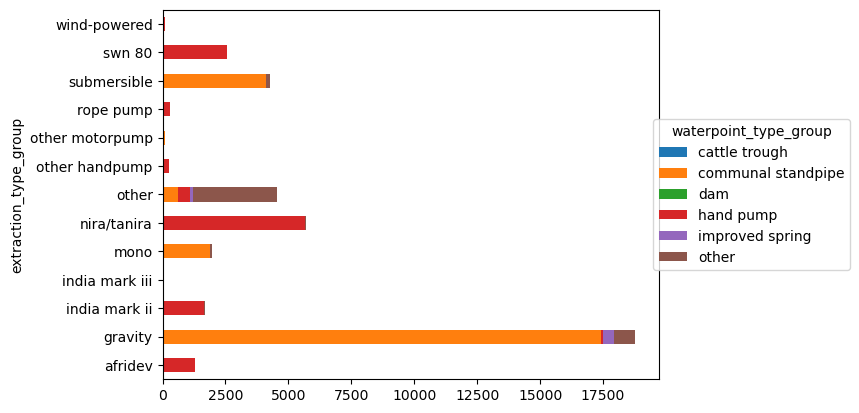

<Figure size 1600x800 with 0 Axes>

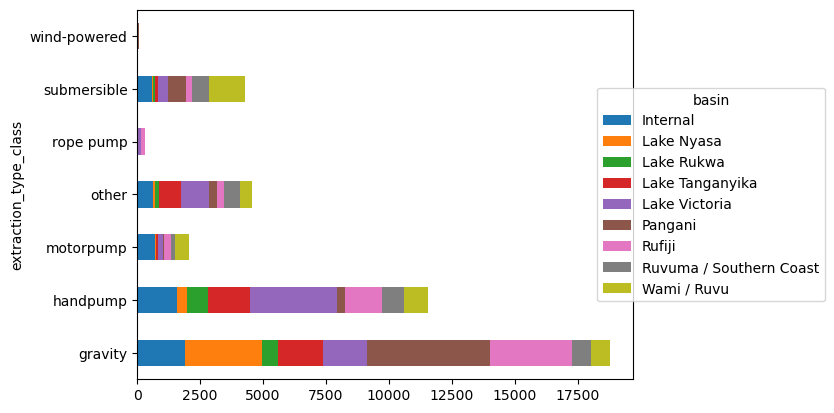

<Figure size 1600x800 with 0 Axes>

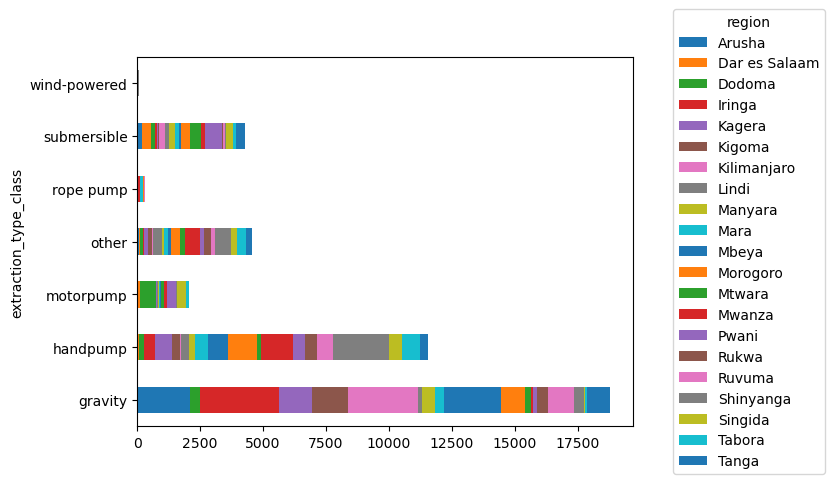

<Figure size 1600x800 with 0 Axes>

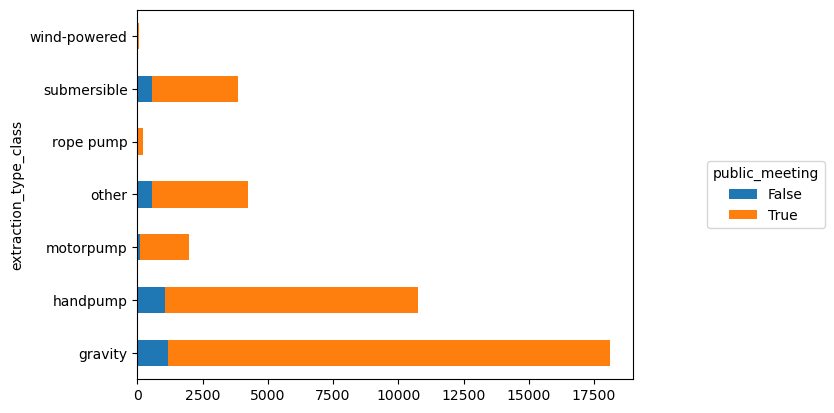

<Figure size 1600x800 with 0 Axes>

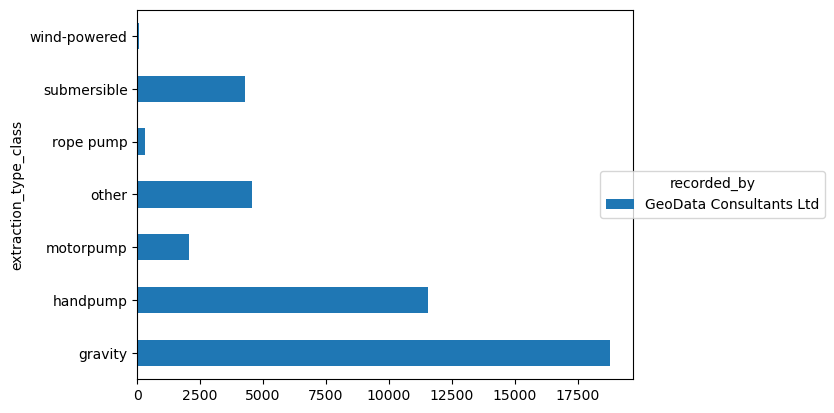

<Figure size 1600x800 with 0 Axes>

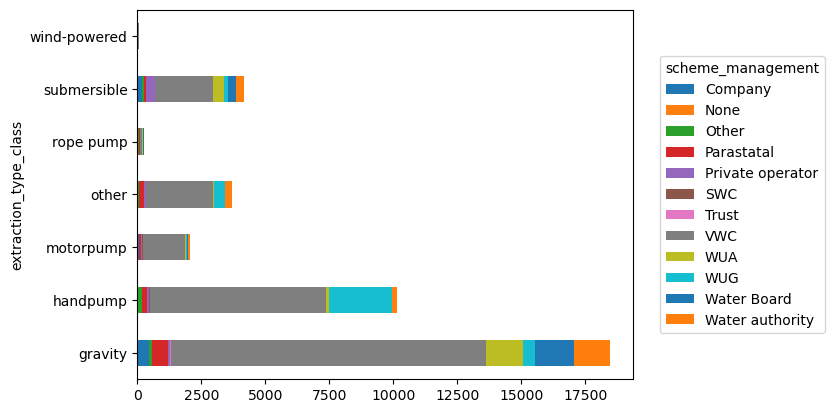

<Figure size 1600x800 with 0 Axes>

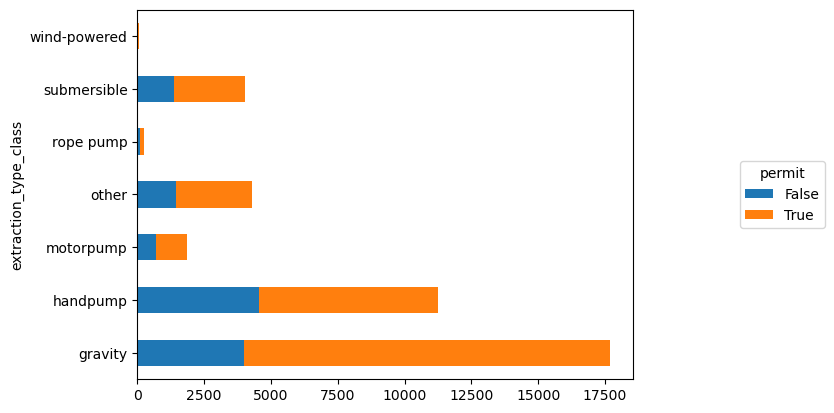

<Figure size 1600x800 with 0 Axes>

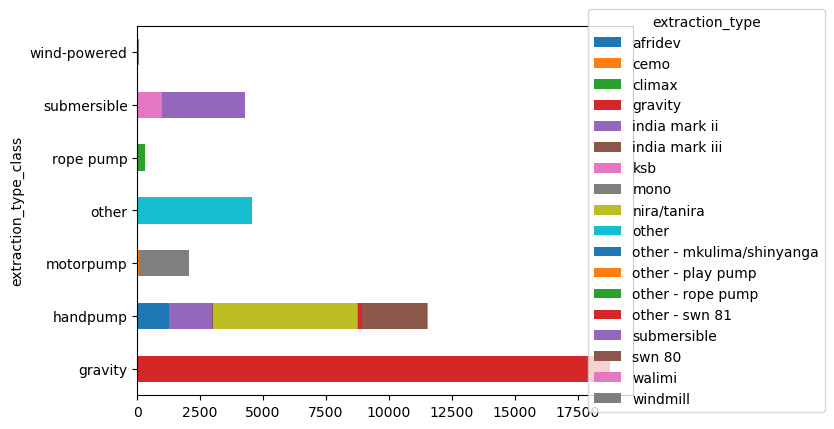

<Figure size 1600x800 with 0 Axes>

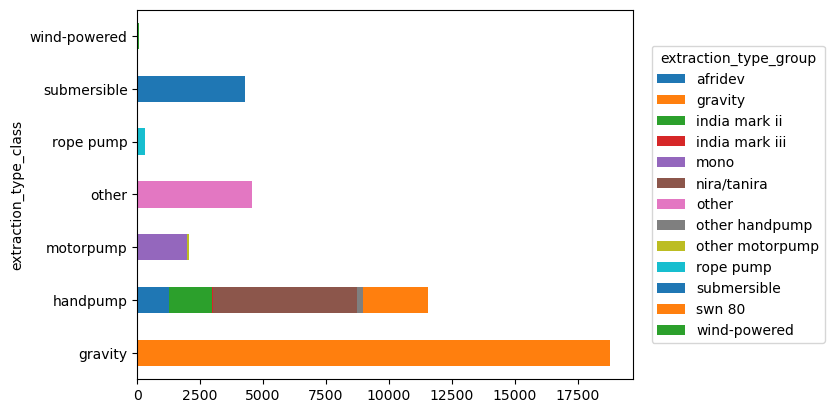

<Figure size 1600x800 with 0 Axes>

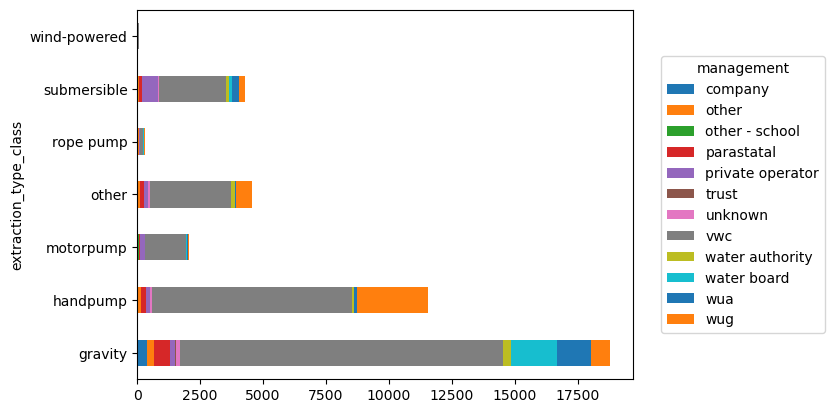

<Figure size 1600x800 with 0 Axes>

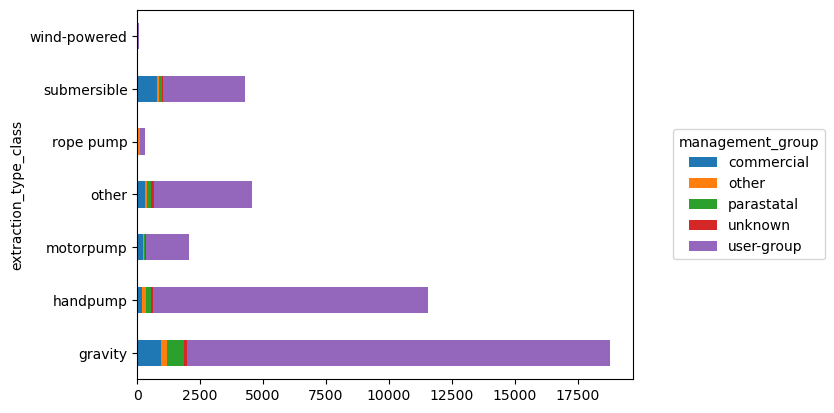

<Figure size 1600x800 with 0 Axes>

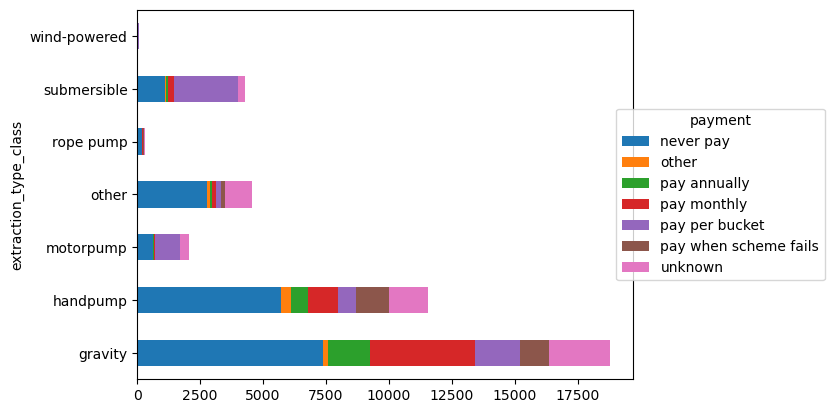

<Figure size 1600x800 with 0 Axes>

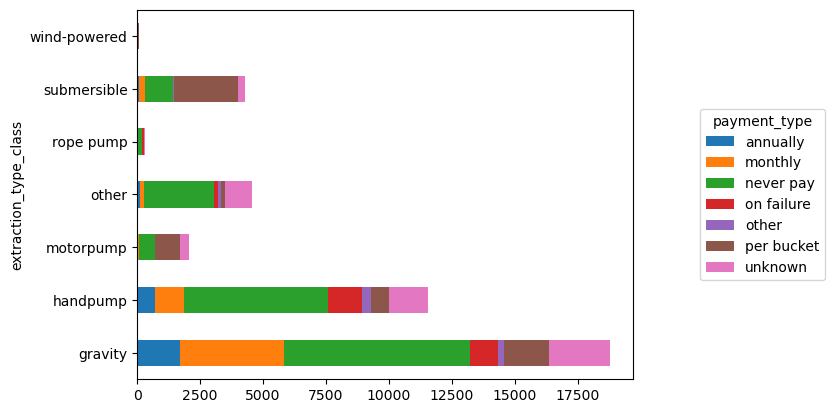

<Figure size 1600x800 with 0 Axes>

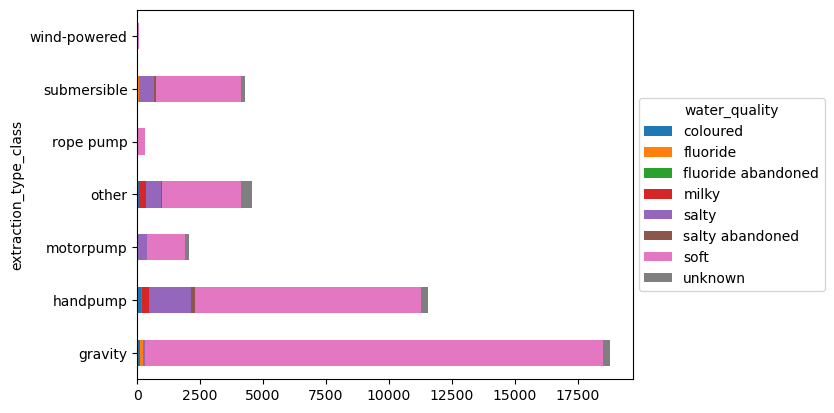

<Figure size 1600x800 with 0 Axes>

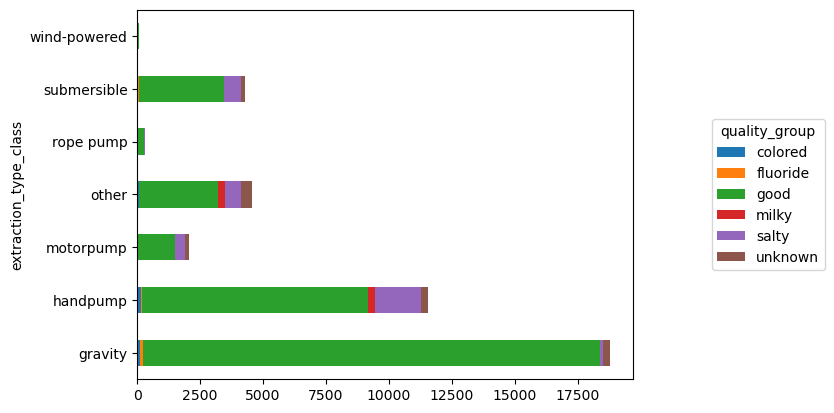

<Figure size 1600x800 with 0 Axes>

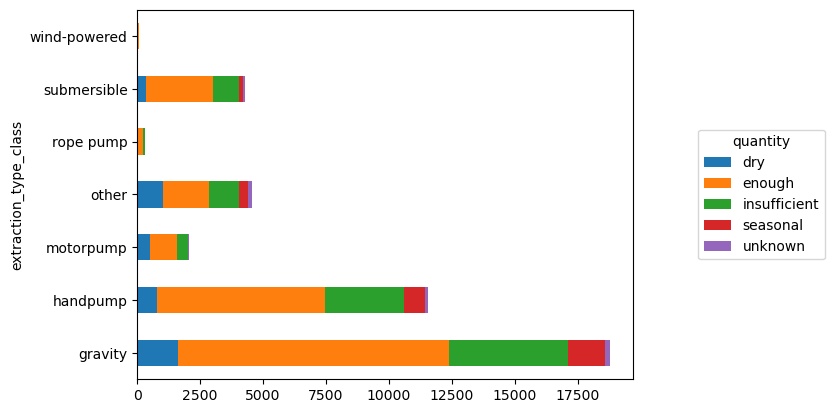

<Figure size 1600x800 with 0 Axes>

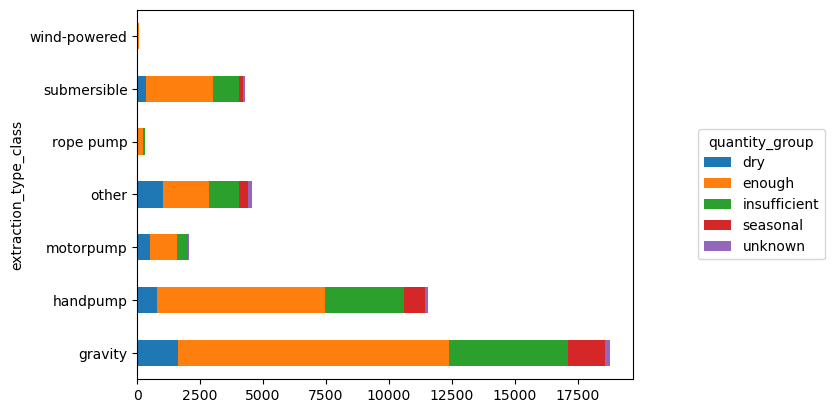

<Figure size 1600x800 with 0 Axes>

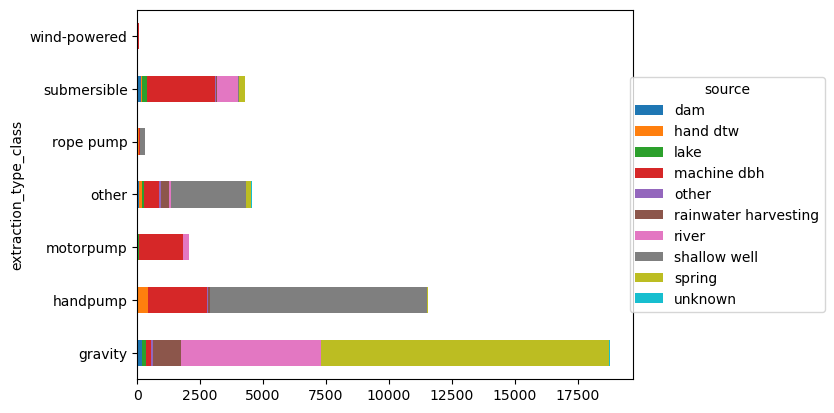

<Figure size 1600x800 with 0 Axes>

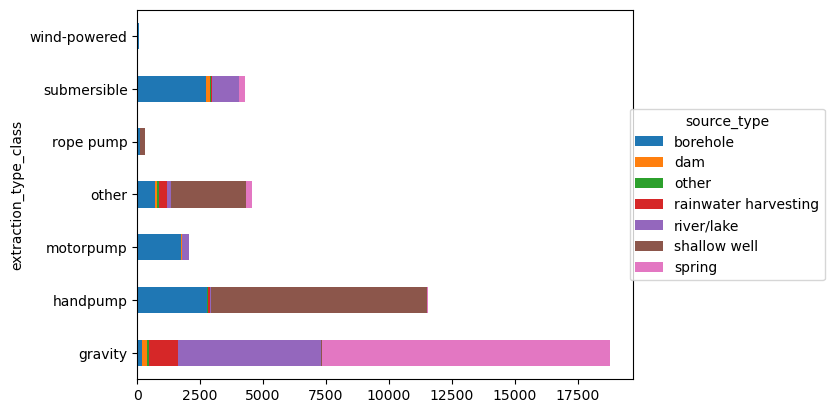

<Figure size 1600x800 with 0 Axes>

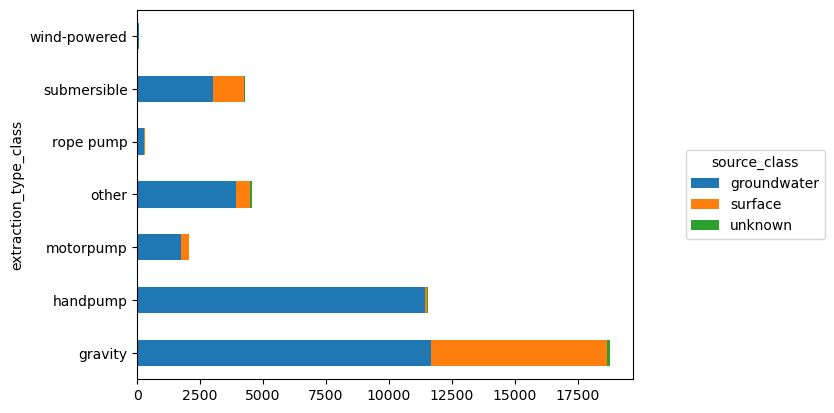

<Figure size 1600x800 with 0 Axes>

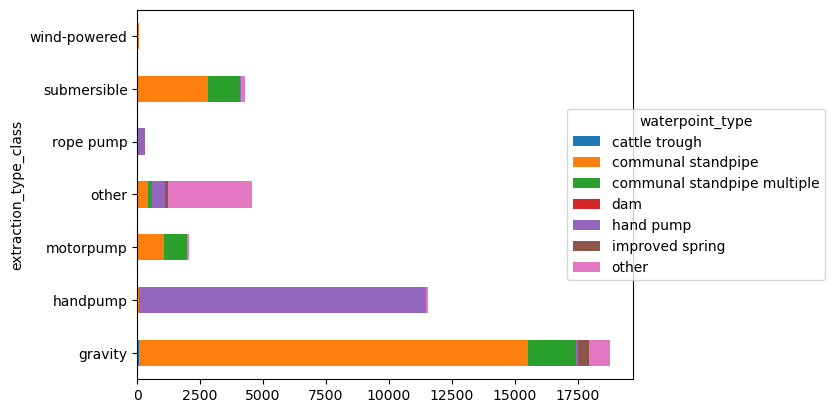

<Figure size 1600x800 with 0 Axes>

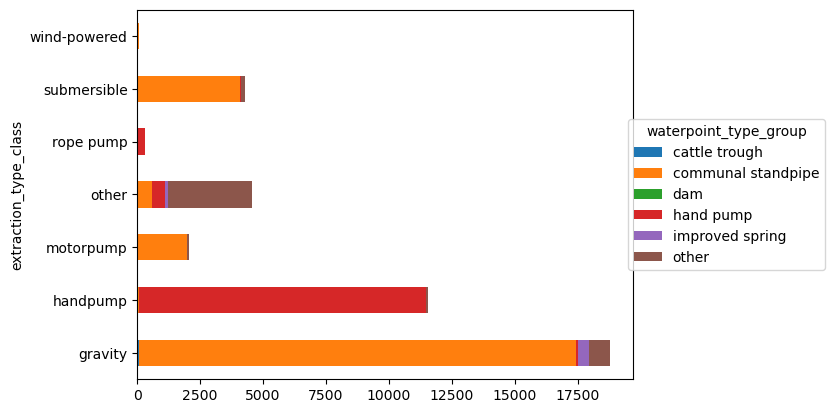

<Figure size 1600x800 with 0 Axes>

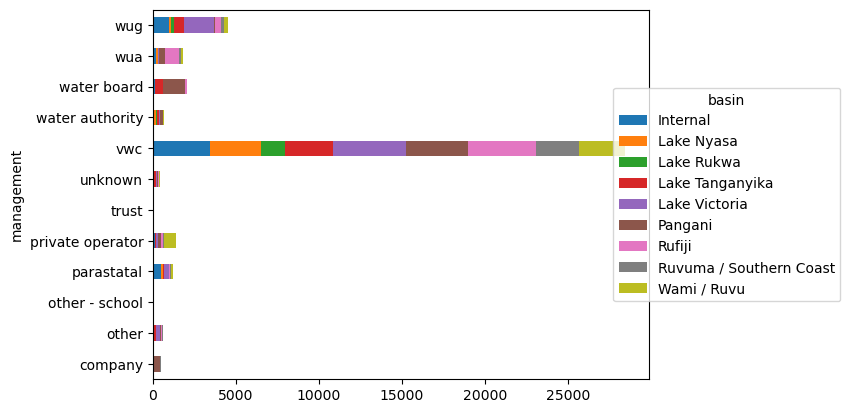

<Figure size 1600x800 with 0 Axes>

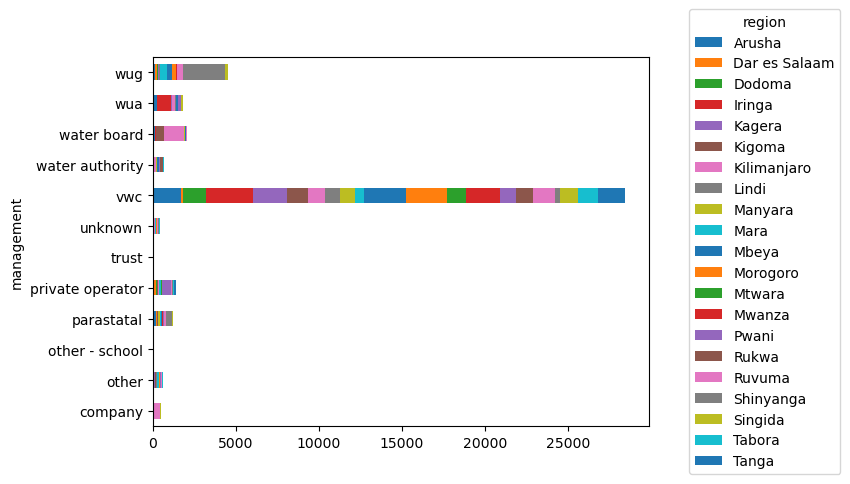

<Figure size 1600x800 with 0 Axes>

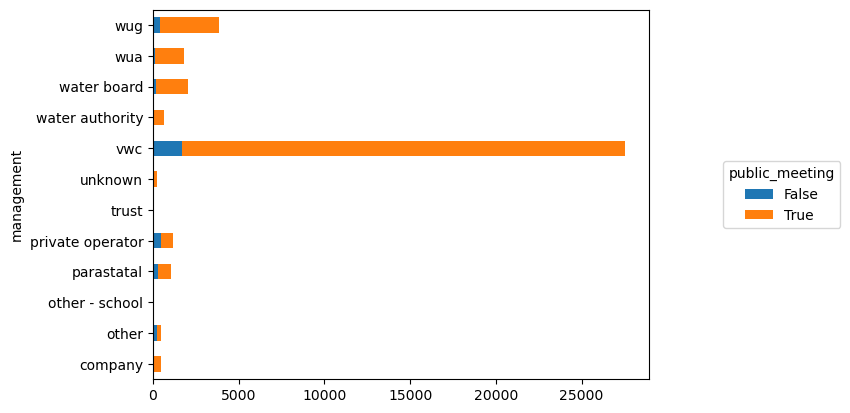

<Figure size 1600x800 with 0 Axes>

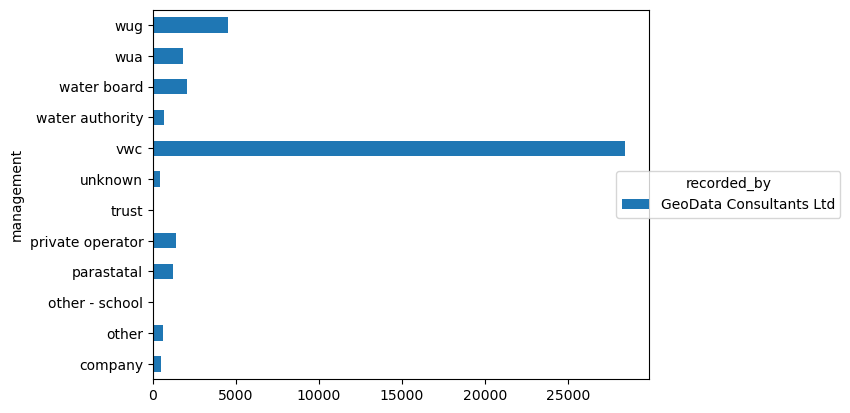

<Figure size 1600x800 with 0 Axes>

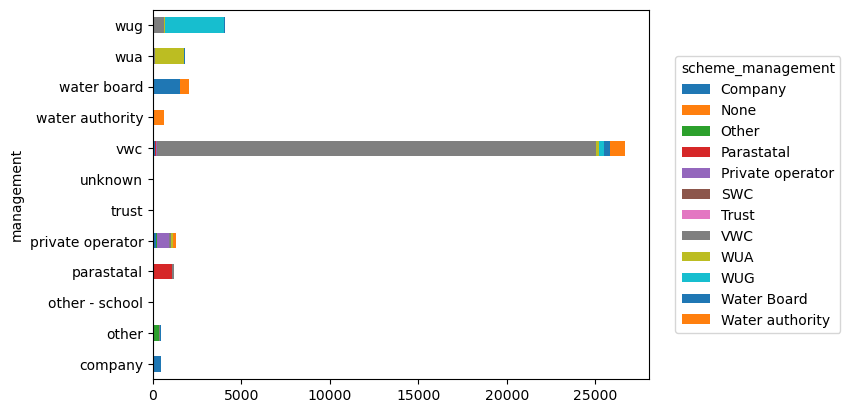

<Figure size 1600x800 with 0 Axes>

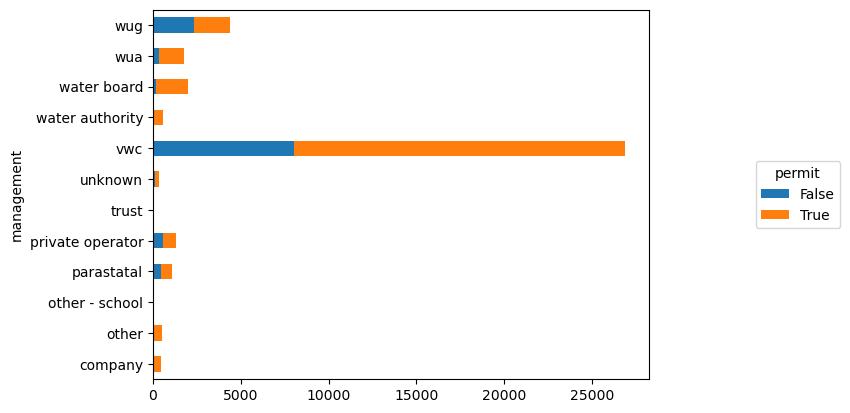

<Figure size 1600x800 with 0 Axes>

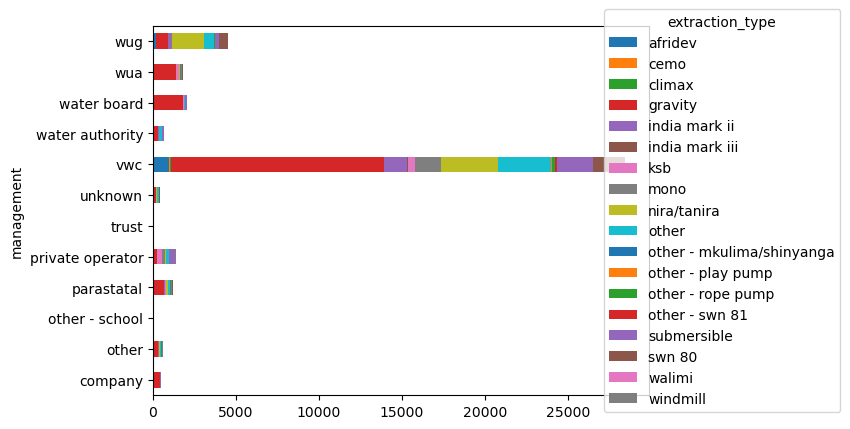

<Figure size 1600x800 with 0 Axes>

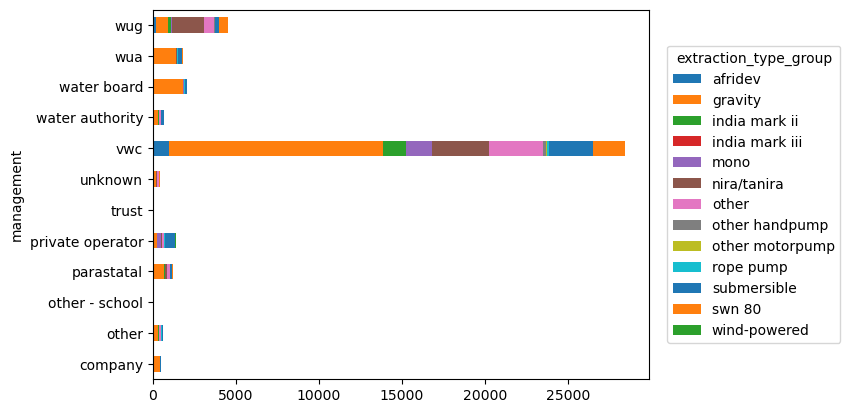

<Figure size 1600x800 with 0 Axes>

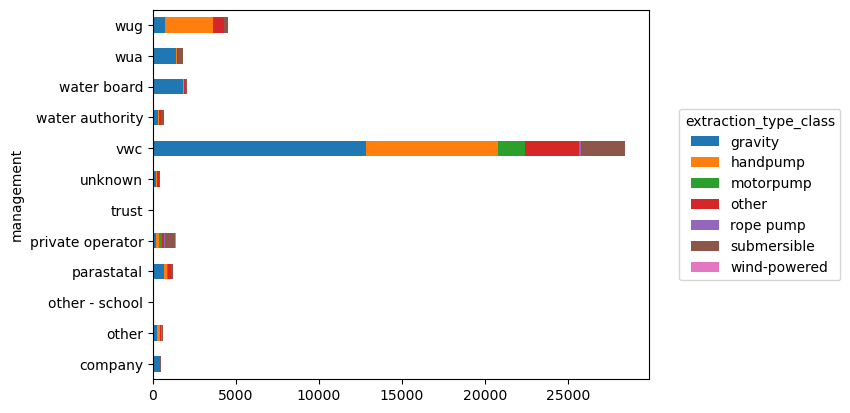

<Figure size 1600x800 with 0 Axes>

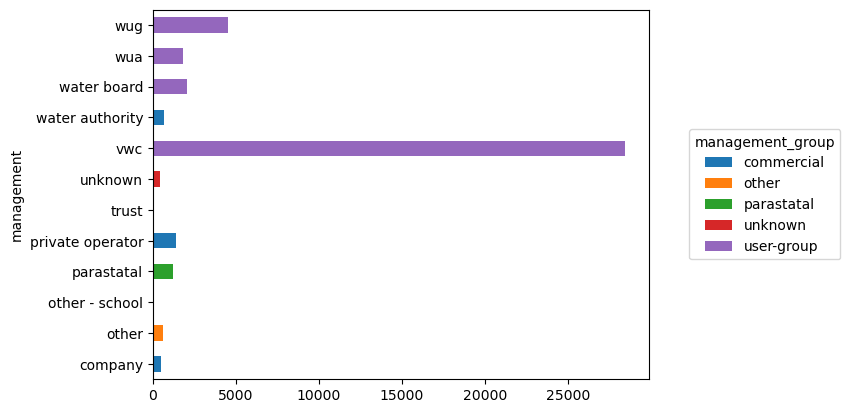

<Figure size 1600x800 with 0 Axes>

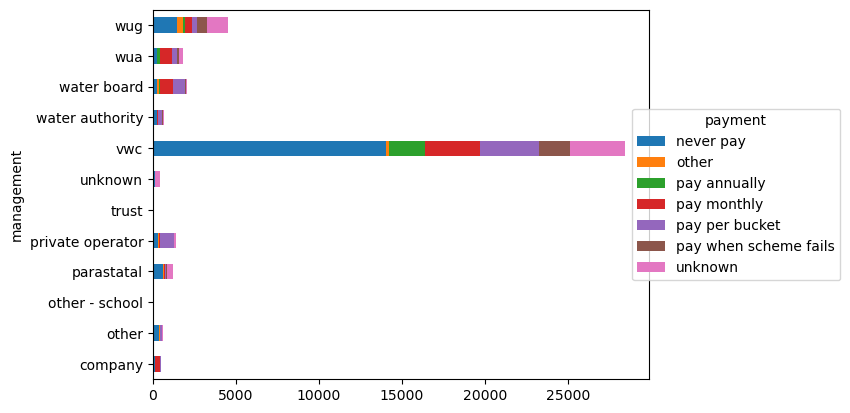

<Figure size 1600x800 with 0 Axes>

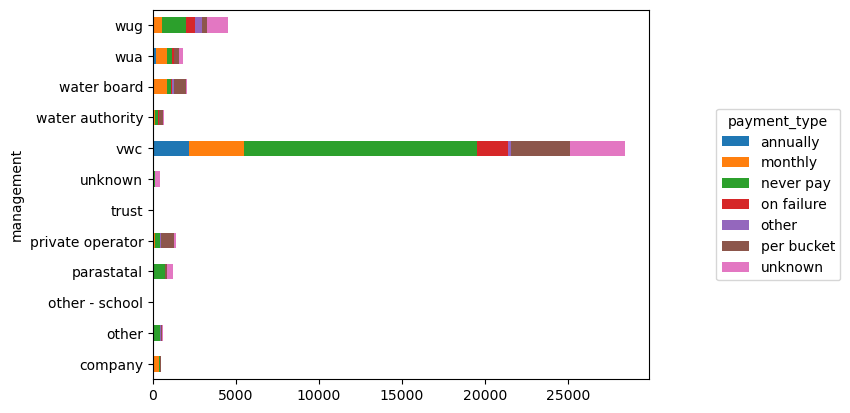

<Figure size 1600x800 with 0 Axes>

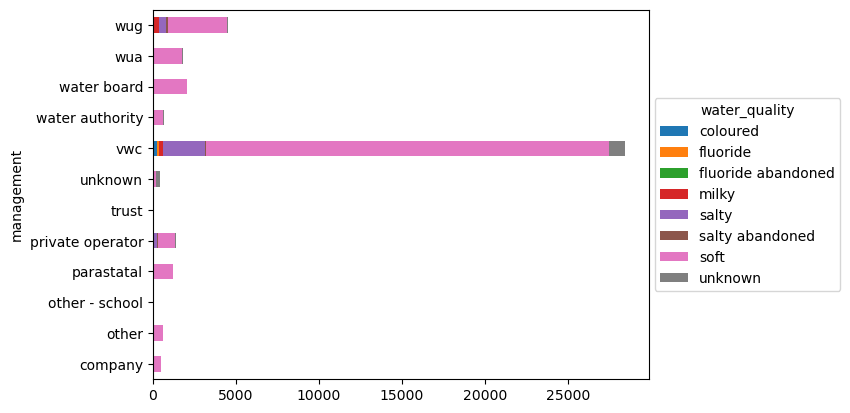

<Figure size 1600x800 with 0 Axes>

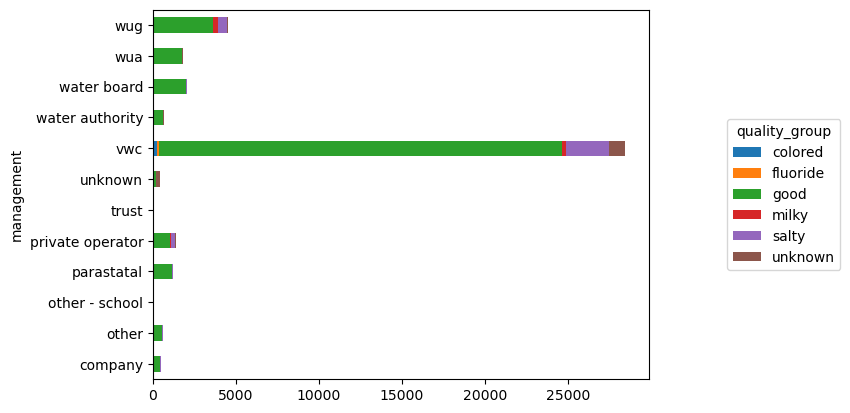

<Figure size 1600x800 with 0 Axes>

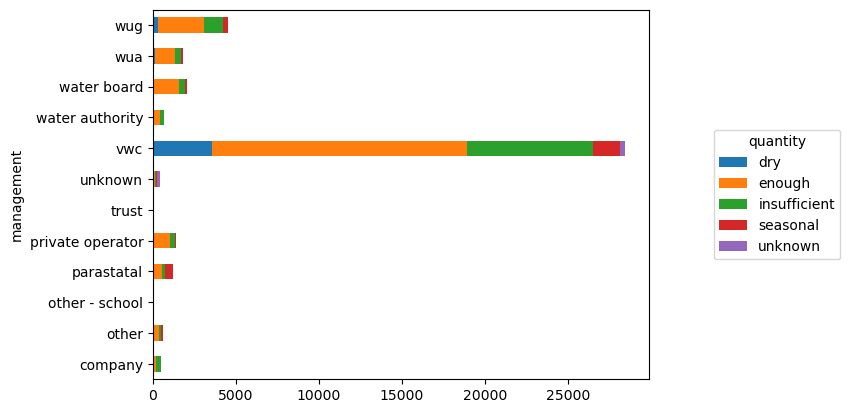

<Figure size 1600x800 with 0 Axes>

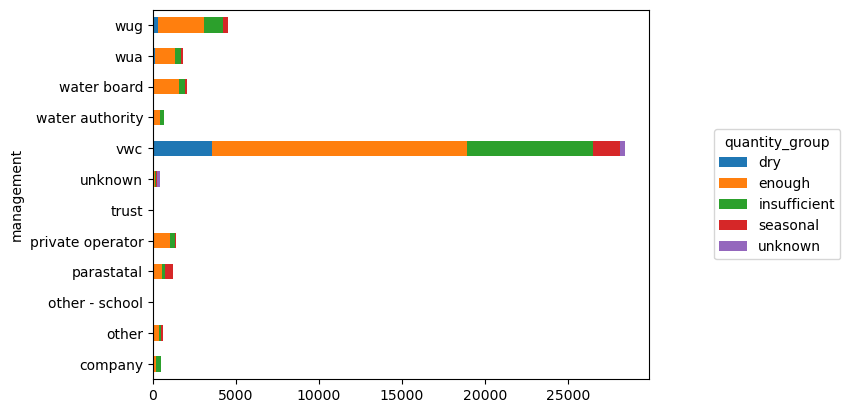

<Figure size 1600x800 with 0 Axes>

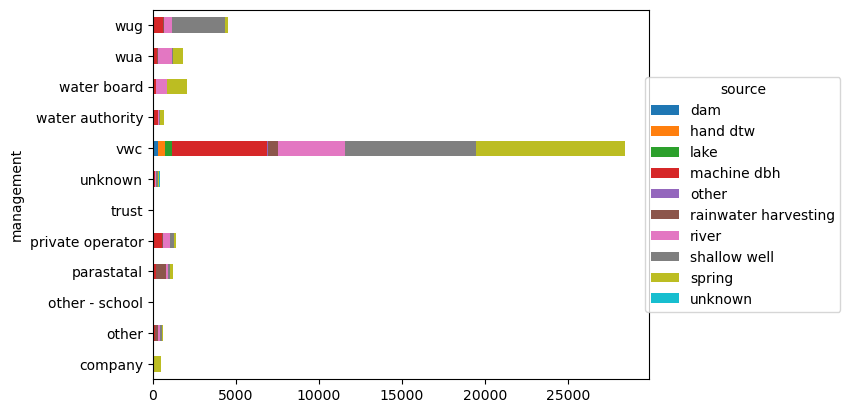

<Figure size 1600x800 with 0 Axes>

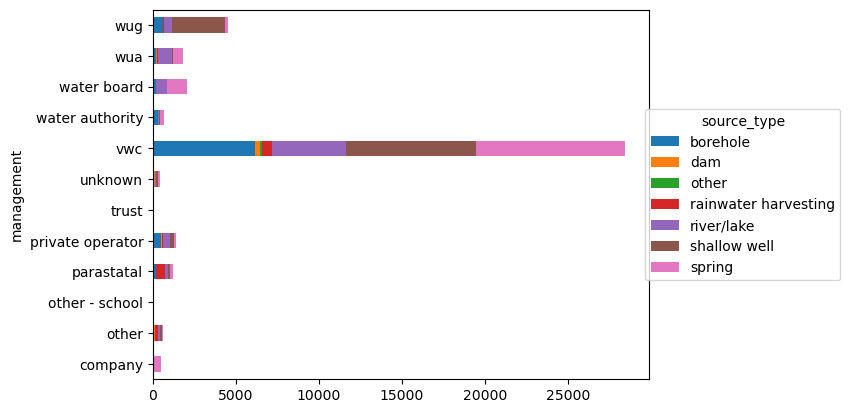

<Figure size 1600x800 with 0 Axes>

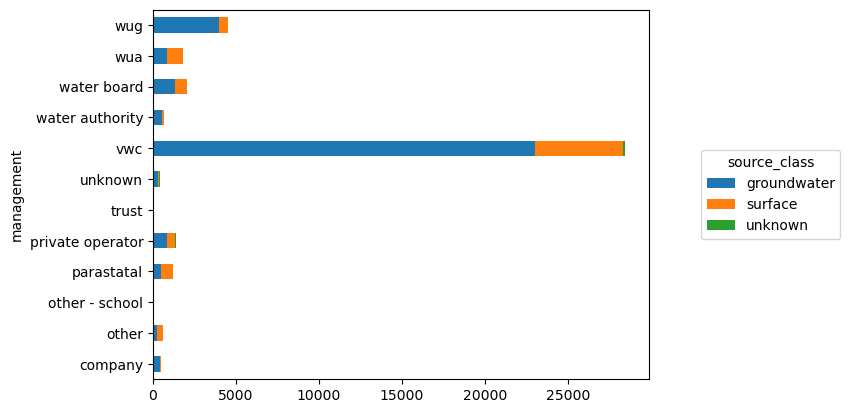

<Figure size 1600x800 with 0 Axes>

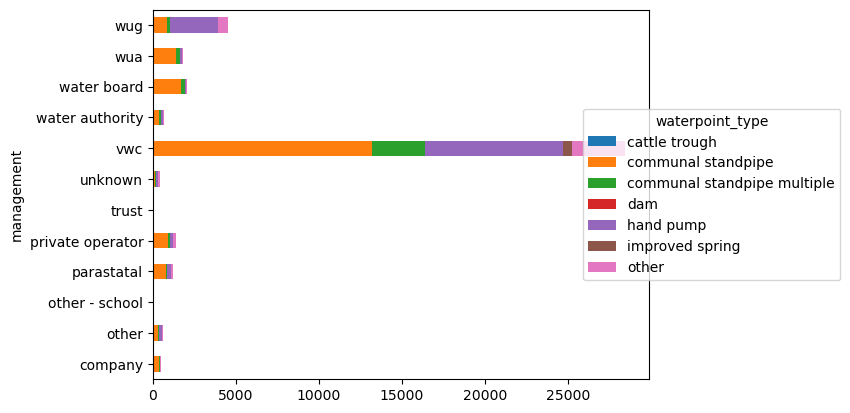

<Figure size 1600x800 with 0 Axes>

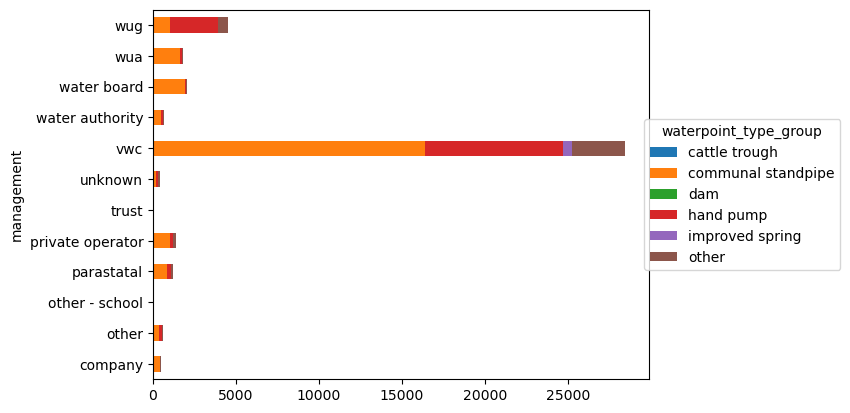

<Figure size 1600x800 with 0 Axes>

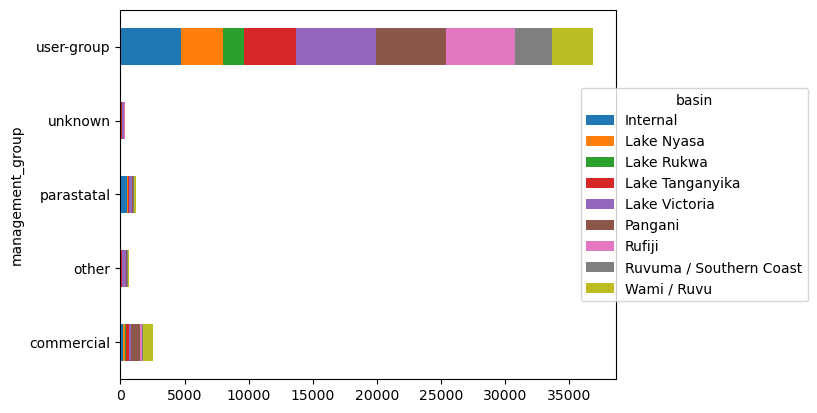

<Figure size 1600x800 with 0 Axes>

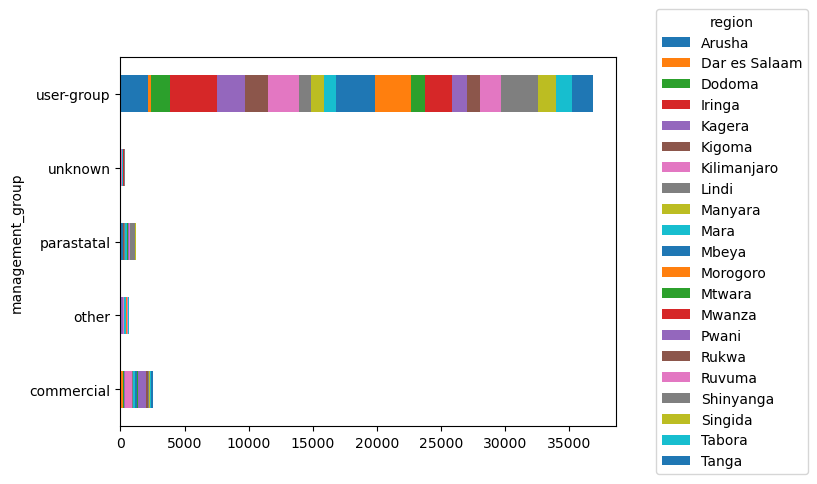

<Figure size 1600x800 with 0 Axes>

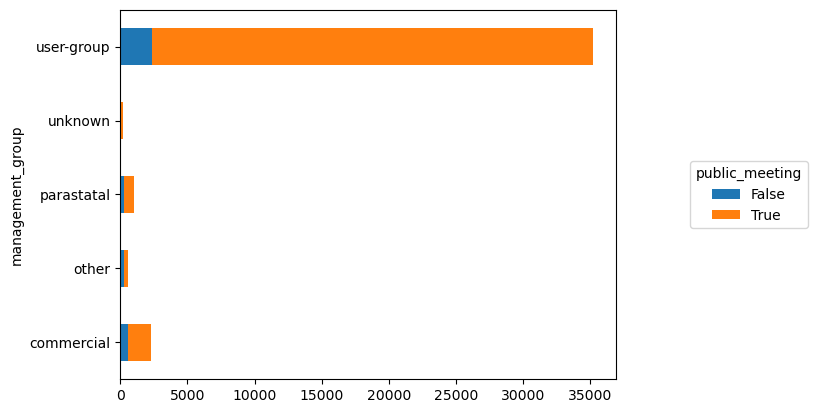

<Figure size 1600x800 with 0 Axes>

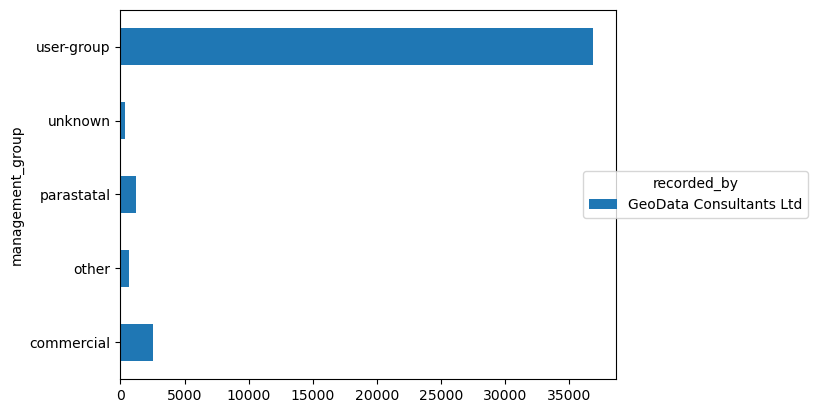

<Figure size 1600x800 with 0 Axes>

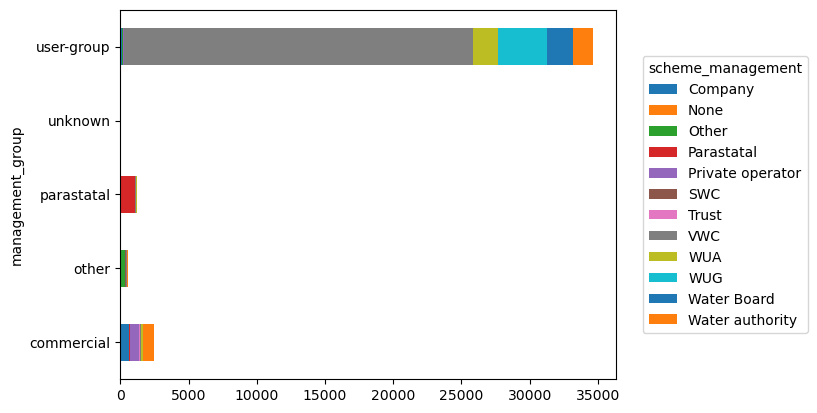

<Figure size 1600x800 with 0 Axes>

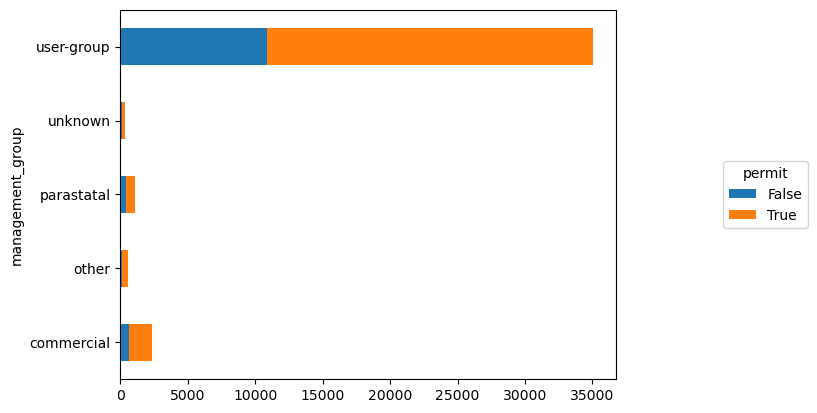

<Figure size 1600x800 with 0 Axes>

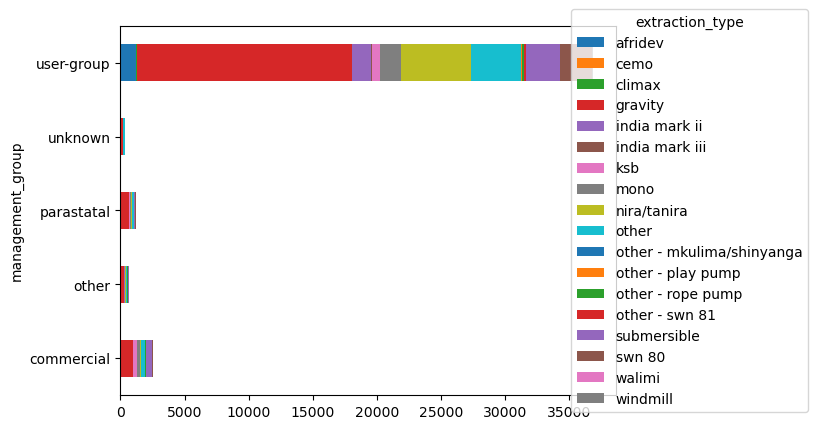

<Figure size 1600x800 with 0 Axes>

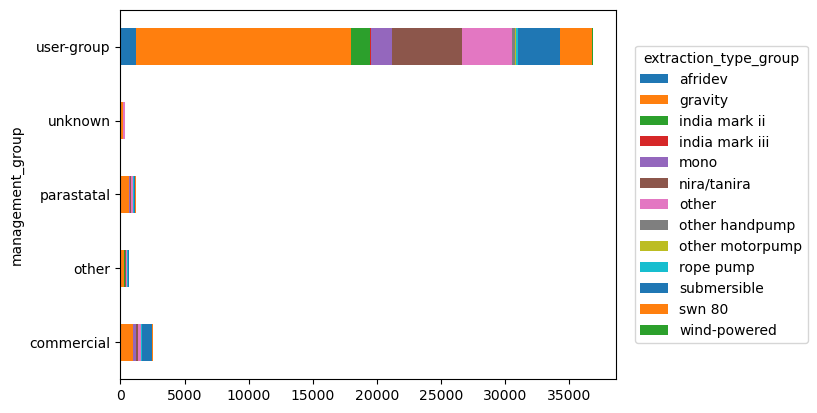

<Figure size 1600x800 with 0 Axes>

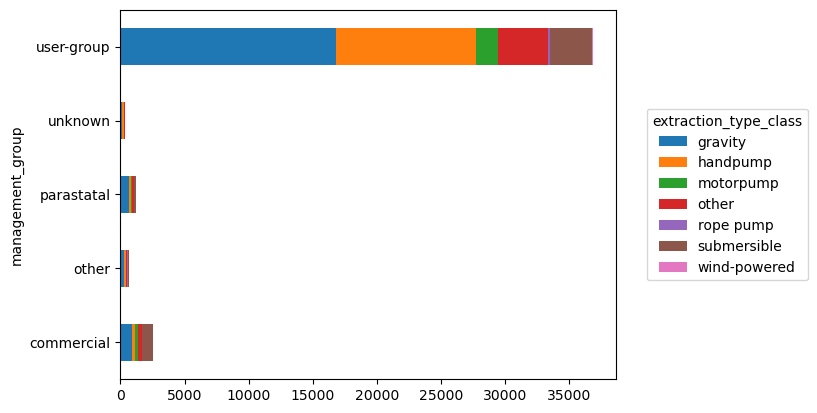

<Figure size 1600x800 with 0 Axes>

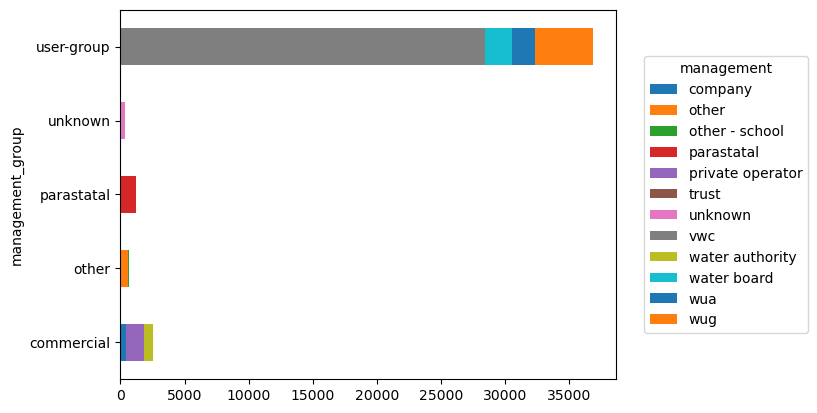

<Figure size 1600x800 with 0 Axes>

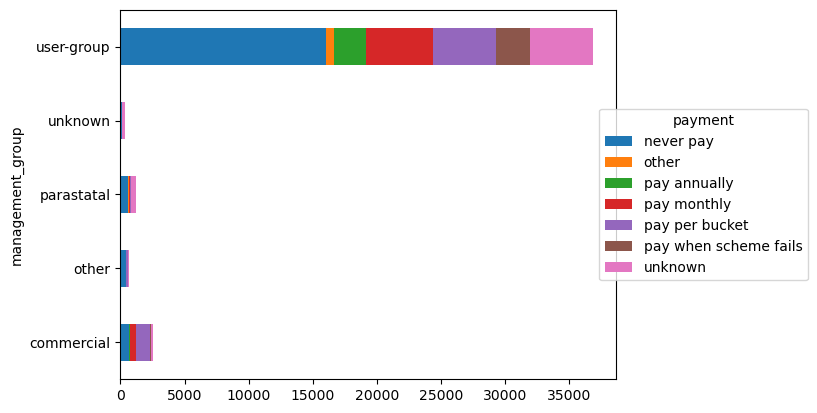

<Figure size 1600x800 with 0 Axes>

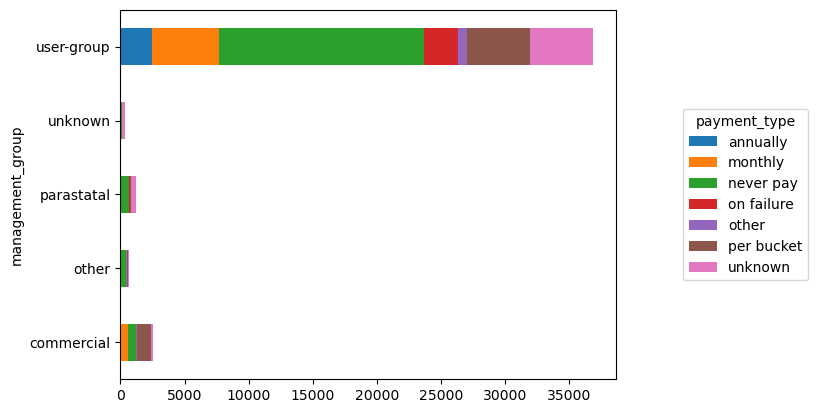

<Figure size 1600x800 with 0 Axes>

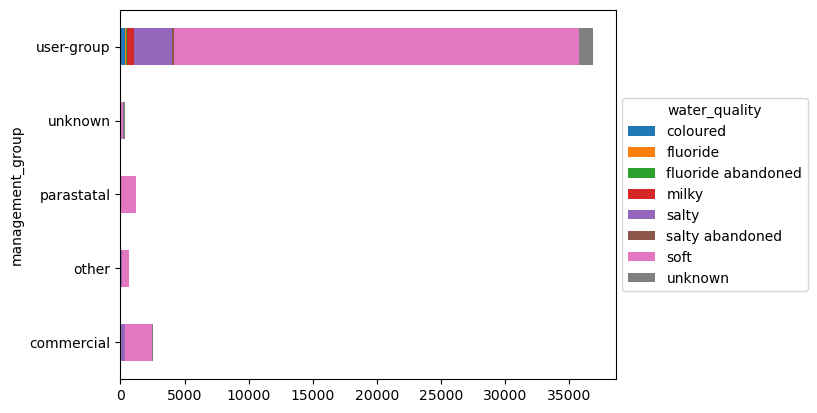

<Figure size 1600x800 with 0 Axes>

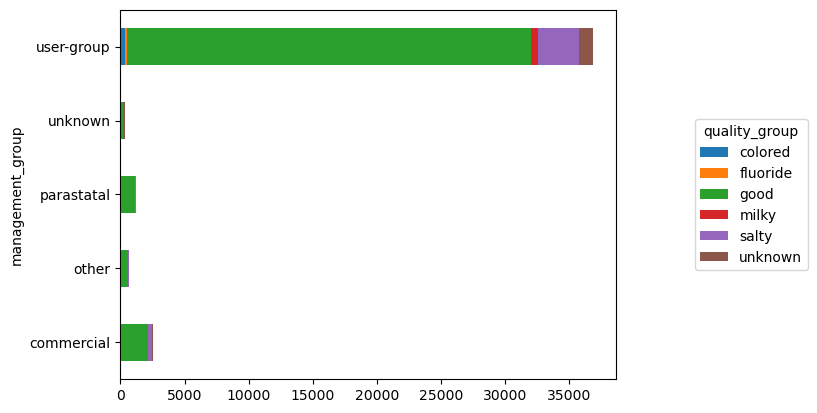

<Figure size 1600x800 with 0 Axes>

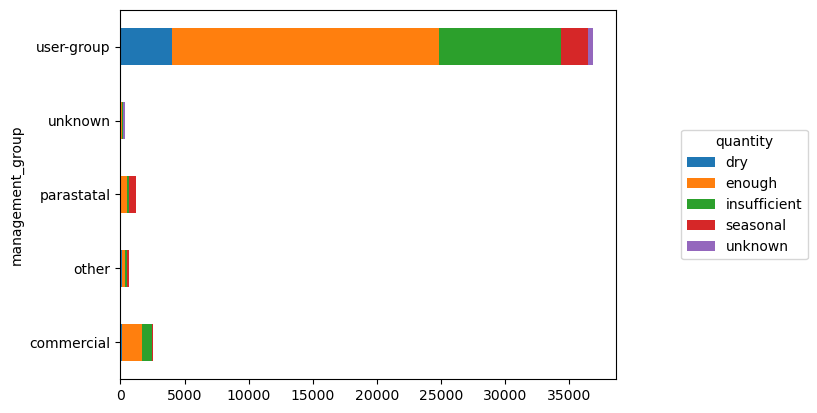

<Figure size 1600x800 with 0 Axes>

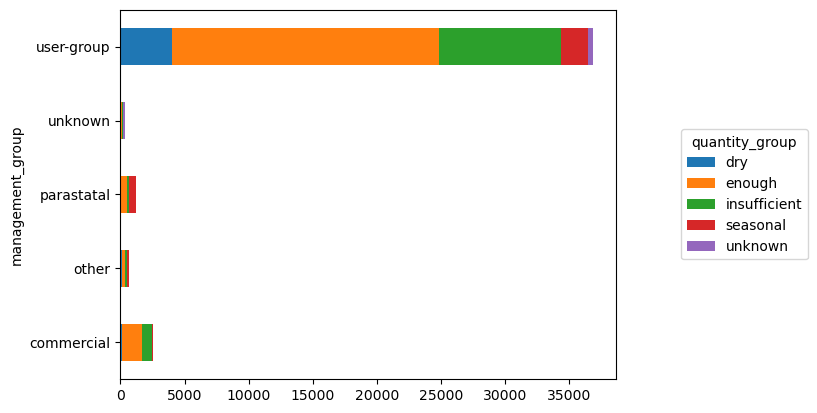

<Figure size 1600x800 with 0 Axes>

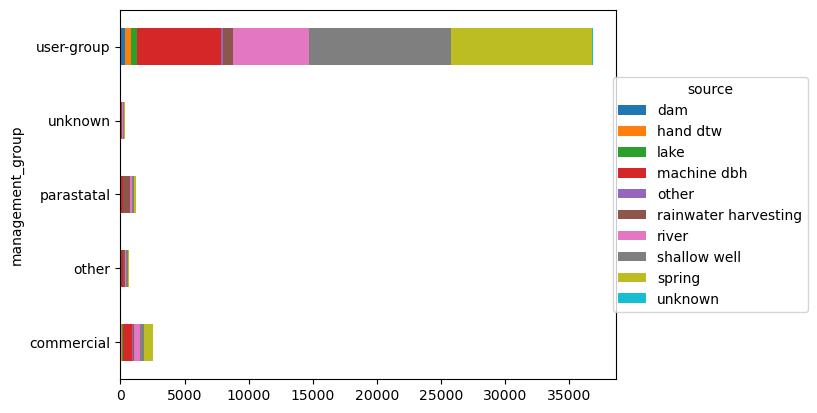

<Figure size 1600x800 with 0 Axes>

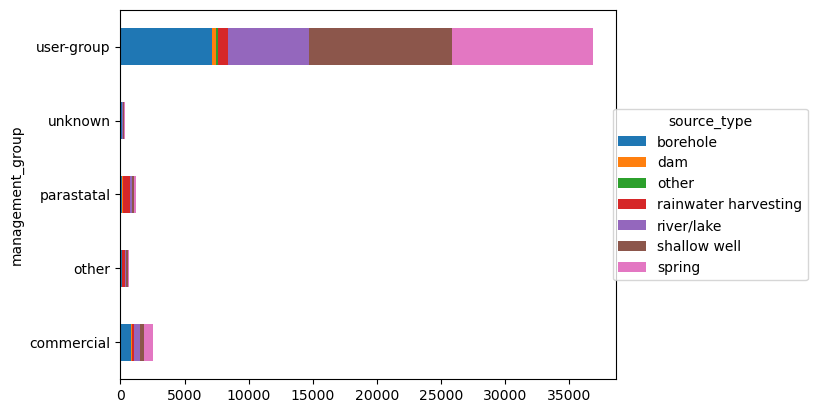

<Figure size 1600x800 with 0 Axes>

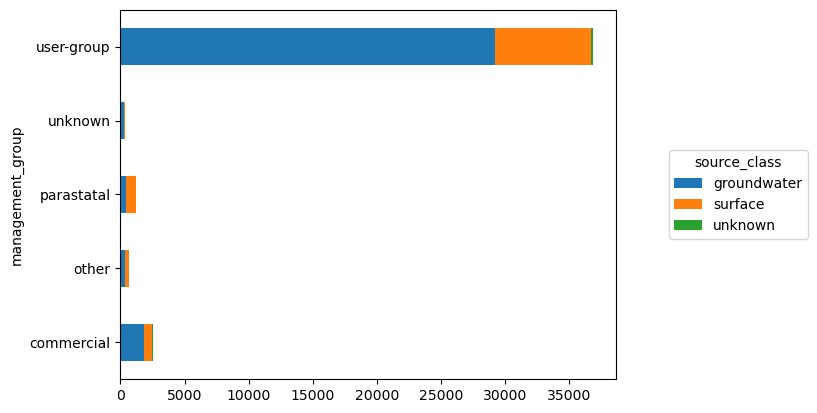

<Figure size 1600x800 with 0 Axes>

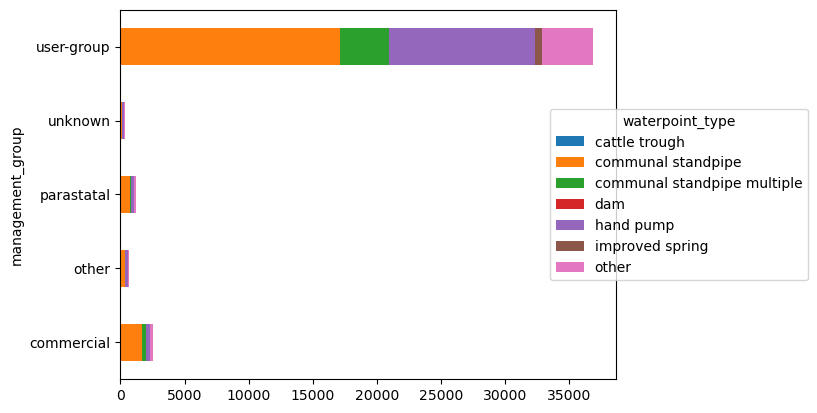

<Figure size 1600x800 with 0 Axes>

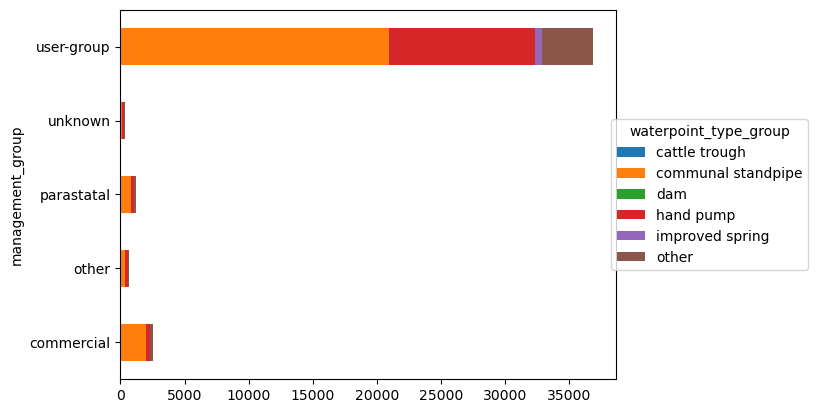

<Figure size 1600x800 with 0 Axes>

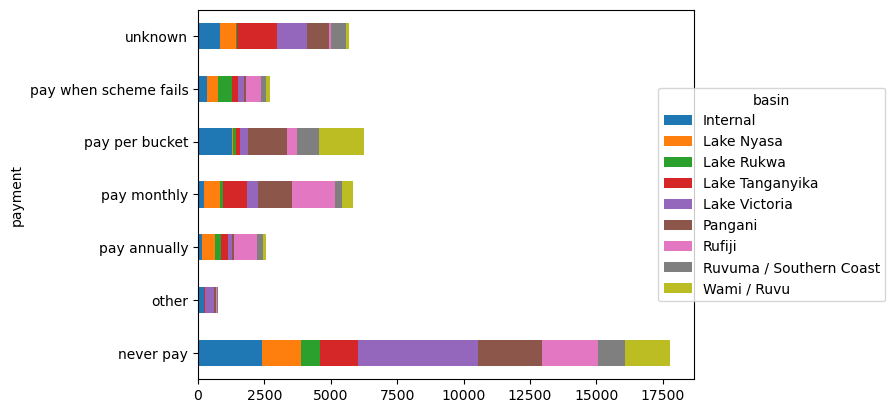

<Figure size 1600x800 with 0 Axes>

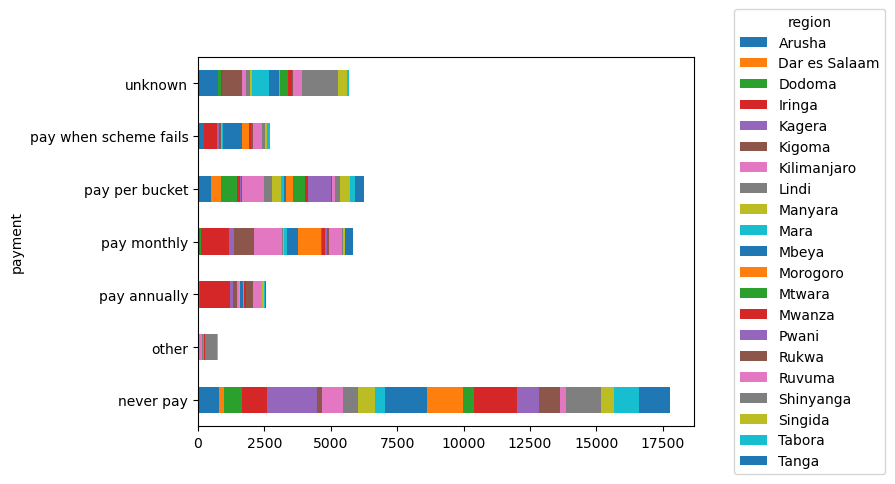

<Figure size 1600x800 with 0 Axes>

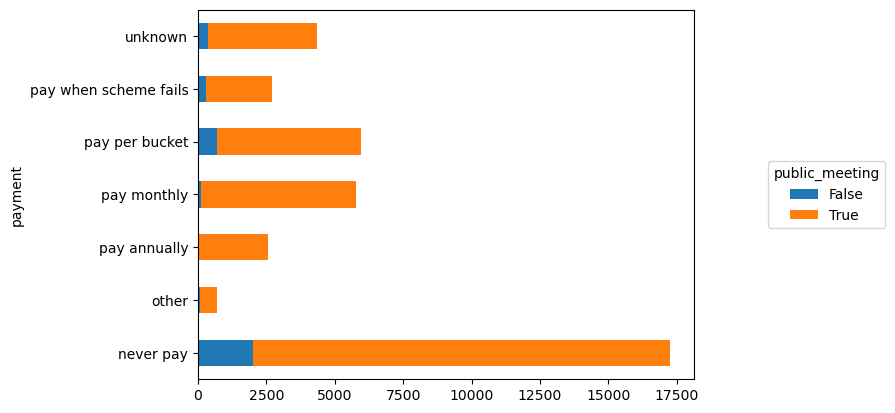

<Figure size 1600x800 with 0 Axes>

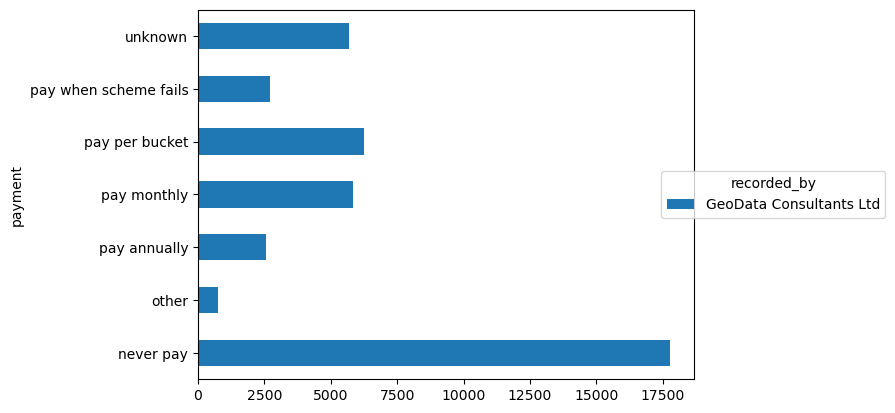

<Figure size 1600x800 with 0 Axes>

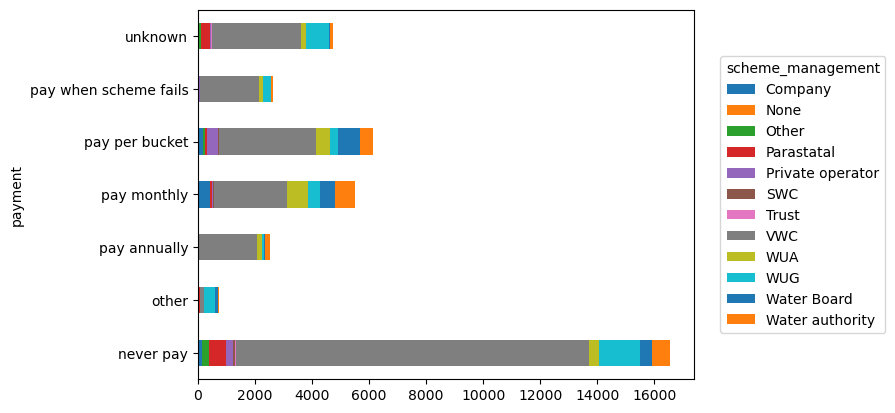

<Figure size 1600x800 with 0 Axes>

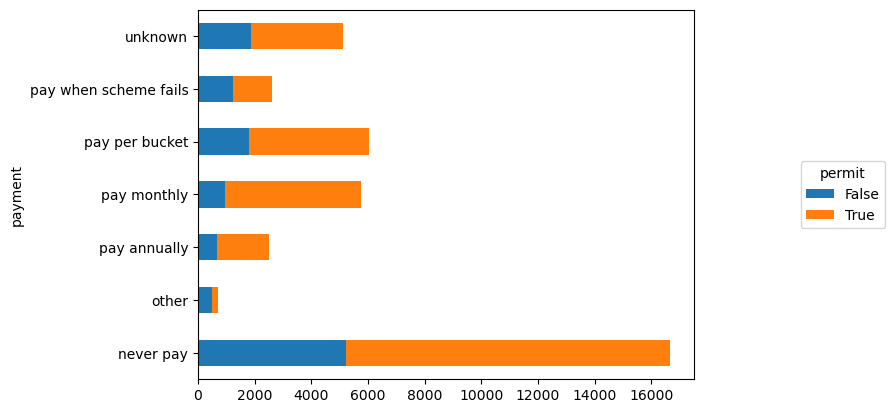

<Figure size 1600x800 with 0 Axes>

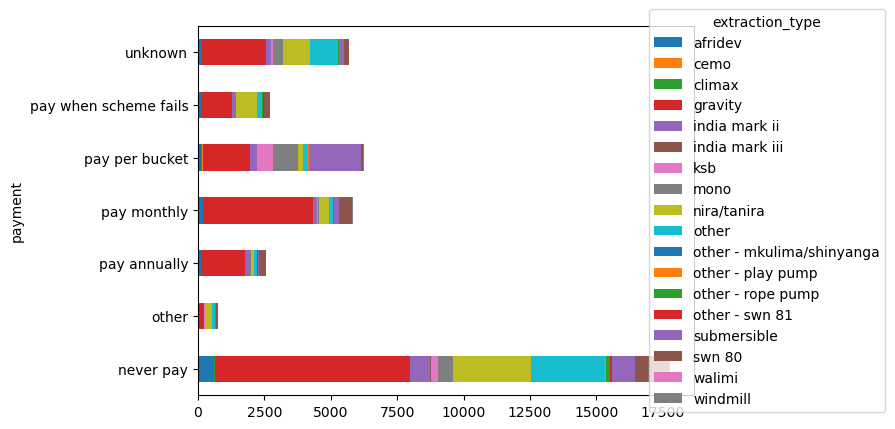

<Figure size 1600x800 with 0 Axes>

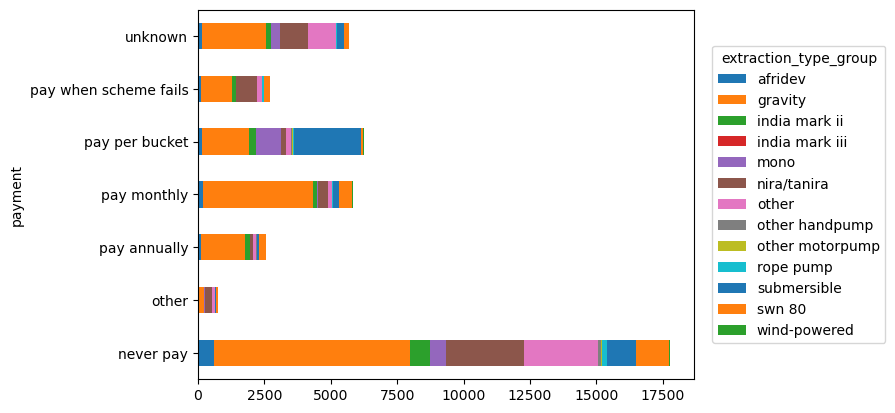

<Figure size 1600x800 with 0 Axes>

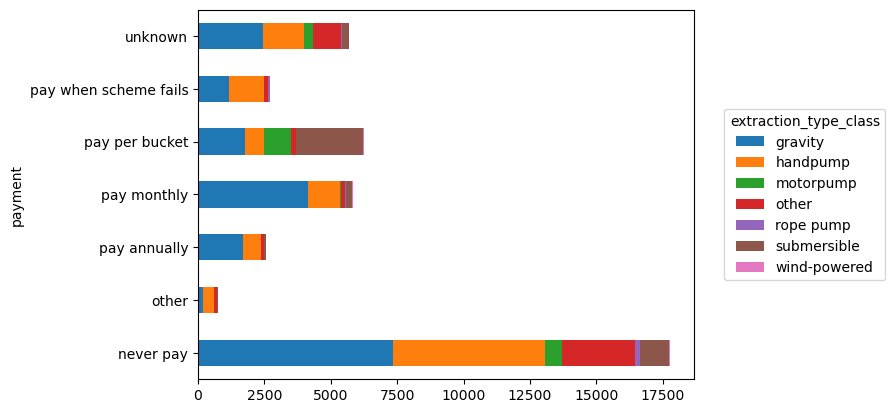

<Figure size 1600x800 with 0 Axes>

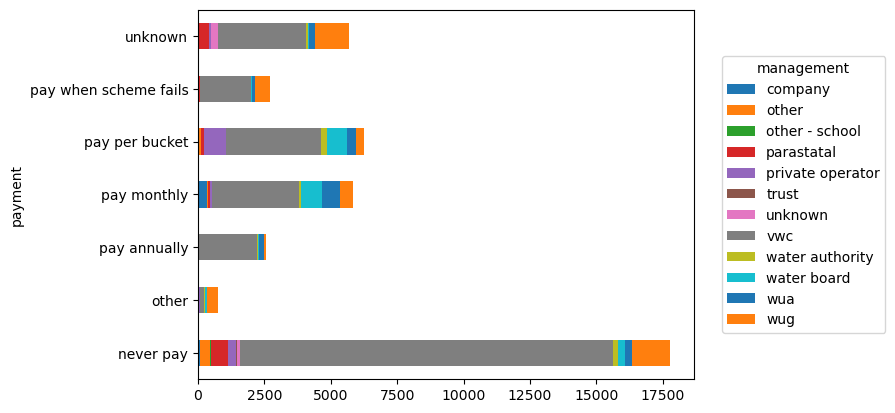

<Figure size 1600x800 with 0 Axes>

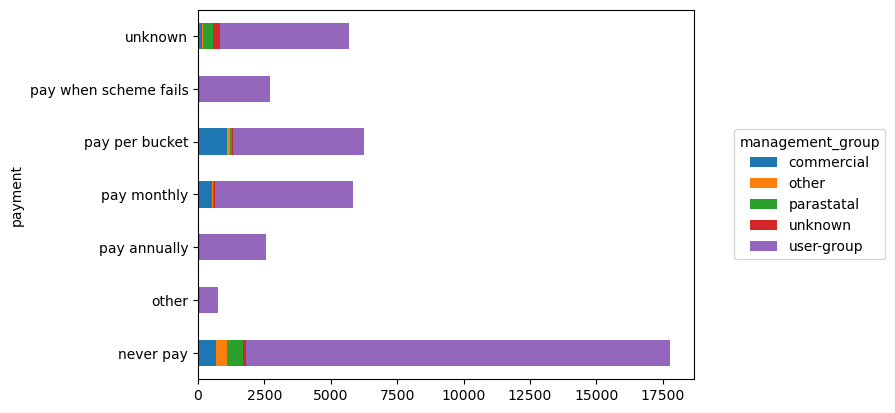

<Figure size 1600x800 with 0 Axes>

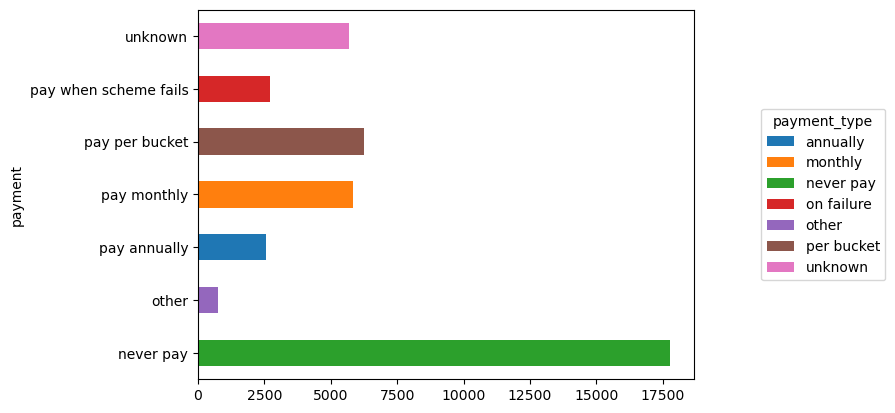

<Figure size 1600x800 with 0 Axes>

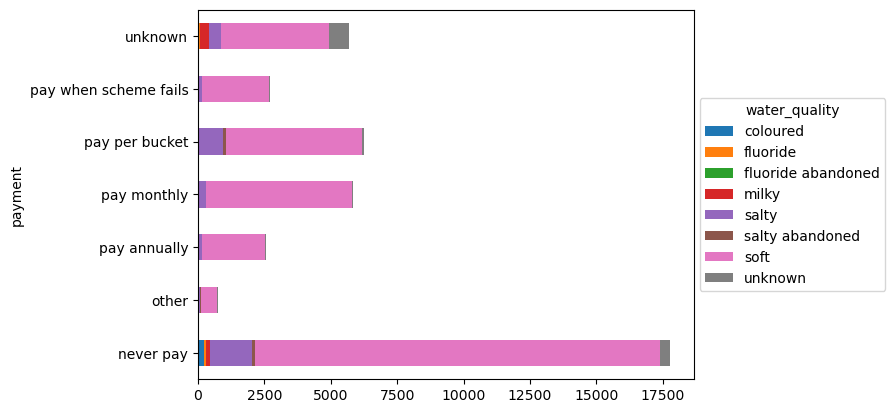

<Figure size 1600x800 with 0 Axes>

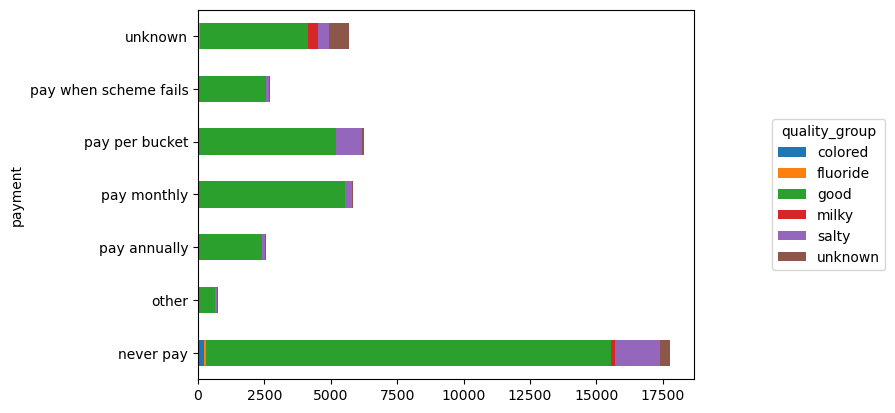

<Figure size 1600x800 with 0 Axes>

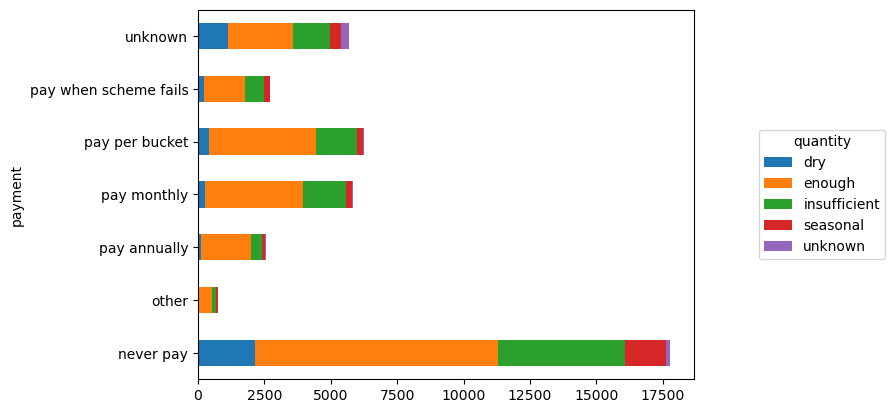

<Figure size 1600x800 with 0 Axes>

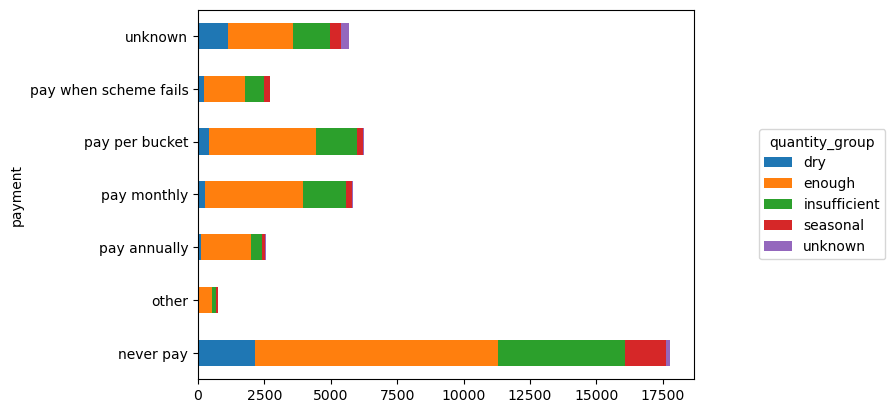

<Figure size 1600x800 with 0 Axes>

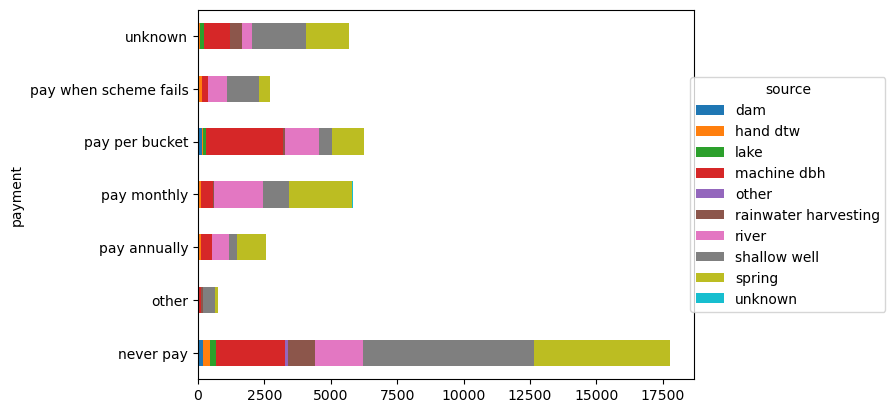

<Figure size 1600x800 with 0 Axes>

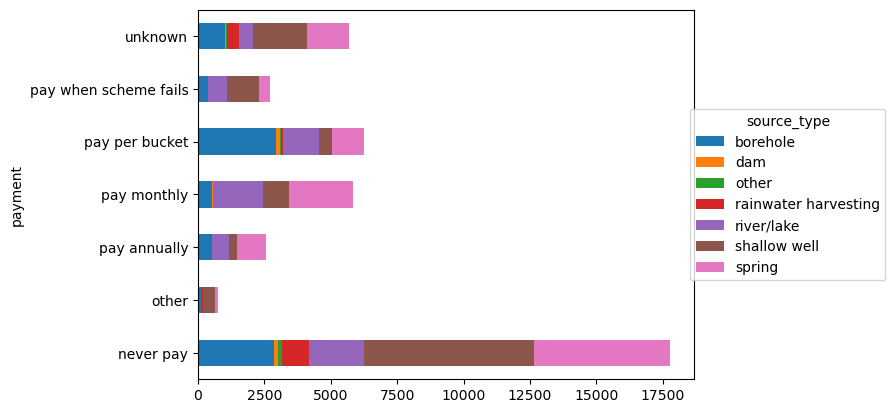

<Figure size 1600x800 with 0 Axes>

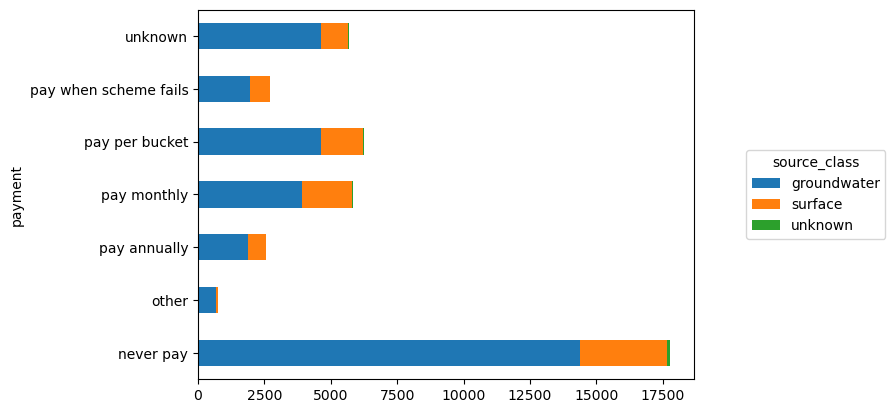

<Figure size 1600x800 with 0 Axes>

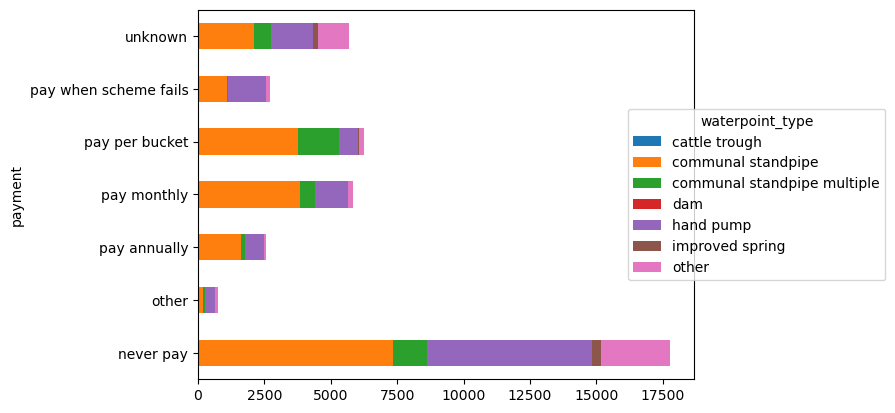

<Figure size 1600x800 with 0 Axes>

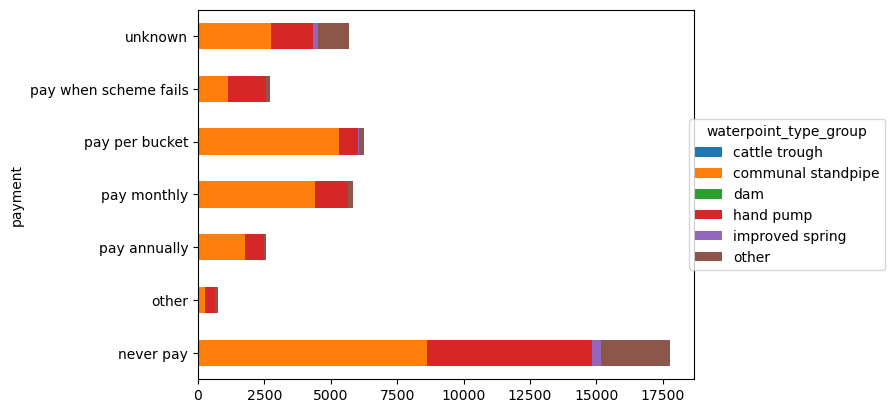

<Figure size 1600x800 with 0 Axes>

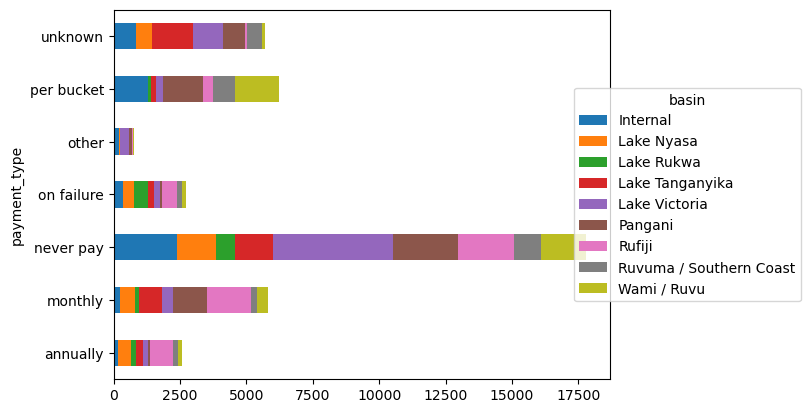

<Figure size 1600x800 with 0 Axes>

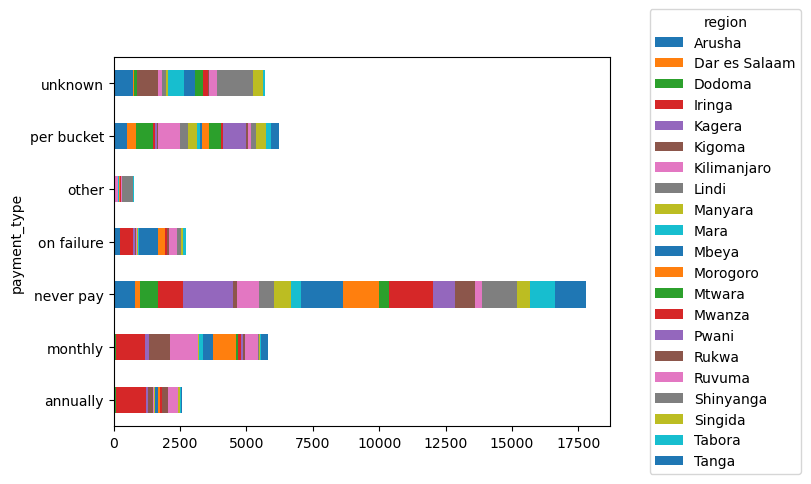

<Figure size 1600x800 with 0 Axes>

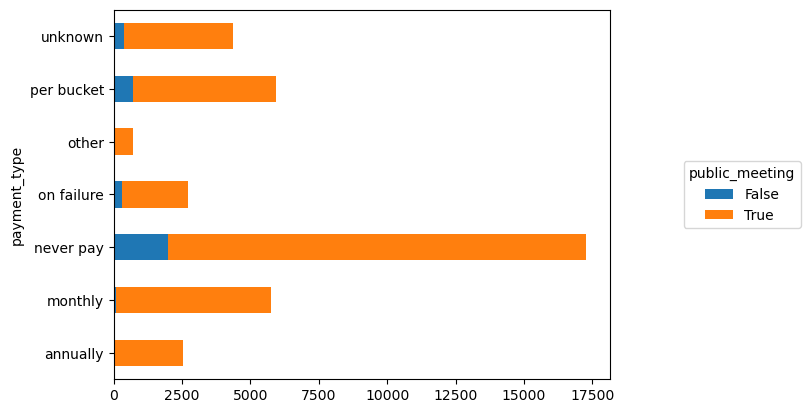

<Figure size 1600x800 with 0 Axes>

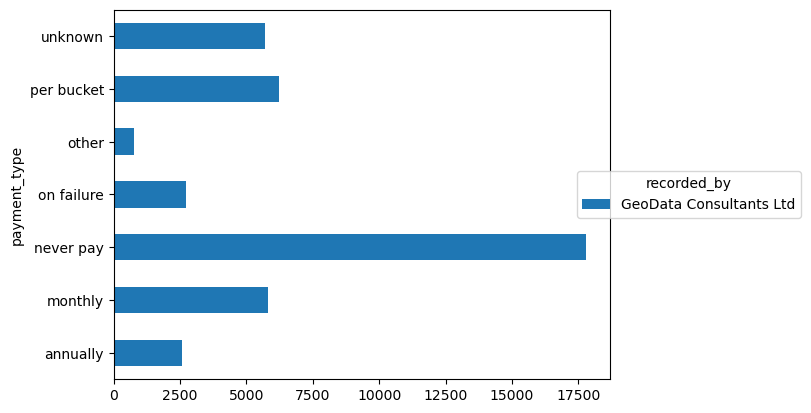

<Figure size 1600x800 with 0 Axes>

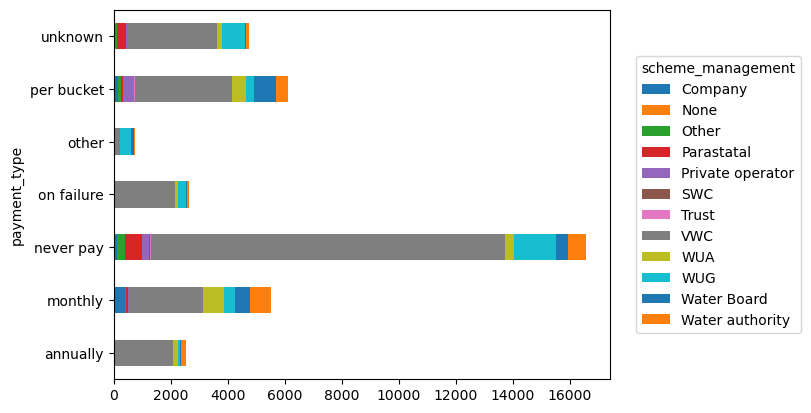

<Figure size 1600x800 with 0 Axes>

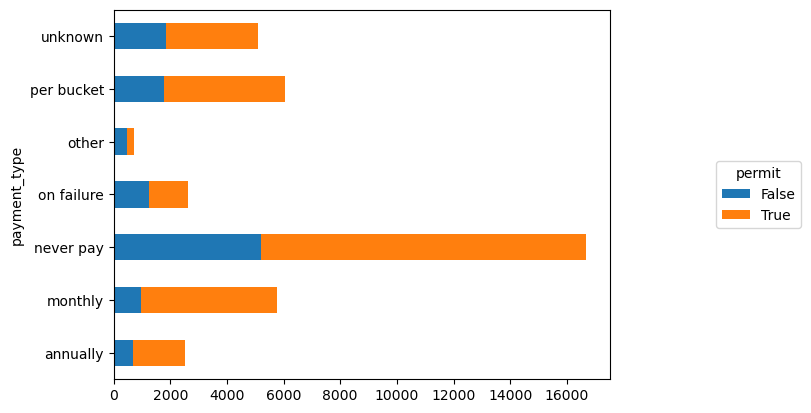

<Figure size 1600x800 with 0 Axes>

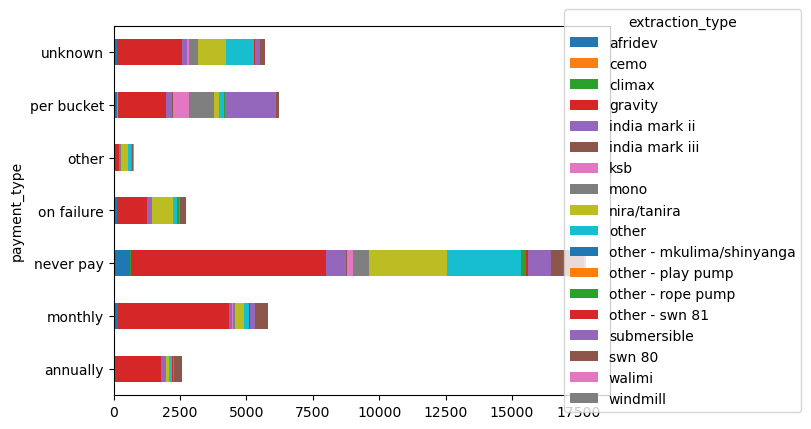

<Figure size 1600x800 with 0 Axes>

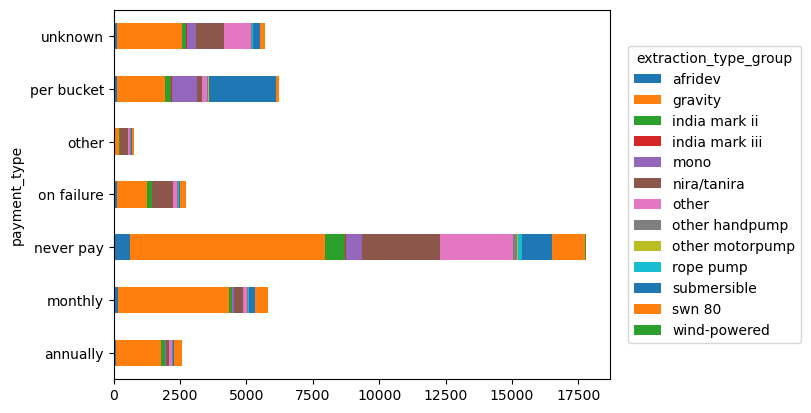

<Figure size 1600x800 with 0 Axes>

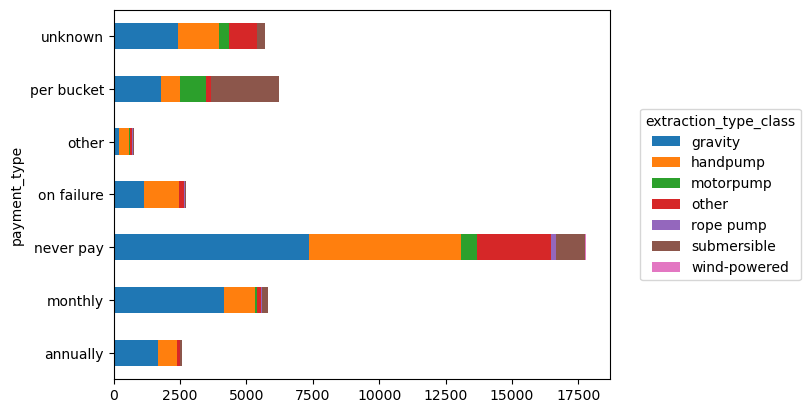

<Figure size 1600x800 with 0 Axes>

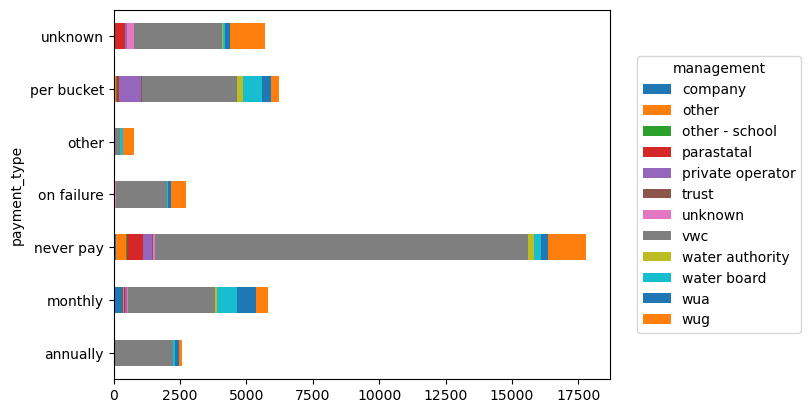

<Figure size 1600x800 with 0 Axes>

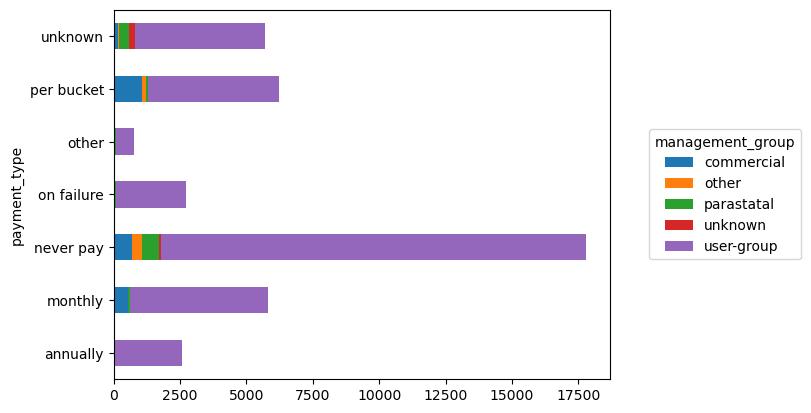

<Figure size 1600x800 with 0 Axes>

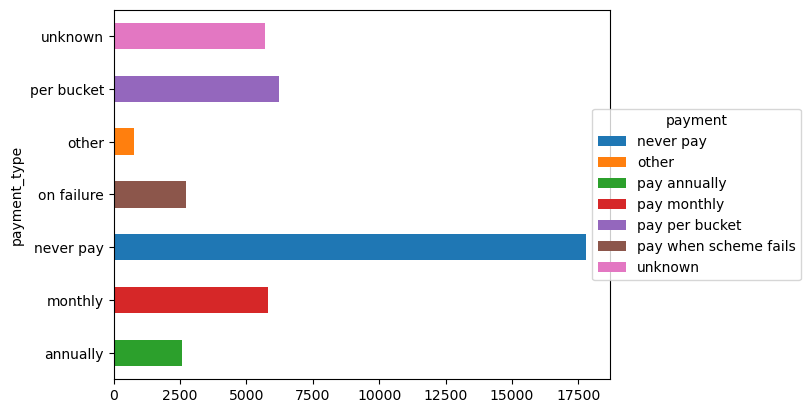

<Figure size 1600x800 with 0 Axes>

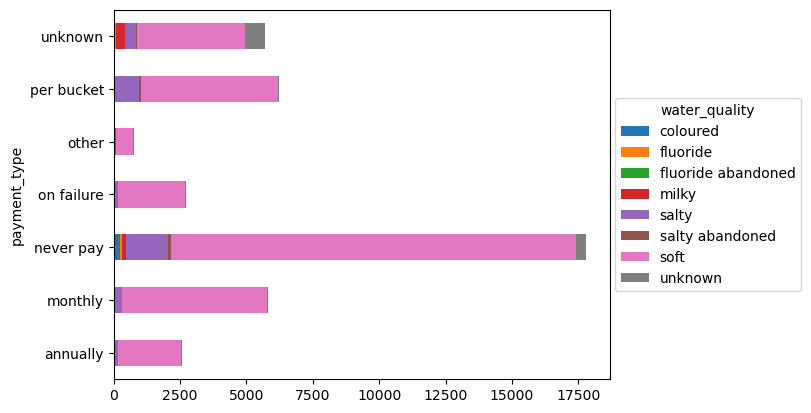

<Figure size 1600x800 with 0 Axes>

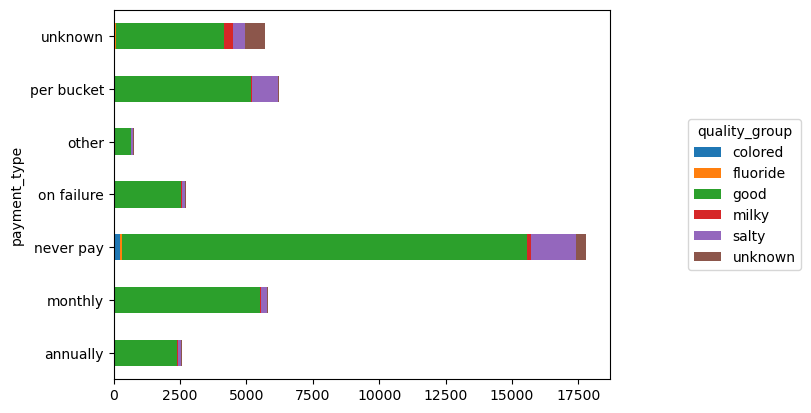

<Figure size 1600x800 with 0 Axes>

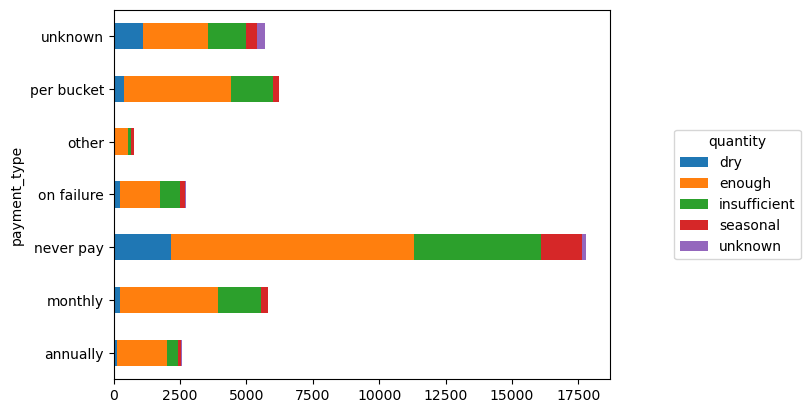

<Figure size 1600x800 with 0 Axes>

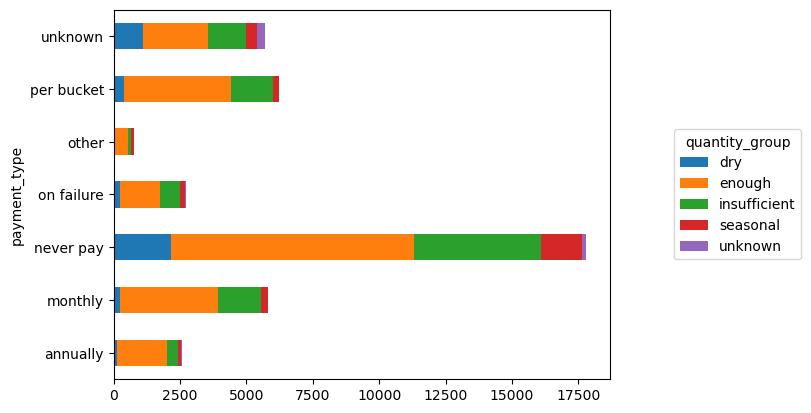

<Figure size 1600x800 with 0 Axes>

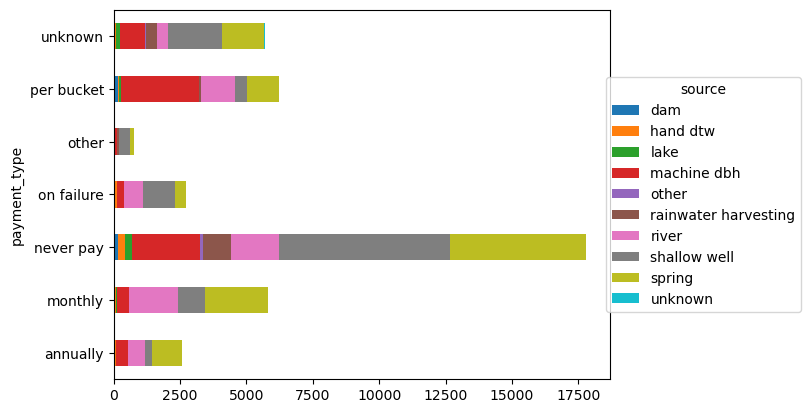

<Figure size 1600x800 with 0 Axes>

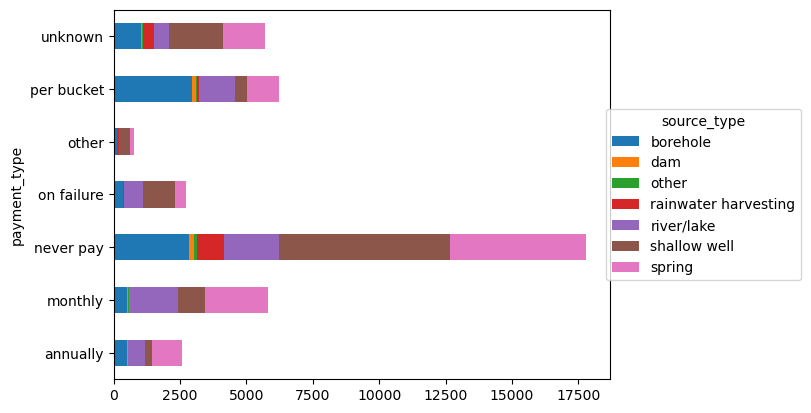

<Figure size 1600x800 with 0 Axes>

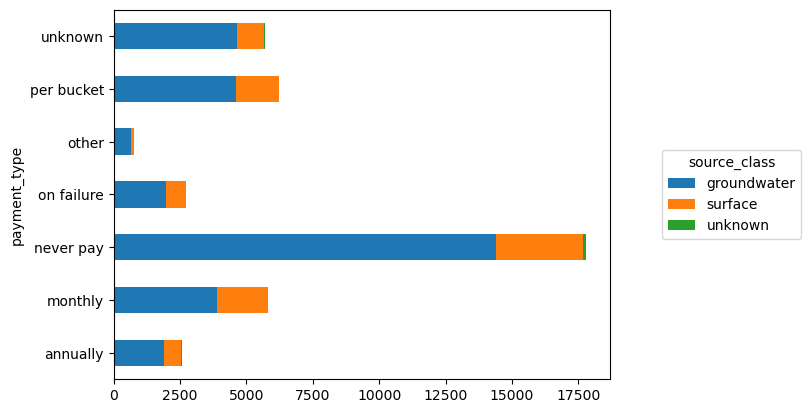

<Figure size 1600x800 with 0 Axes>

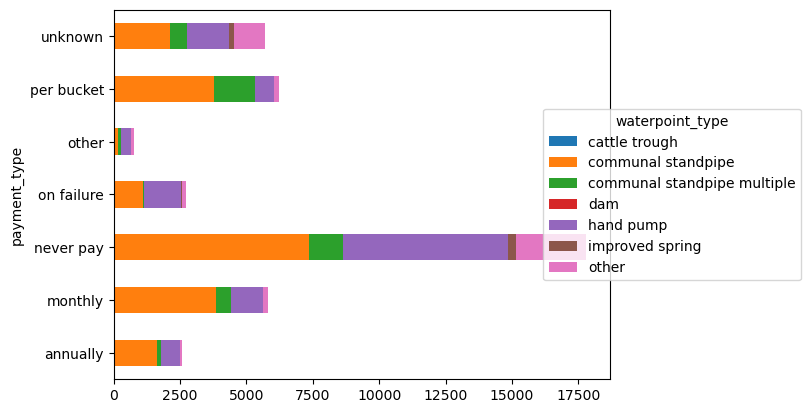

<Figure size 1600x800 with 0 Axes>

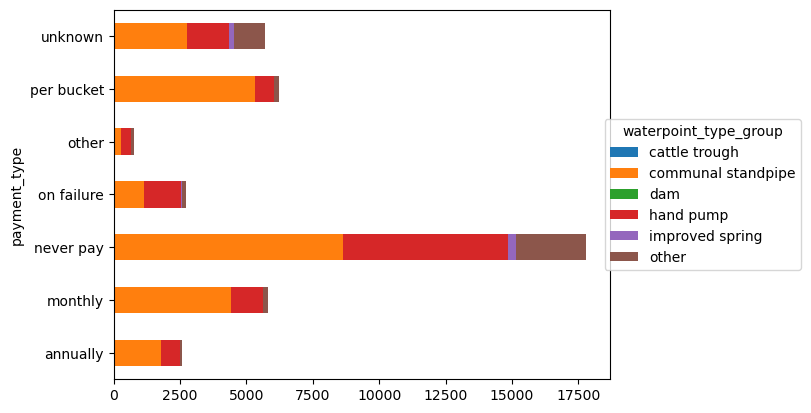

<Figure size 1600x800 with 0 Axes>

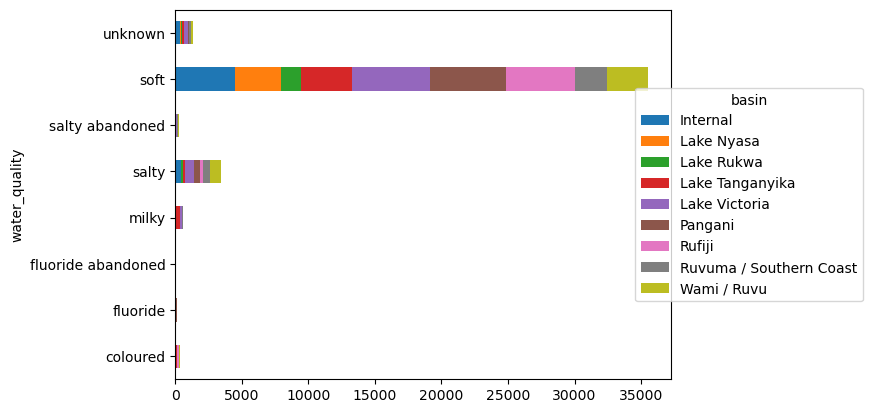

<Figure size 1600x800 with 0 Axes>

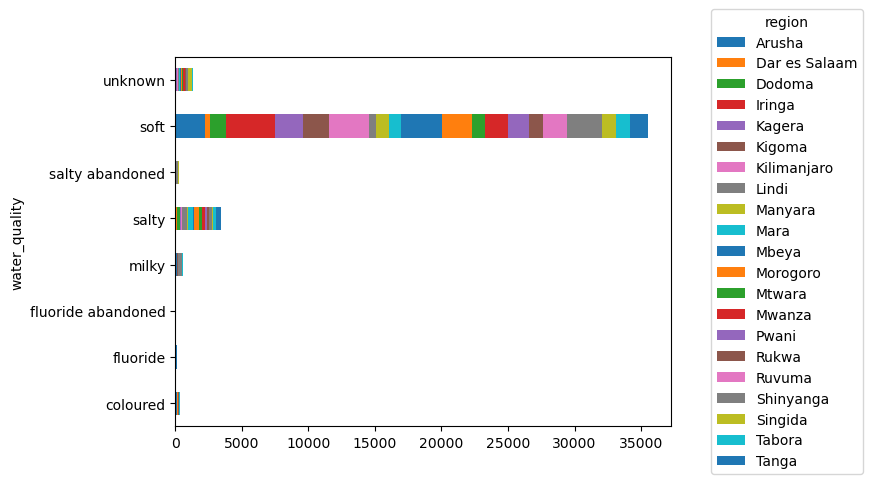

<Figure size 1600x800 with 0 Axes>

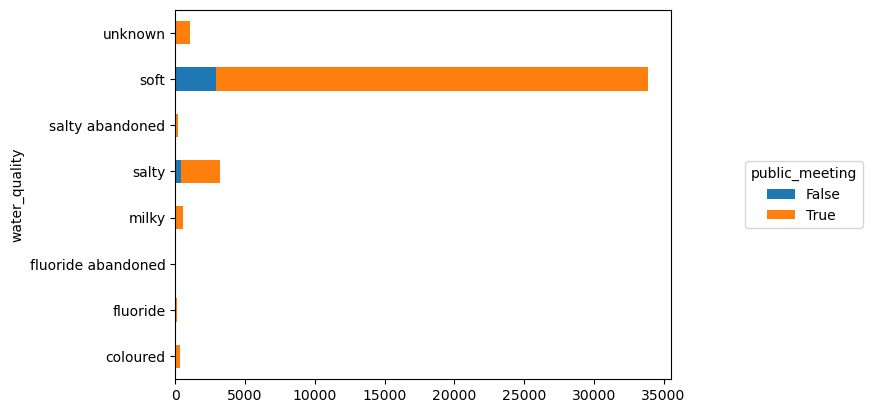

<Figure size 1600x800 with 0 Axes>

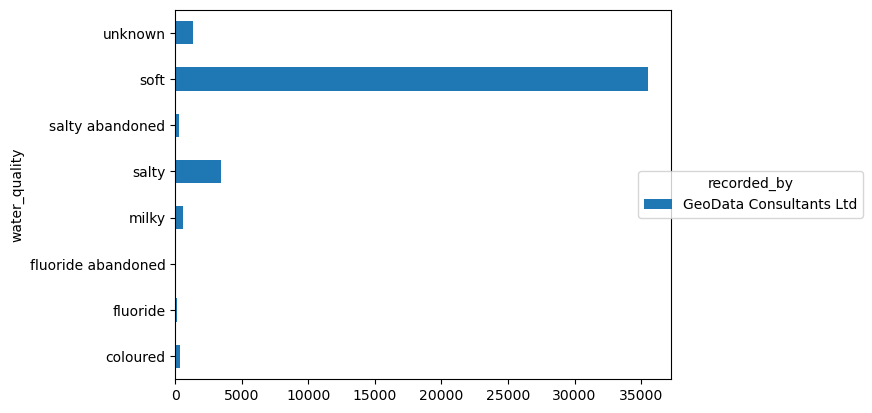

<Figure size 1600x800 with 0 Axes>

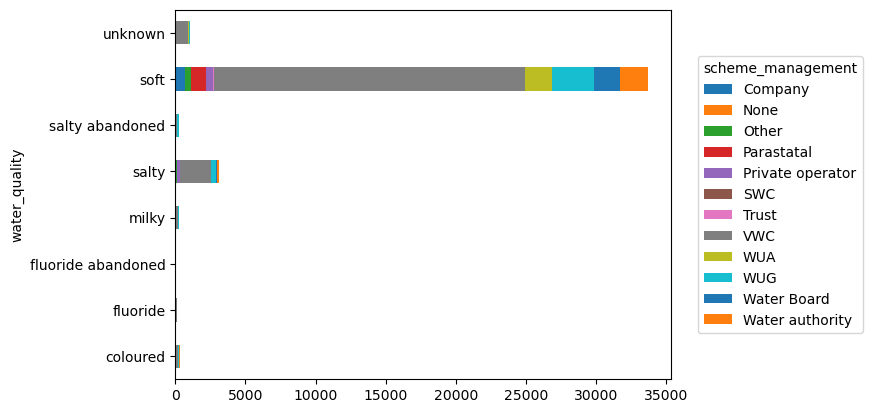

<Figure size 1600x800 with 0 Axes>

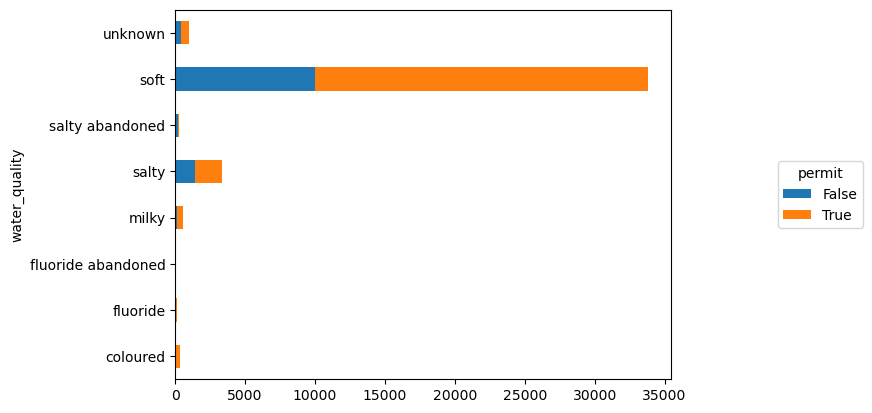

<Figure size 1600x800 with 0 Axes>

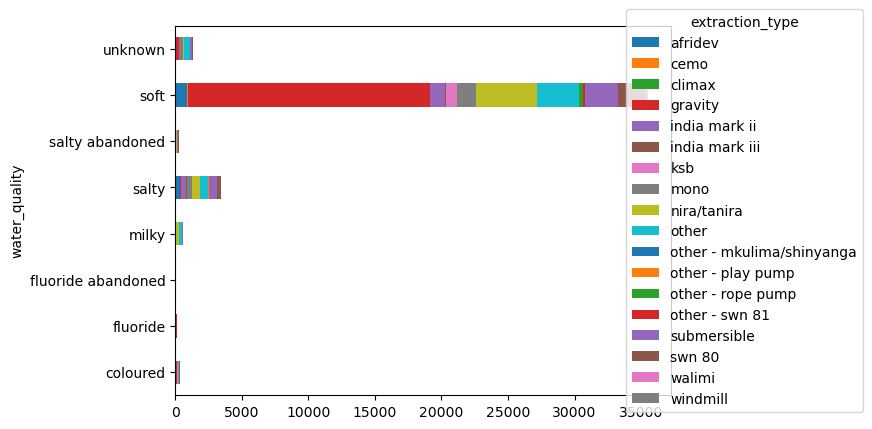

<Figure size 1600x800 with 0 Axes>

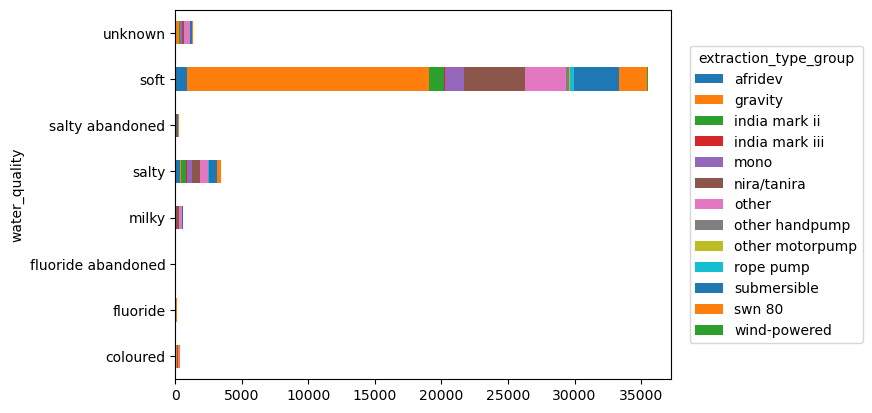

<Figure size 1600x800 with 0 Axes>

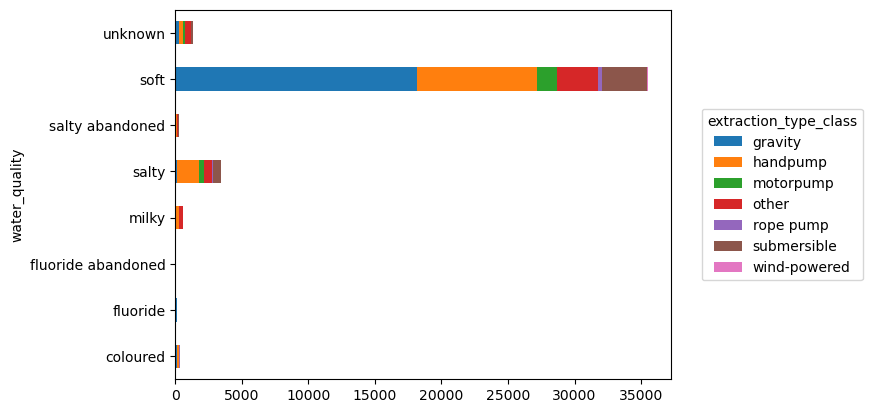

<Figure size 1600x800 with 0 Axes>

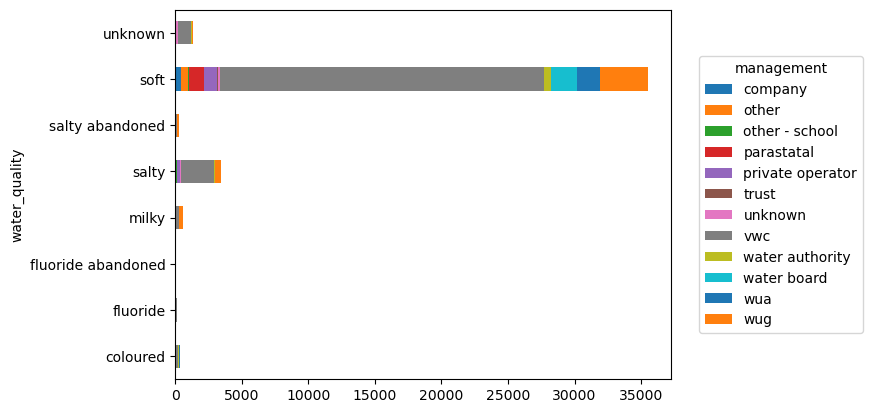

<Figure size 1600x800 with 0 Axes>

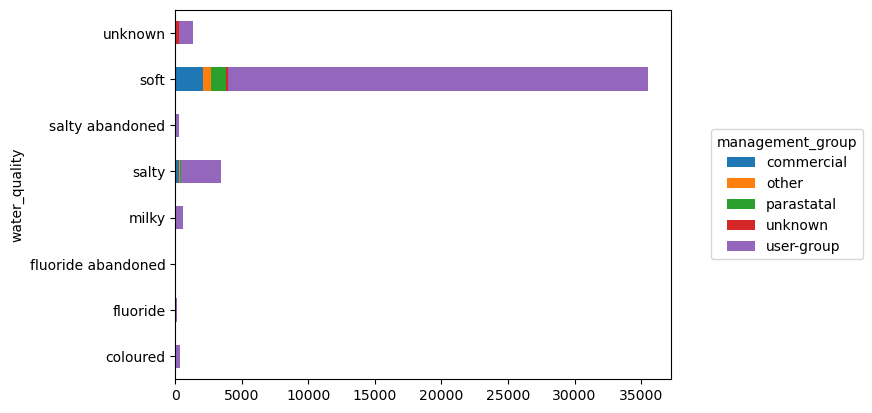

<Figure size 1600x800 with 0 Axes>

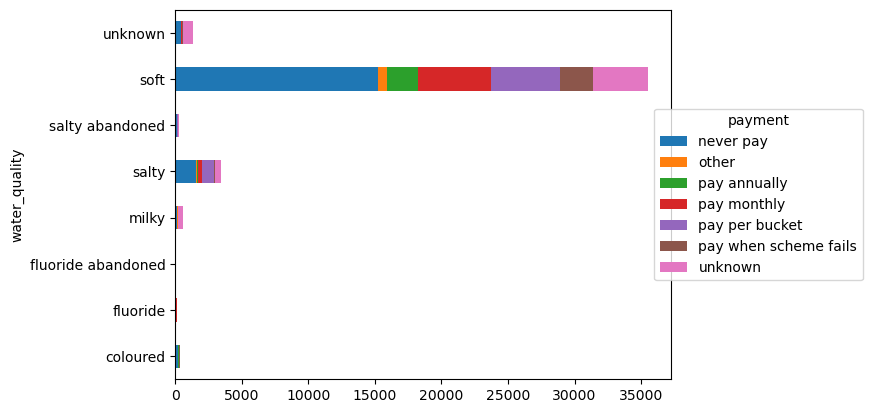

<Figure size 1600x800 with 0 Axes>

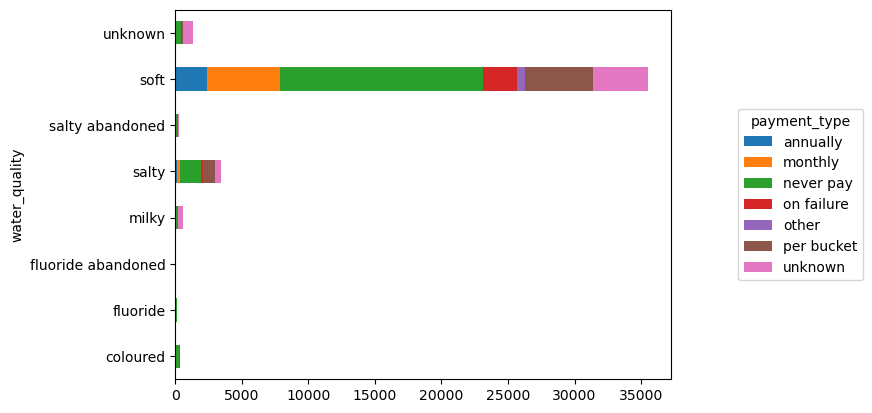

<Figure size 1600x800 with 0 Axes>

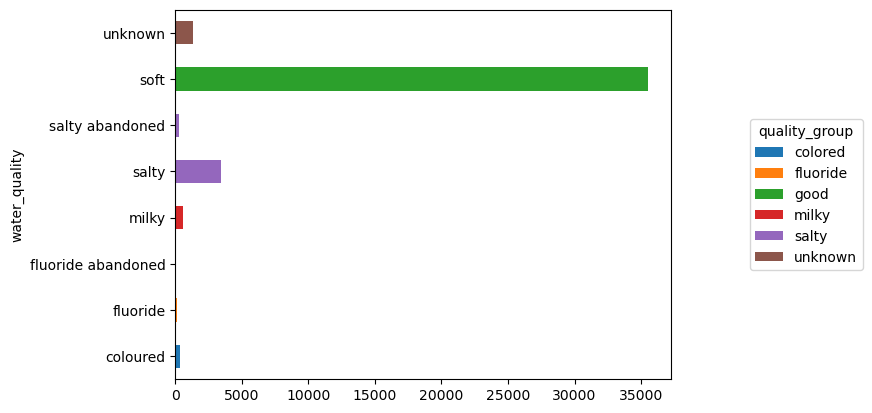

<Figure size 1600x800 with 0 Axes>

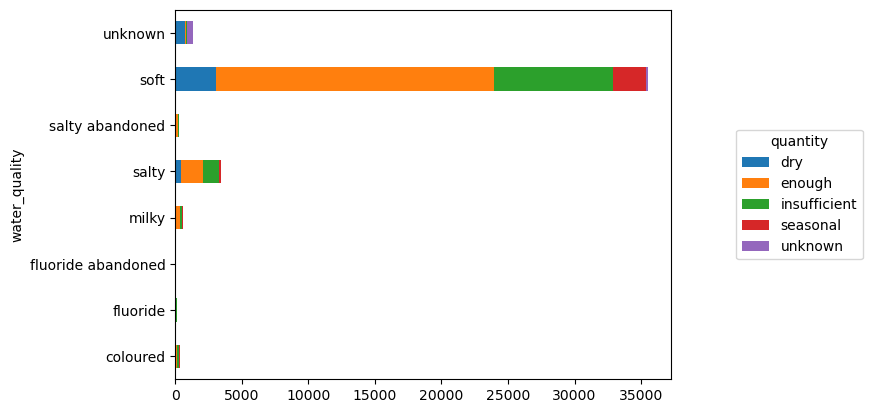

<Figure size 1600x800 with 0 Axes>

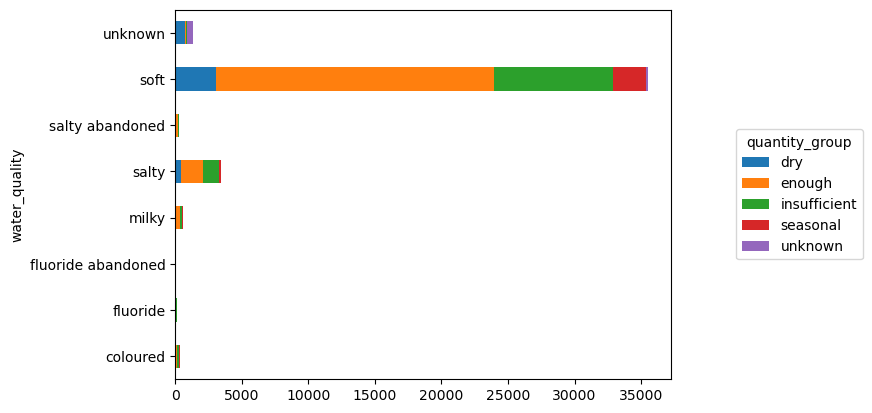

<Figure size 1600x800 with 0 Axes>

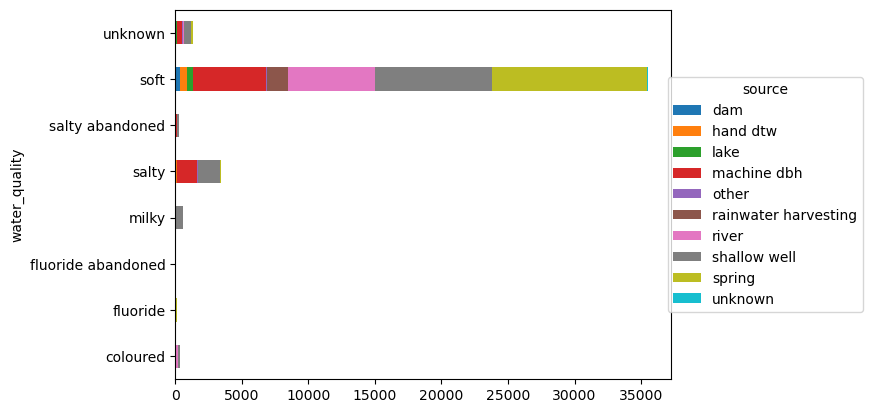

<Figure size 1600x800 with 0 Axes>

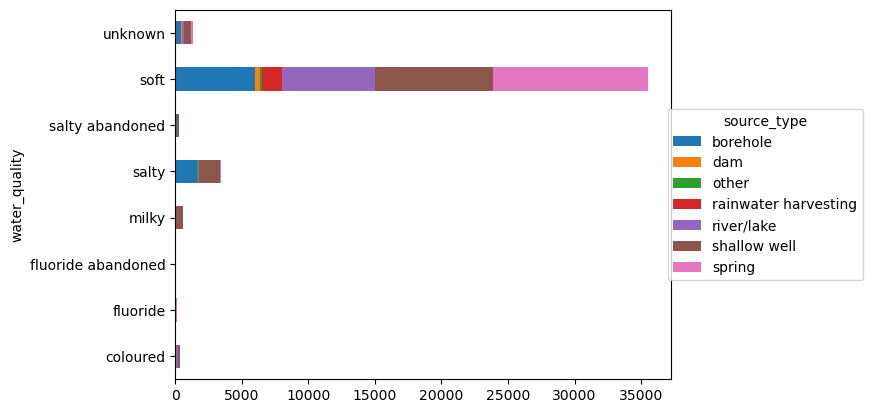

<Figure size 1600x800 with 0 Axes>

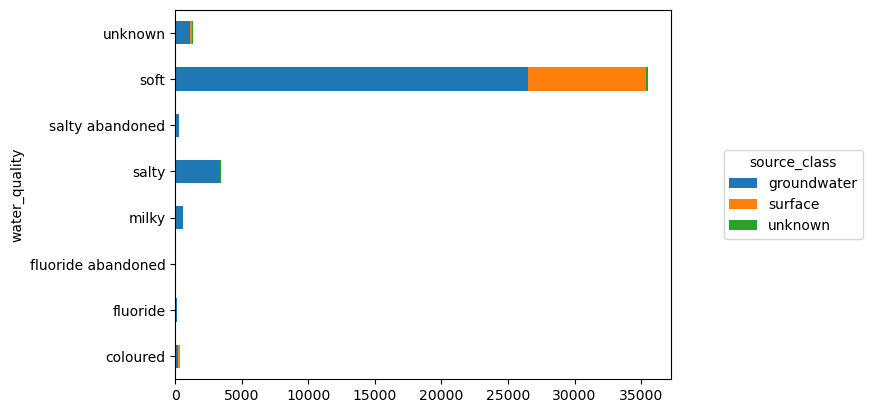

<Figure size 1600x800 with 0 Axes>

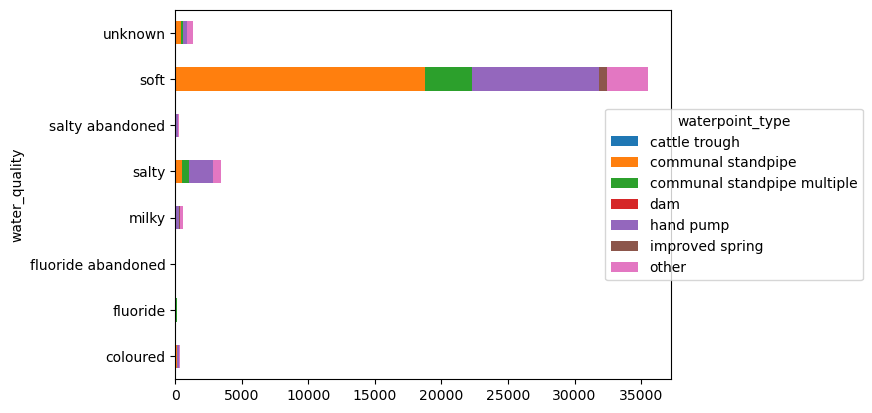

<Figure size 1600x800 with 0 Axes>

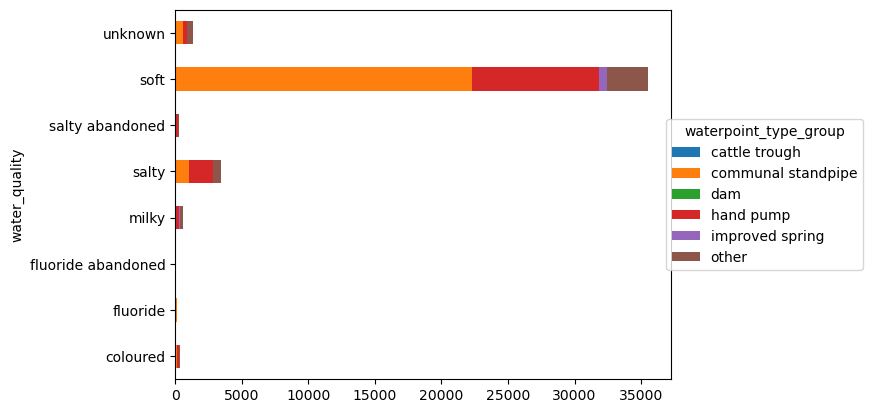

<Figure size 1600x800 with 0 Axes>

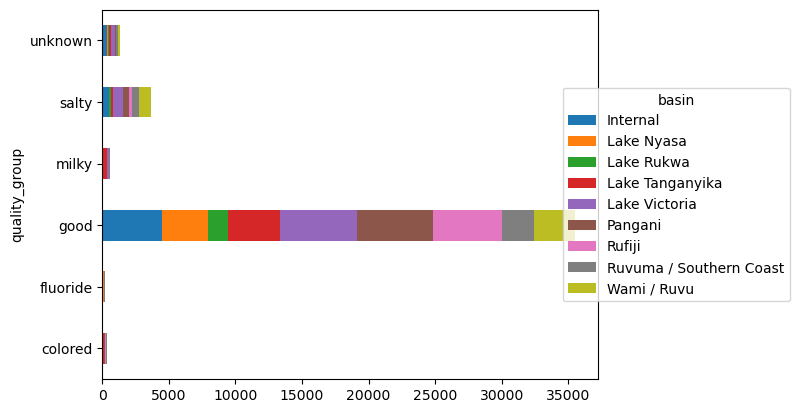

<Figure size 1600x800 with 0 Axes>

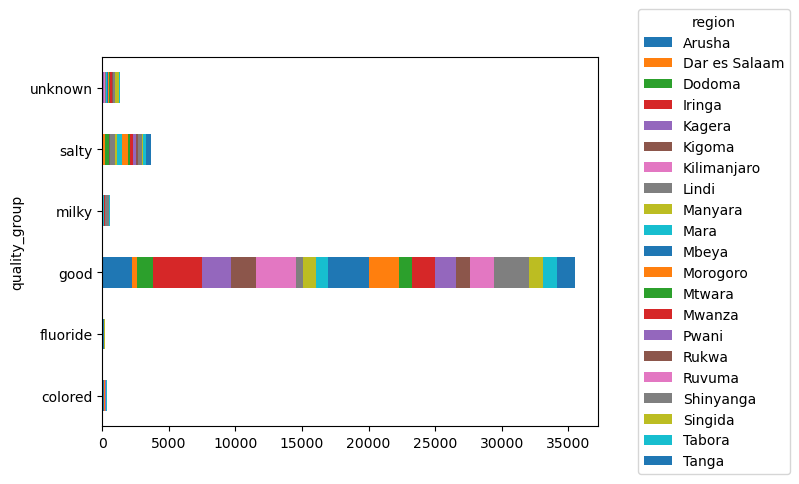

<Figure size 1600x800 with 0 Axes>

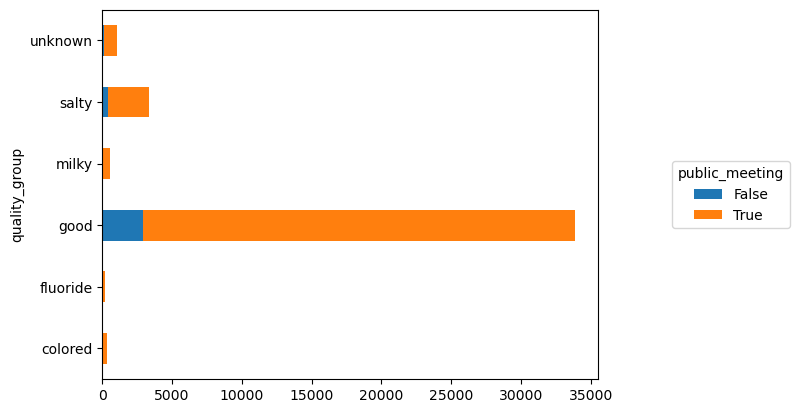

<Figure size 1600x800 with 0 Axes>

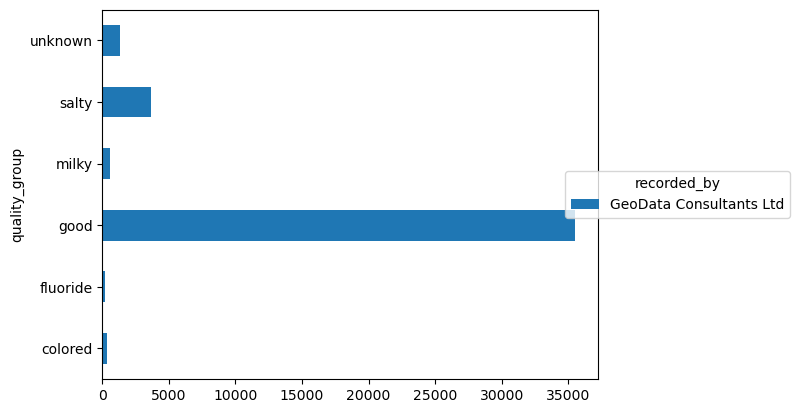

<Figure size 1600x800 with 0 Axes>

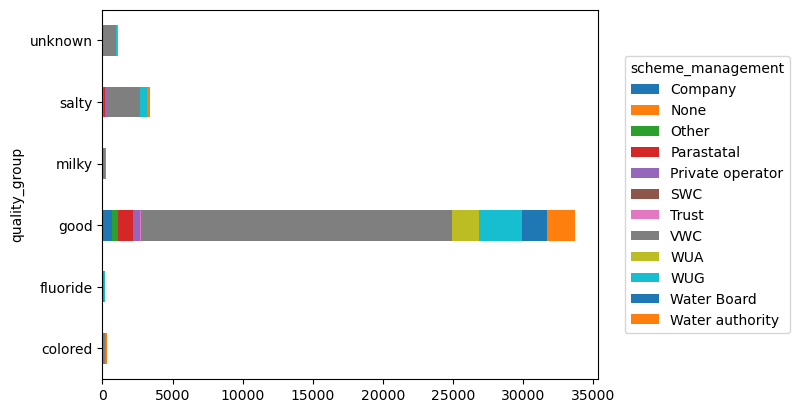

<Figure size 1600x800 with 0 Axes>

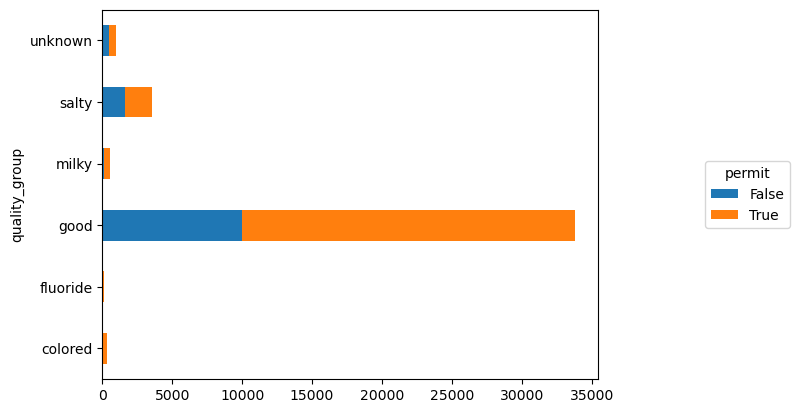

<Figure size 1600x800 with 0 Axes>

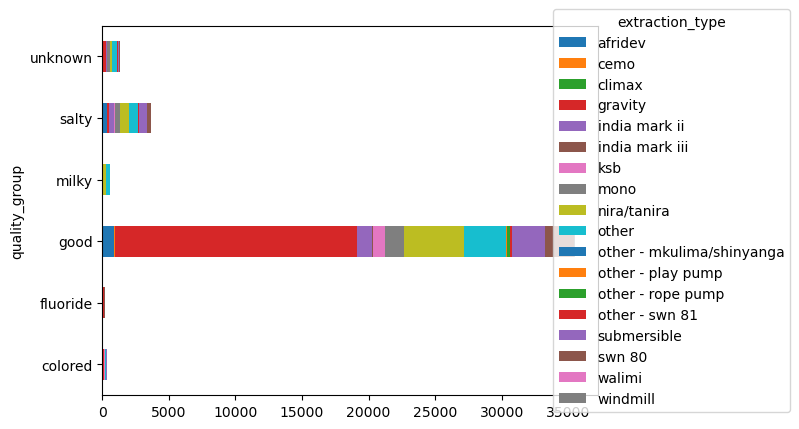

<Figure size 1600x800 with 0 Axes>

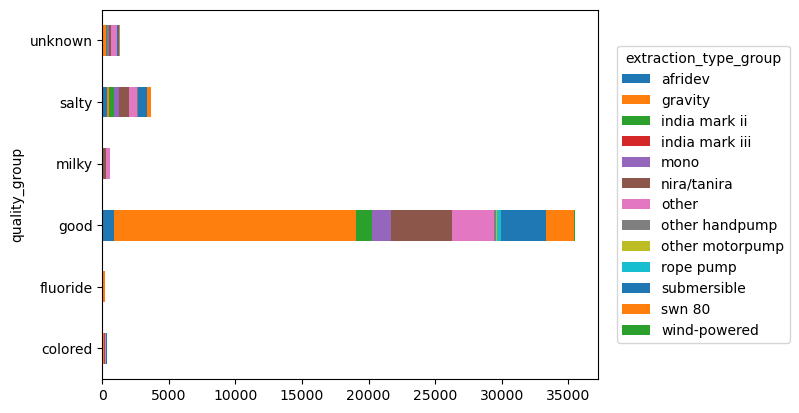

<Figure size 1600x800 with 0 Axes>

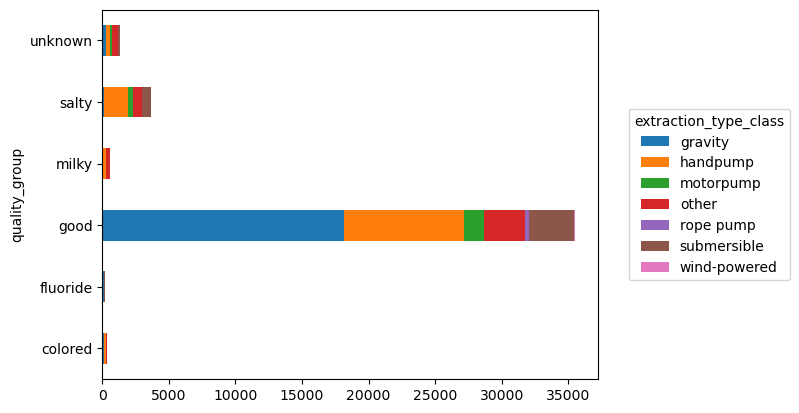

<Figure size 1600x800 with 0 Axes>

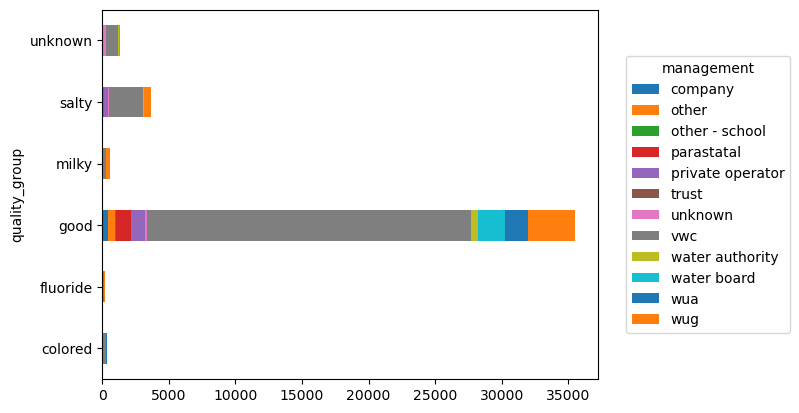

<Figure size 1600x800 with 0 Axes>

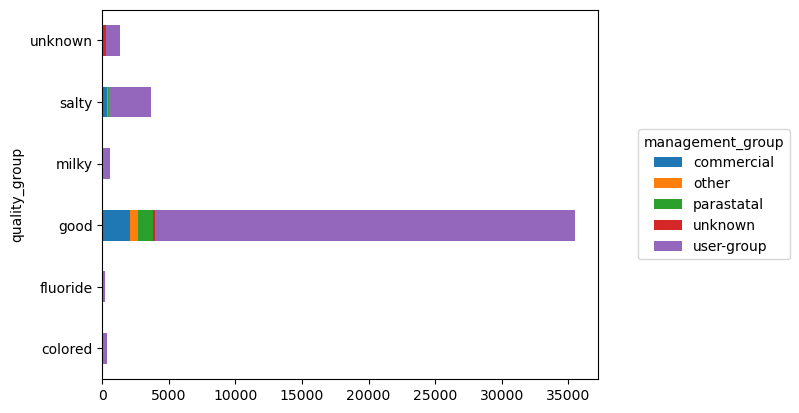

<Figure size 1600x800 with 0 Axes>

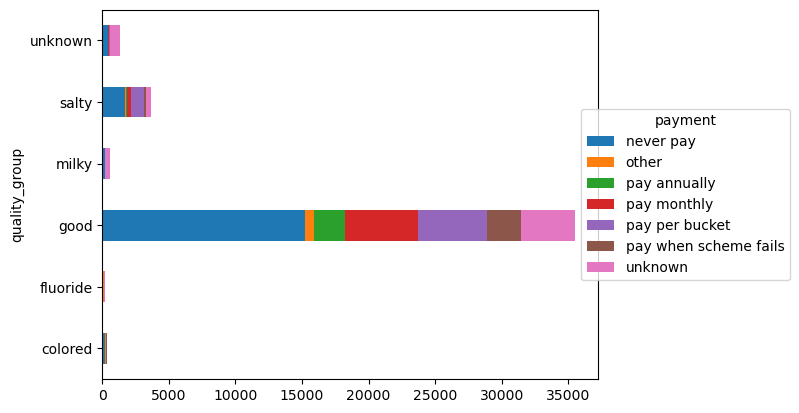

<Figure size 1600x800 with 0 Axes>

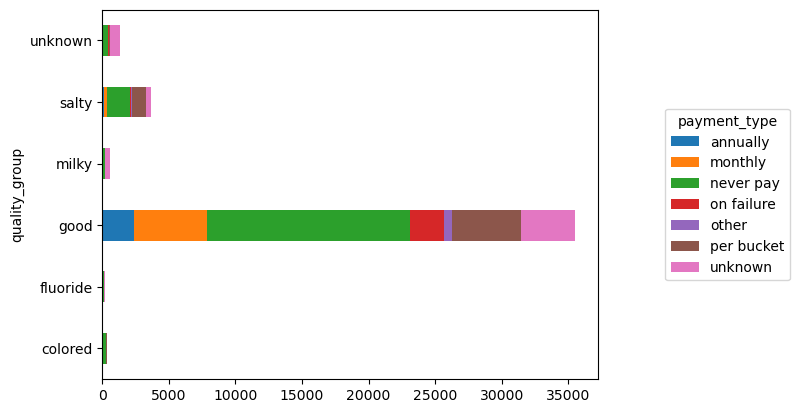

<Figure size 1600x800 with 0 Axes>

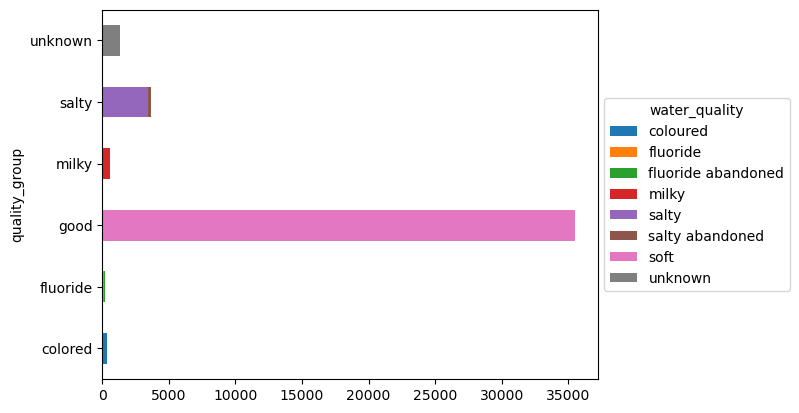

<Figure size 1600x800 with 0 Axes>

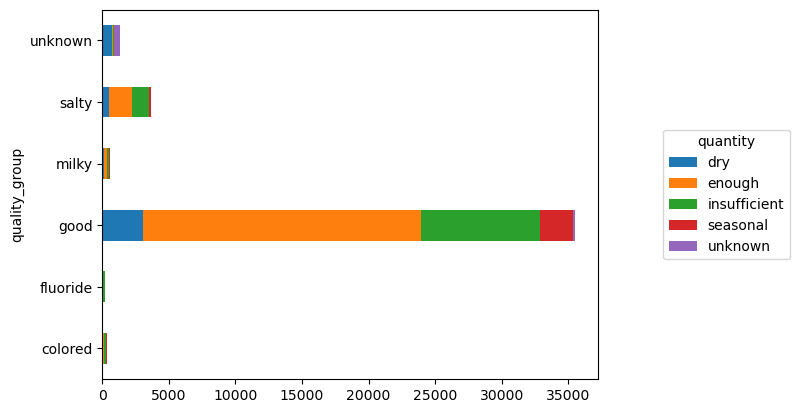

<Figure size 1600x800 with 0 Axes>

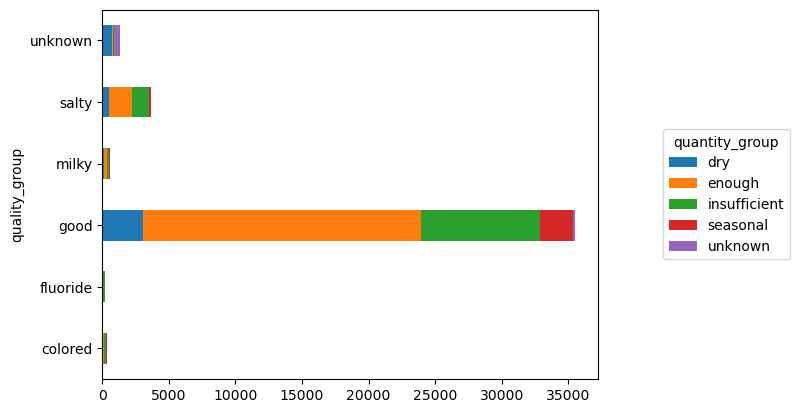

<Figure size 1600x800 with 0 Axes>

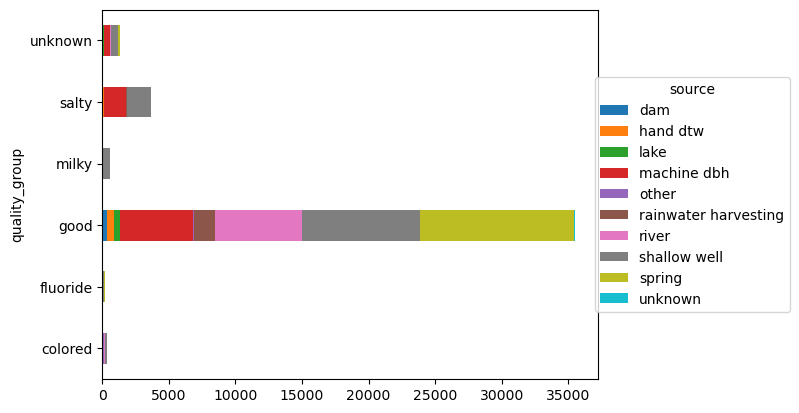

<Figure size 1600x800 with 0 Axes>

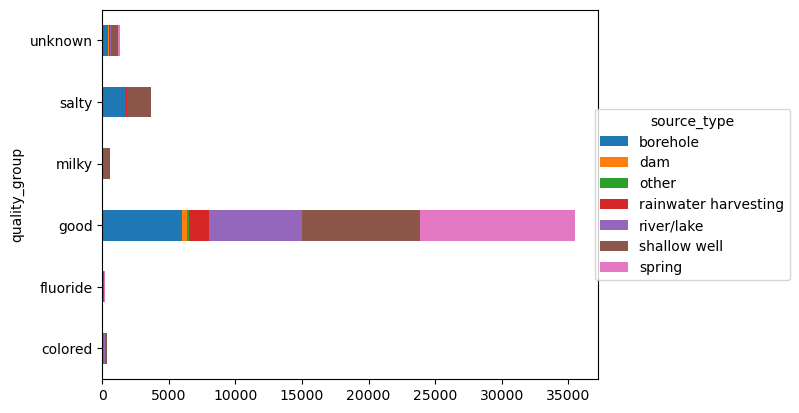

<Figure size 1600x800 with 0 Axes>

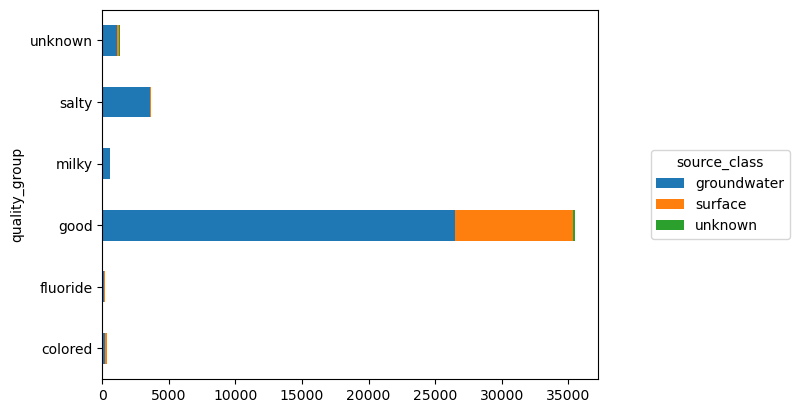

<Figure size 1600x800 with 0 Axes>

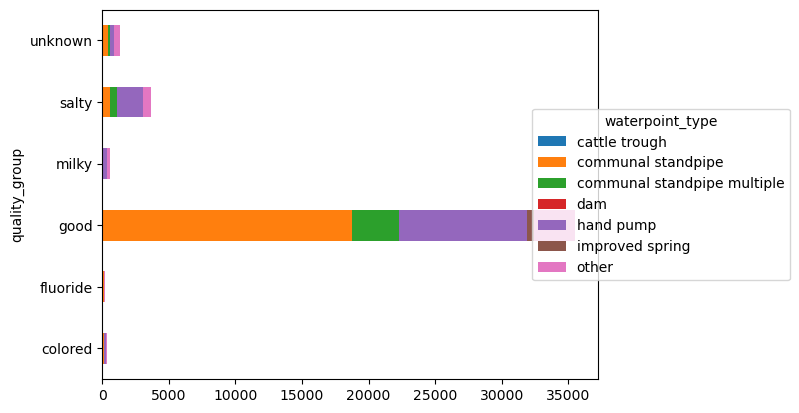

<Figure size 1600x800 with 0 Axes>

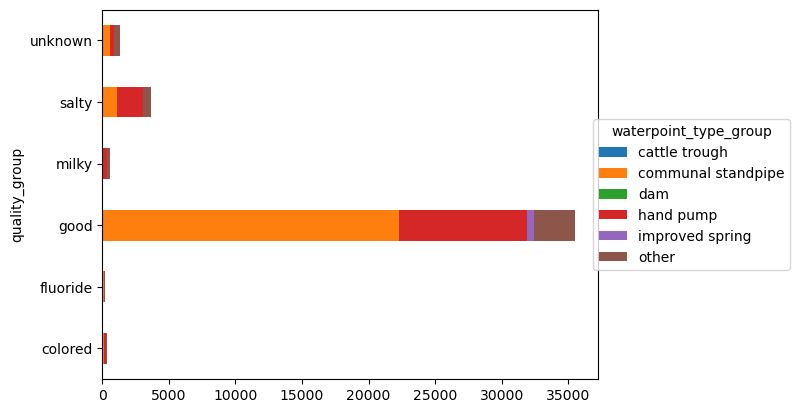

<Figure size 1600x800 with 0 Axes>

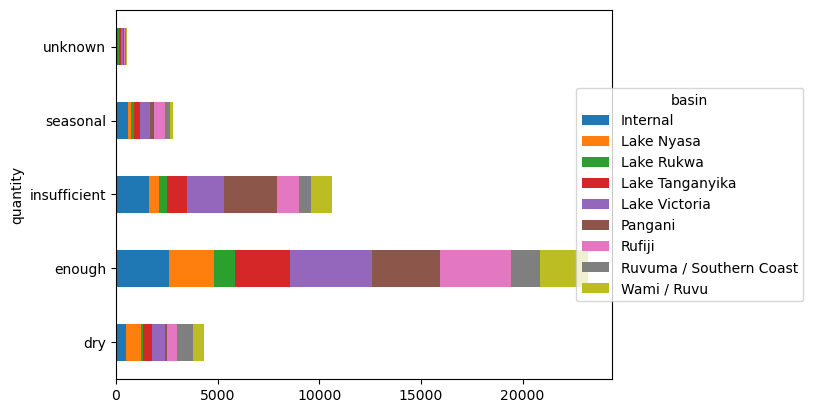

<Figure size 1600x800 with 0 Axes>

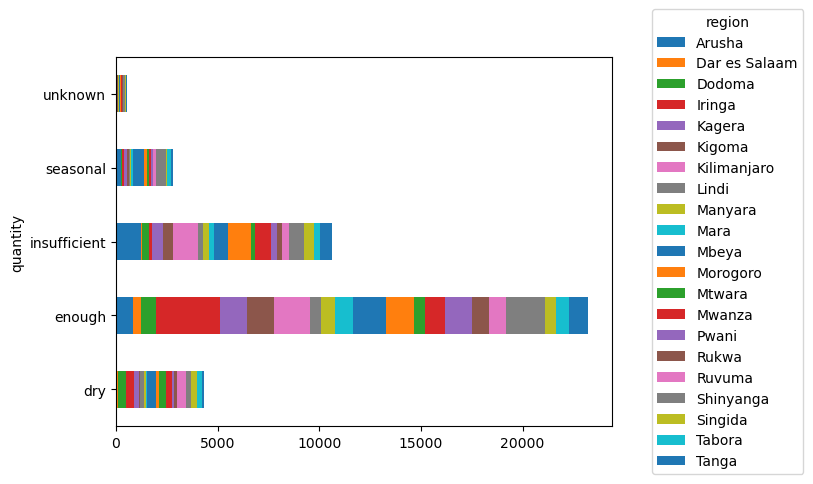

<Figure size 1600x800 with 0 Axes>

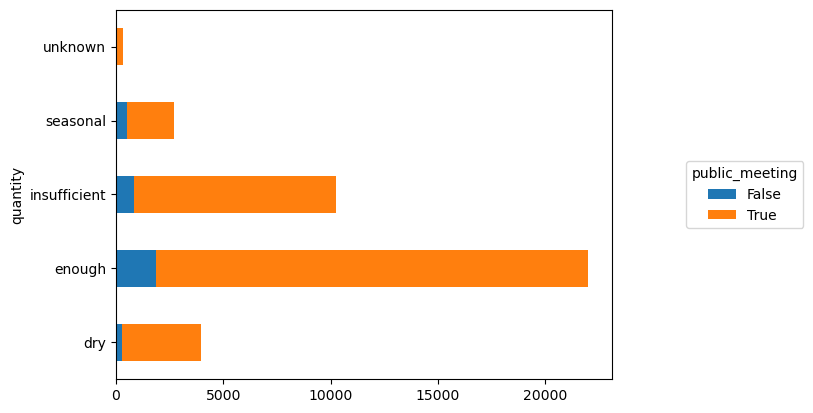

<Figure size 1600x800 with 0 Axes>

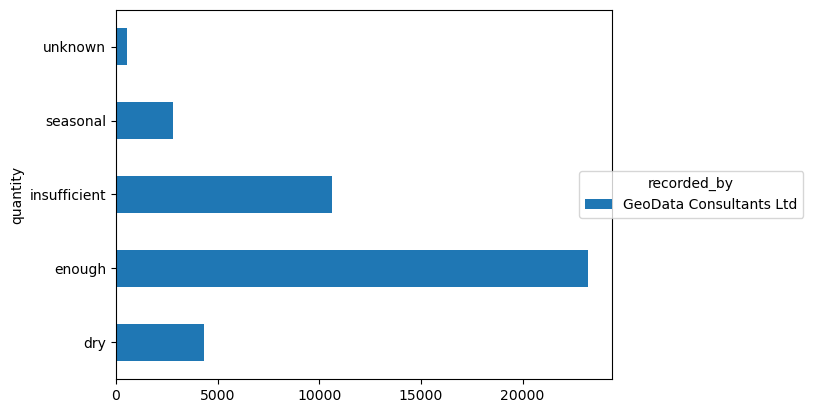

<Figure size 1600x800 with 0 Axes>

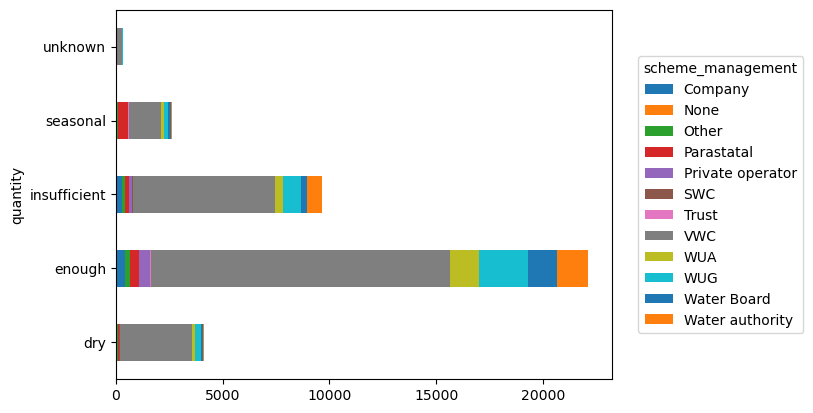

<Figure size 1600x800 with 0 Axes>

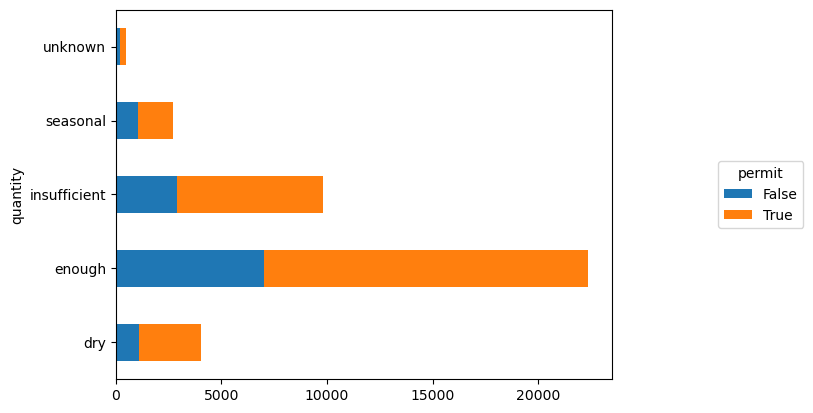

<Figure size 1600x800 with 0 Axes>

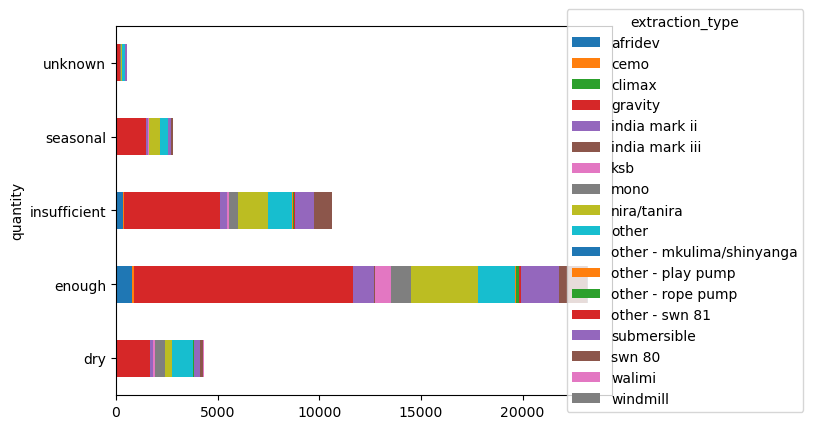

<Figure size 1600x800 with 0 Axes>

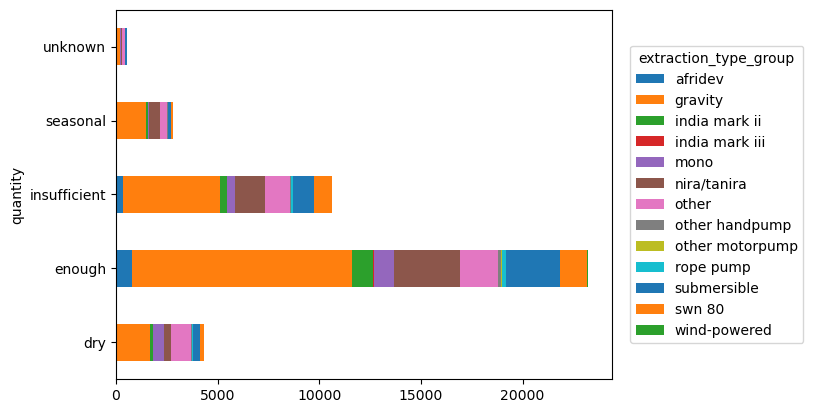

<Figure size 1600x800 with 0 Axes>

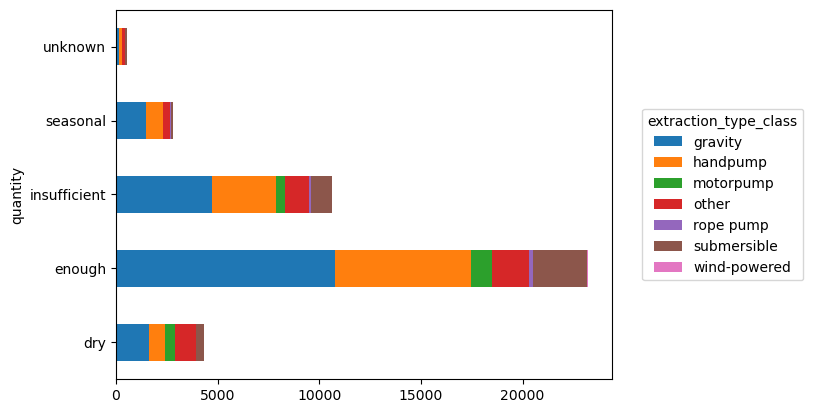

<Figure size 1600x800 with 0 Axes>

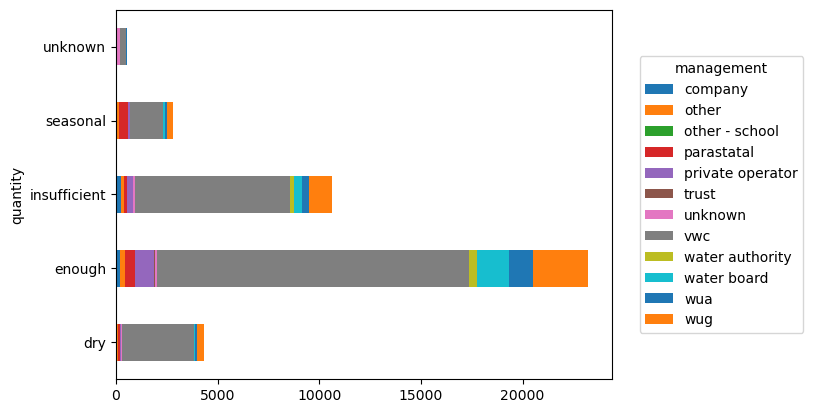

<Figure size 1600x800 with 0 Axes>

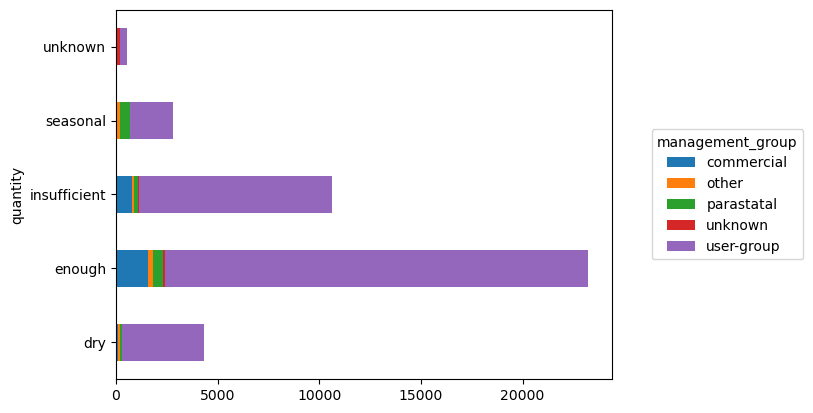

<Figure size 1600x800 with 0 Axes>

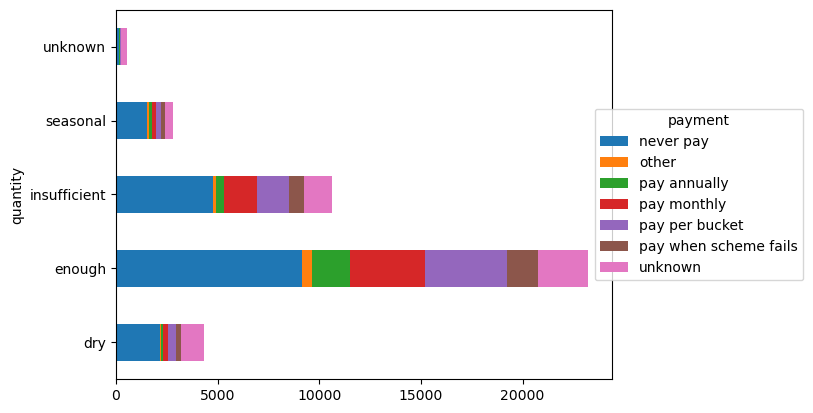

<Figure size 1600x800 with 0 Axes>

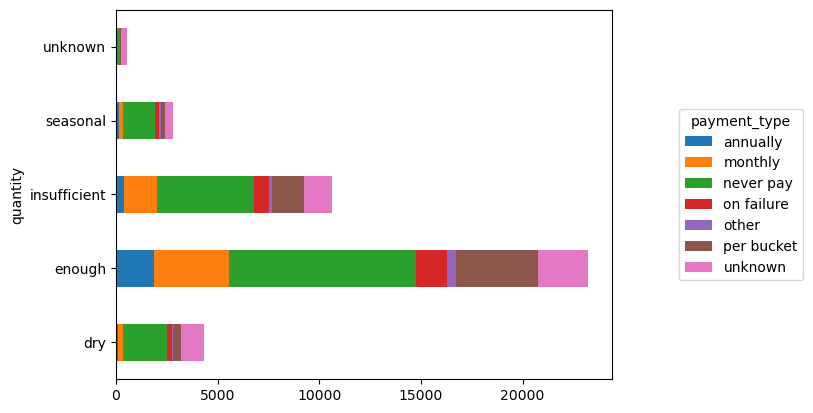

<Figure size 1600x800 with 0 Axes>

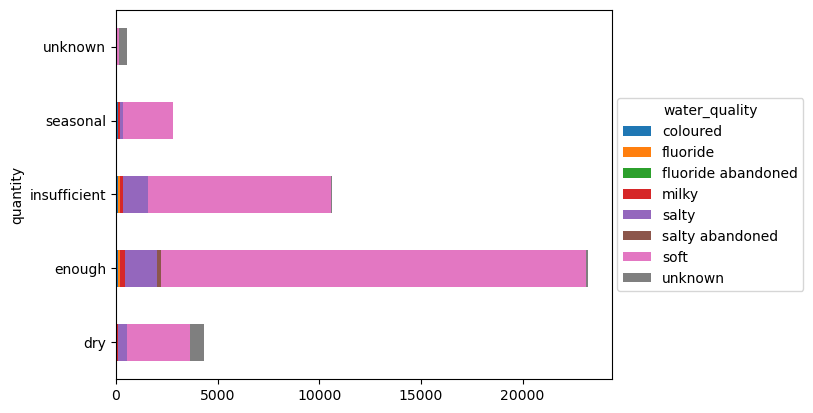

<Figure size 1600x800 with 0 Axes>

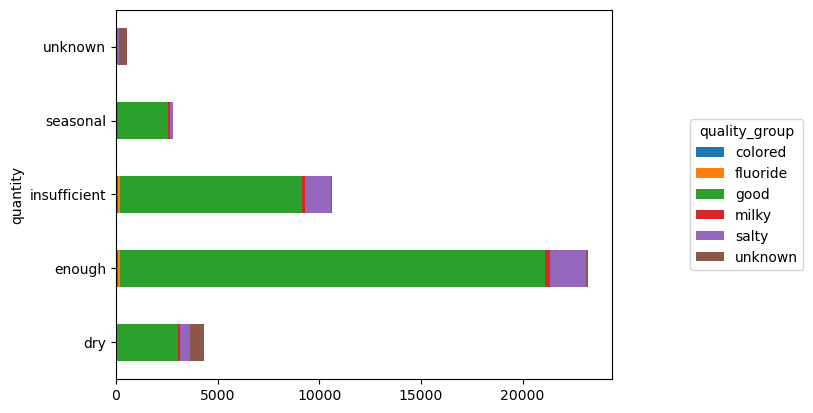

<Figure size 1600x800 with 0 Axes>

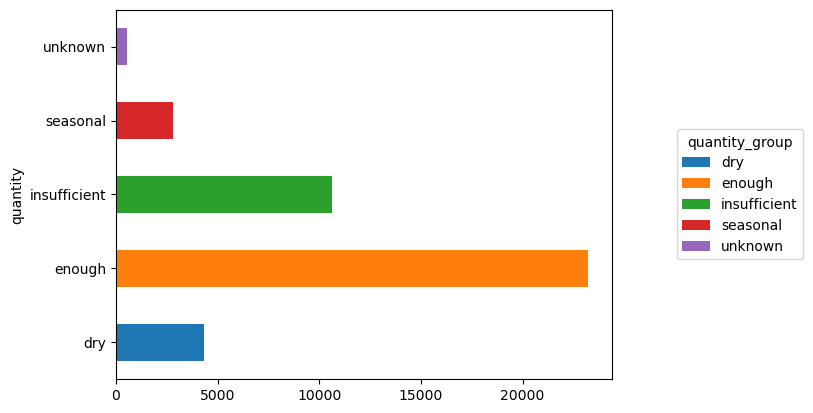

<Figure size 1600x800 with 0 Axes>

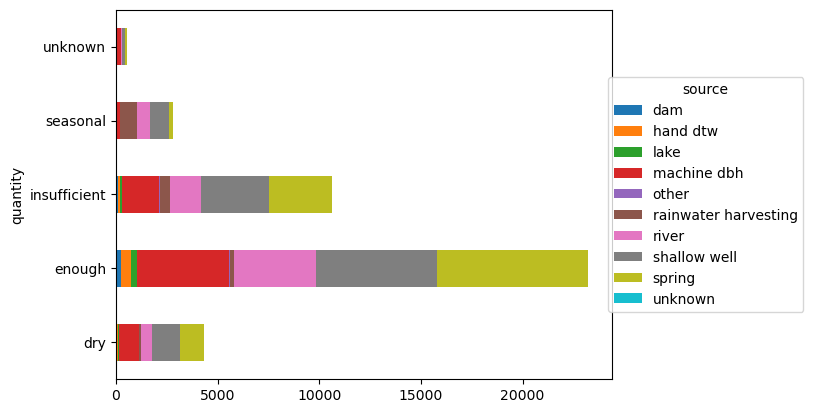

<Figure size 1600x800 with 0 Axes>

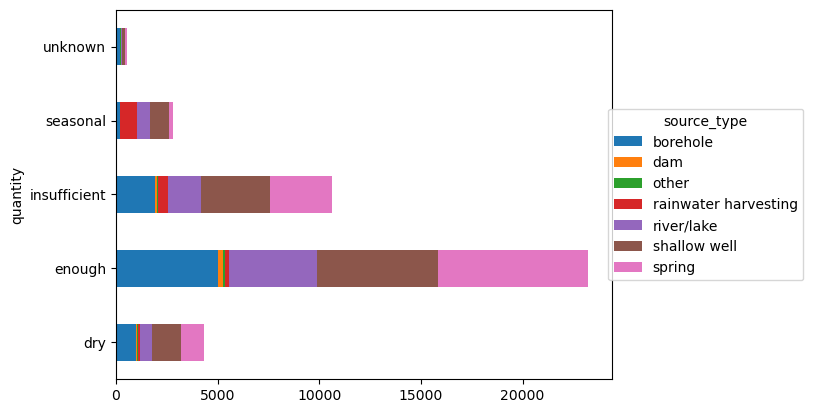

<Figure size 1600x800 with 0 Axes>

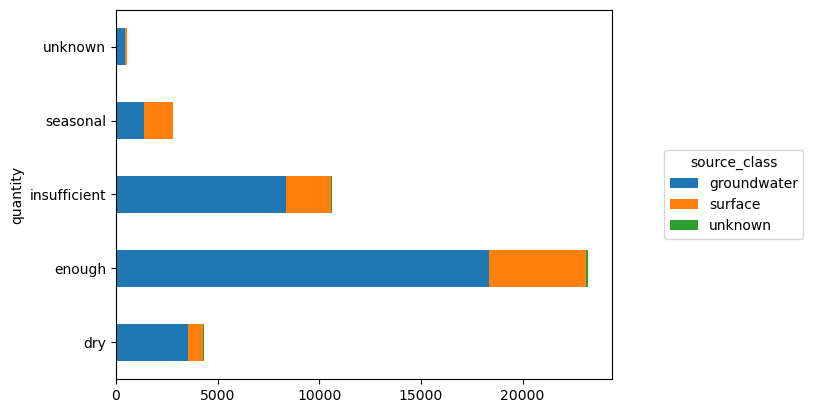

<Figure size 1600x800 with 0 Axes>

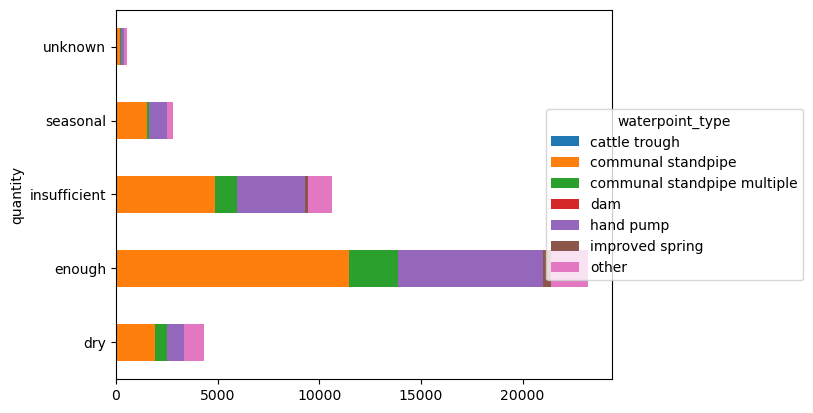

<Figure size 1600x800 with 0 Axes>

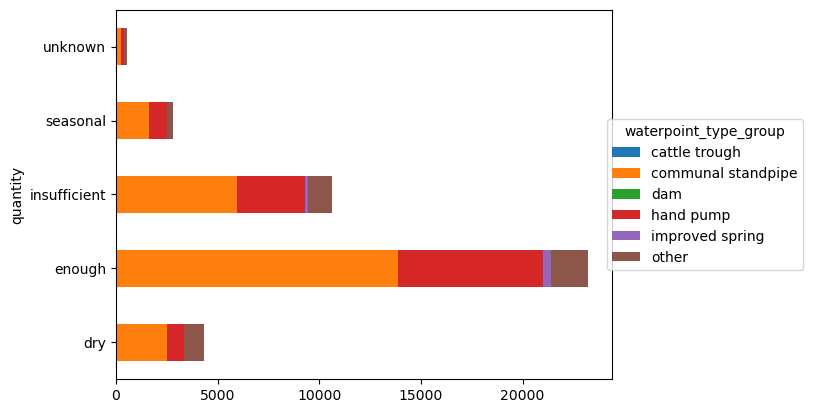

<Figure size 1600x800 with 0 Axes>

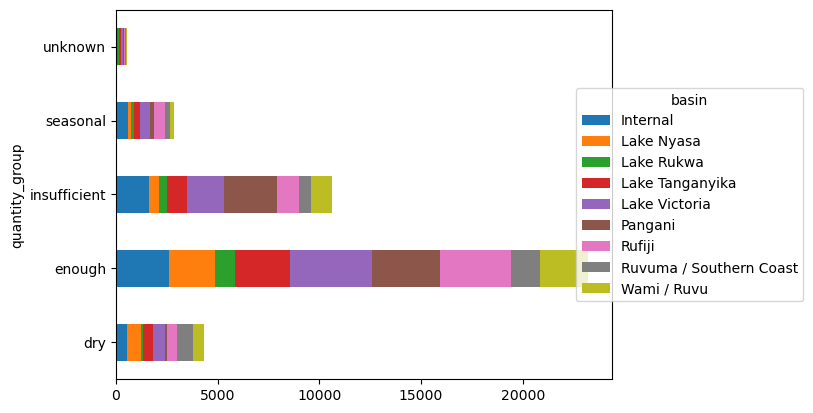

<Figure size 1600x800 with 0 Axes>

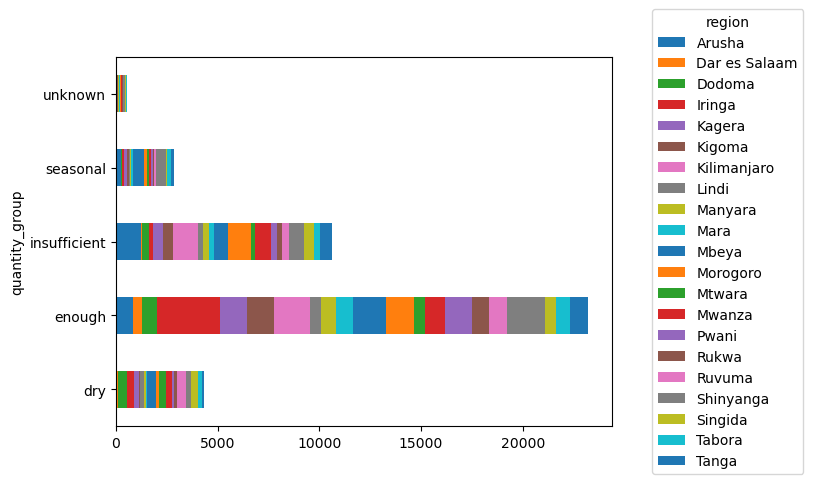

<Figure size 1600x800 with 0 Axes>

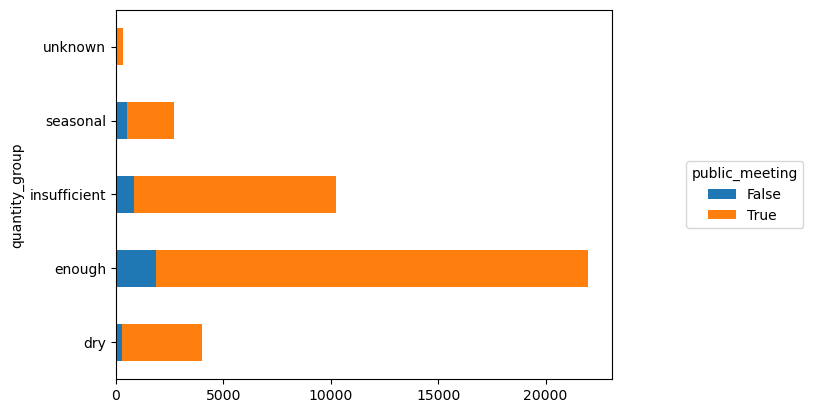

<Figure size 1600x800 with 0 Axes>

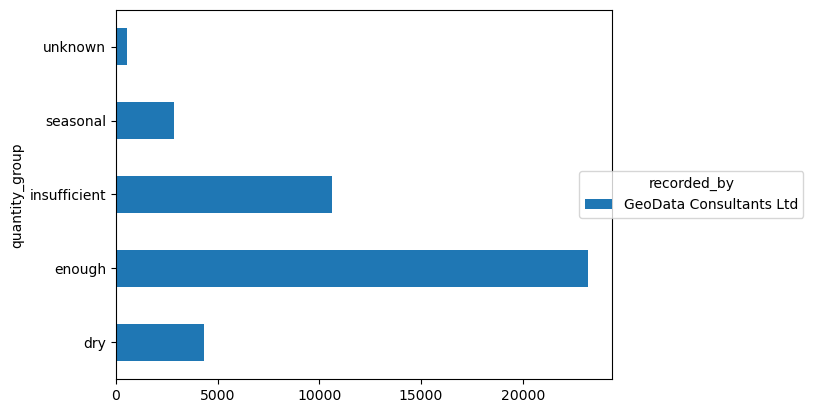

<Figure size 1600x800 with 0 Axes>

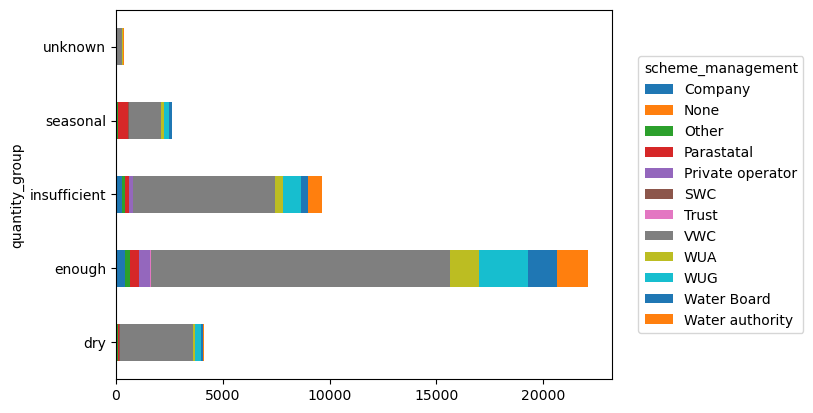

<Figure size 1600x800 with 0 Axes>

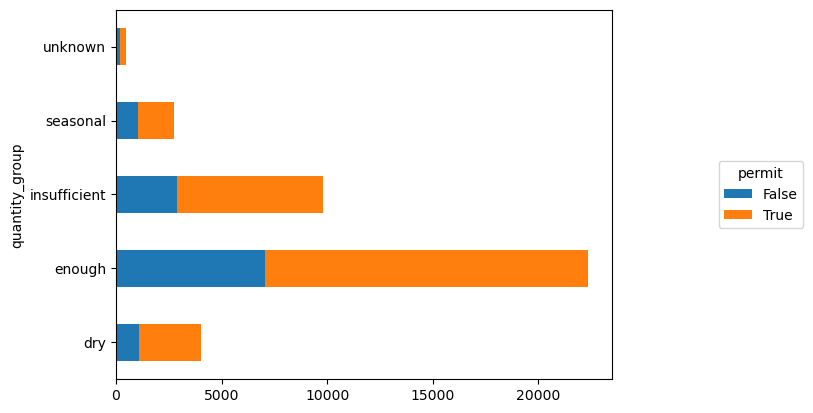

<Figure size 1600x800 with 0 Axes>

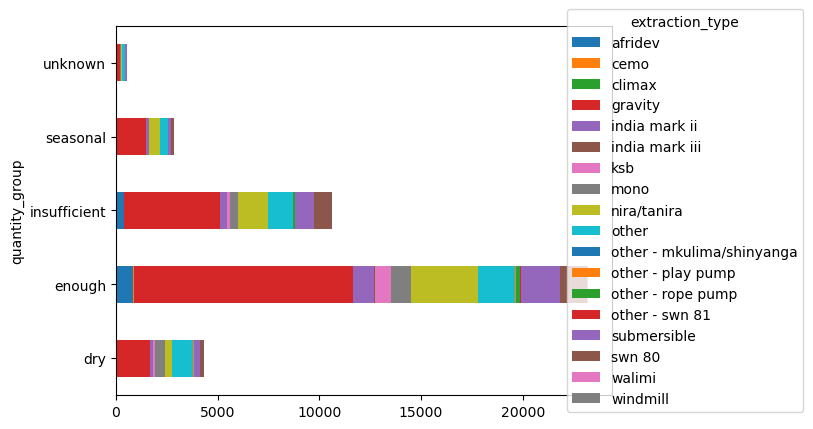

<Figure size 1600x800 with 0 Axes>

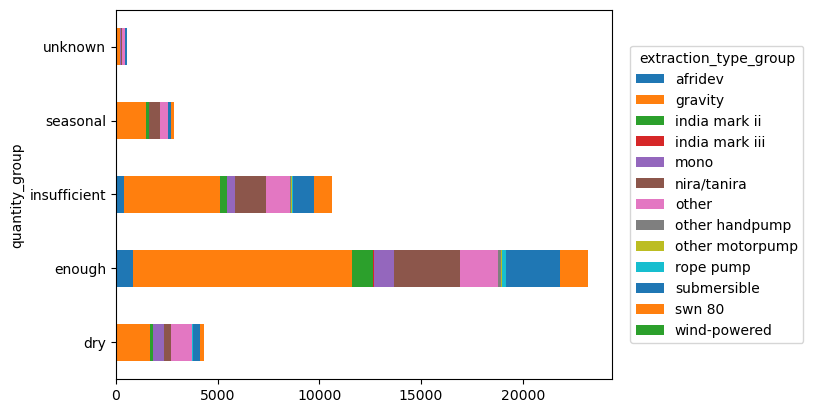

<Figure size 1600x800 with 0 Axes>

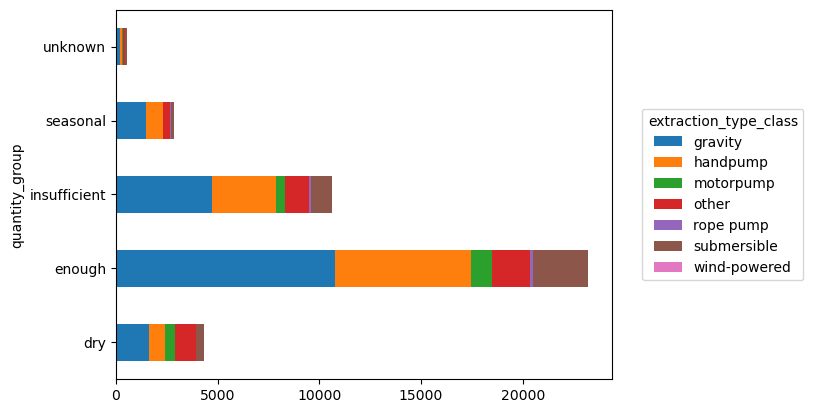

<Figure size 1600x800 with 0 Axes>

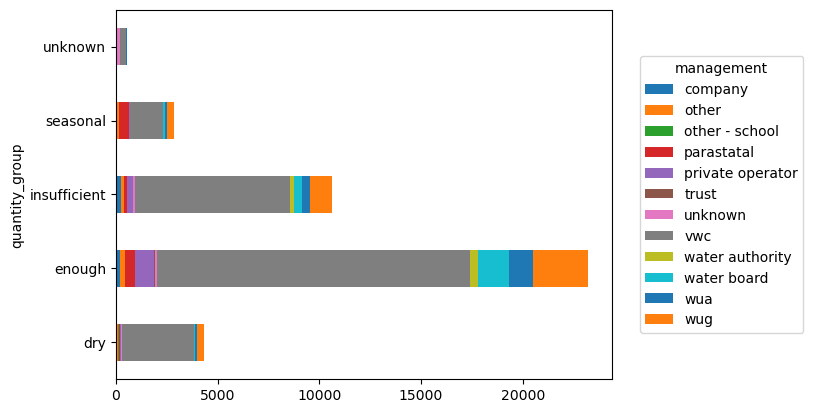

<Figure size 1600x800 with 0 Axes>

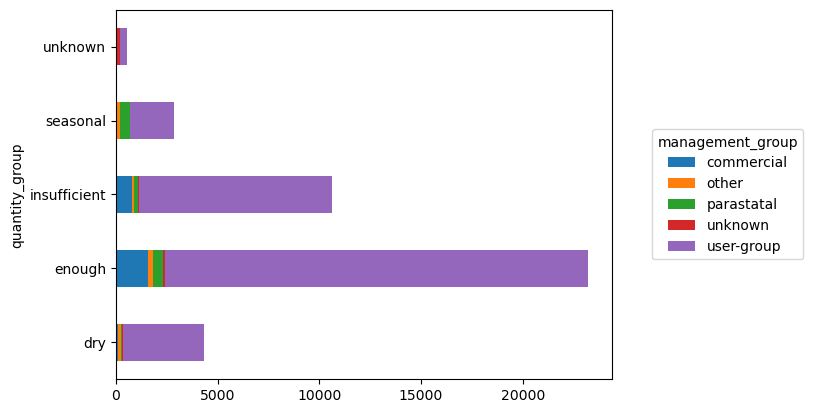

<Figure size 1600x800 with 0 Axes>

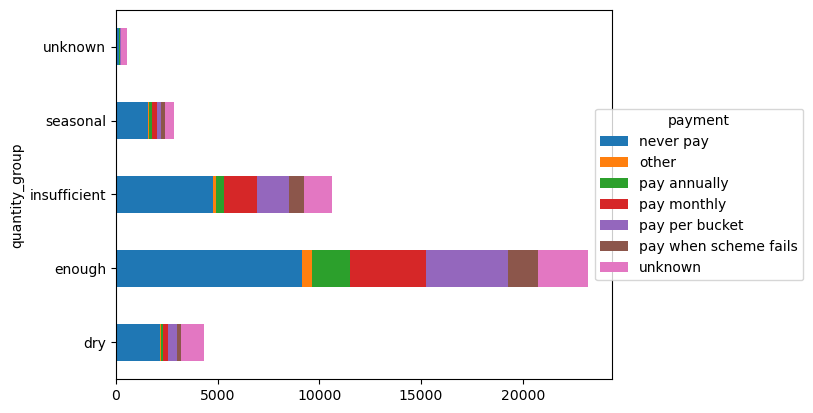

<Figure size 1600x800 with 0 Axes>

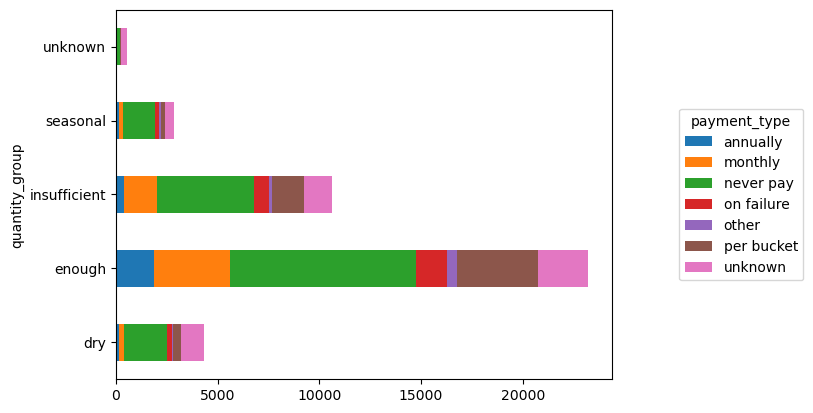

<Figure size 1600x800 with 0 Axes>

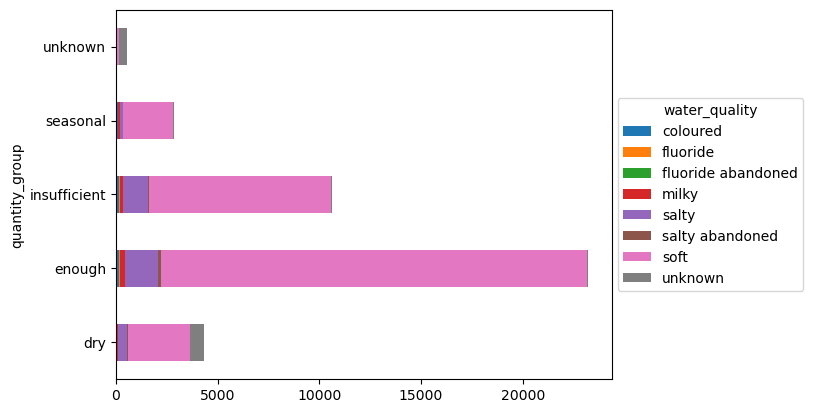

<Figure size 1600x800 with 0 Axes>

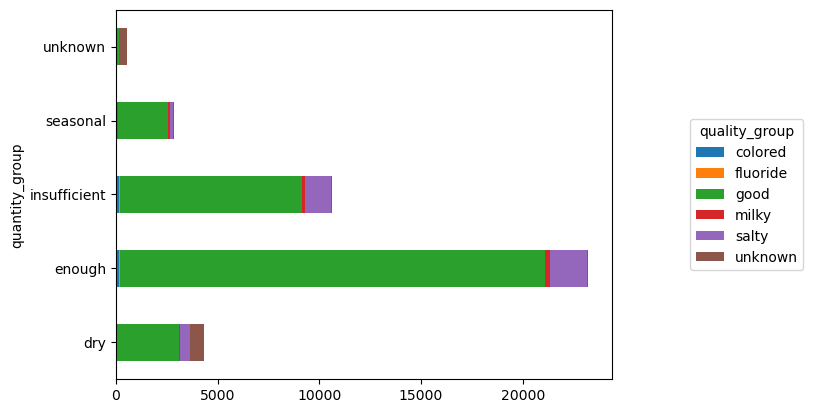

<Figure size 1600x800 with 0 Axes>

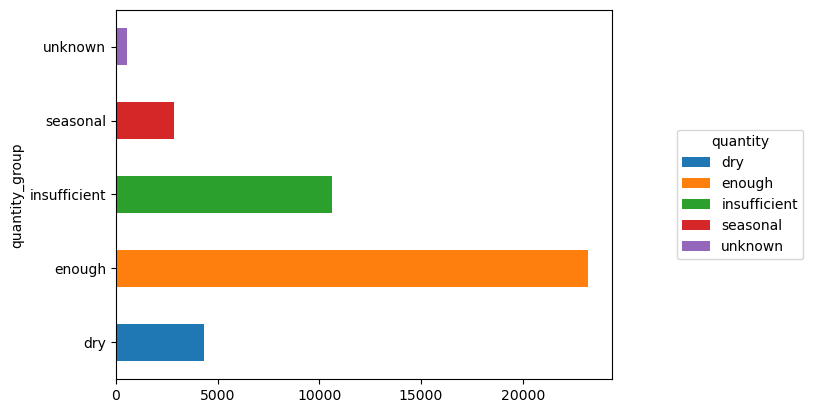

<Figure size 1600x800 with 0 Axes>

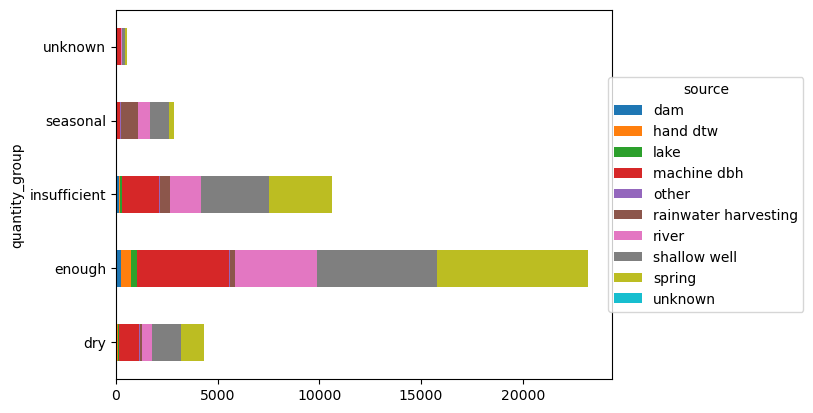

<Figure size 1600x800 with 0 Axes>

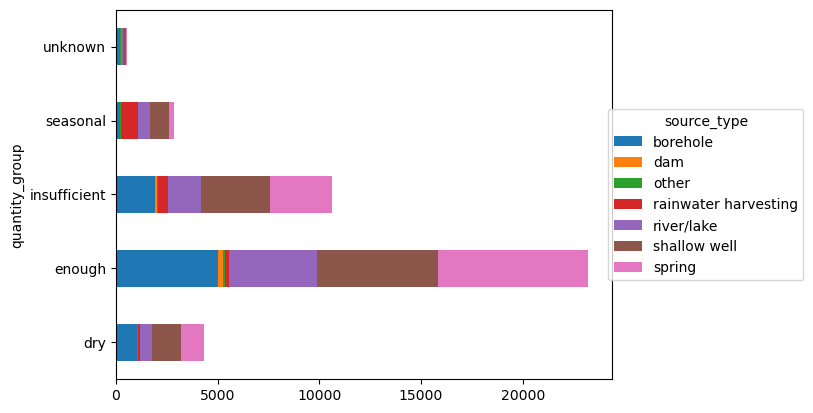

<Figure size 1600x800 with 0 Axes>

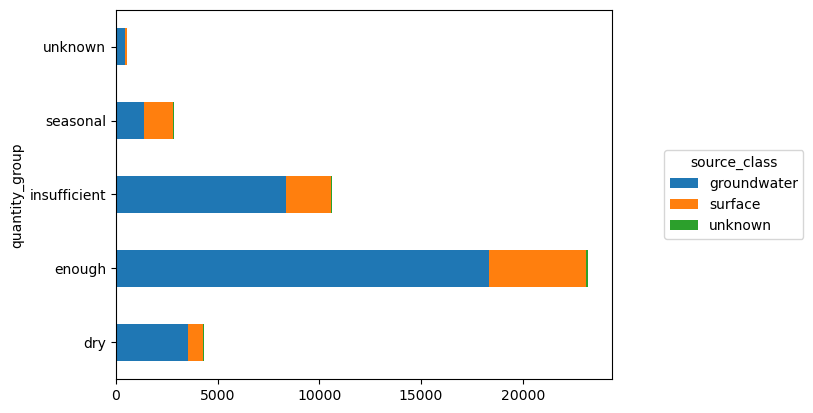

<Figure size 1600x800 with 0 Axes>

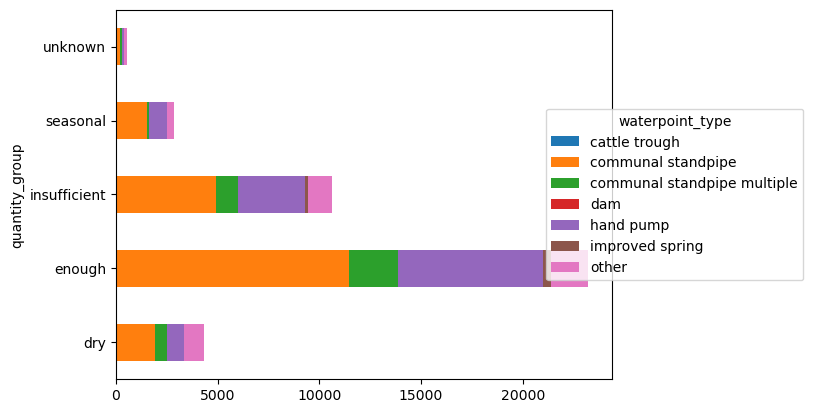

<Figure size 1600x800 with 0 Axes>

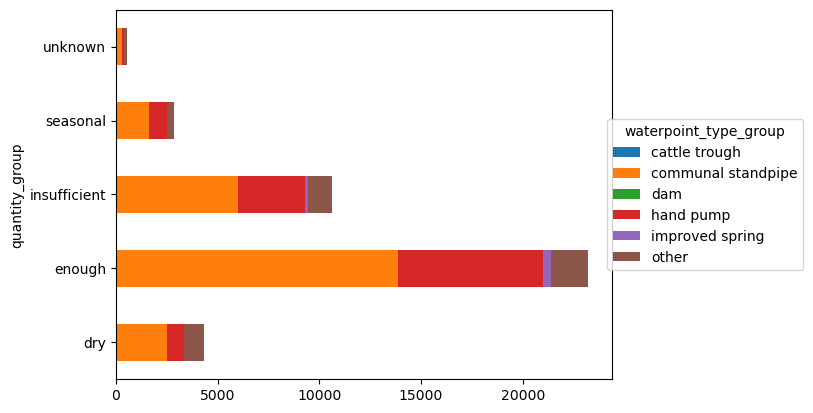

<Figure size 1600x800 with 0 Axes>

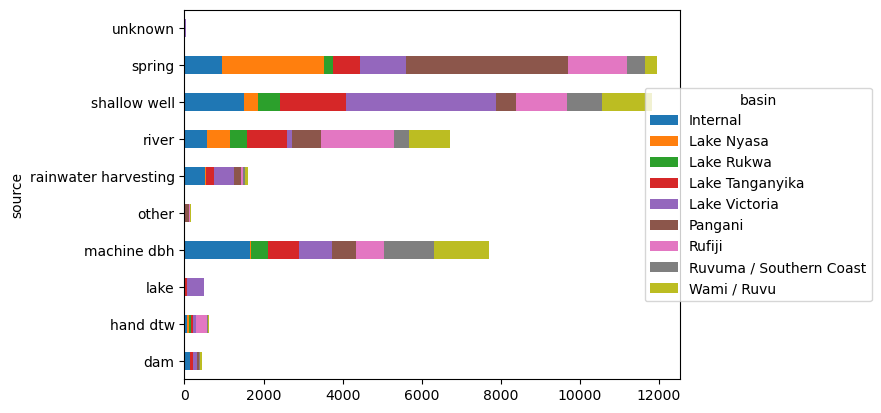

<Figure size 1600x800 with 0 Axes>

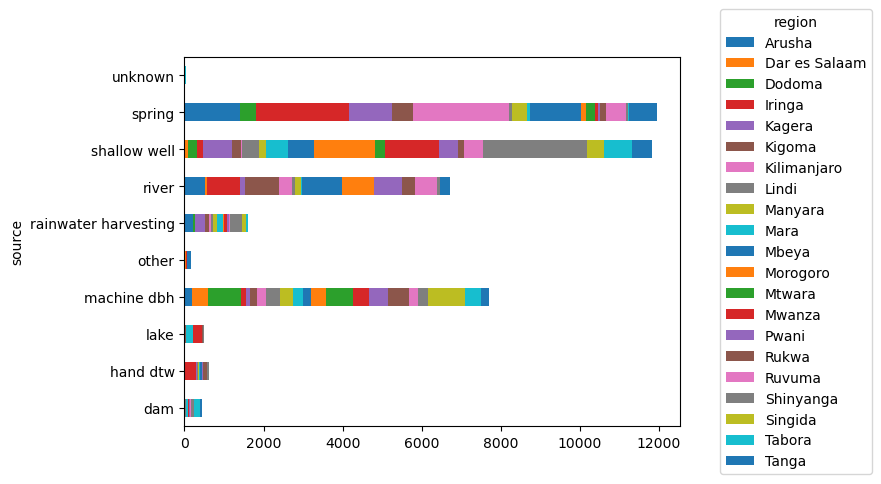

<Figure size 1600x800 with 0 Axes>

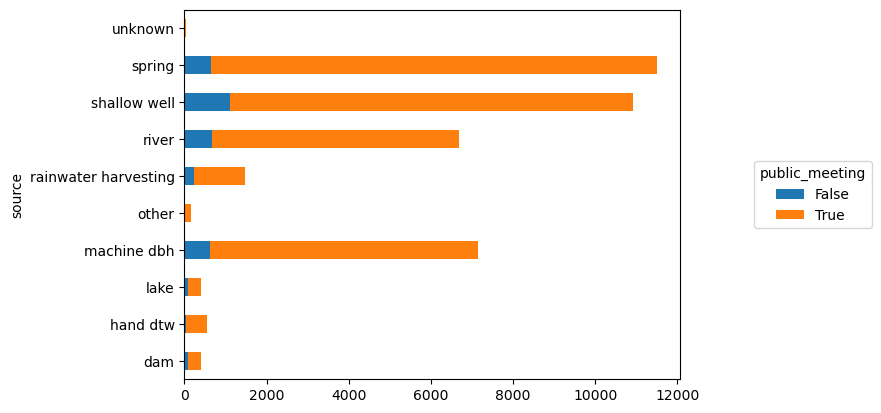

<Figure size 1600x800 with 0 Axes>

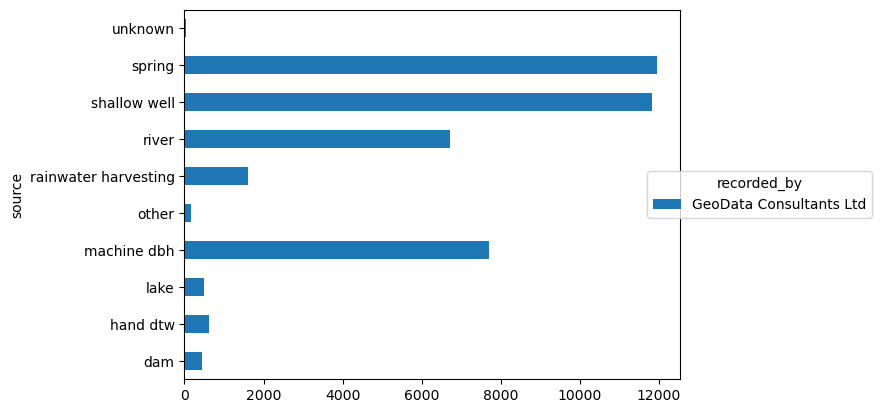

<Figure size 1600x800 with 0 Axes>

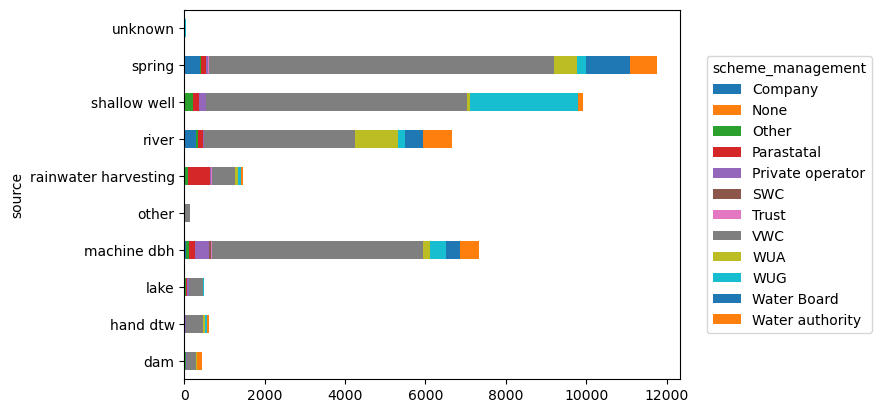

<Figure size 1600x800 with 0 Axes>

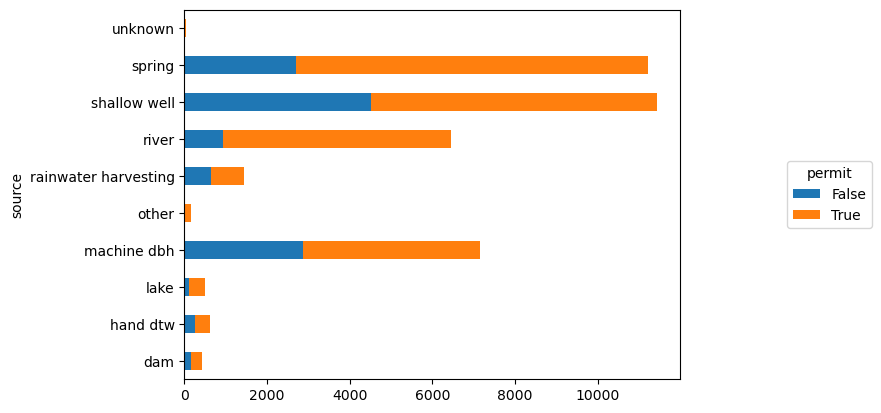

<Figure size 1600x800 with 0 Axes>

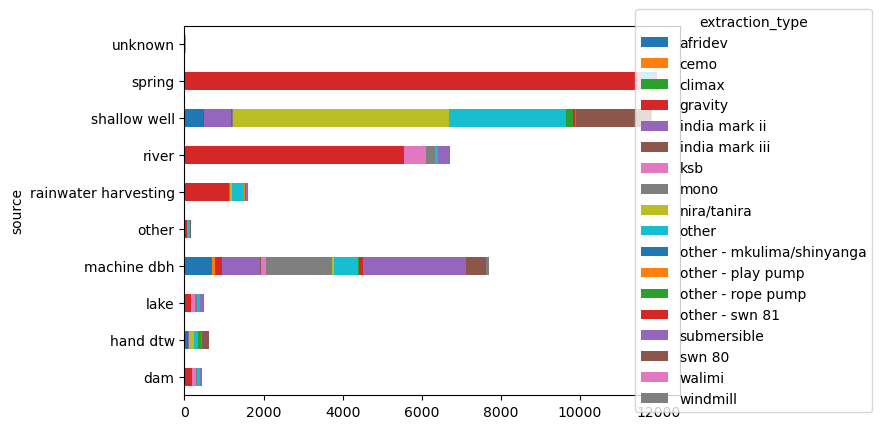

<Figure size 1600x800 with 0 Axes>

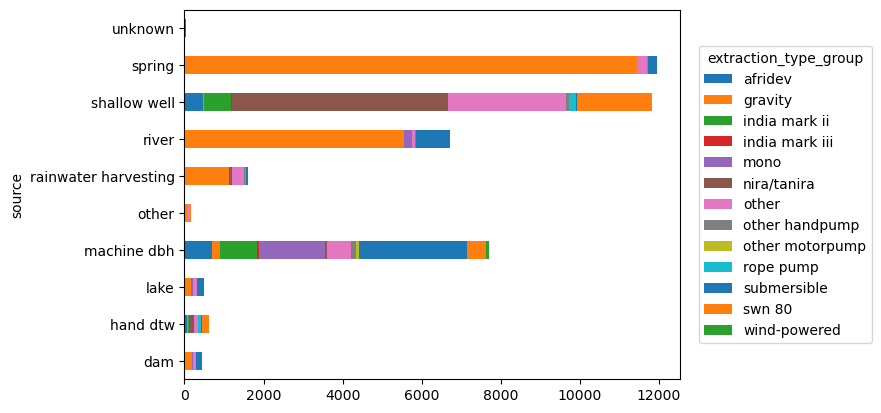

<Figure size 1600x800 with 0 Axes>

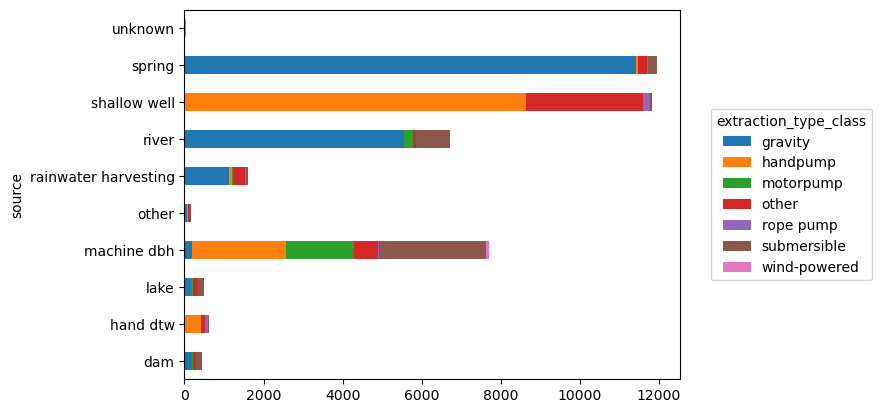

<Figure size 1600x800 with 0 Axes>

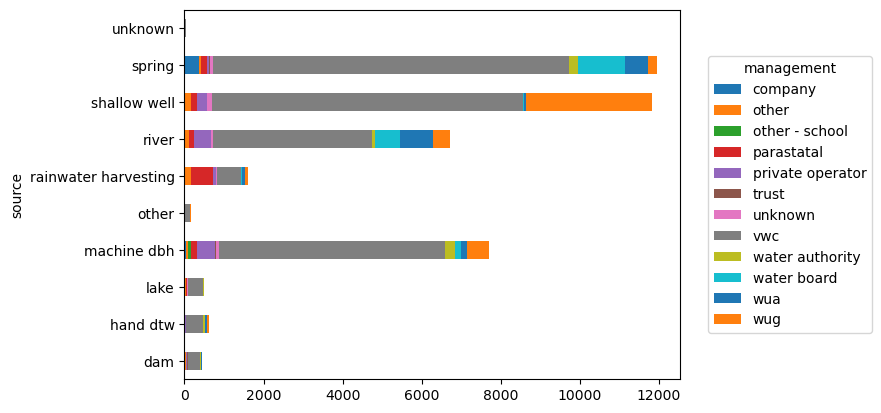

<Figure size 1600x800 with 0 Axes>

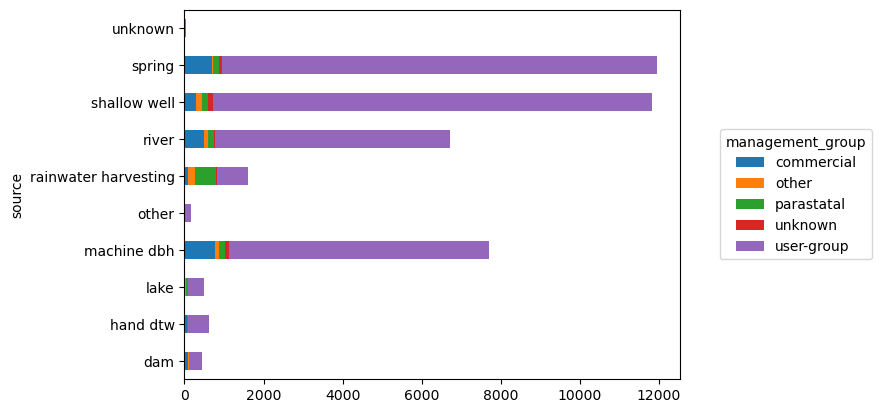

<Figure size 1600x800 with 0 Axes>

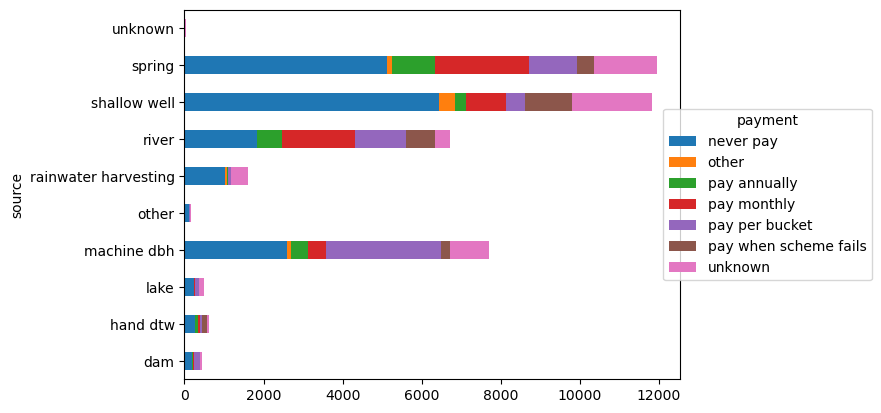

<Figure size 1600x800 with 0 Axes>

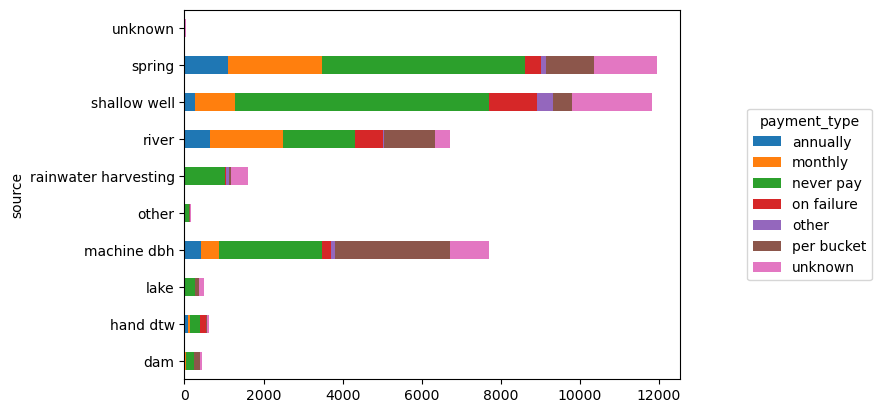

<Figure size 1600x800 with 0 Axes>

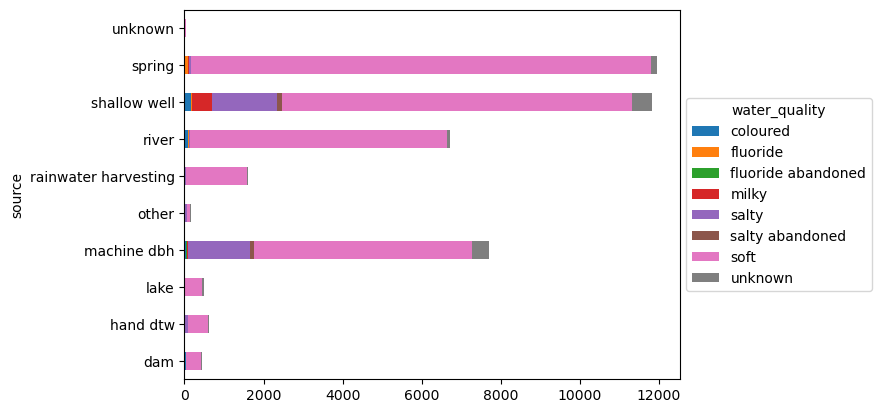

<Figure size 1600x800 with 0 Axes>

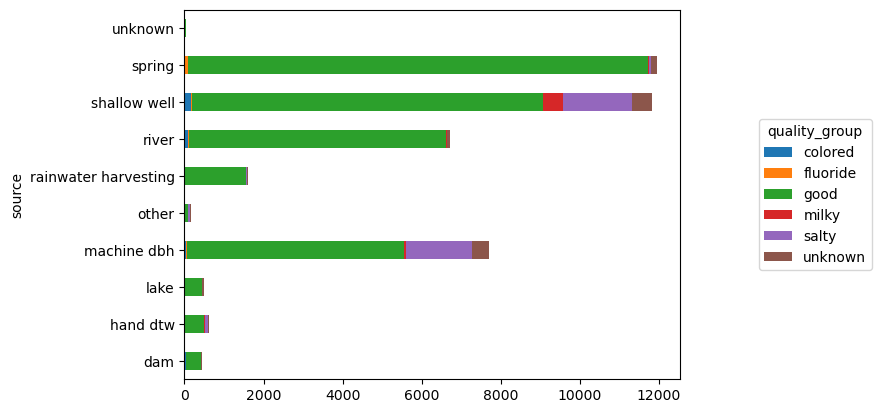

<Figure size 1600x800 with 0 Axes>

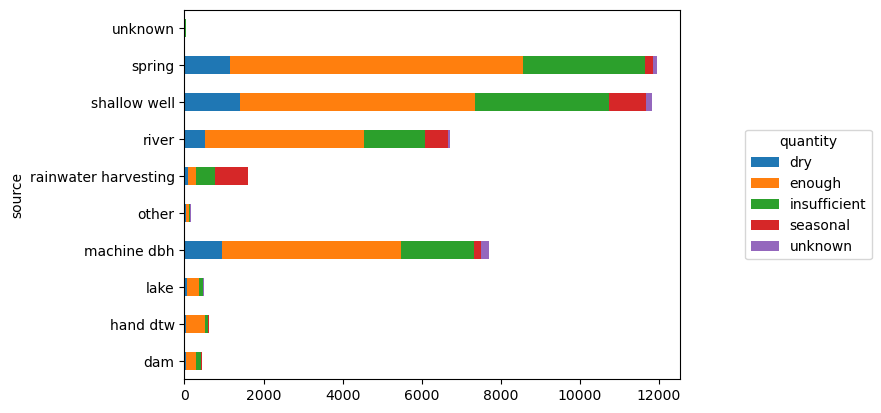

<Figure size 1600x800 with 0 Axes>

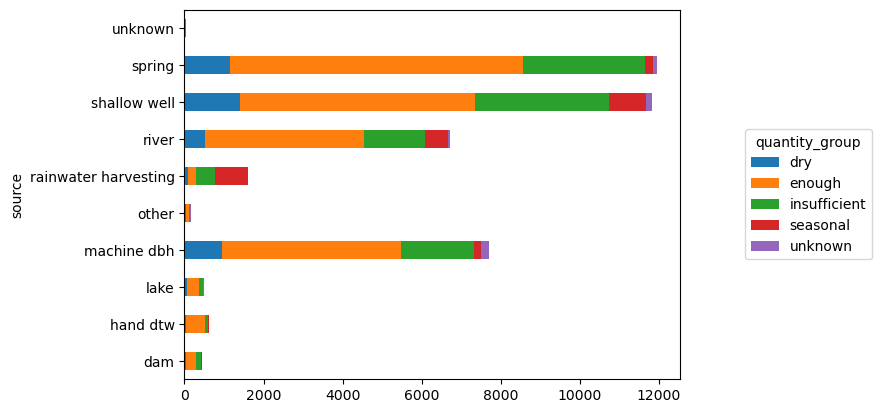

<Figure size 1600x800 with 0 Axes>

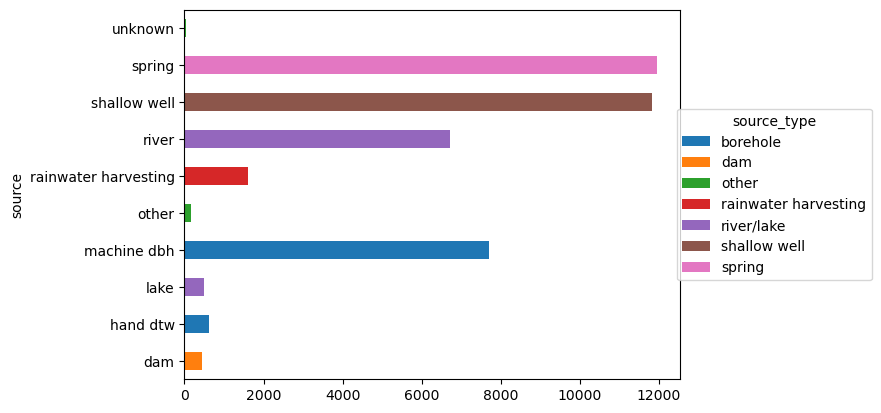

<Figure size 1600x800 with 0 Axes>

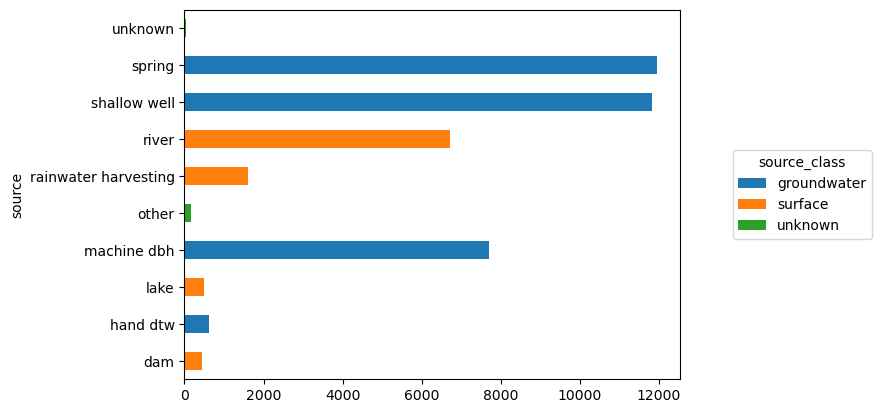

<Figure size 1600x800 with 0 Axes>

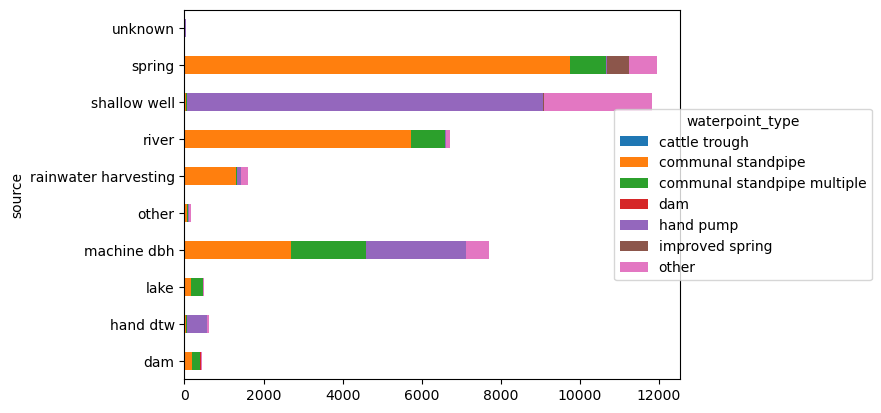

<Figure size 1600x800 with 0 Axes>

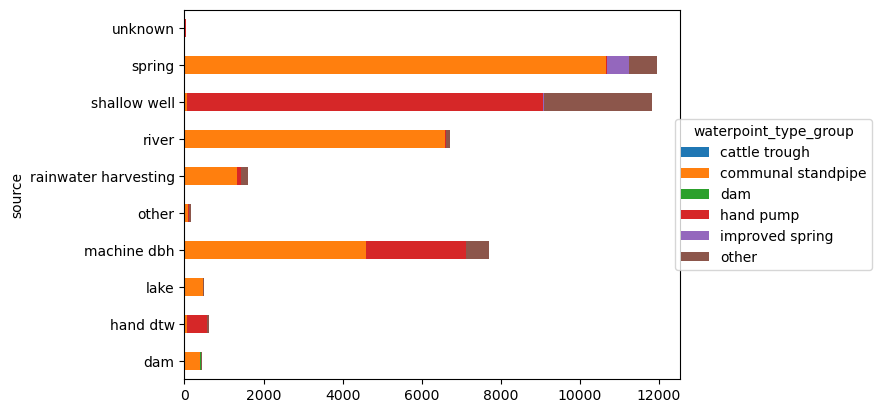

<Figure size 1600x800 with 0 Axes>

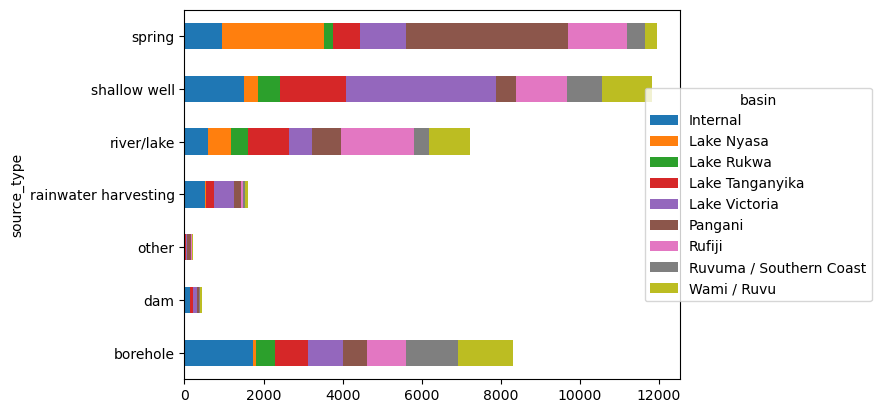

<Figure size 1600x800 with 0 Axes>

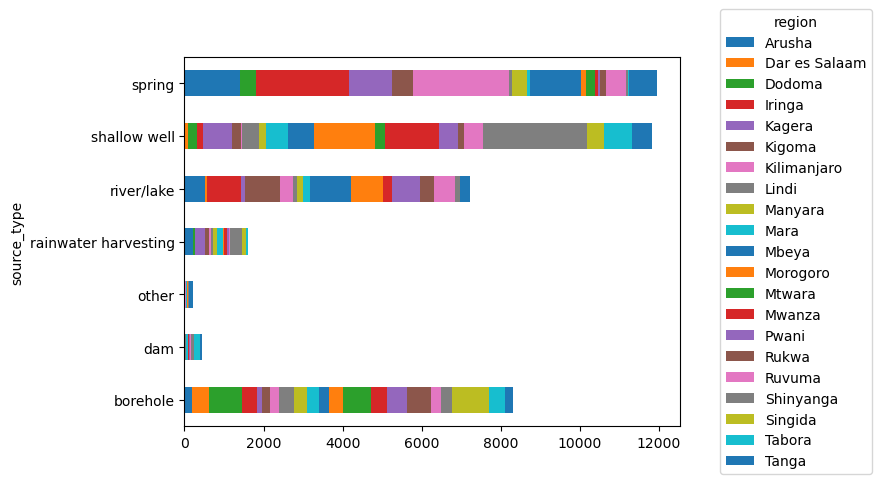

<Figure size 1600x800 with 0 Axes>

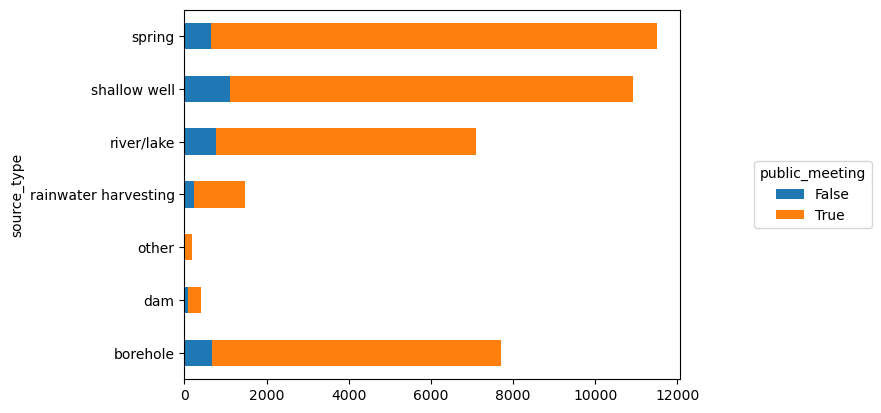

<Figure size 1600x800 with 0 Axes>

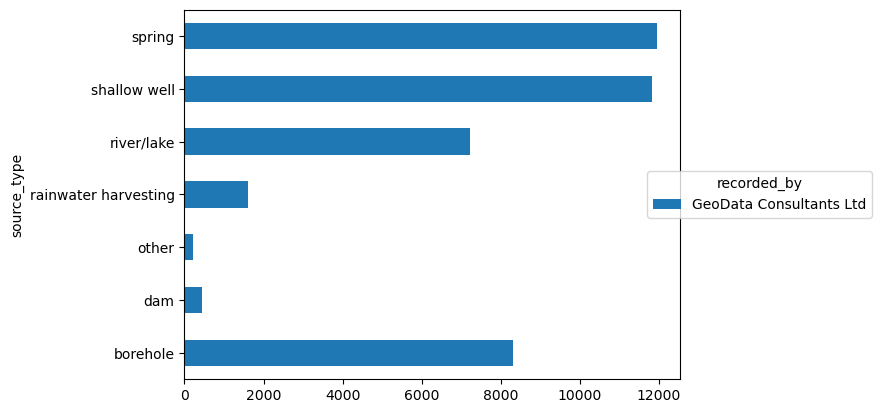

<Figure size 1600x800 with 0 Axes>

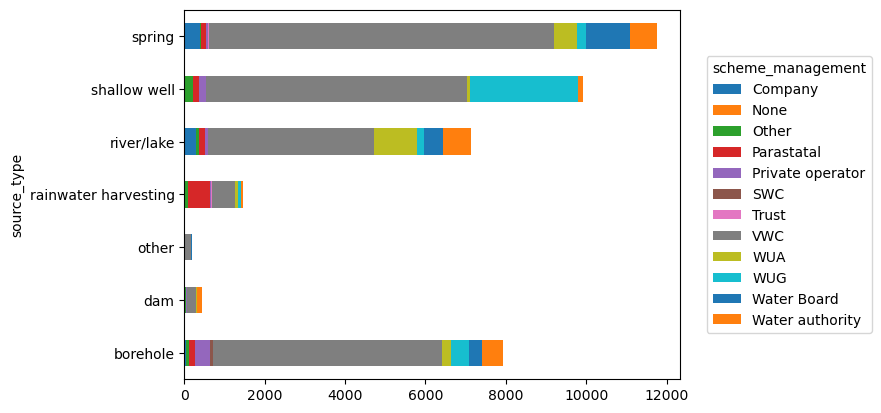

<Figure size 1600x800 with 0 Axes>

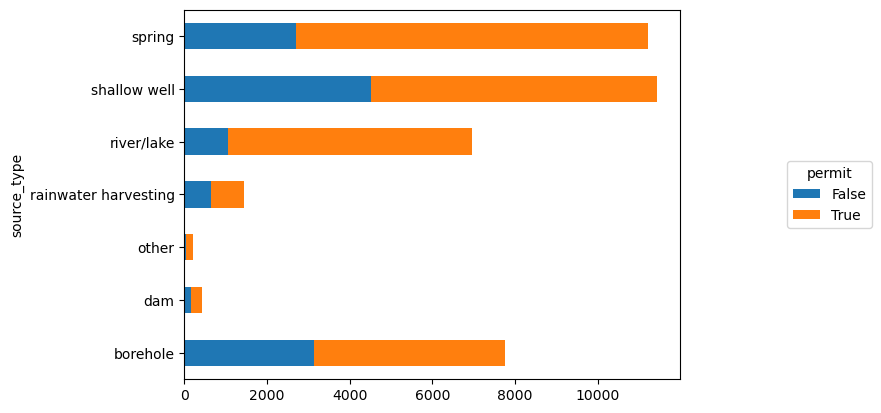

<Figure size 1600x800 with 0 Axes>

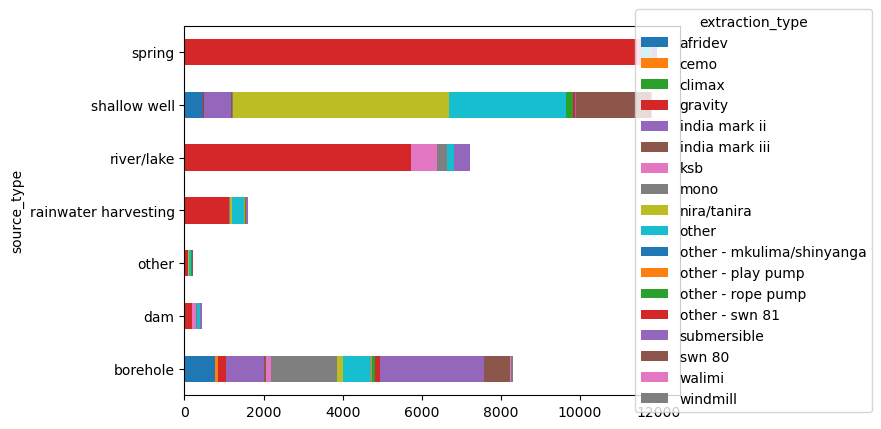

<Figure size 1600x800 with 0 Axes>

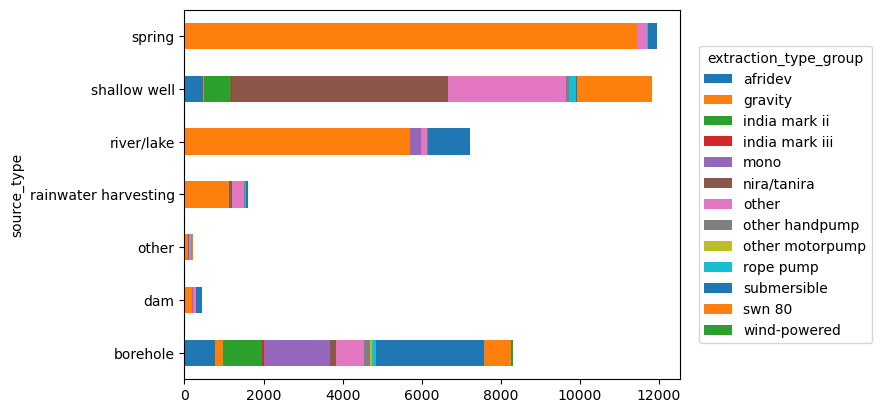

<Figure size 1600x800 with 0 Axes>

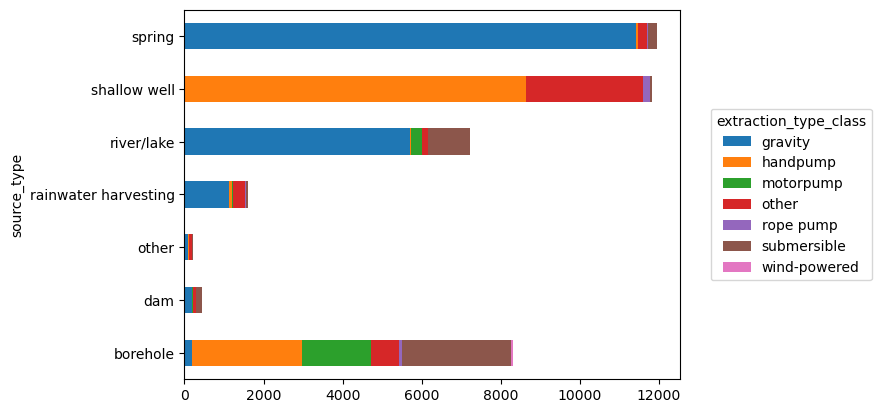

<Figure size 1600x800 with 0 Axes>

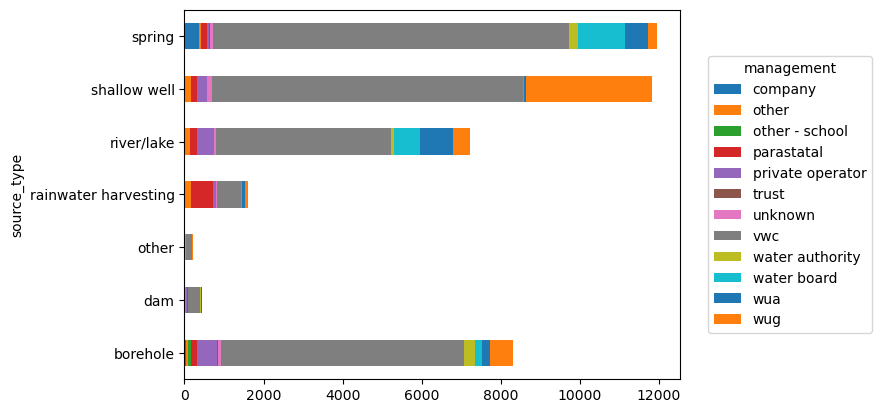

<Figure size 1600x800 with 0 Axes>

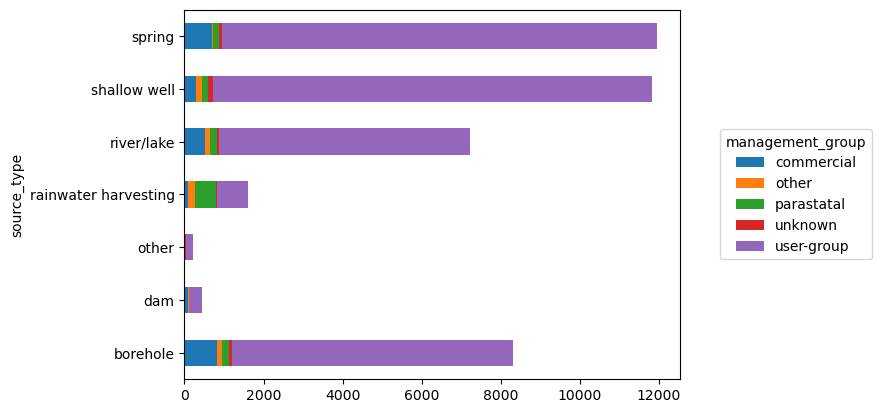

<Figure size 1600x800 with 0 Axes>

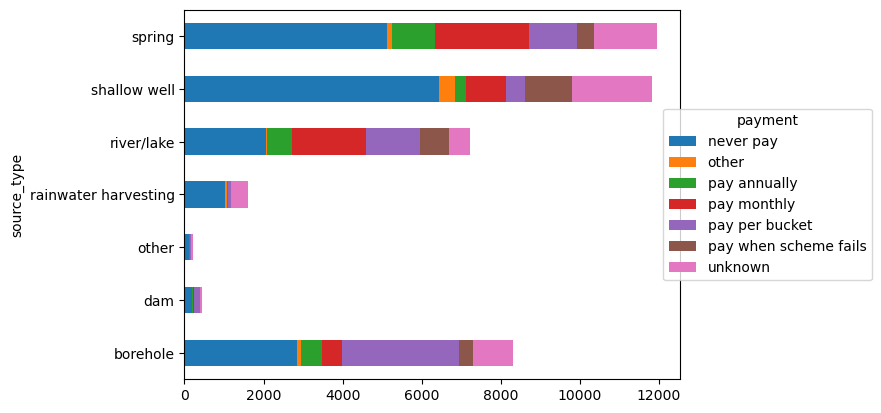

<Figure size 1600x800 with 0 Axes>

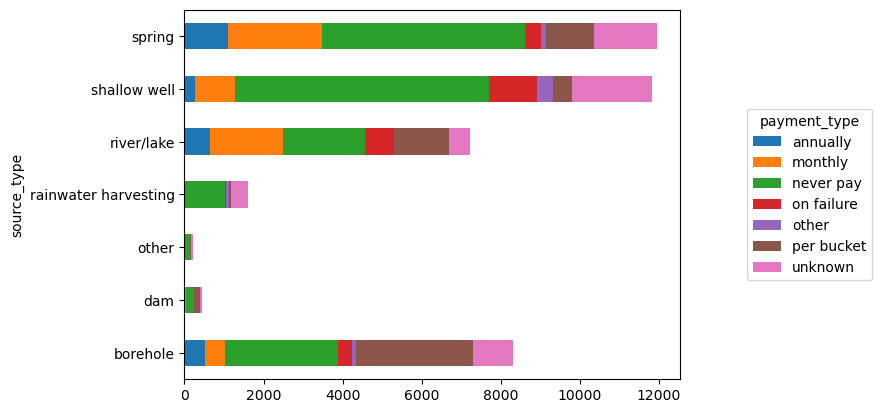

<Figure size 1600x800 with 0 Axes>

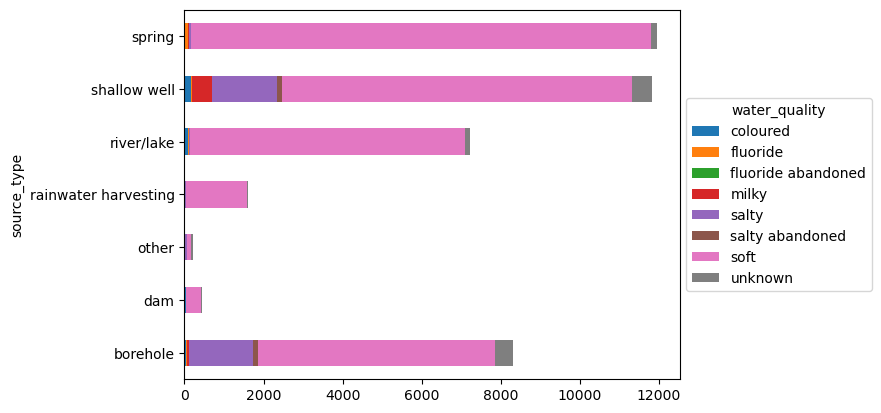

<Figure size 1600x800 with 0 Axes>

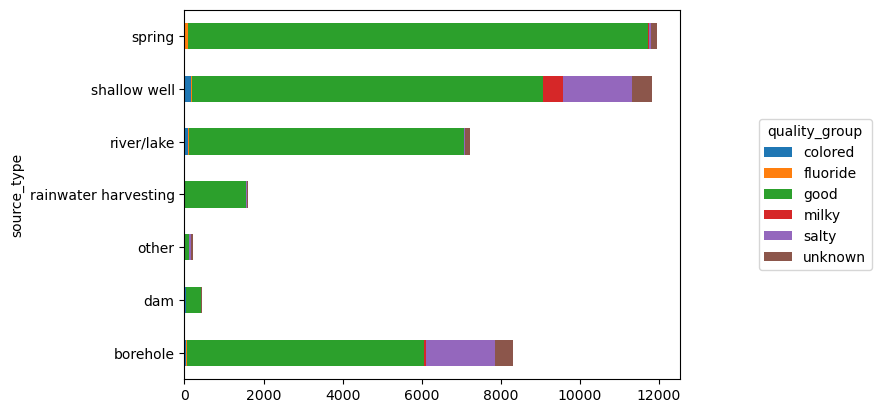

<Figure size 1600x800 with 0 Axes>

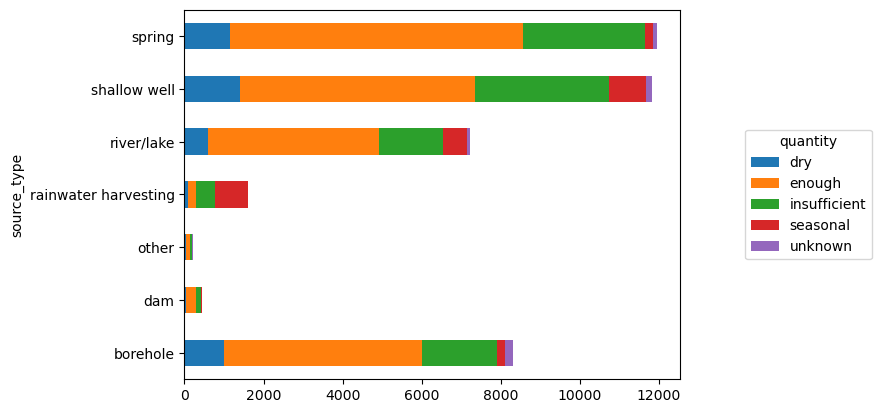

<Figure size 1600x800 with 0 Axes>

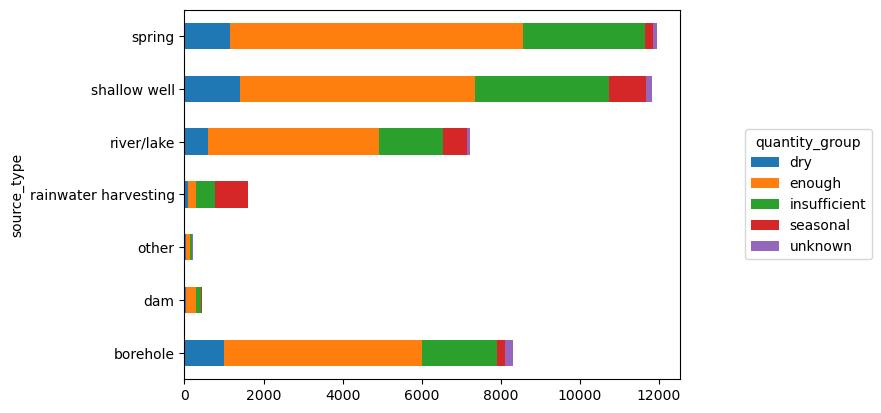

<Figure size 1600x800 with 0 Axes>

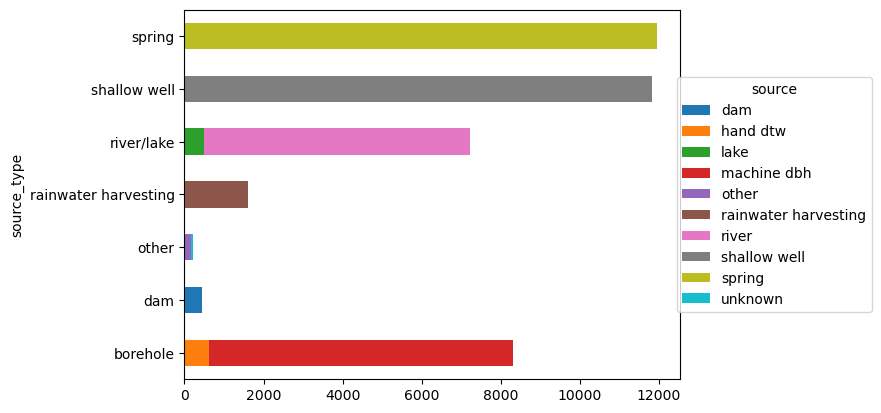

<Figure size 1600x800 with 0 Axes>

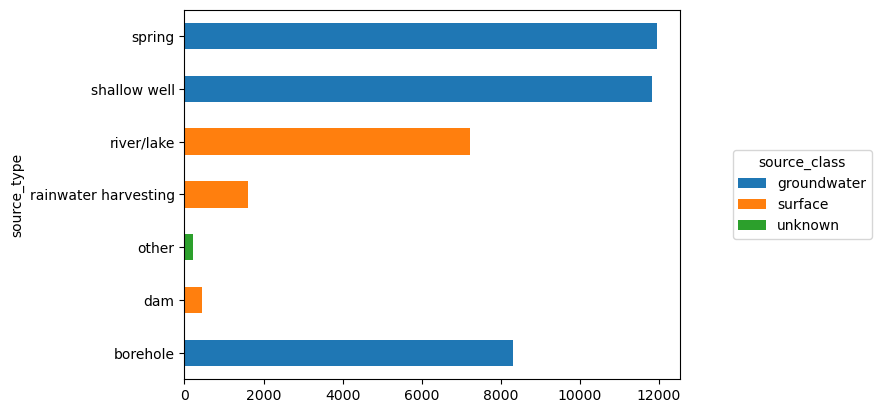

<Figure size 1600x800 with 0 Axes>

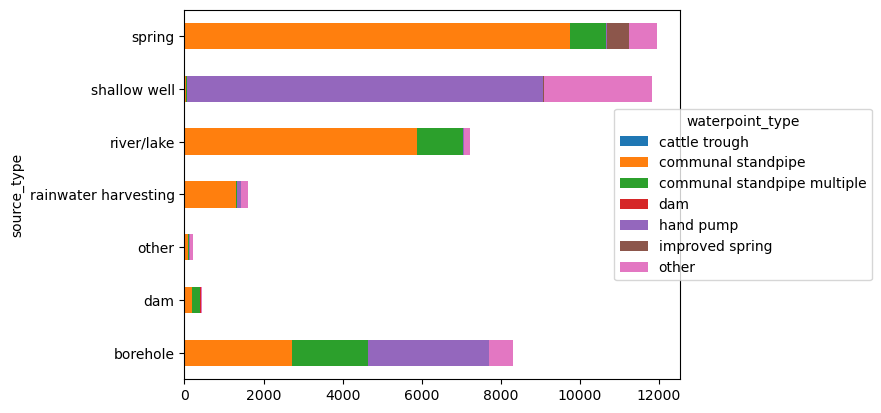

<Figure size 1600x800 with 0 Axes>

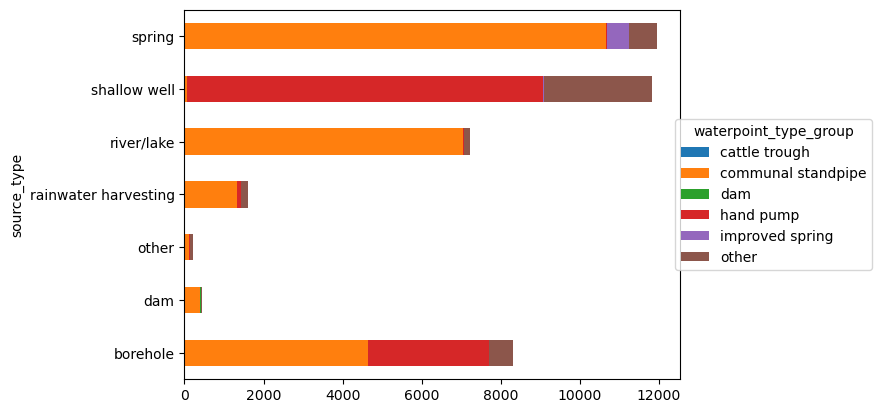

<Figure size 1600x800 with 0 Axes>

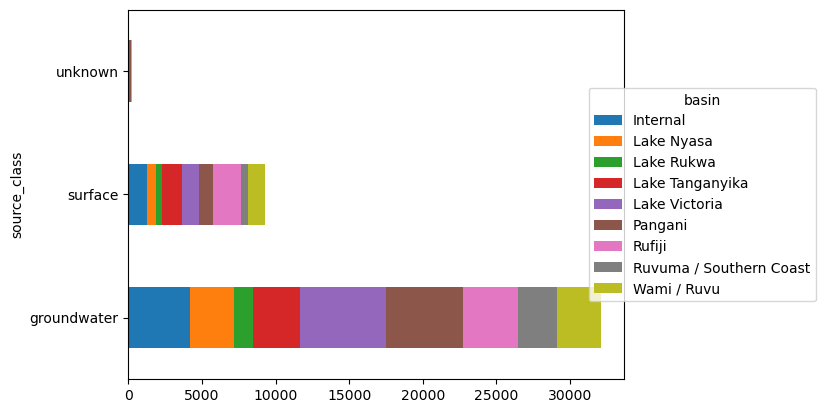

<Figure size 1600x800 with 0 Axes>

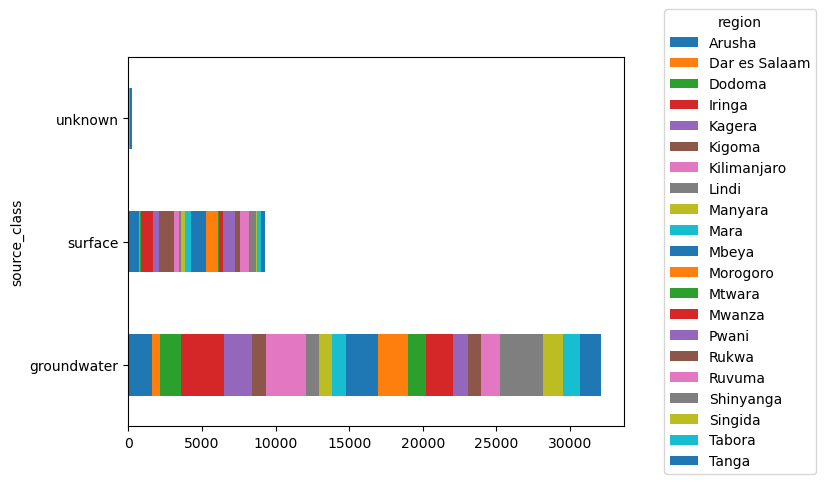

<Figure size 1600x800 with 0 Axes>

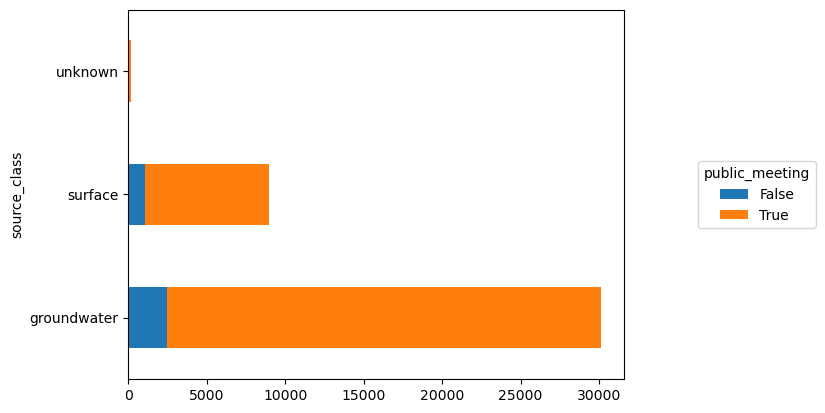

<Figure size 1600x800 with 0 Axes>

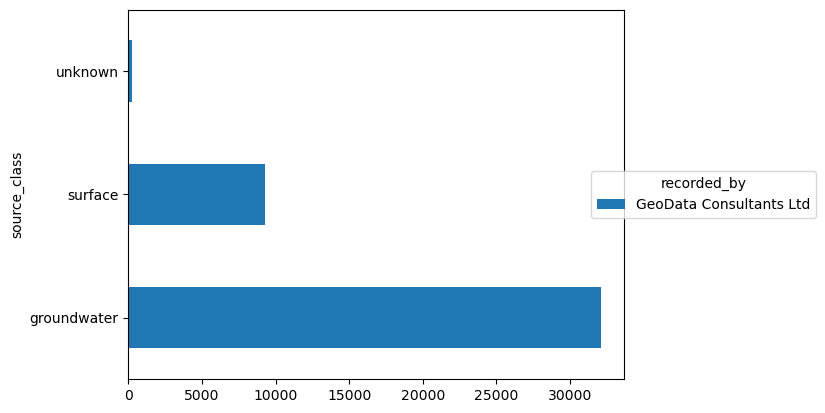

<Figure size 1600x800 with 0 Axes>

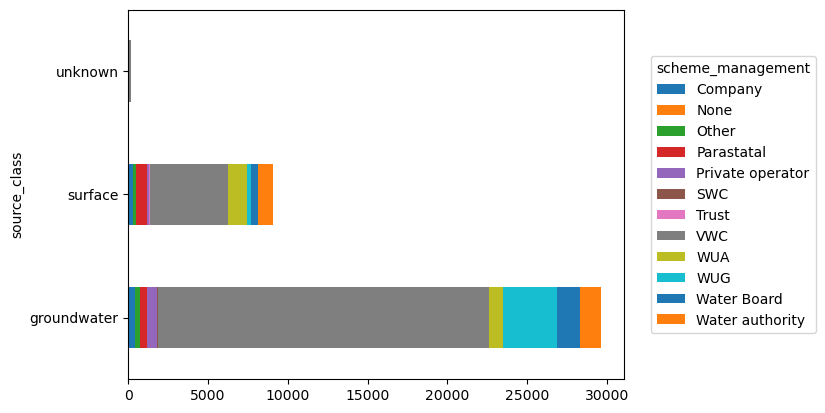

<Figure size 1600x800 with 0 Axes>

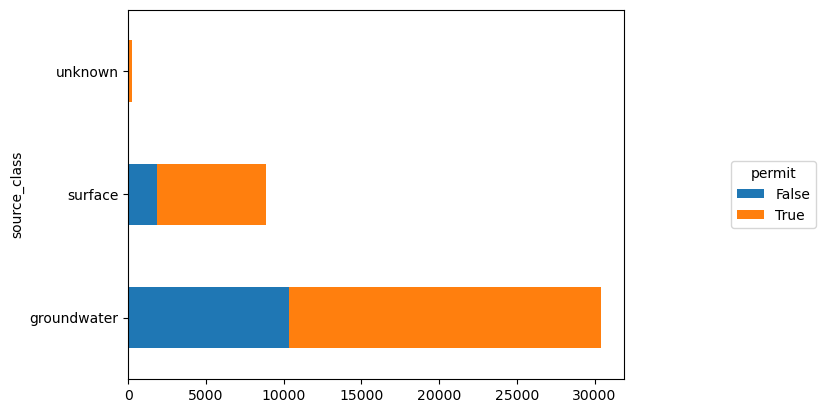

<Figure size 1600x800 with 0 Axes>

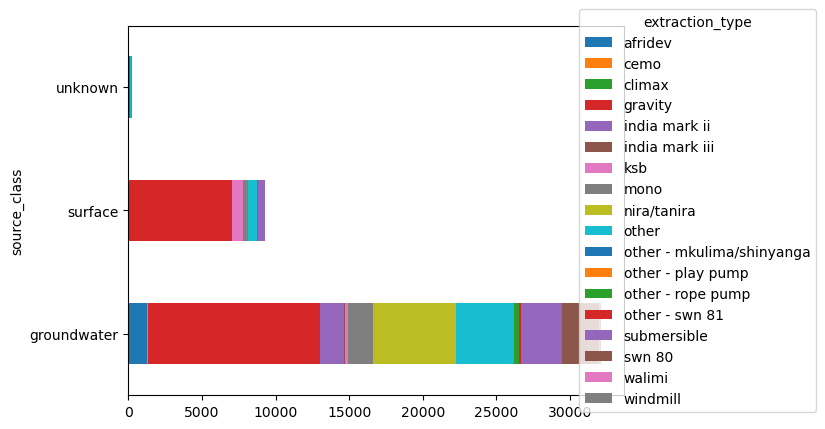

<Figure size 1600x800 with 0 Axes>

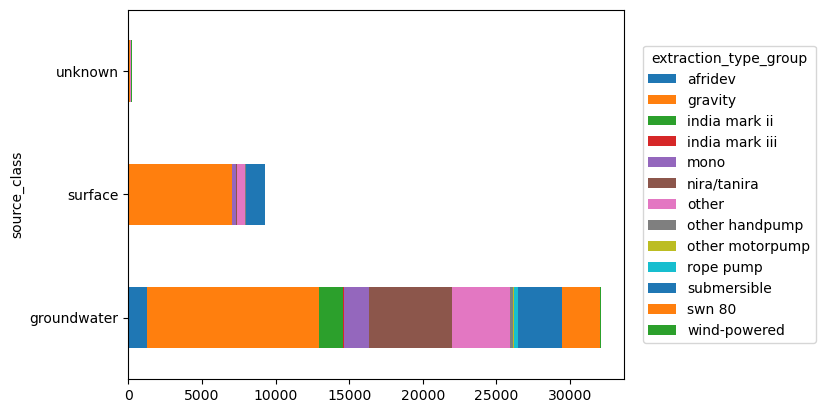

<Figure size 1600x800 with 0 Axes>

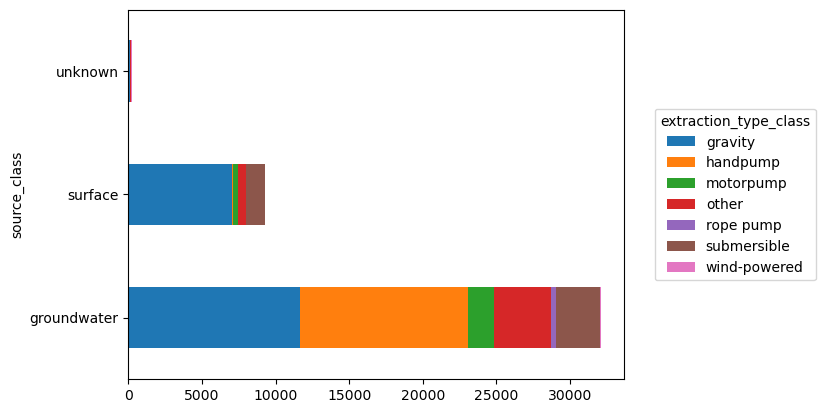

<Figure size 1600x800 with 0 Axes>

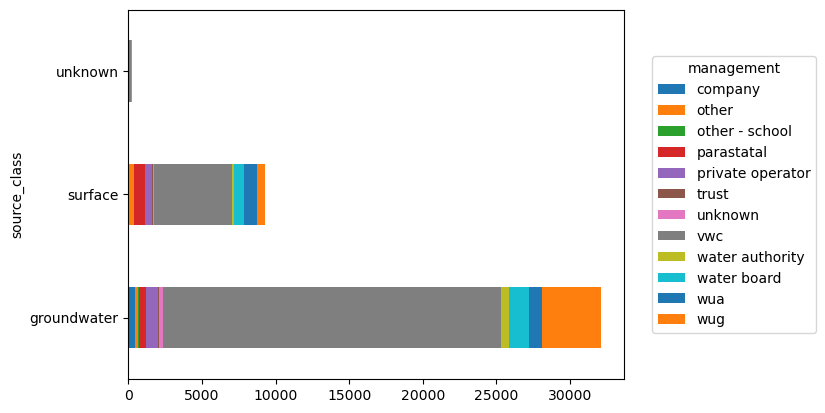

<Figure size 1600x800 with 0 Axes>

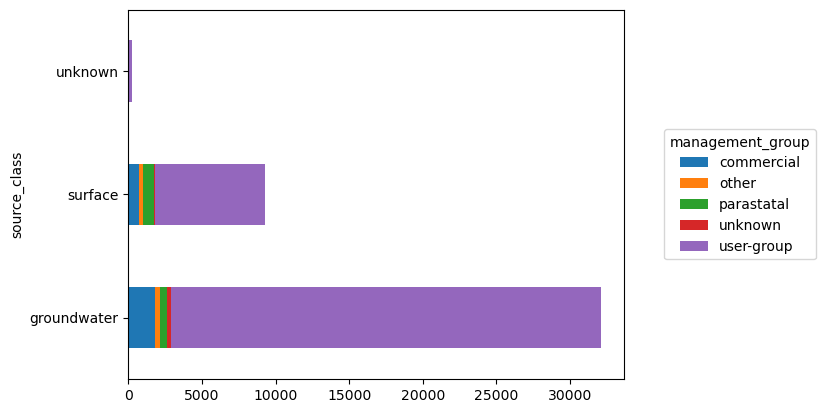

<Figure size 1600x800 with 0 Axes>

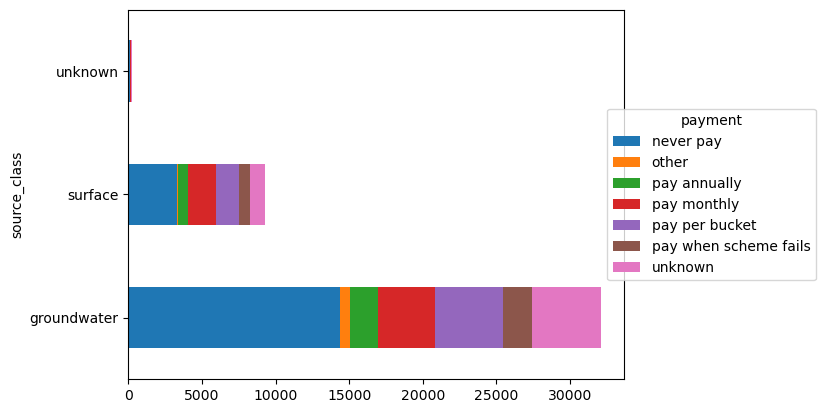

<Figure size 1600x800 with 0 Axes>

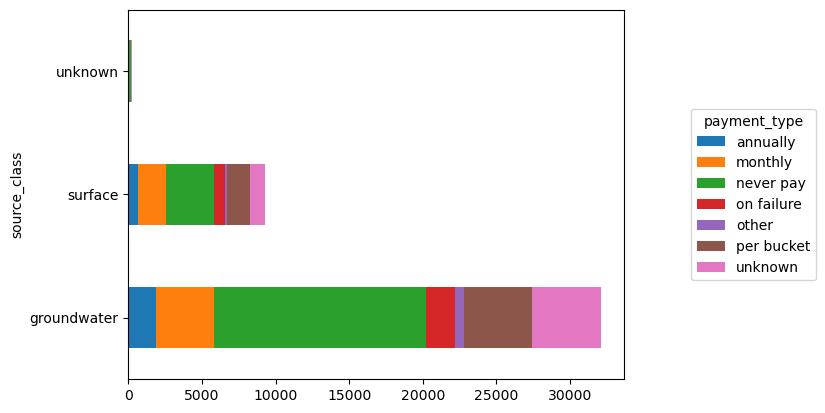

<Figure size 1600x800 with 0 Axes>

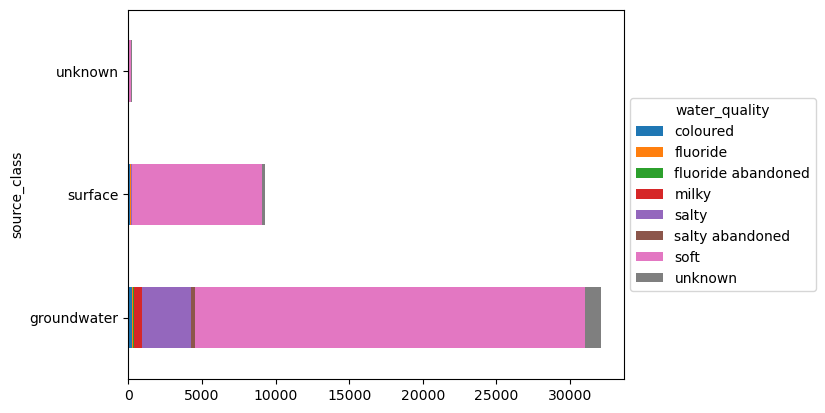

<Figure size 1600x800 with 0 Axes>

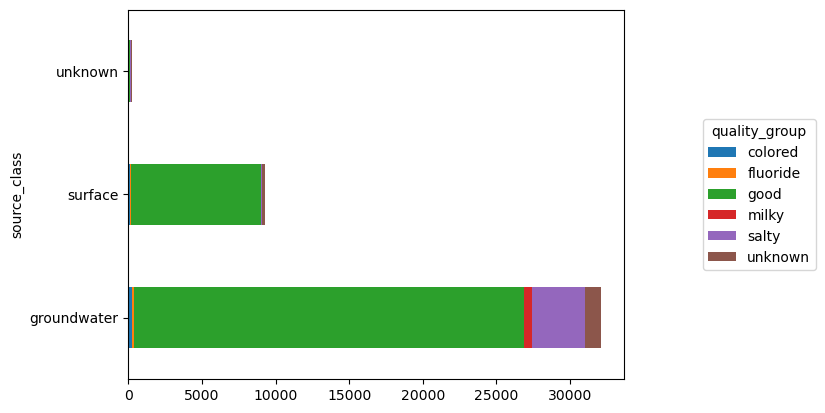

<Figure size 1600x800 with 0 Axes>

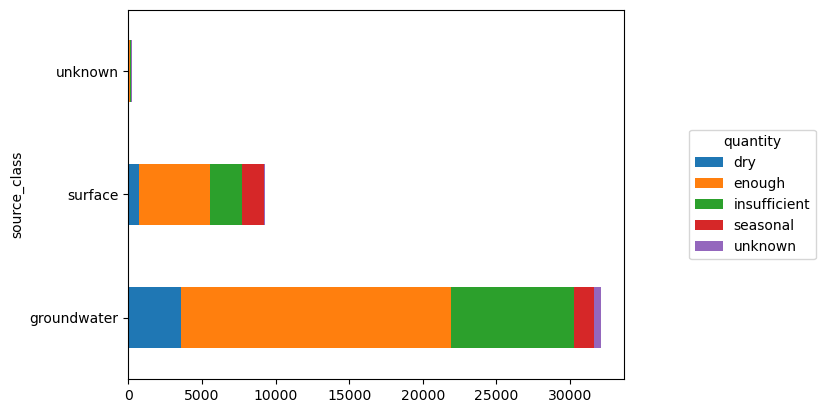

<Figure size 1600x800 with 0 Axes>

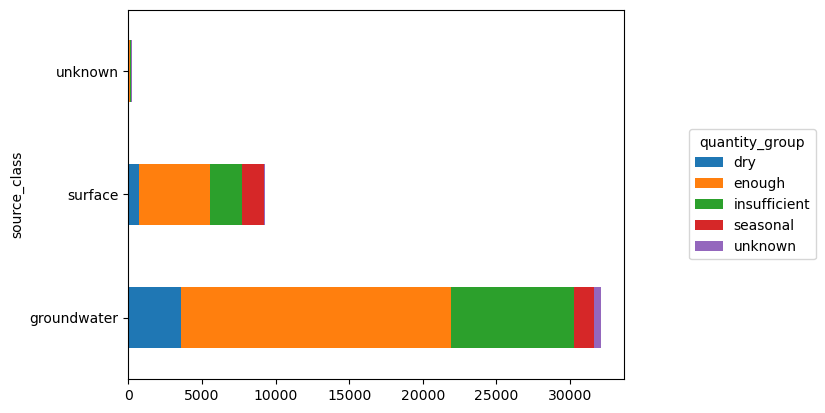

<Figure size 1600x800 with 0 Axes>

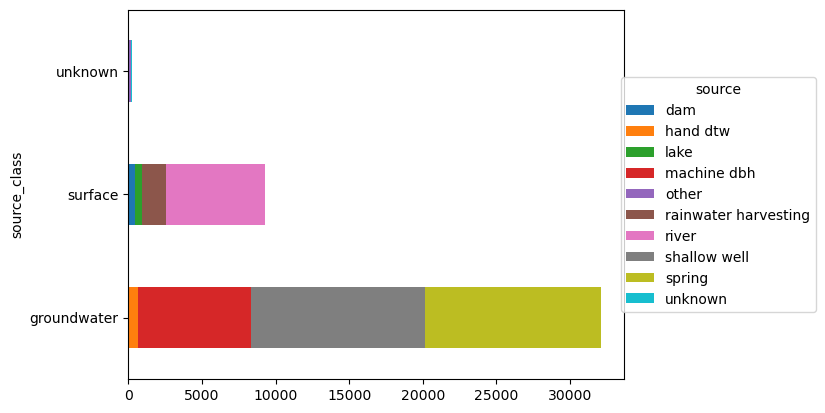

<Figure size 1600x800 with 0 Axes>

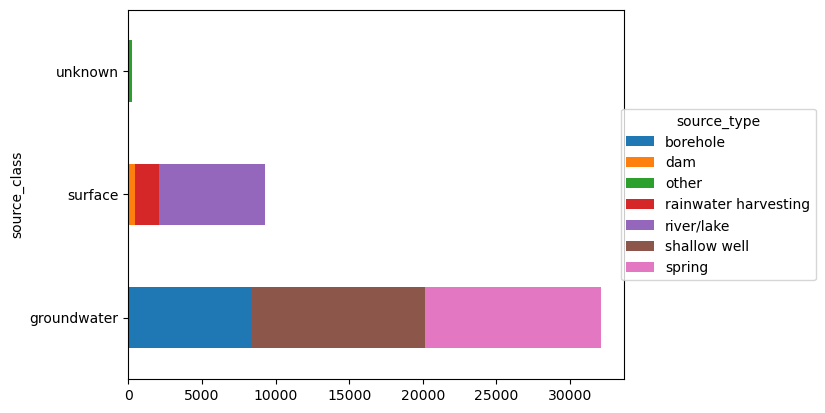

<Figure size 1600x800 with 0 Axes>

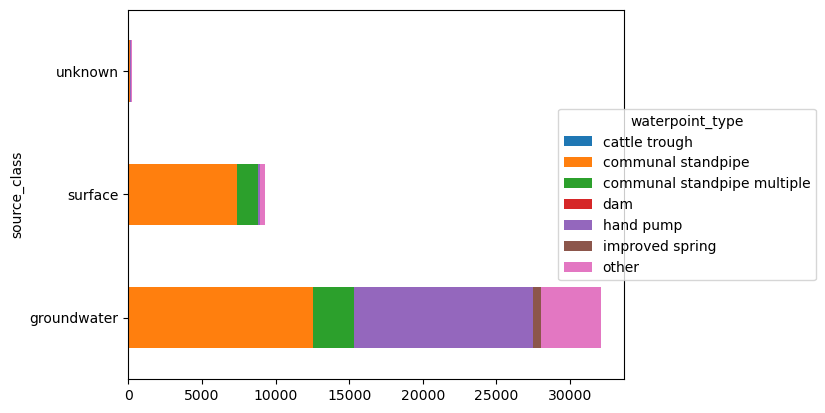

<Figure size 1600x800 with 0 Axes>

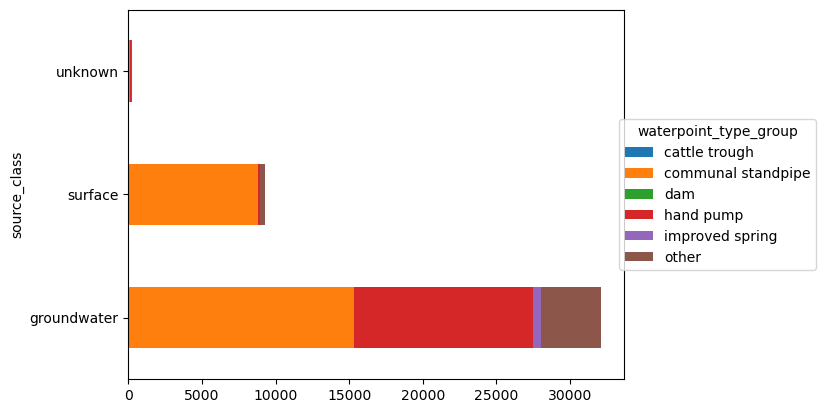

<Figure size 1600x800 with 0 Axes>

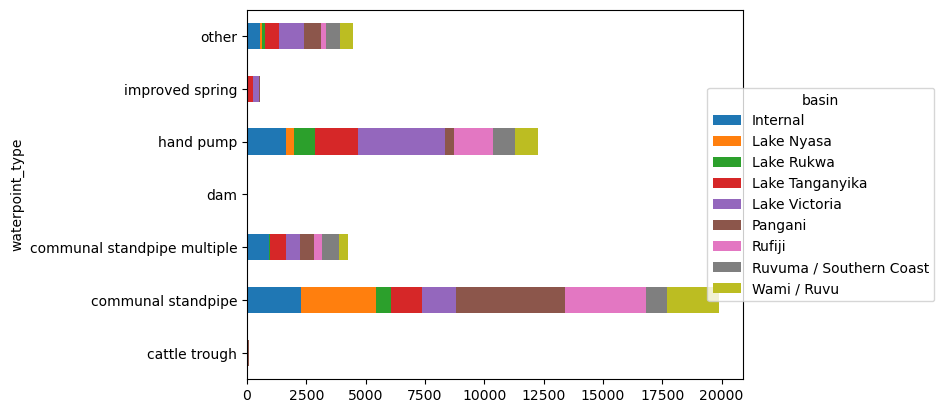

<Figure size 1600x800 with 0 Axes>

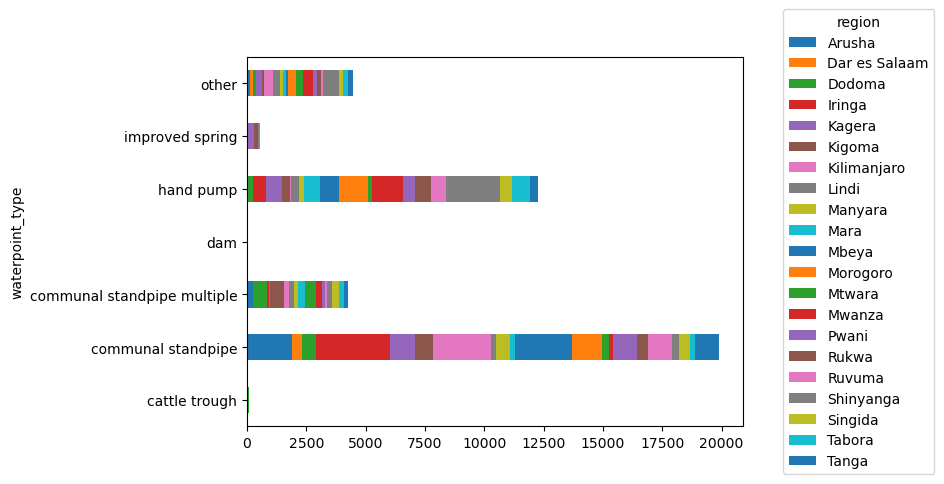

<Figure size 1600x800 with 0 Axes>

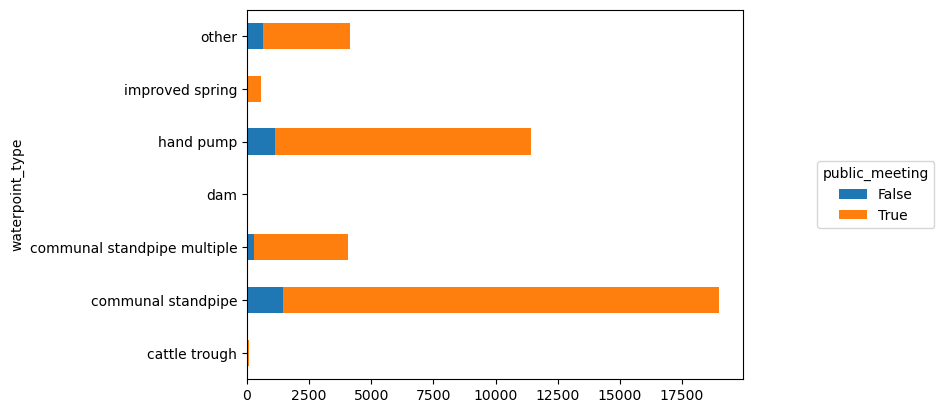

<Figure size 1600x800 with 0 Axes>

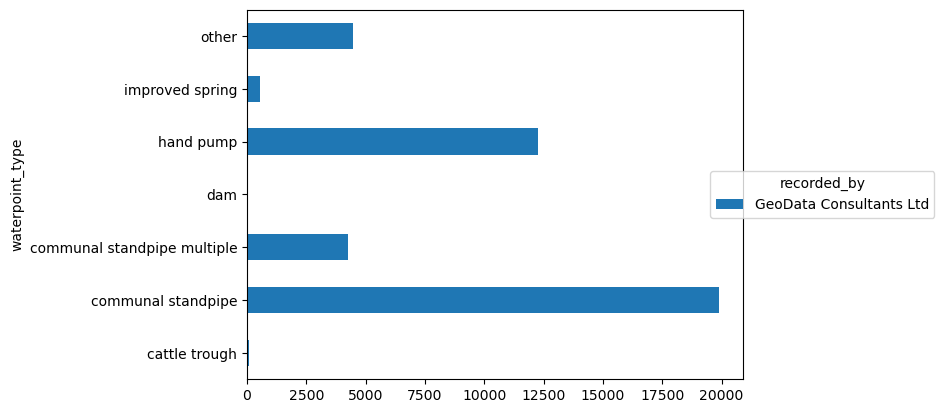

<Figure size 1600x800 with 0 Axes>

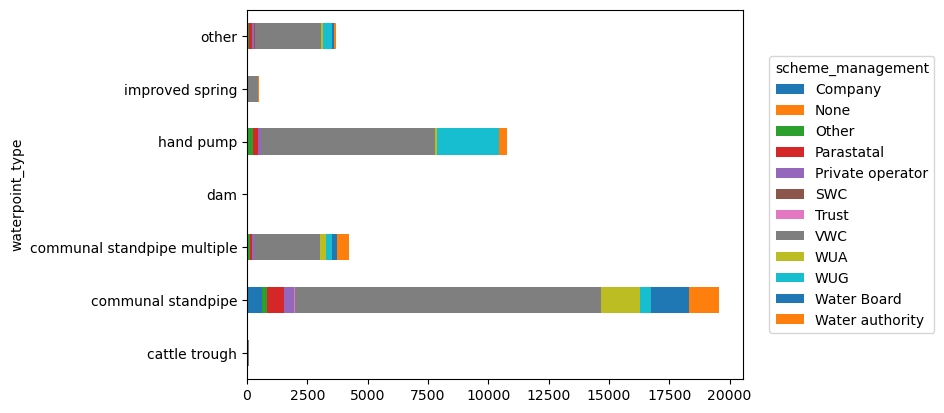

<Figure size 1600x800 with 0 Axes>

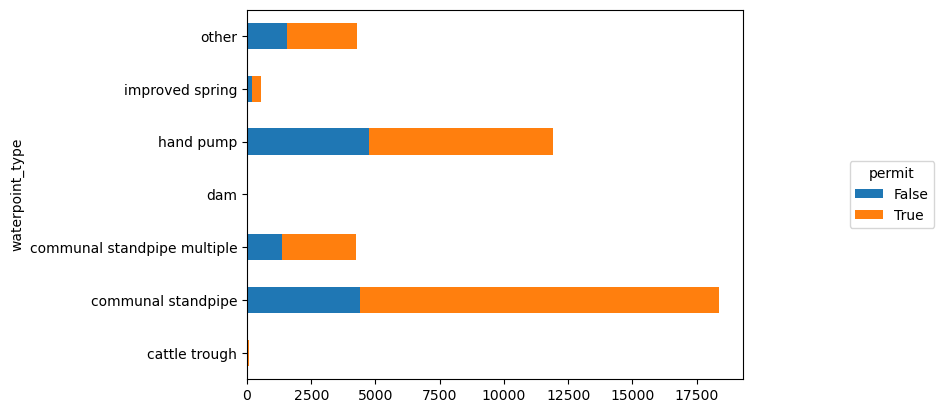

<Figure size 1600x800 with 0 Axes>

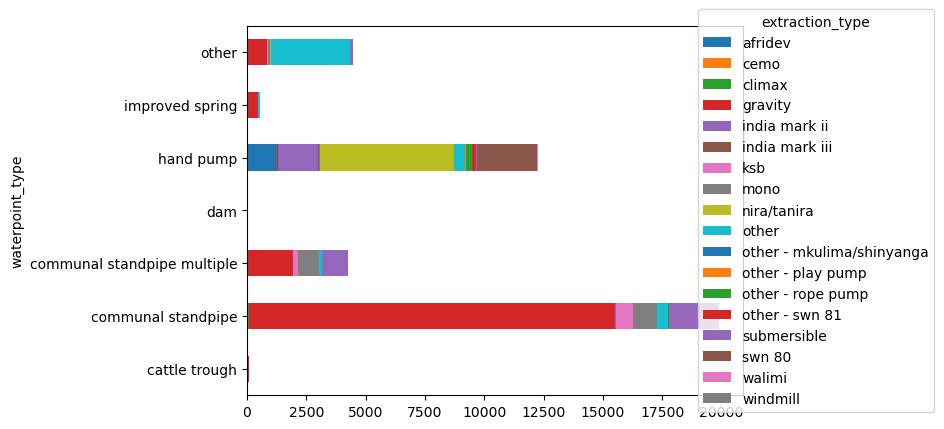

<Figure size 1600x800 with 0 Axes>

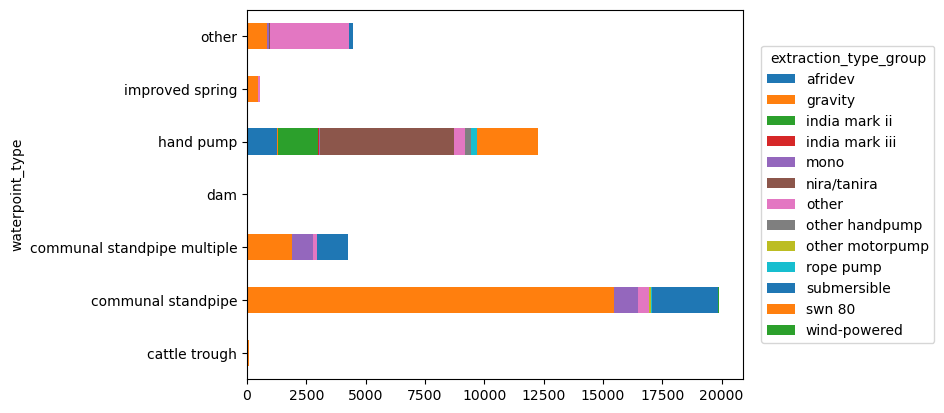

<Figure size 1600x800 with 0 Axes>

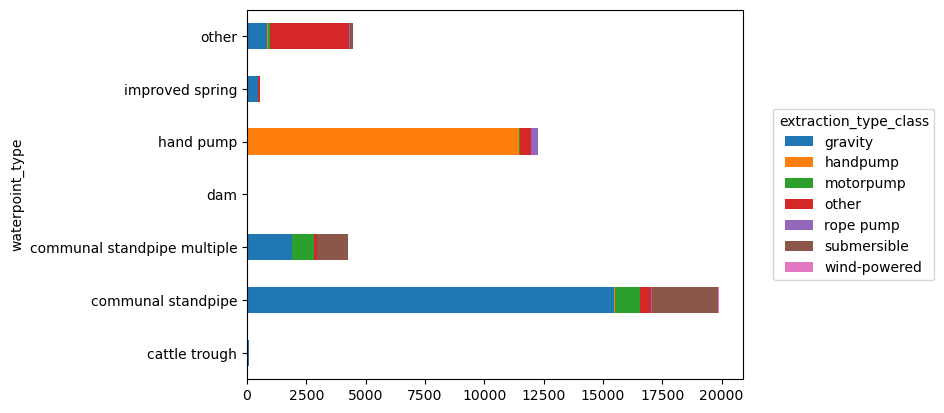

<Figure size 1600x800 with 0 Axes>

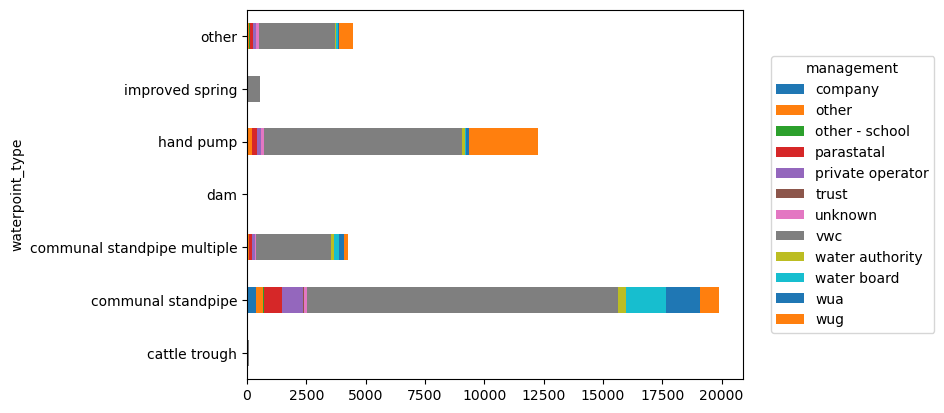

<Figure size 1600x800 with 0 Axes>

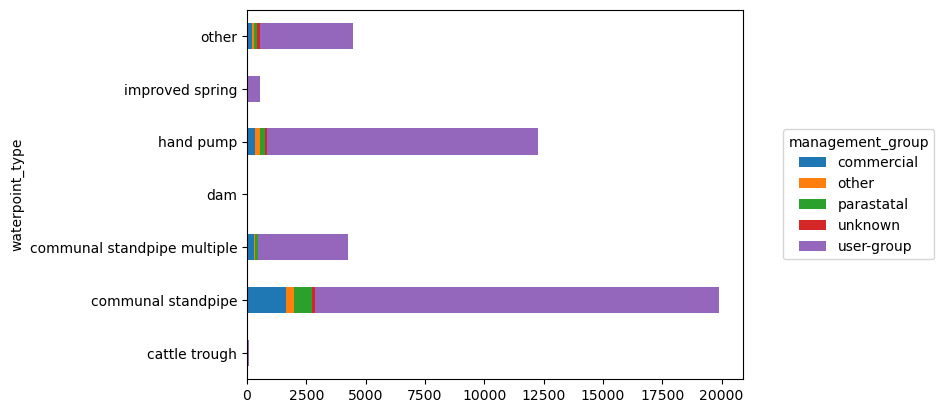

<Figure size 1600x800 with 0 Axes>

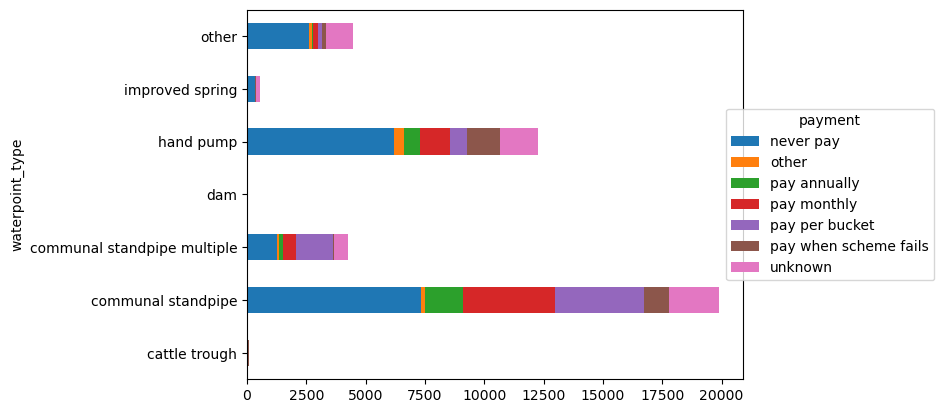

<Figure size 1600x800 with 0 Axes>

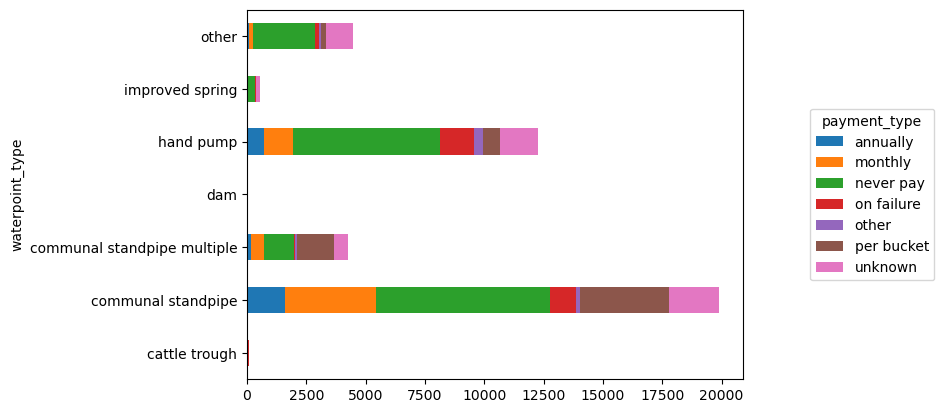

<Figure size 1600x800 with 0 Axes>

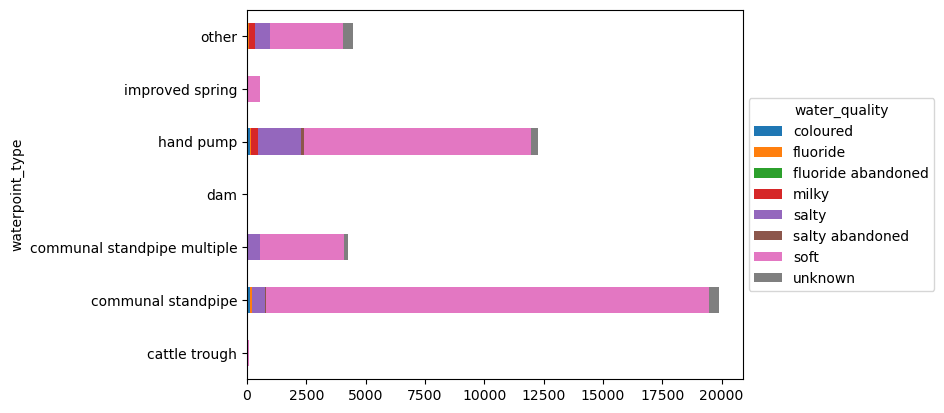

<Figure size 1600x800 with 0 Axes>

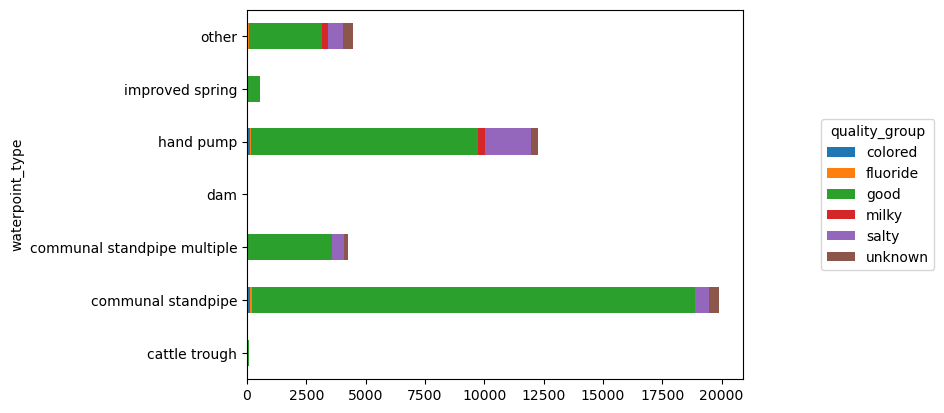

<Figure size 1600x800 with 0 Axes>

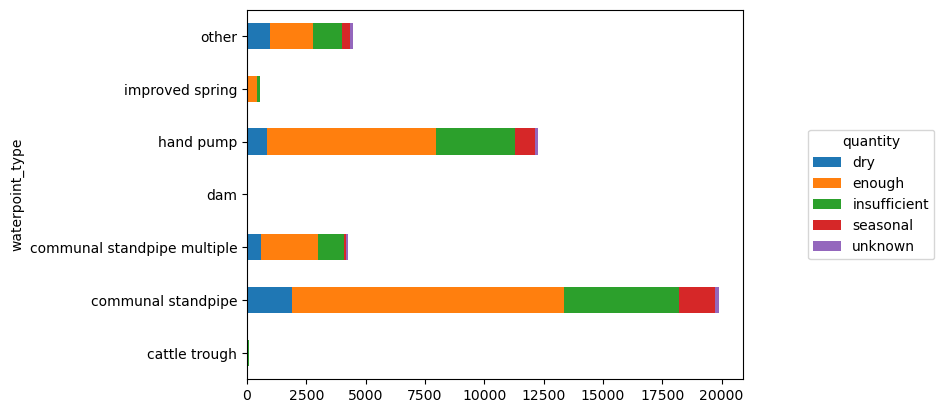

<Figure size 1600x800 with 0 Axes>

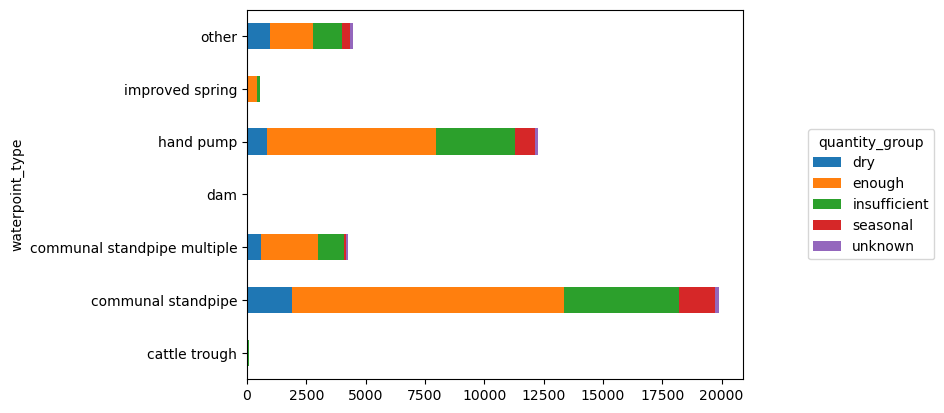

<Figure size 1600x800 with 0 Axes>

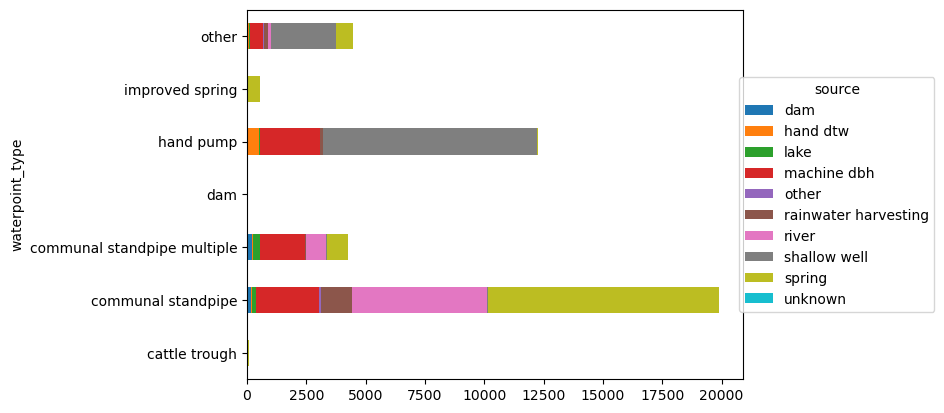

<Figure size 1600x800 with 0 Axes>

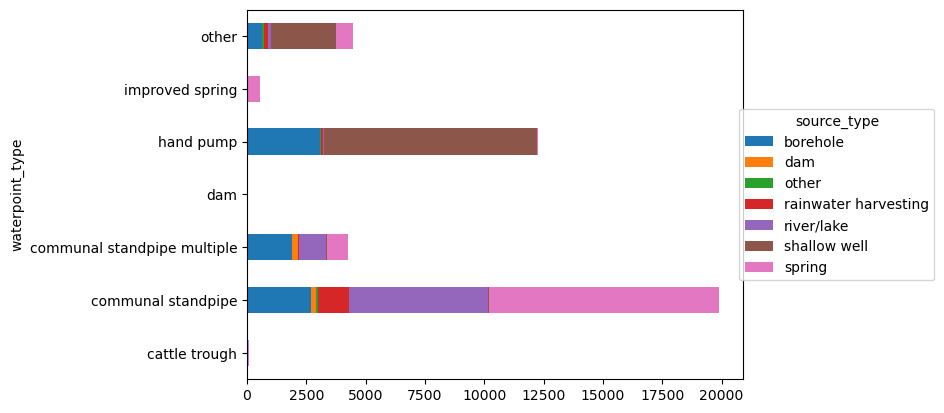

<Figure size 1600x800 with 0 Axes>

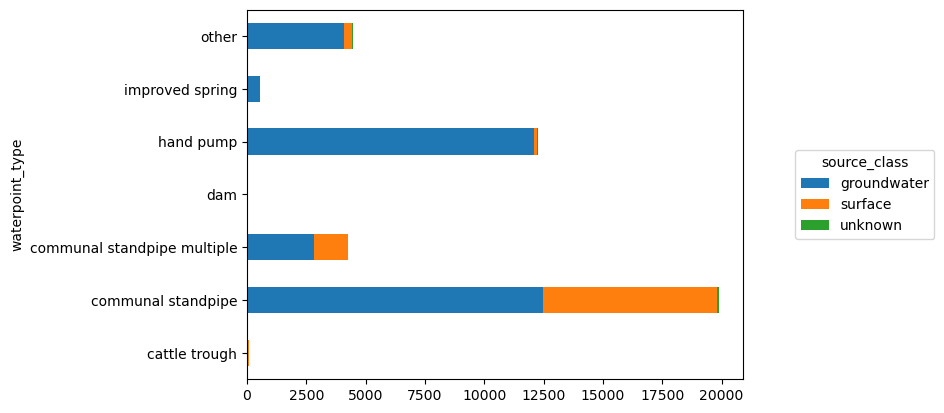

<Figure size 1600x800 with 0 Axes>

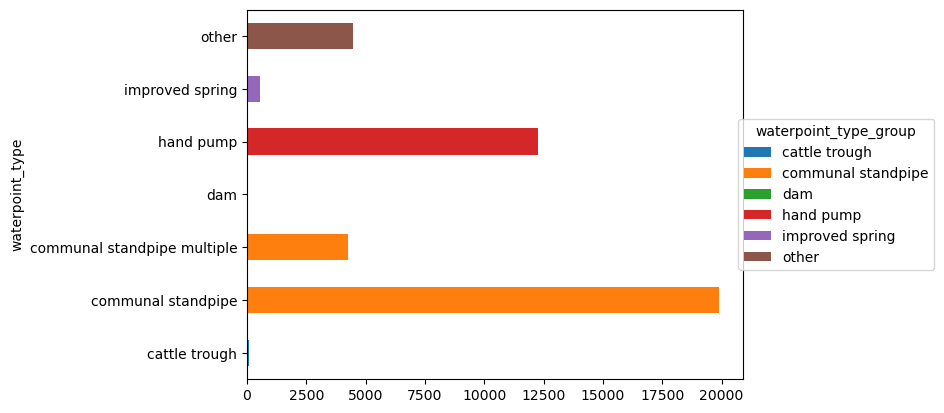

<Figure size 1600x800 with 0 Axes>

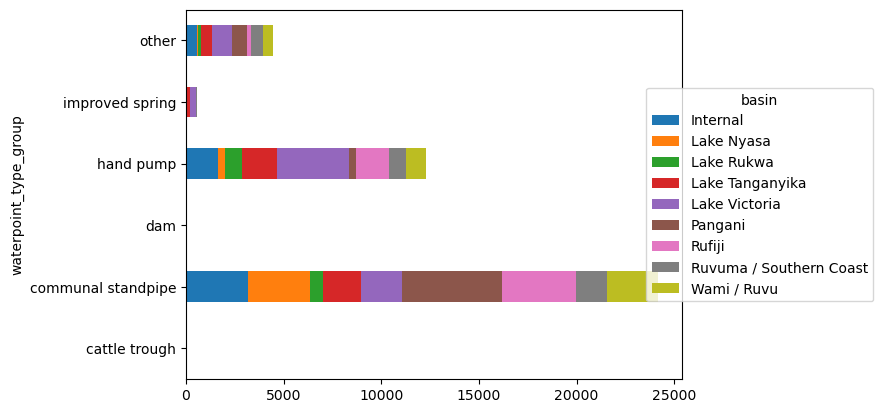

<Figure size 1600x800 with 0 Axes>

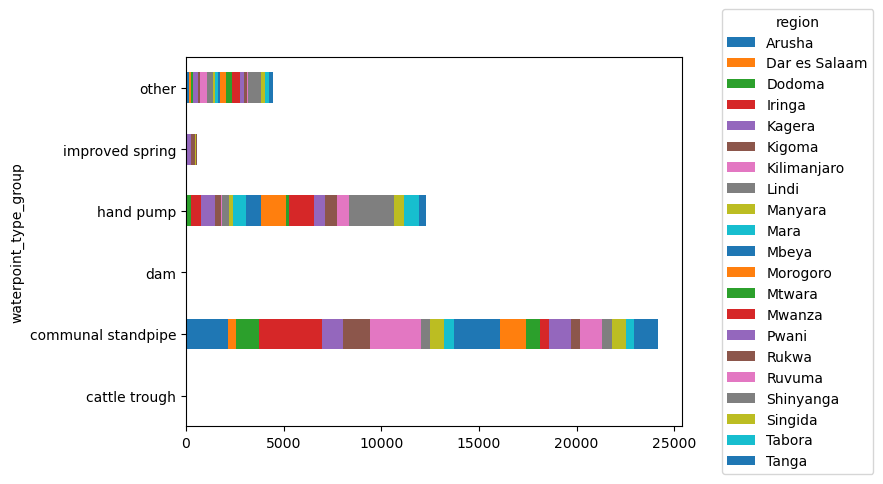

<Figure size 1600x800 with 0 Axes>

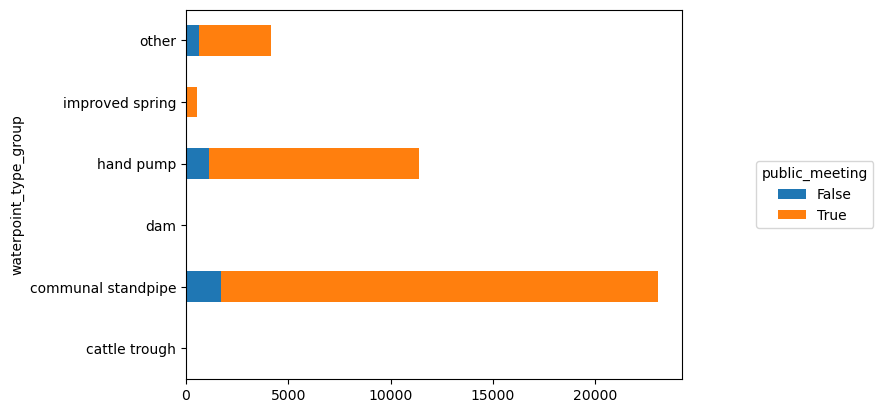

<Figure size 1600x800 with 0 Axes>

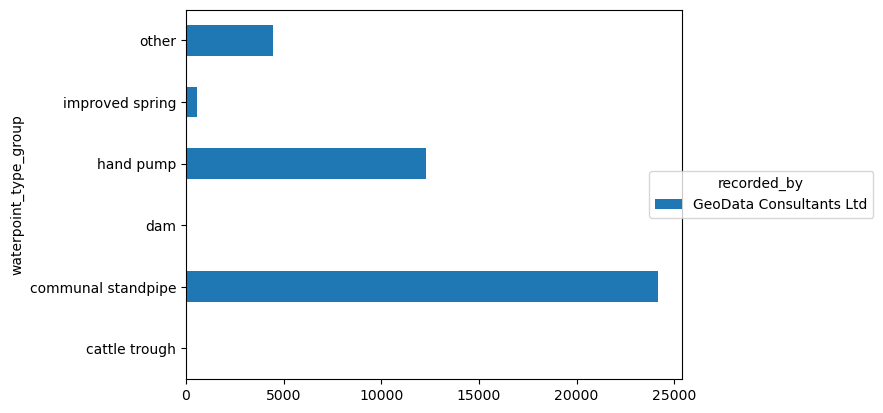

<Figure size 1600x800 with 0 Axes>

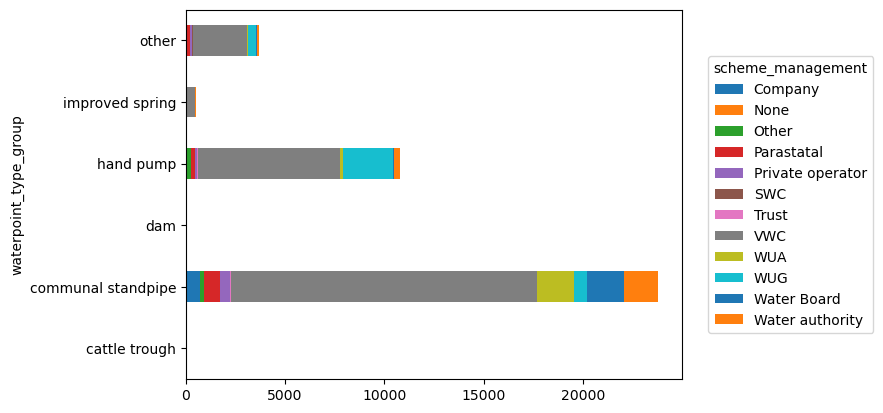

<Figure size 1600x800 with 0 Axes>

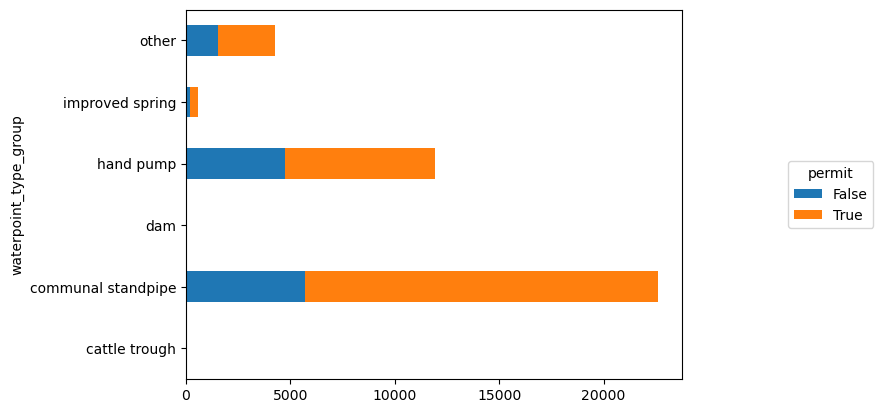

<Figure size 1600x800 with 0 Axes>

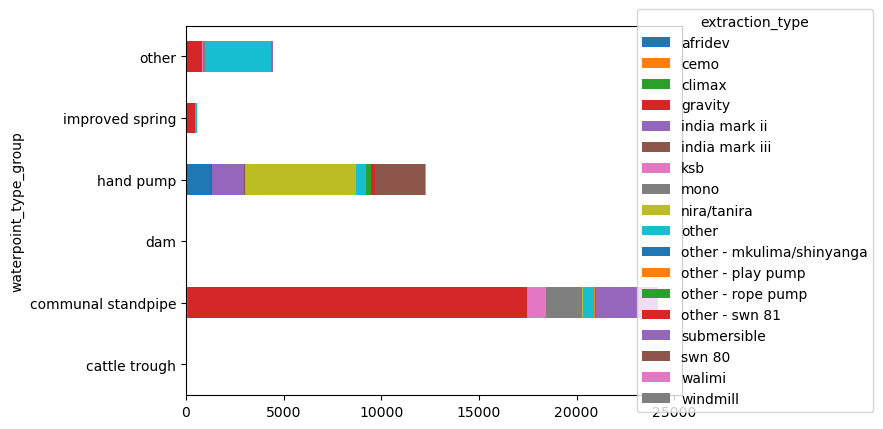

<Figure size 1600x800 with 0 Axes>

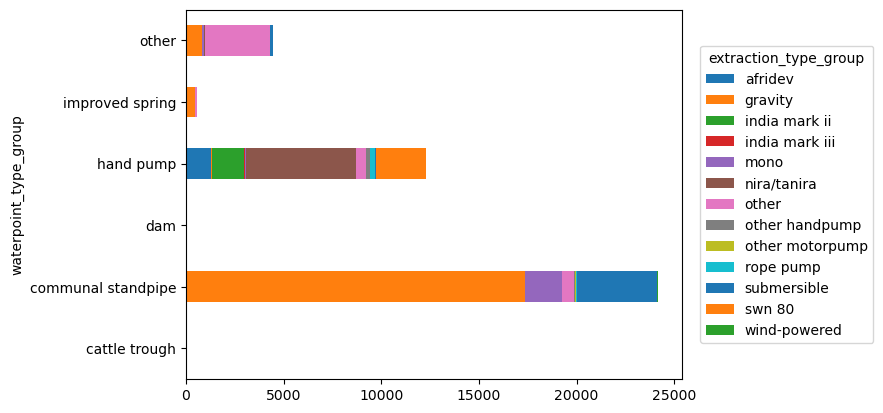

<Figure size 1600x800 with 0 Axes>

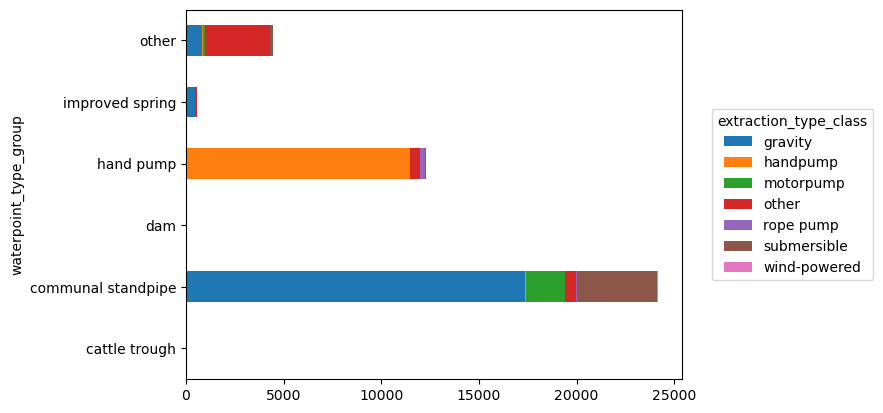

<Figure size 1600x800 with 0 Axes>

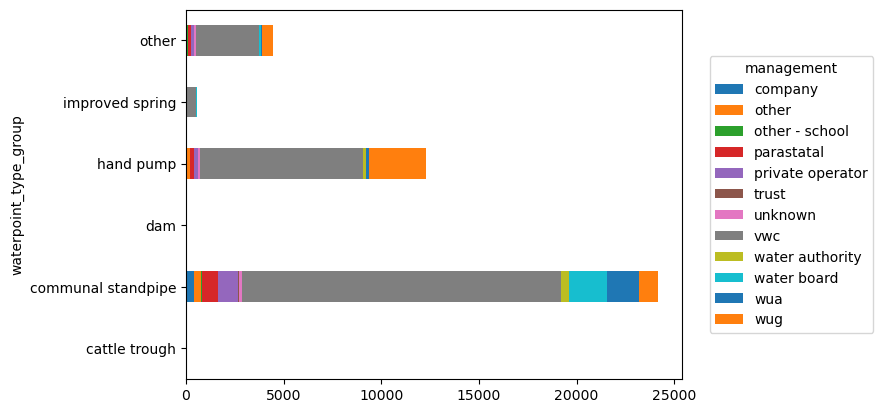

<Figure size 1600x800 with 0 Axes>

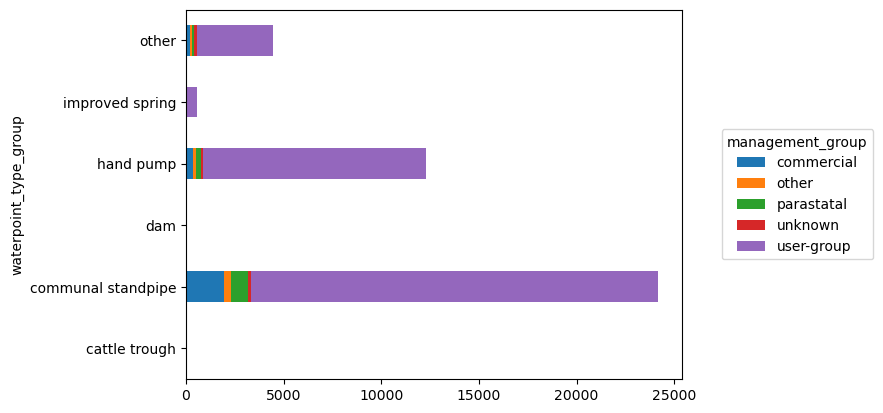

<Figure size 1600x800 with 0 Axes>

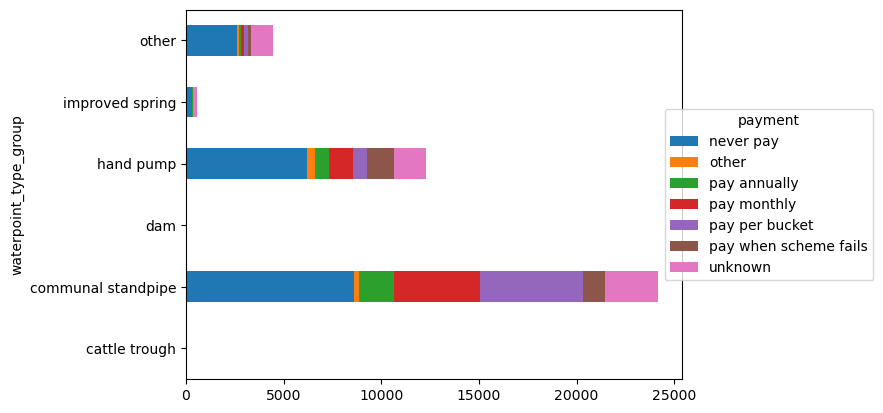

<Figure size 1600x800 with 0 Axes>

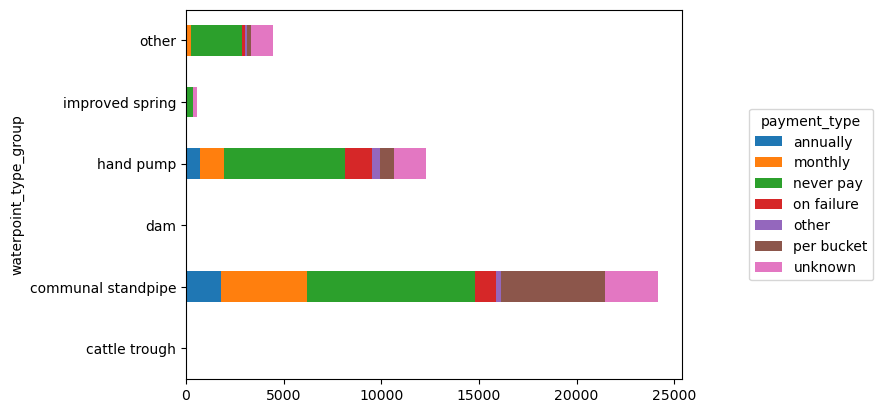

<Figure size 1600x800 with 0 Axes>

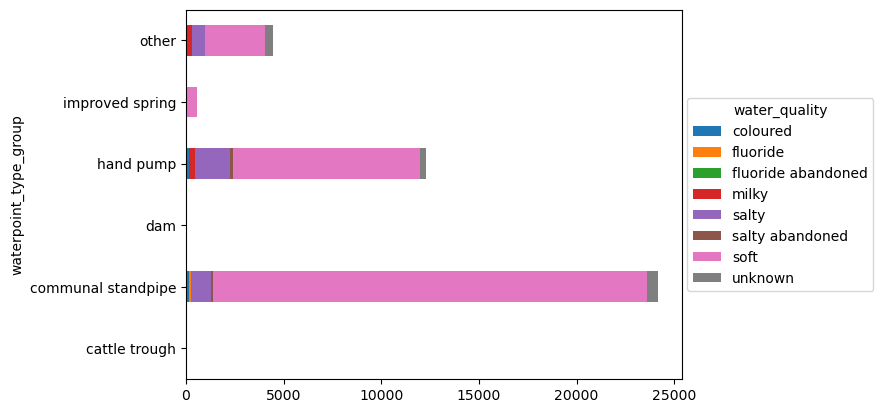

<Figure size 1600x800 with 0 Axes>

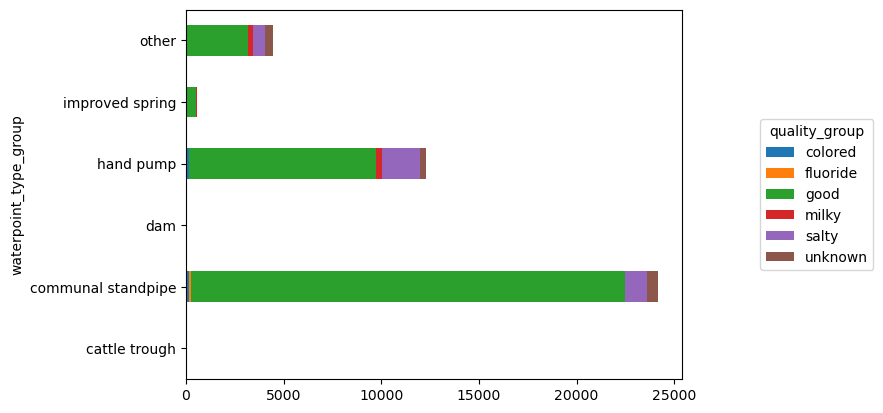

<Figure size 1600x800 with 0 Axes>

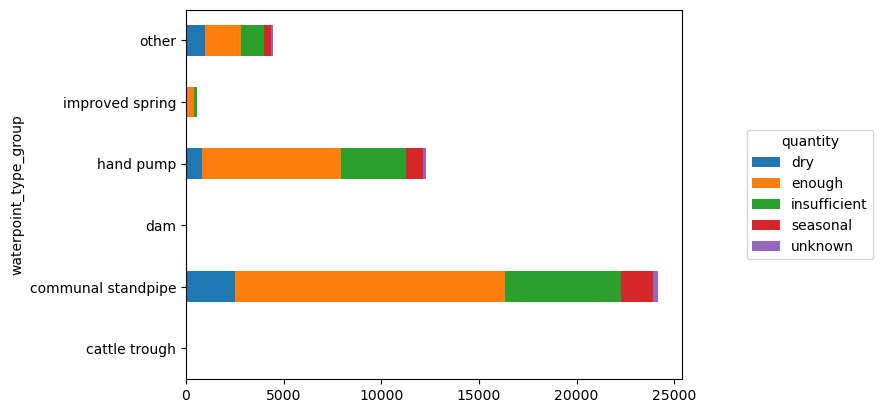

<Figure size 1600x800 with 0 Axes>

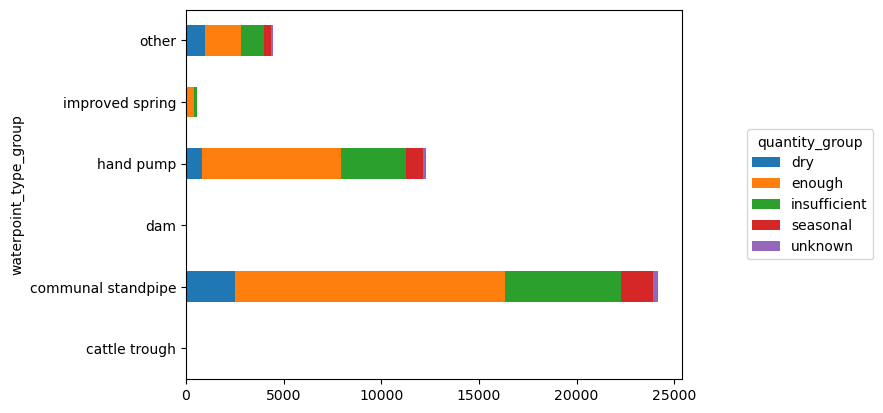

<Figure size 1600x800 with 0 Axes>

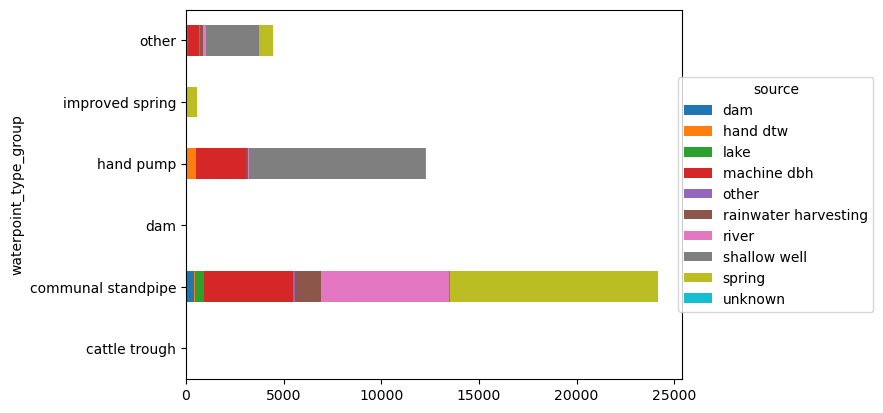

<Figure size 1600x800 with 0 Axes>

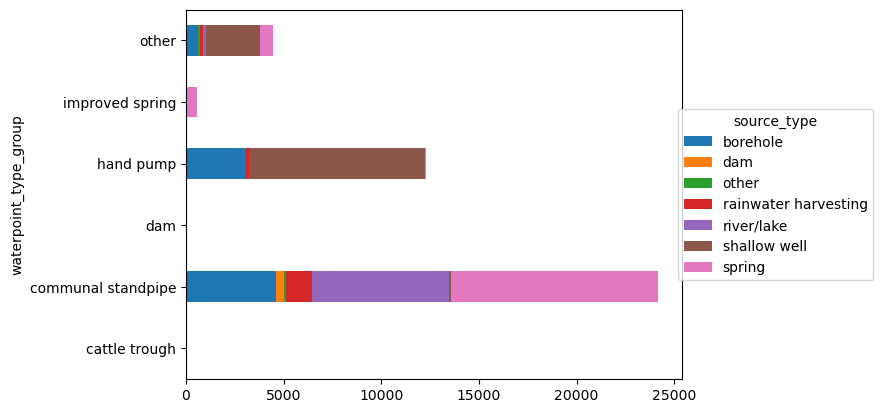

<Figure size 1600x800 with 0 Axes>

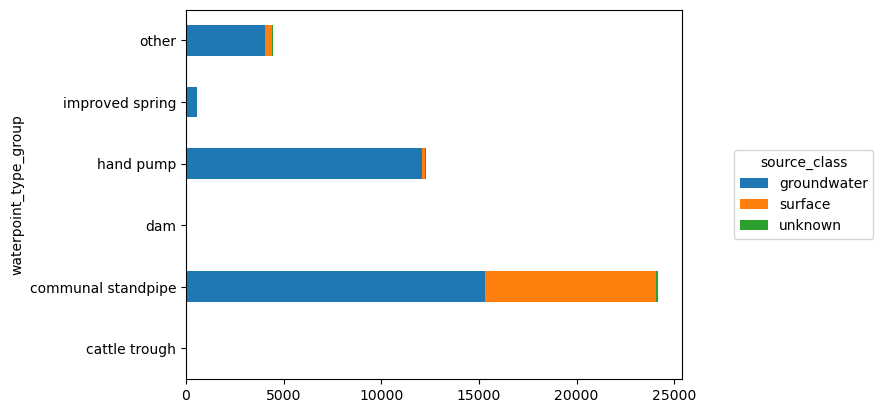

<Figure size 1600x800 with 0 Axes>

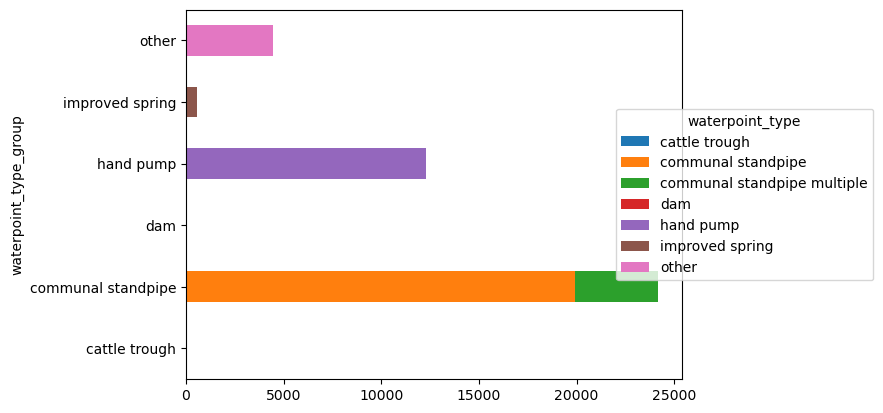

In [157]:
for i in list(cat_col):
    for j in list(cat_col):
        if i!=j:
            plt.figure(figsize=(16,8))
            pd.crosstab(x_train[i], x_train[j]).plot(kind='barh', stacked=True)
            plt.legend(loc='right', bbox_to_anchor=(1.4, 0.5),title=j)
            plt.show()

In [209]:
# never pay vs amount_tsh vs population

<Axes: xlabel='amount_tsh', ylabel='population'>

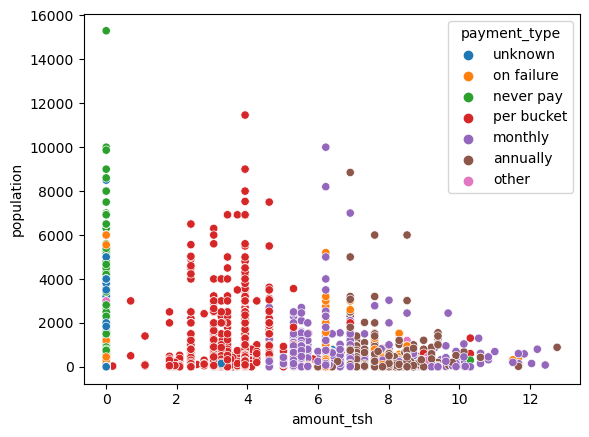

In [213]:
sns.scatterplot(data=x_train,x=np.log(x_train["amount_tsh"]+1),y="population",hue="payment_type")

<Axes: xlabel='amount_tsh', ylabel='population'>

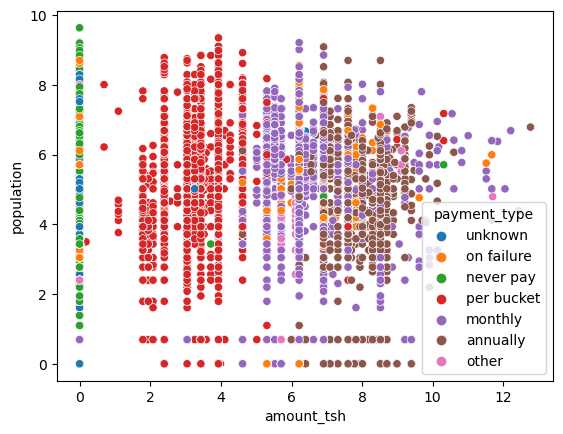

In [216]:
sns.scatterplot(data=x_train,x=np.log(x_train["amount_tsh"]+1),y=np.log(x_train.population+1),hue="payment_type")

In [271]:
x_train.loc[(x_train.amount_tsh==0) |(x_train.population==0)].shape

(29823, 41)

In [272]:
x_train.loc[(x_train.amount_tsh==0)].payment_type.value_counts()

never pay     17730
unknown        5683
on failure     1954
monthly        1462
per bucket     1276
other           613
annually        383
Name: payment_type, dtype: int64

In [274]:
x_train.loc[(x_train.amount_tsh==0)].region.value_counts()

Shinyanga        3442
Mbeya            3254
Kagera           2281
Mwanza           2142
Arusha           1719
Kilimanjaro      1636
Dodoma           1533
Morogoro         1460
Tabora           1398
Iringa           1309
Tanga            1152
Mara             1096
Kigoma            931
Singida           873
Pwani             863
Ruvuma            833
Rukwa             821
Lindi             741
Manyara           716
Mtwara            708
Dar es Salaam     193
Name: region, dtype: int64

In [269]:
x_train.shape

(41580, 41)

In [227]:
x_train.loc[x_train.amount_tsh==0].payment_type.value_counts(normalize=True,dropna=False).cumsum()

never pay     0.609257
unknown       0.804543
on failure    0.871688
monthly       0.921927
per bucket    0.965774
other         0.986839
annually      1.000000
Name: payment_type, dtype: float64

In [228]:
x_train.loc[x_train.population==0].payment_type.value_counts(normalize=True,dropna=False).cumsum()

never pay     0.544235
unknown       0.684083
per bucket    0.770273
on failure    0.852438
monthly       0.916292
annually      0.968274
other         1.000000
Name: payment_type, dtype: float64

In [232]:
x_train.population.value_counts()

0       14909
1        4920
200      1367
150      1313
250      1197
        ...  
723         1
3821        1
2905        1
736         1
879         1
Name: population, Length: 948, dtype: int64

In [235]:
x_train.loc[x_train.population<=1].groupby(by="population").management_group.value_counts(normalize=True,dropna=False).cumsum()

population  management_group
0           user-group          0.916829
            commercial          0.948353
            parastatal          0.978335
            other               0.992018
            unknown             1.000000
1           user-group          1.827033
            commercial          1.955691
            parastatal          1.975610
            unknown             1.989634
            other               2.000000
Name: management_group, dtype: float64

<Axes: xlabel='population', ylabel='Count'>

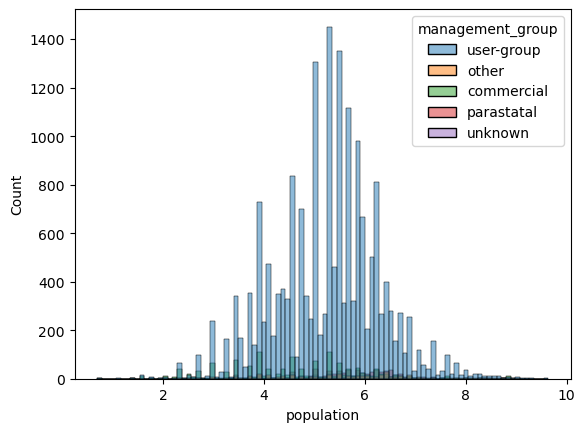

In [244]:
sns.histplot(data=x_train,x=np.log(x_train.loc[x_train.population>1].population),hue="management_group")

In [267]:
x_train.loc[x_train.population>1].groupby(by="management_group").population.value_counts()

management_group  population
commercial        50            108
                  200           102
                  100            86
                  30             76
                  150            66
                               ... 
user-group        8600            1
                  8848            1
                  9865            1
                  11463           1
                  15300           1
Name: population, Length: 1522, dtype: int64

<Axes: xlabel='longitude', ylabel='latitude'>

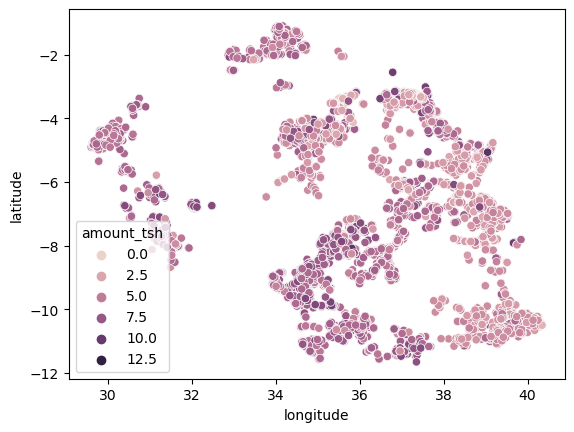

In [254]:
sns.scatterplot(data=x_train.loc[x_train.amount_tsh!=0],x="longitude",y="latitude",hue=np.log(x_train["amount_tsh"]+1))

<Axes: xlabel='amount_tsh', ylabel='Count'>

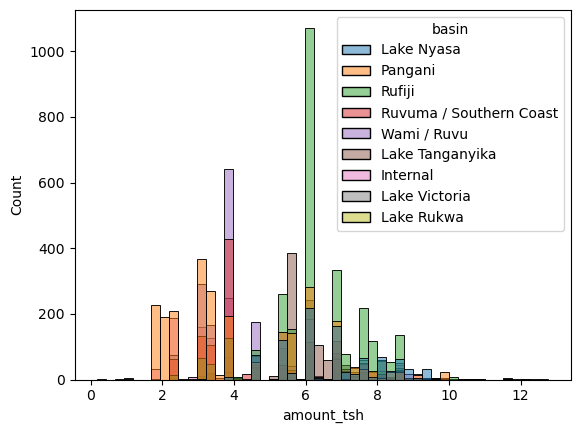

In [222]:
sns.histplot(data=x_train.loc[x_train.amount_tsh!=0],x=np.log(x_train.amount_tsh+1),hue="basin")

In [276]:
x_train.loc[x_train.amount_tsh!=0].groupby(by="basin").amount_tsh.value_counts(normalize=True,dropna=False).groupby(by="basin").head(3)

basin                    amount_tsh
Internal                 50.0          0.217813
                         10.0          0.164903
                         20.0          0.141975
Lake Nyasa               500.0         0.230526
                         1000.0        0.171579
                         200.0         0.128421
Lake Rukwa               2000.0        0.243028
                         5000.0        0.175299
                         1000.0        0.115538
Lake Tanganyika          250.0         0.291433
                         500.0         0.192954
                         600.0         0.082466
Lake Victoria            50.0          0.242958
                         500.0         0.172535
                         100.0         0.154930
Pangani                  20.0          0.148687
                         500.0         0.100202
                         5.0           0.091717
Rufiji                   500.0         0.366299
                         1000.0        0.114748
    

In [287]:
x_train.loc[x_train.amount_tsh!=0].groupby(by="extraction_type_class").amount_tsh.value_counts(normalize=True,dropna=False).groupby(by="extraction_type_class").head(3)

extraction_type_class  amount_tsh
gravity                500.0         0.216414
                       1000.0        0.095980
                       200.0         0.082072
handpump               500.0         0.248355
                       1000.0        0.140214
                       200.0         0.097862
motorpump              50.0          0.479452
                       20.0          0.162427
                       30.0          0.109589
other                  500.0         0.217848
                       50.0          0.170604
                       200.0         0.107612
rope pump              500.0         0.485714
                       2000.0        0.157143
                       1000.0        0.128571
submersible            50.0          0.405063
                       20.0          0.164161
                       30.0          0.114320
wind-powered           50.0          0.285714
                       25.0          0.214286
                       20.0          0.142857


In [281]:
np.exp(np.mean([np.log(2000),np.log(5000),np.log(1000)]))

2154.4346900318833

In [282]:
x_train.loc[x_train.amount_tsh!=0].amount_tsh.nunique()

92

In [286]:
x_train.amount_tsh.value_counts(normalize=True)

0.0       0.699880
500.0     0.052982
50.0      0.041053
1000.0    0.025349
20.0      0.024916
            ...   
6300.0    0.000024
0.2       0.000024
12.0      0.000024
53.0      0.000024
26.0      0.000024
Name: amount_tsh, Length: 93, dtype: float64

In [283]:
x_train.loc[x_train.population!=0].population.nunique()

947

<Axes: xlabel='amount_tsh', ylabel='Count'>

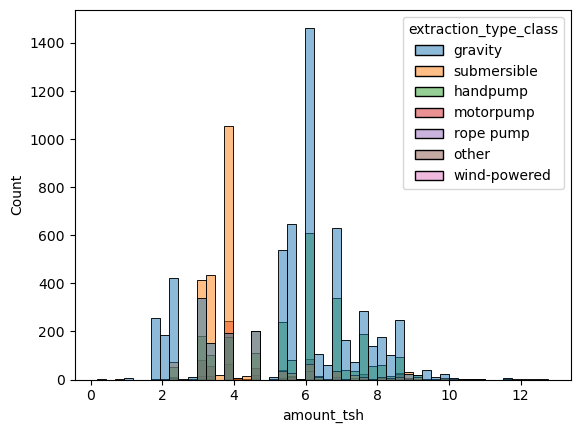

In [223]:
sns.histplot(data=x_train.loc[x_train.amount_tsh!=0],x=np.log(x_train.amount_tsh+1),hue="extraction_type_class")

<Axes: xlabel='amount_tsh', ylabel='Count'>

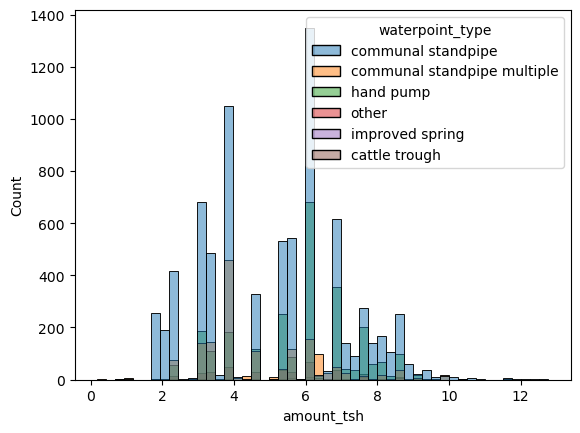

In [288]:
sns.histplot(data=x_train.loc[x_train.amount_tsh!=0],x=np.log(x_train.amount_tsh+1),hue="waterpoint_type")

<Axes: xlabel='amount_tsh', ylabel='Count'>

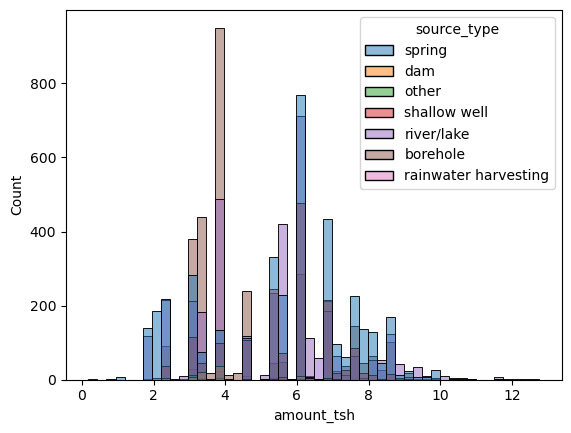

In [289]:
sns.histplot(data=x_train.loc[x_train.amount_tsh!=0],x=np.log(x_train.amount_tsh+1),hue="source_type")

In [298]:
x_train.loc[x_train.amount_tsh!=0].groupby(by=["source_type","basin","waterpoint_type"]).amount_tsh.value_counts(normalize=False,dropna=False).groupby(by="source_type").head(5)

source_type           basin            waterpoint_type              amount_tsh
borehole              Internal         cattle trough                100.0           1
                                       communal standpipe           50.0           75
                                                                    20.0           59
                                                                    30.0           32
                                                                    100.0          19
dam                   Lake Tanganyika  communal standpipe           250.0           1
                                       communal standpipe multiple  250.0           5
                      Lake Victoria    communal standpipe           25.0            1
                                                                    100.0           1
                                       communal standpipe multiple  50.0            7
other                 Internal         communal standpipe    

In [324]:
x_train["am_tsh_mod"]=np.log(x_train["amount_tsh"]+1)
x_train.loc[x_train["am_tsh_mod"] == 0, "am_tsh_mod"] = pd.NA
grp_mode=x_train.groupby(by=["basin"])["am_tsh_mod"].transform(lambda x: x.mode().iloc[0])
x_train["am_tsh_mod"]=x_train["am_tsh_mod"].fillna(grp_mode)
x_train["am_tsh_mod"]=np.exp(x_train["am_tsh_mod"])

<Axes: xlabel='am_tsh_mod', ylabel='Count'>

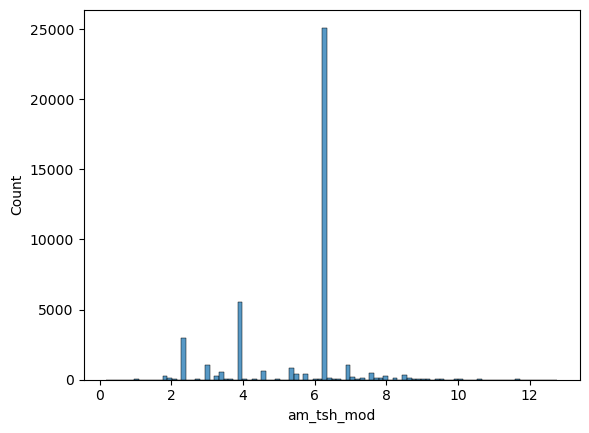

In [320]:
#quantity
sns.histplot(np.log(x_train.am_tsh_mod))

<Axes: xlabel='am_tsh_mod', ylabel='Count'>

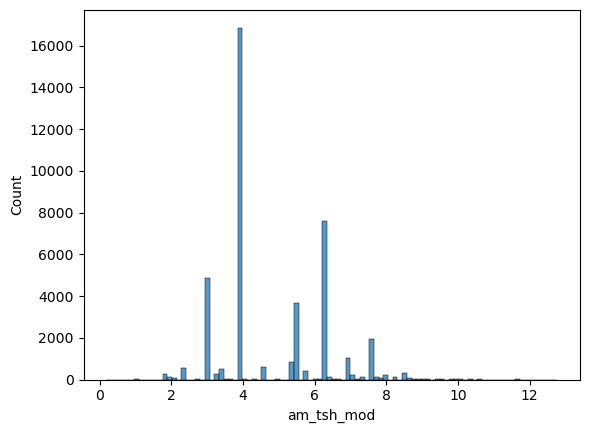

In [325]:
#source_type
sns.histplot(np.log(x_train.am_tsh_mod))

<Axes: xlabel='am_tsh_mod', ylabel='Count'>

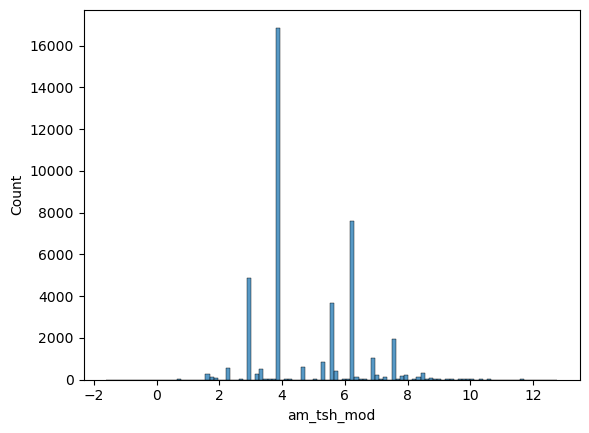

In [305]:
#basin 
sns.histplot(np.log(x_train.am_tsh_mod))

In [ ]:
sns.histplot(data=x_train.loc[x_train.amount_tsh!=0],x=np.log(x_train.amount_tsh+1),hue="management")

<Axes: xlabel='population', ylabel='Count'>

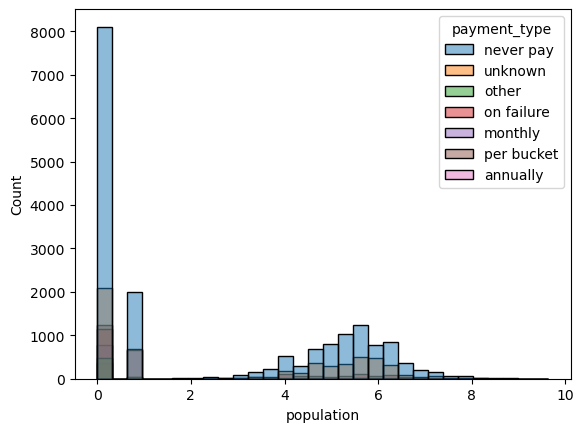

In [215]:
sns.histplot(data=x_train.loc[x_train.amount_tsh==0],x=np.log(x_train.population+1),hue="payment_type")

In [ ]:
sns.scatterplot(data=x_train,x="amount_tsh",y="population",hue="re")

## Construction_year

In [326]:
x_train.construction_year.value_counts()

0       14446
2010     1872
2008     1838
2009     1778
2000     1455
2007     1115
2006     1037
2003      900
2011      864
2004      800
2012      753
2002      740
1995      728
2005      719
1978      712
1990      694
1998      689
1999      670
1985      659
1996      571
1980      558
1984      550
1982      539
1994      510
1972      499
1974      492
1992      458
1997      453
1993      439
2001      364
1988      355
1983      326
1975      301
1986      299
1970      295
1976      293
1991      227
1989      212
1987      207
1981      162
1977      141
1979      130
1973      124
2013      121
1971       95
1960       76
1967       64
1963       60
1968       55
1969       44
1964       30
1962       20
1961       14
1966       14
1965       13
Name: construction_year, dtype: int64

<Axes: xlabel='construction_year', ylabel='Count'>

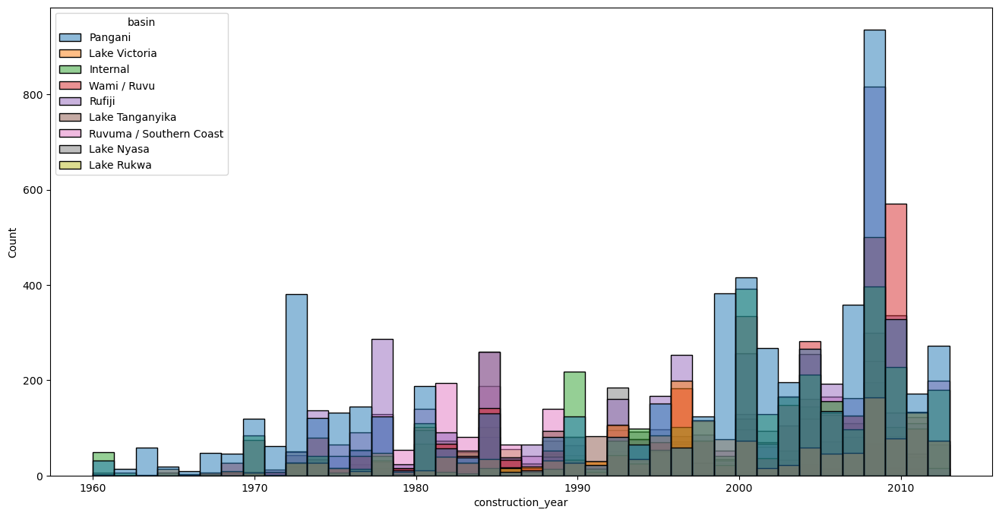

In [331]:
plt.figure(figsize=(16,8))
sns.histplot(data=x_train.loc[x_train.construction_year!=0],x="construction_year",hue="basin")

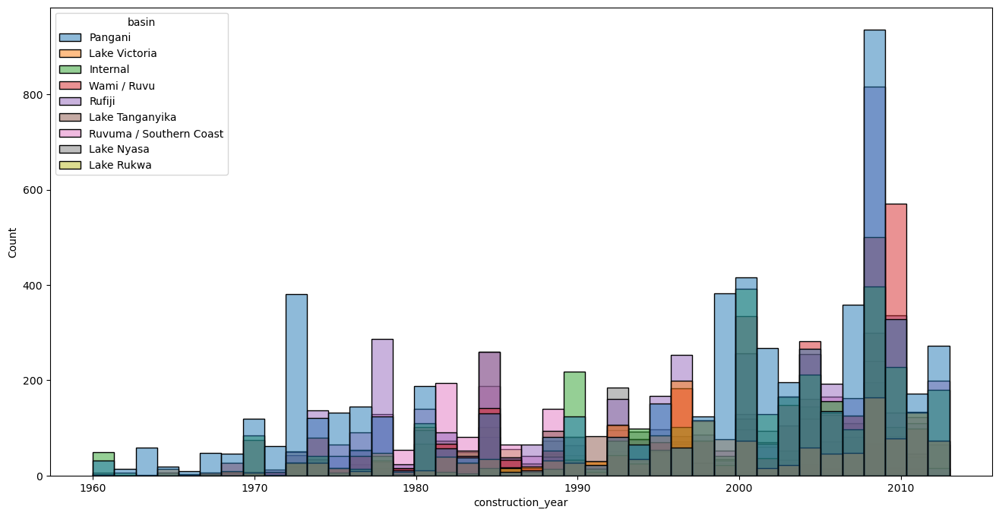

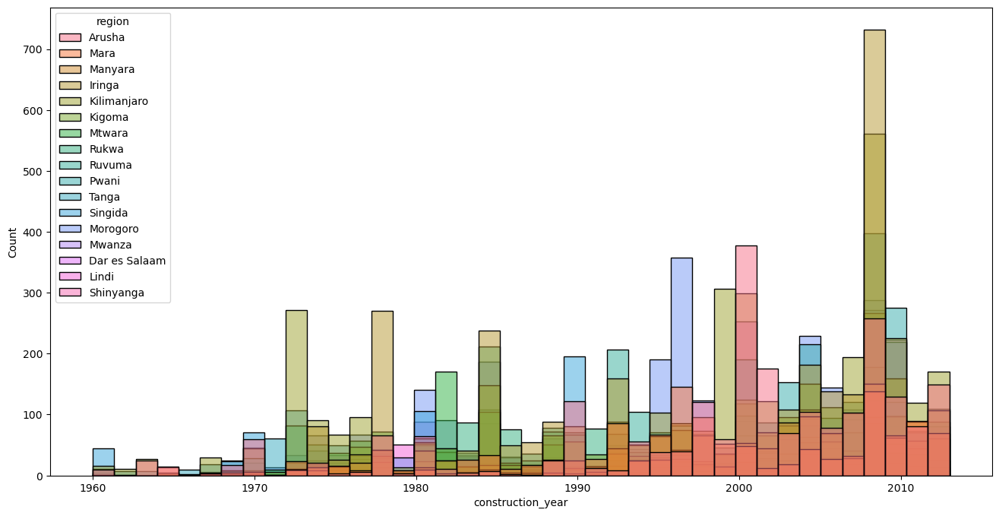

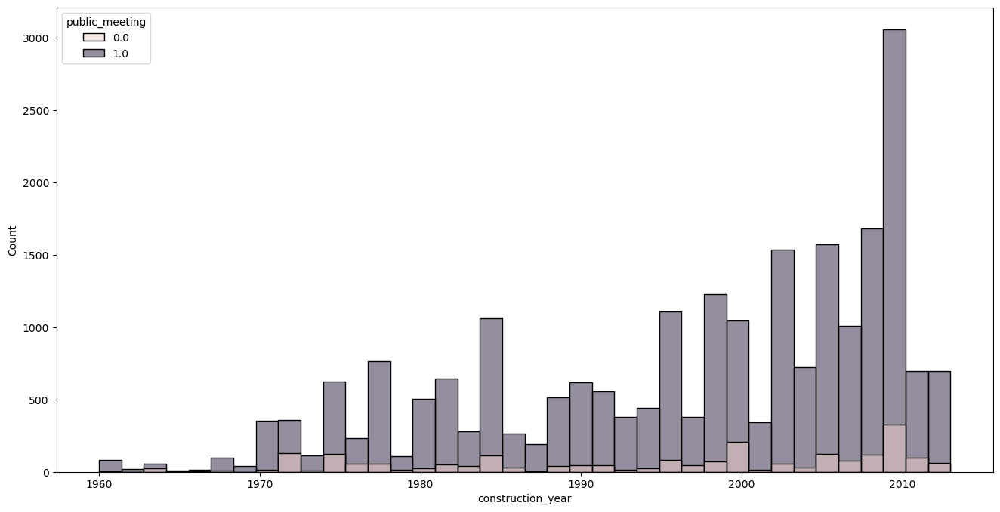

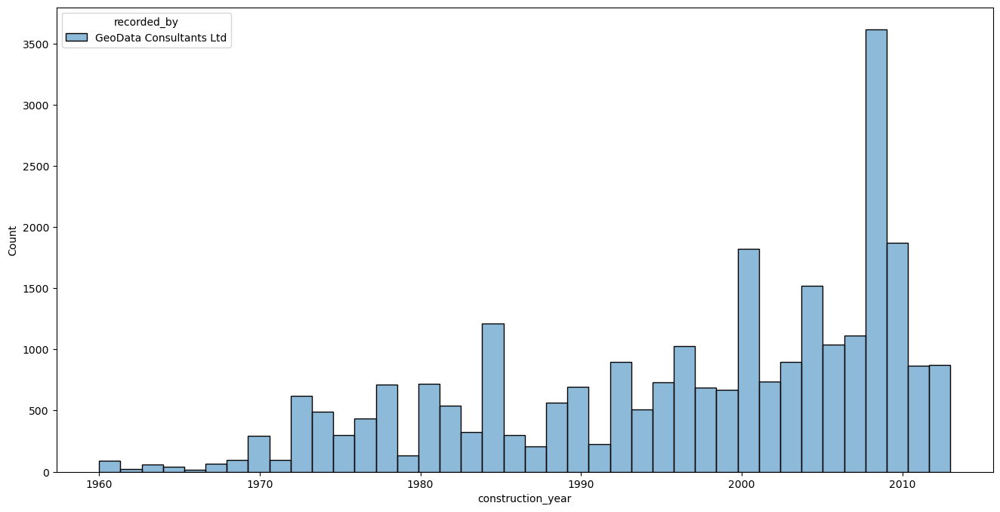

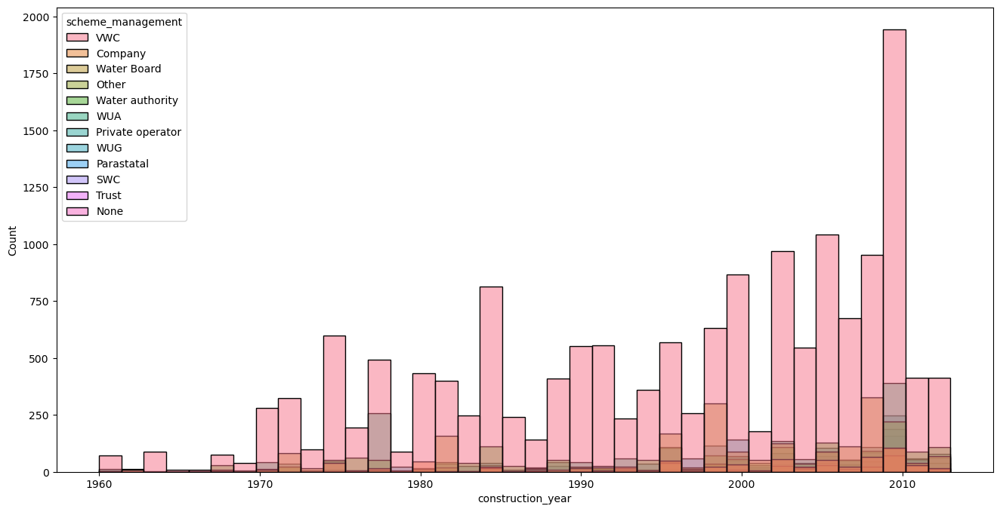

...

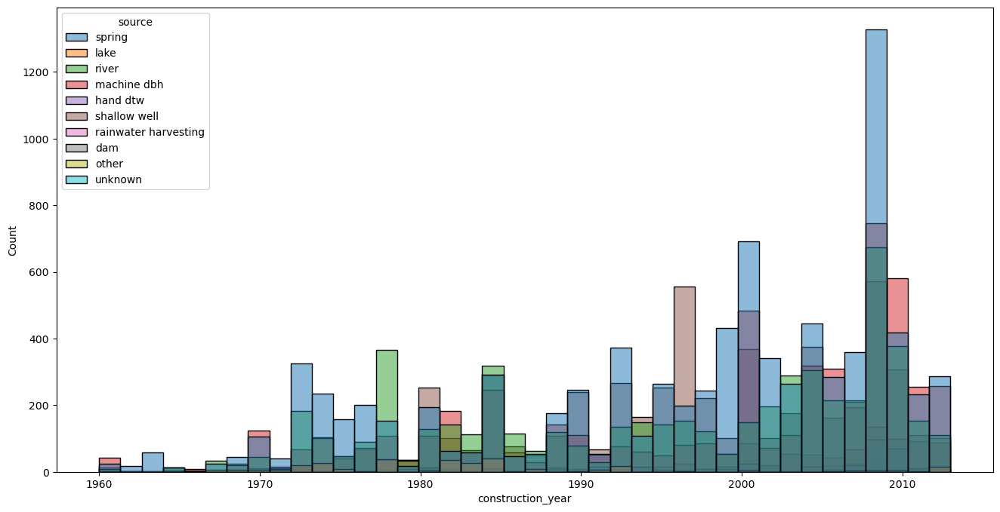

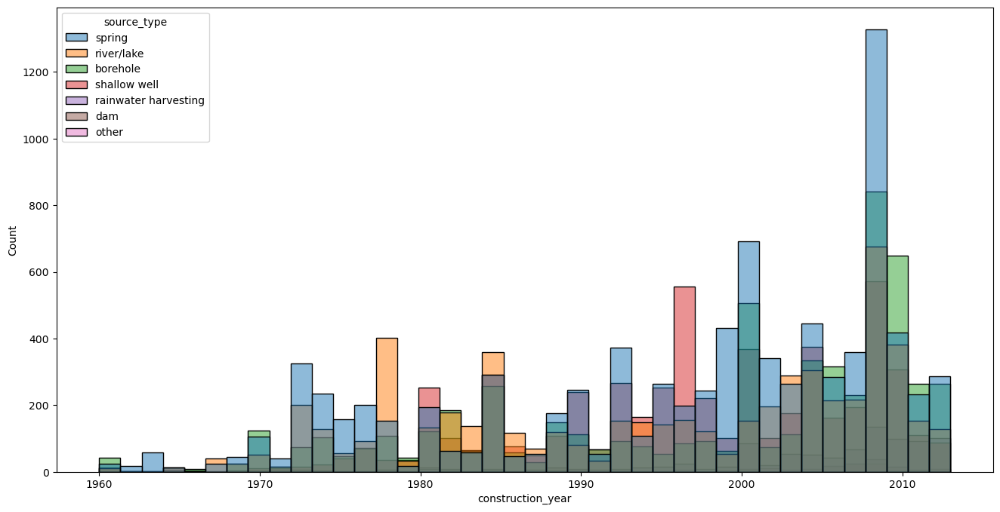

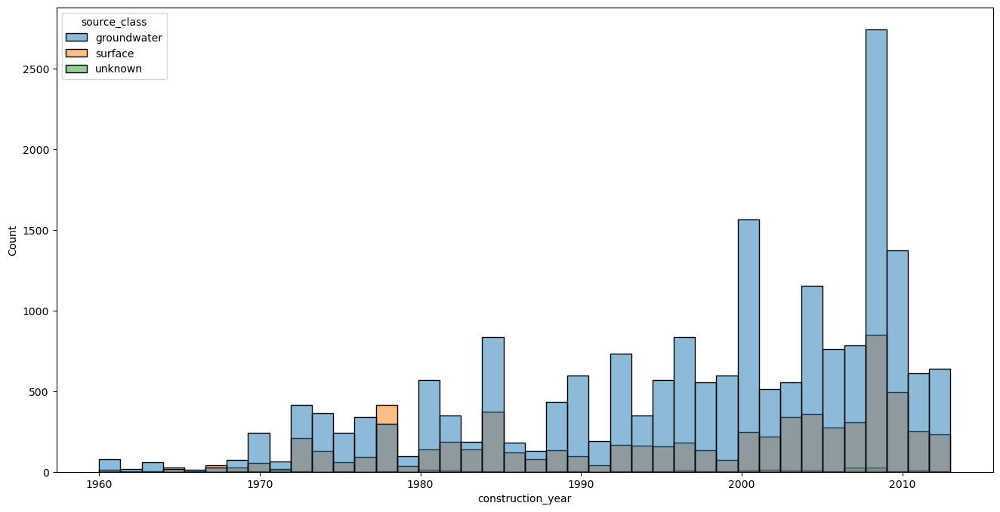

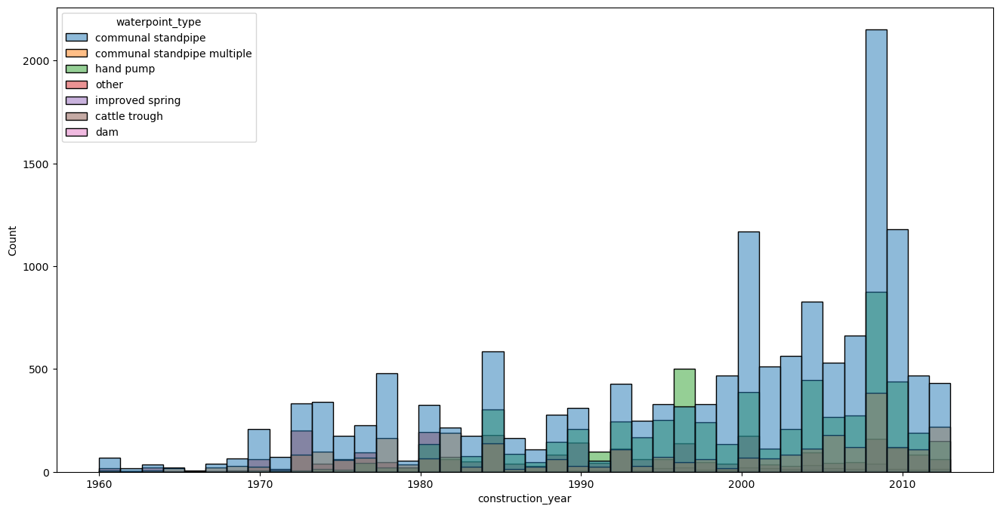

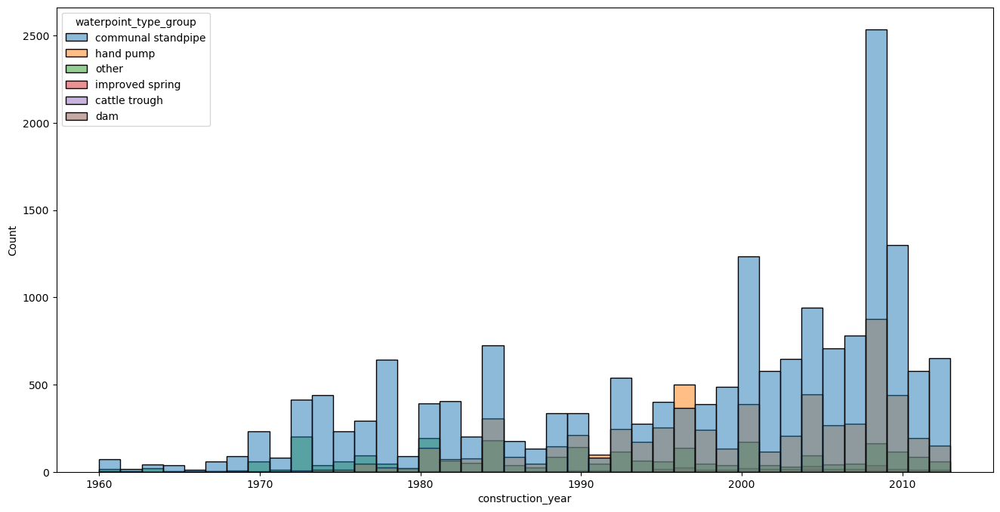

In [332]:
for i in list(cat_col):
    plt.figure(figsize=(16,8))
    sns.histplot(data=x_train.loc[x_train.construction_year!=0],x="construction_year",hue=i)
    plt.show()

In [333]:
x_train.construction_year.nunique()

55

In [354]:
x_train.record_date

AttributeError: 'DataFrame' object has no attribute 'record_date'

In [338]:
x_train.loc[x_train.construction_year!=0].groupby(by=["basin"]).construction_year.value_counts(normalize=True,dropna=False).groupby(by="basin").head(3)

basin                    construction_year
Internal                 2000                 0.109365
                         2010                 0.070240
                         1990                 0.067160
Lake Nyasa               1992                 0.080386
                         2008                 0.067524
                         1995                 0.051983
Lake Rukwa               1986                 0.080175
                         1985                 0.074344
                         1984                 0.072886
Lake Tanganyika          2009                 0.078186
                         1984                 0.054339
                         2006                 0.049648
Lake Victoria            2011                 0.076163
                         1996                 0.075000
                         1998                 0.067442
Pangani                  2008                 0.100454
                         1999                 0.061892
                      

In [340]:
x_train.loc[x_train.construction_year!=0].groupby(by=["extraction_type"]).construction_year.value_counts(normalize=True,dropna=False).groupby(by="extraction_type").head(3)

extraction_type            construction_year
afridev                    2008                 0.105187
                           2010                 0.077810
                           2004                 0.076369
cemo                       2009                 1.000000
climax                     2012                 1.000000
gravity                    2008                 0.073960
                           2009                 0.064475
                           2010                 0.048285
india mark ii              2009                 0.147386
                           2010                 0.119966
                           2008                 0.079692
india mark iii             2006                 0.292683
                           2007                 0.146341
                           1995                 0.121951
ksb                        2003                 0.126703
                           2010                 0.117166
                           2009            

In [347]:
x_train.loc[x_train.construction_year!=0].groupby(by=["region_code"]).construction_year.value_counts(normalize=True,dropna=False).groupby(by="region_code").head(2)

region_code  construction_year
2            2000                 0.165396
             2010                 0.058627
3            2008                 0.137738
             1999                 0.100592
4            2008                 0.093640
             2009                 0.066549
5            2010                 0.076442
             1995                 0.072620
6            2010                 0.158326
             2008                 0.126479
7            2000                 0.461679
             2010                 0.406934
8            1979                 0.202703
             1983                 0.094595
9            1982                 0.617761
             2012                 0.054054
10           1992                 0.071231
             2009                 0.071231
11           2009                 0.111430
             2008                 0.098794
13           1990                 0.134298
             2000                 0.130165
15           1984      